## chromogenic IHC #2: updated from V1 for quantification of all organoids, all replicates, all stains

## Notes for reference:
The first number in the name of each data folder refers to the cell line/treatment of the particular image/data. 7 total:

1: A02 (V337M), DMSO

2: A02 (V337M), BL-918 25uM

3: E11 (V337V), DMSO

4: E11 (V337V), BL-918 25uM

5: A01 (V337M), DMSO

6: A01 (V337M), BL-918 25uM

7: B12 (V337V), DMSO


The second number is the name of the antibody/marker in question. 9 total:

1: H&E (not quantified)

2: MAP2 (neuronal)

3: AT8 (p-tau)

4: HT7 (total tau)

5: Beclin-1

6: p62

7: LC3B

8: T22 (oligomeric tau)

9: ULK1



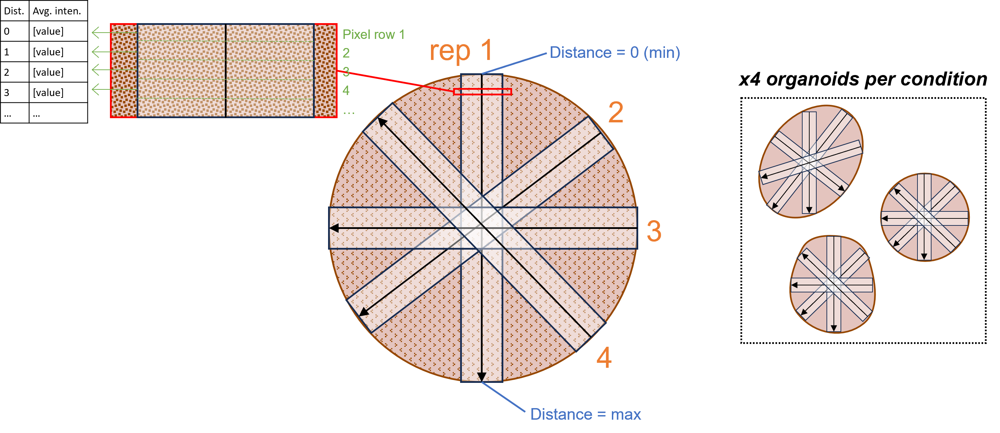

In [1]:
# this is how the information was taken from the images of each organoid slice
from IPython.display import Image
Image("quant_diagram.png")

## overall design:
1. import .csv files (separated by xx.csv and Z0. csv, as these files have different headings)
3. convert Distance to "% from center"
4. concat all reps (anywhere from ~4 to 9) from each organoid
5. output graphs for each organoid, each marker.
6. concat all organoid reps from each condition into one list. output 1 graph per marker, per condition.
7. complete statistical analyses (mean intensity in inner percentage range [ex. 0-20%] vs outer percentage range [ex. 80-100%]). Output mean, stdev, p-value, n (number of reps), and a bar graph for visual. 

In [2]:
# step 1: input all csvs with data.

import glob
import pandas as pd

# list of different organoid conditions, all are filenames in folder ".\org-inten"
ls_folders = ["1-2", "1-3", "1-4", "1-5", "1-6", "1-7", "1-8", "1-9", 
              "2-2", "2-3", "2-4", "2-5", "2-6", "2-7", "2-8", "2-9",
              "3-2", "3-3", "3-4", "3-5", "3-6", "3-7", "3-8", "3-9",
              "4-2", "4-3", "4-4", "4-5", "4-6", "4-7", "4-8", "4-9", 
              "5-2", "5-3", "5-4", "5-5", "5-6", "5-7", "5-8", "5-9",
              "6-2", "6-3", "6-4", "6-5", "6-6", "6-7", "6-8", "6-9", 
              "7-2", "7-3", "7-4", "7-5", "7-6", "7-7", "7-8", "7-9"]

# make a dictionary to reference the ls_folders, where calling d_condits[condition] (ex. d_condits[1-2]) will give the index in ls_point_to_csvs of 
# that folder 

d_condits = {}
i = 0
for condit in ls_folders:
    d_condits[condit] = i
    i = i + 1

#import all csvs 
# structure--ls_point_to_csvs lists all folders, each folder has its own list of dataframes of csvs in that folder (len = #bioreps *4)
# in parallel, make a list for each folder that indicates what organoid biorep that csv correlates to. ie: ls_point_to_csvs[folder][8] would be the 
# csv that is associated the the organoid rep ls_lsreps[folder][8]
ls_point_to_csvs = [None] *  len(ls_folders)
ls_lsreps = [None] * len(ls_folders)

for i in range(len(ls_folders)):
    folder = ls_folders[i]
    ls_point_to_csvs[i] = []
    ls_lsreps[i] = []
    for file_name in glob.glob("./org-inten/"+folder+"/*.csv"):
        if "T0_Z0" in file_name:
            x = pd.read_csv(file_name, skiprows=7, header=0, usecols=[0,1,2,3,4], names=["dist", "gray", "R", "G", "B"])
        else:
            x = pd.read_csv(file_name, header=1, usecols=[0, 1, 2, 3, 4], names=["dist", "gray", "R", "G", "B"])
        ls_point_to_csvs[i].append(x)
        ls_lsreps[i].append(file_name[24])

# ls_point_to_csvs has a first dimension of 56 folders total, with a variable number (#bioreps*4) of csvs/dfs within each folder
# also note that organoid bioreps are imported in alphabetical order, therefore are in that order in each ls_point_to_csvs[folder] list,
# but not all conditions have simple bioreps (i.e. A, B, C, D...F, G); some skip letters in alphabet. This is the purpose of ls_lsreps folder

# TEST:
print(ls_lsreps[4][12])

D


In [3]:
# Step 2: convert distance to metrics that can be more easily concatenated/understood on a graph. 
# Add these converted values to every df in ls_point_to_csvs

#KEY (for column names in the dfs):
# %dist: percent distance from center--converts distance values (in um) such that the distance of the middle of the list becomes 0%, and the
# distance value at the edges (lowest and highest) become 100% 
# dist_c: distance from center; converts distance values so that the middle is 0um and the edges are the radius of the organoid slice
# dist_e: distance from edge; converts distance values so that the middle value is the radius of the organoid slices, and the edges are 0um
# gray%: grayscale values converted to percentages, where 0% = white  (no staining), 100% = black (high staining). 

import numpy as np

# go through a section of a list (from indices start_i to end_i) and return the index whose value is closest to match_val
def closest_index(ls, start_i, end_i, match_val):
    match_ind = start_i
    smallest_dist = abs(ls[start_i] - match_val)
    for i in range(start_i+1, end_i):
        dist = abs(ls[i] - match_val)
        if dist < smallest_dist:
            smallest_dist = dist
            match_ind = i
    return match_ind

#ls = [1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 2.2, 2.5, 2.8, 3.3, 3.9, 4.3]
#print(closest_index(ls, 0, 10, 2.6))

# return a list of the same length as ls_dist, with values that are converted to %distance to center, with 0 as the center and 100% as the edges.
def convert_dist(ls_dist): 
    
    # find mid index of list
    est_mid_ind = int(len(ls_dist) / 2)
    
    # find match value of list (middle distance)
    match_val = ls_dist[len(ls_dist)-1] / 2
    mid_ind = closest_index(ls_dist, est_mid_ind-15, est_mid_ind+15, match_val)
    mid_val = ls_dist[mid_ind]
    
    # create percentage lists where center dist = 0% and min, max dists = 100%
    ls_p = []
    for i in range(len(ls_dist)): 
        if i < mid_ind: 
            val = (1 - ls_dist[i]/mid_val) * 100
        if i == mid_ind:
            val = 0
        if i > mid_ind: 
            val = (ls_dist[i]/mid_val - 1) * 100
        ls_p.append(val)

    return(ls_p)

# return a list of the same length as ls_dist, with values that are converted to distance from edge, with 0 as edges. 
def calc_dist_from_edge(ls_dist): 
    
    # find mid index of list
    est_mid_ind = int(len(ls_dist) / 2)

    # find match value of list (middle distance)
    match_val = ls_dist[len(ls_dist)-1] / 2
    mid_ind = closest_index(ls_dist, est_mid_ind-15, est_mid_ind+15, match_val)
    
    # create distance lists where edge dist = 0
    ls_edge_dist = []
    last_val = ls_dist[len(ls_dist)-1]
    for i in range(len(ls_dist)):
        if i <= mid_ind:
            val = ls_dist[i]
        else:
            val = last_val - ls_dist[i]
        ls_edge_dist.append(val)
    
    return ls_edge_dist

# return a list of the same length as ls_dist, with values that are converted to distance from center, with center = 0
def calc_dist_from_center(ls_dist):
    # find mid index of list
    est_mid_ind = int(len(ls_dist) / 2)

    # find match value of list (middle distance)
    match_val = ls_dist[len(ls_dist)-1] / 2
    mid_ind = closest_index(ls_dist, est_mid_ind-15, est_mid_ind+15, match_val)
    
    # create distance lists where center = 0
    ls_center_dist = []
    for val in ls_dist:
        ls_center_dist.append(abs(val - ls_dist[mid_ind]))

    return ls_center_dist

#invert the given list so that 0 = white and 255 = black, then convert to percent such that 0 = white, 100 = black. 
def convert_gray_to_percent(ls):
    new_ls = []
    for val in ls:
        new_val = 255 - val
        new_val = (new_val / 255) * 100
        new_ls.append(new_val)
        
    return new_ls

# add percentage, from edge lists to all dataframes in the ls_point_to_csvs list, as long as they're not already there
for ls_a in ls_point_to_csvs:
    for df in ls_a: 
        if "%dist" not in df:
            ls_p = convert_dist(df["dist"].tolist())
            df["%dist"] = ls_p
        if "dist_e" not in df:
            ls_e = calc_dist_from_edge(df["dist"].tolist())
            df["dist_e"] = ls_e
        if "dist_c" not in df:
            ls_c = calc_dist_from_center(df["dist"].tolist())
            df["dist_c"] = ls_c
        if "gray%" not in df:
            ls_gray = convert_gray_to_percent(df["gray"].tolist())
            df["gray%"] = ls_gray

print(ls_point_to_csvs[3][6]["dist_c"][1200])

437.979


In [4]:
# step 3.1: setup concatenation of all reps for the same organoid (ie. organoid A from condit 1-2), specifically for graphing purposes
# note that each organoid biorep has exactly 4 csvs (4 dfs) associated with it
# another note: would be difficult later on if they were all combined into the same df, because the values for dist will not match up between
# organoid reps. If I made a big concat list for each column in the already existing dfs, then they would have to be separated later to be able to
# get the means of each biorep to do the t-test

# concatenate values in the passed list of dataframes (dfs), within the col_name passed. 
def concat_reps(dfs, col_name): 
    x = []
    for df in dfs:
        x = x + df[col_name].tolist()
    return x

# return the total number of bioreps in a specific condition
def get_numreps(condit, ls=ls_point_to_csvs, num_csvs_per_rep = 4):
    l = len(ls[d_condits[condit]])
    return l // num_csvs_per_rep

# return a list of dfs associated with a specific list of indices that correlate to dfs in ls_point_to_csvs[folder_i]
def get_ls_dfs(folder_i, indices, ls=ls_point_to_csvs):
    df_ls = []
    for i in indices:
        df_ls.append(ls[folder_i][i])
    return df_ls

#TEST:
# print(get_ls_dfs(0, ls_d_reps[0]["A"]))

# create a list of dictionaries. List = len(ls_point_to_csvs) (aka # of total conditions; currently 56)
# format of each dictionary: key = letter of organoid rep, value = list indices in ls_point_to_csvs[condit] that reference the reps for that
# organoid rep. 
ls_d_reps = [None] * len(ls_point_to_csvs)
i = 0
for ls in ls_d_reps:
    dict = {}
    n = get_numreps(ls_folders[i])
    for j in range(n):
        start = j*4
        dict[ls_lsreps[i][start]] = [start, start+1, start+2, start+3]
    ls_d_reps[i] = dict
    i = i+1

#TEST
# print(ls_d_reps)

In [5]:
# print(ls_d_reps)

[{'A': [0, 1, 2, 3], 'B': [4, 5, 6, 7], 'C': [8, 9, 10, 11], 'D': [12, 13, 14, 15], 'E': [16, 17, 18, 19], 'G': [20, 21, 22, 23], 'H': [24, 25, 26, 27], 'I': [28, 29, 30, 31]}, {'A': [0, 1, 2, 3], 'B': [4, 5, 6, 7], 'C': [8, 9, 10, 11], 'D': [12, 13, 14, 15], 'E': [16, 17, 18, 19], 'F': [20, 21, 22, 23], 'G': [24, 25, 26, 27], 'H': [28, 29, 30, 31], 'I': [32, 33, 34, 35]}, {'A': [0, 1, 2, 3], 'B': [4, 5, 6, 7], 'C': [8, 9, 10, 11], 'D': [12, 13, 14, 15], 'E': [16, 17, 18, 19], 'F': [20, 21, 22, 23], 'H': [24, 25, 26, 27], 'I': [28, 29, 30, 31]}, {'A': [0, 1, 2, 3], 'B': [4, 5, 6, 7], 'C': [8, 9, 10, 11], 'D': [12, 13, 14, 15], 'E': [16, 17, 18, 19], 'F': [20, 21, 22, 23], 'H': [24, 25, 26, 27], 'I': [28, 29, 30, 31]}, {'A': [0, 1, 2, 3], 'B': [4, 5, 6, 7], 'C': [8, 9, 10, 11], 'D': [12, 13, 14, 15], 'E': [16, 17, 18, 19], 'F': [20, 21, 22, 23], 'G': [24, 25, 26, 27], 'H': [28, 29, 30, 31], 'I': [32, 33, 34, 35]}, {'A': [0, 1, 2, 3], 'B': [4, 5, 6, 7], 'C': [8, 9, 10, 11], 'D': [12, 13,

A


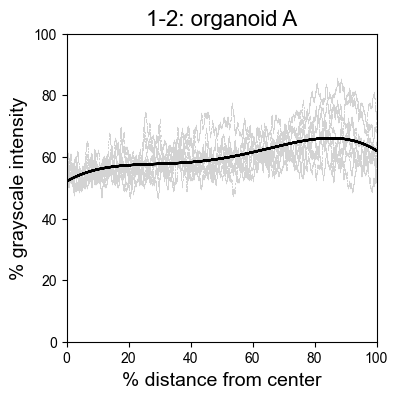

B


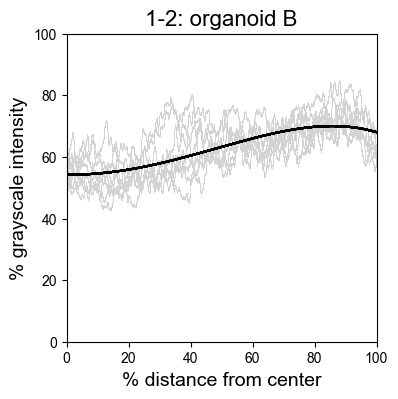

C


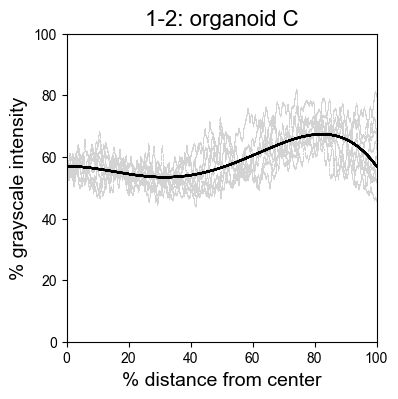

D


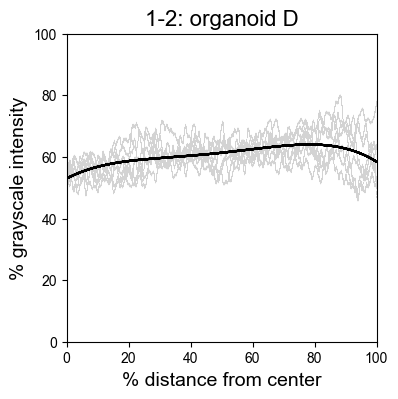

E


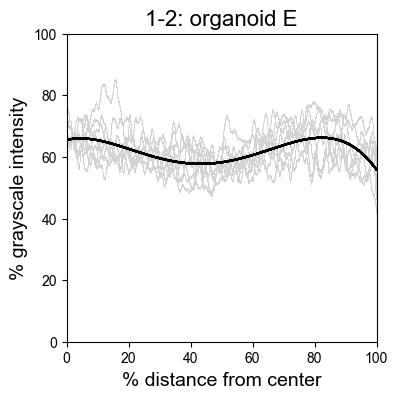

G


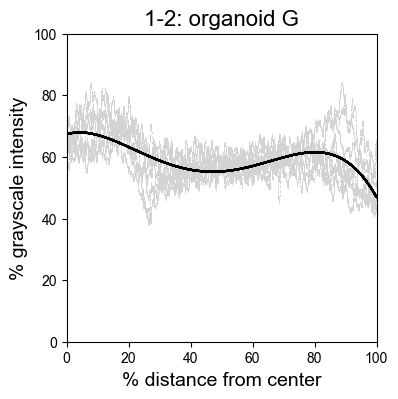

H


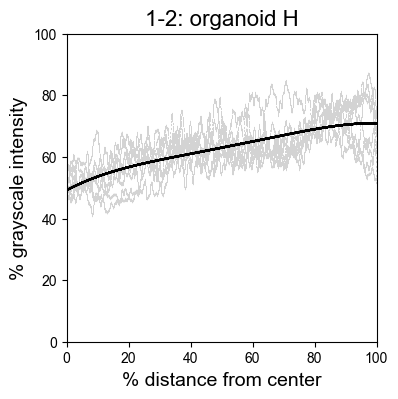

I


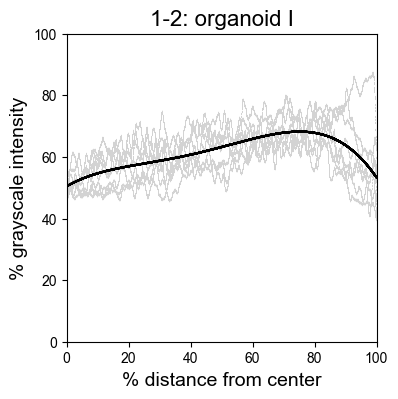

A


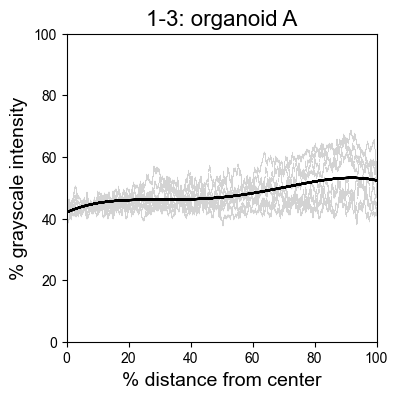

B


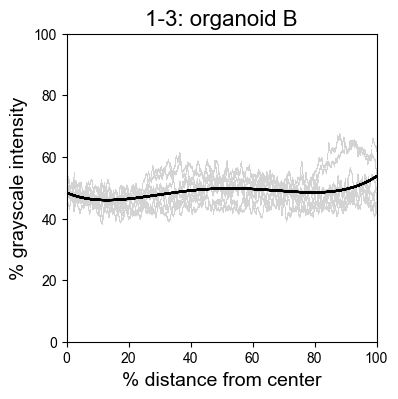

C


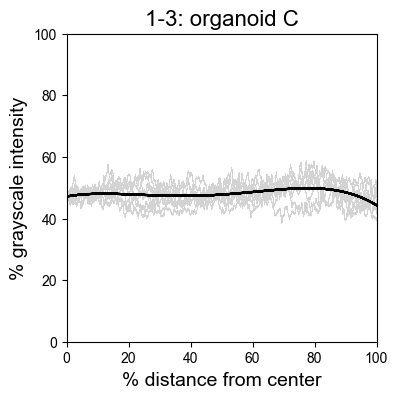

D


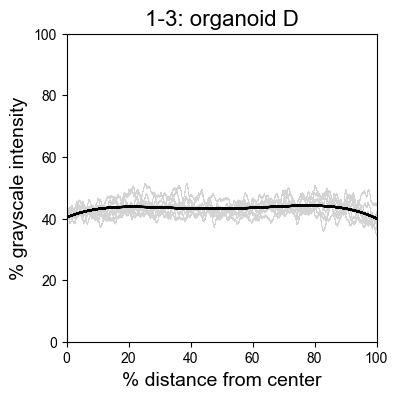

E


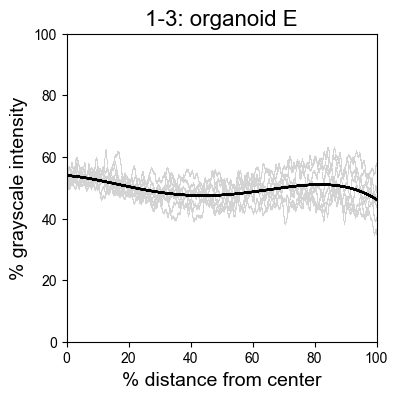

F


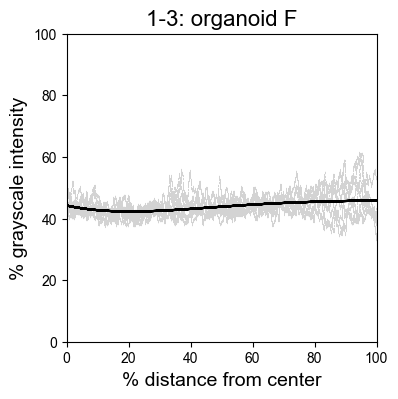

G


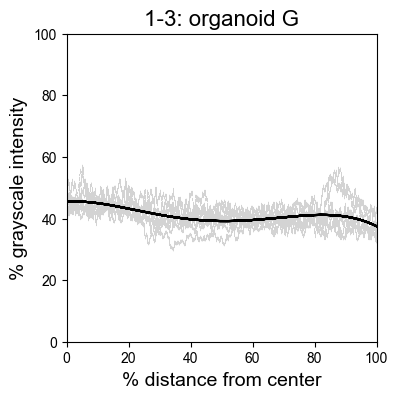

H


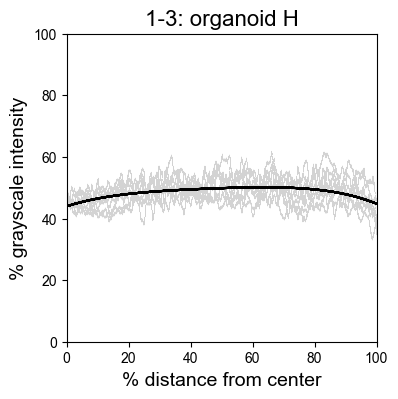

I


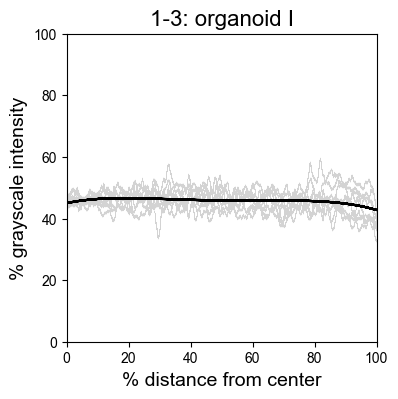

A


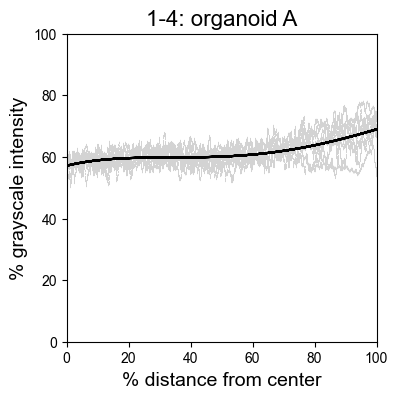

B


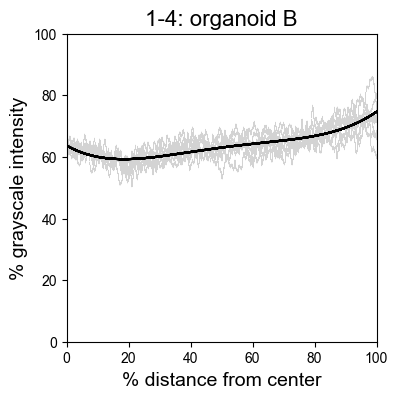

C


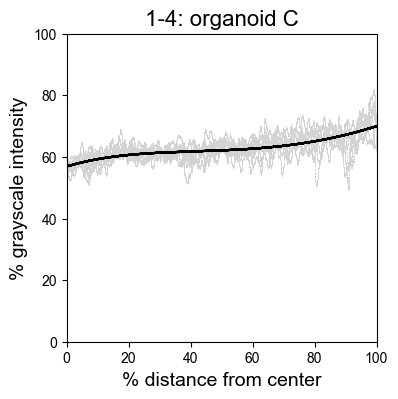

D


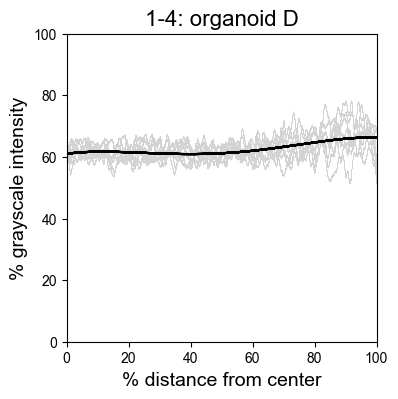

E


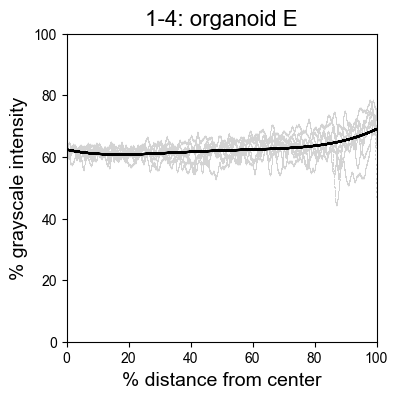

F


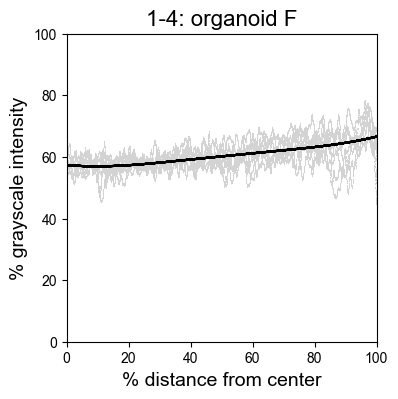

H


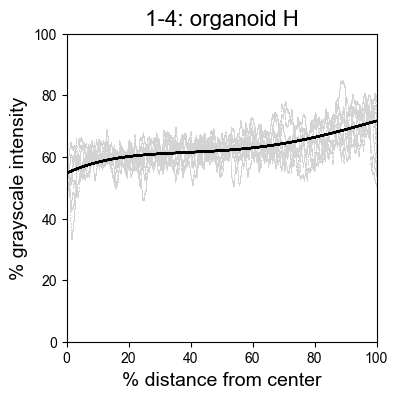

I


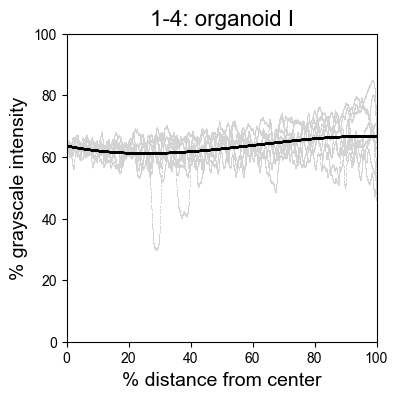

A


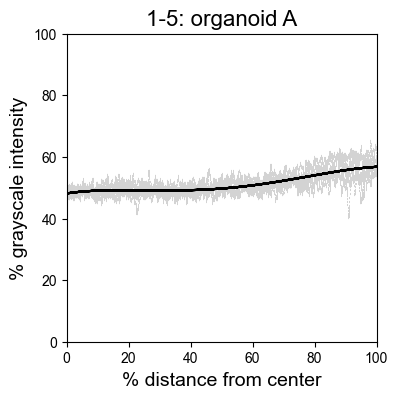

B


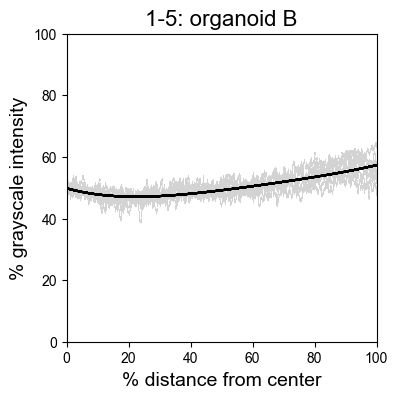

C


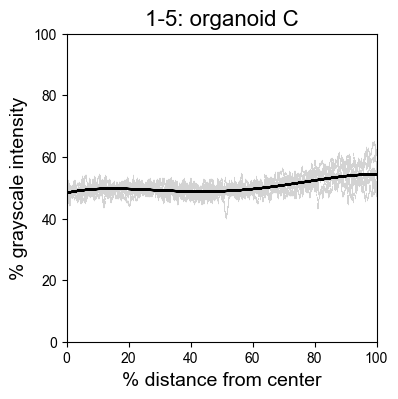

D


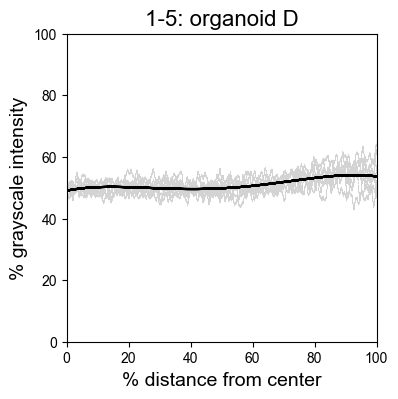

E


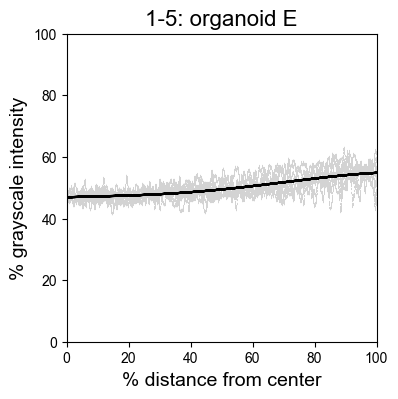

F


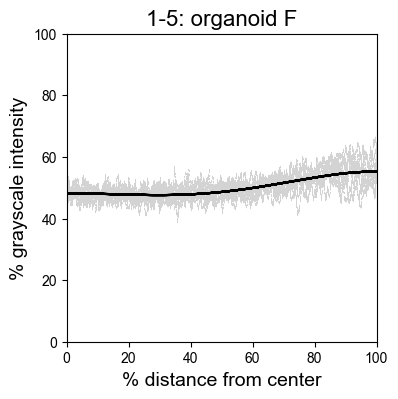

H


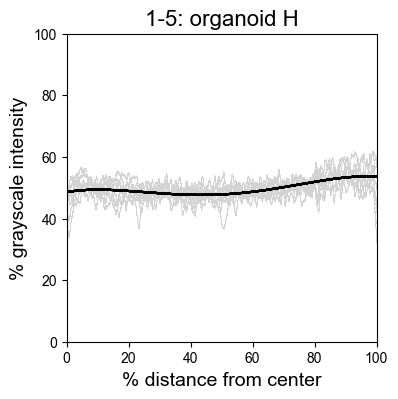

I


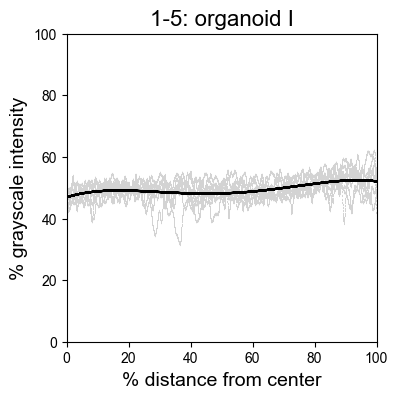

A


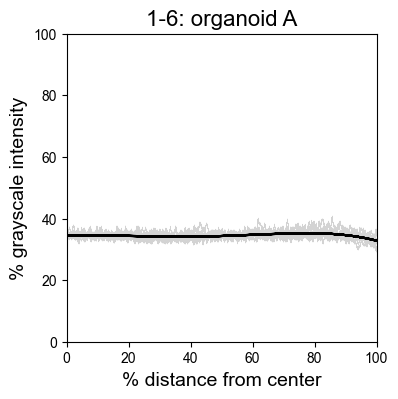

B


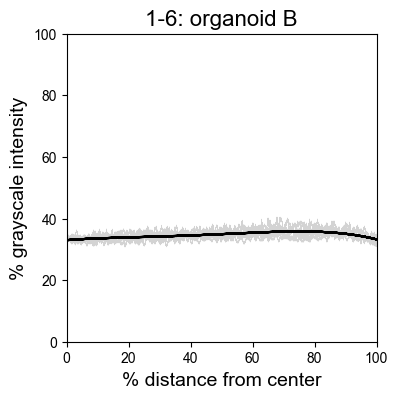

C


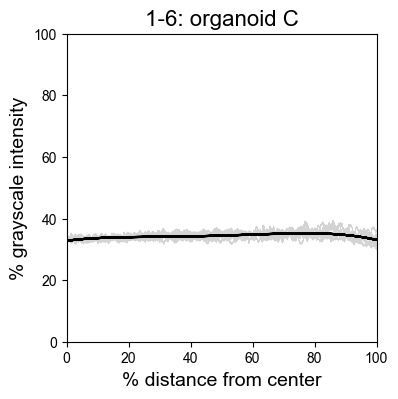

D


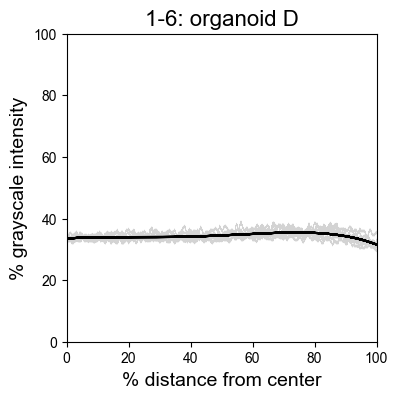

E


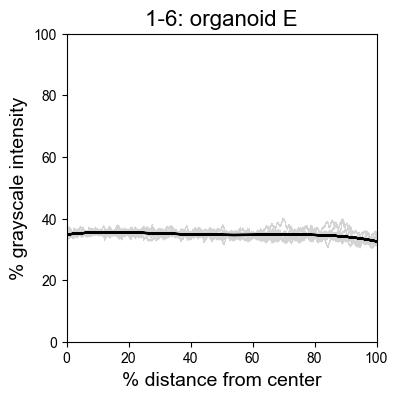

F


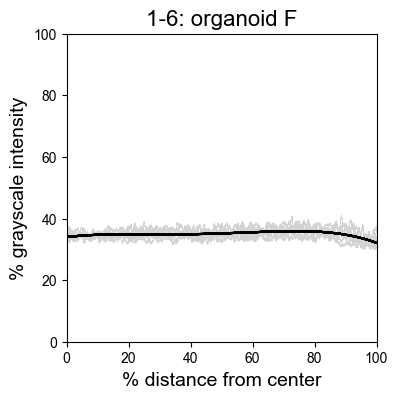

G


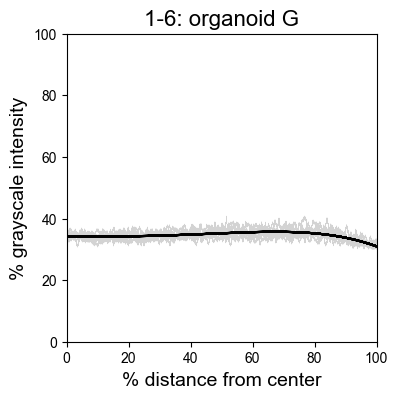

H


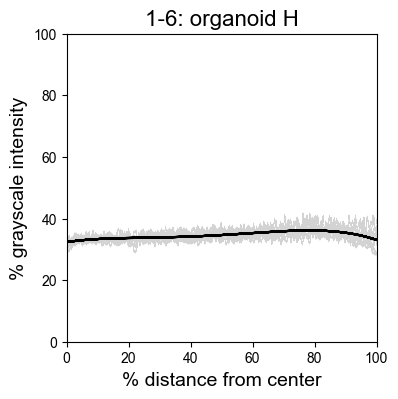

I


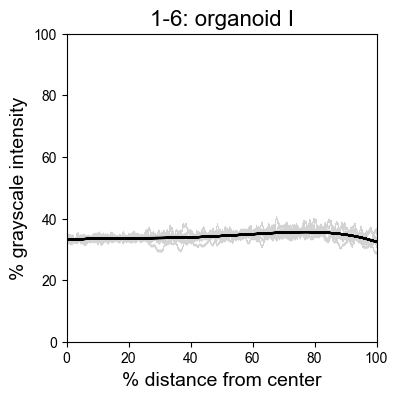

A


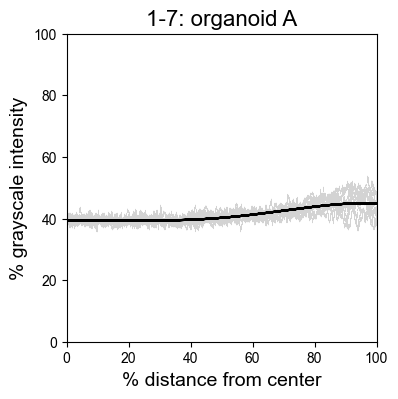

B


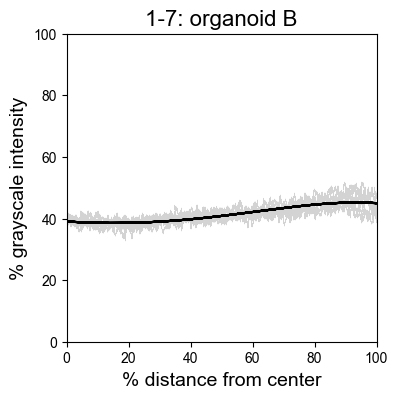

C


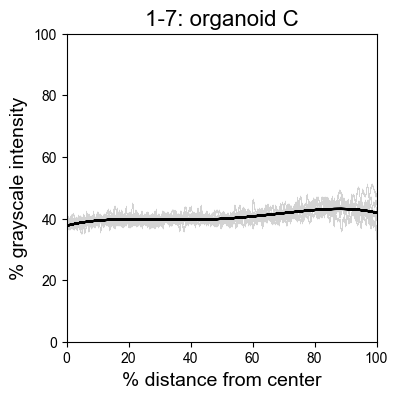

D


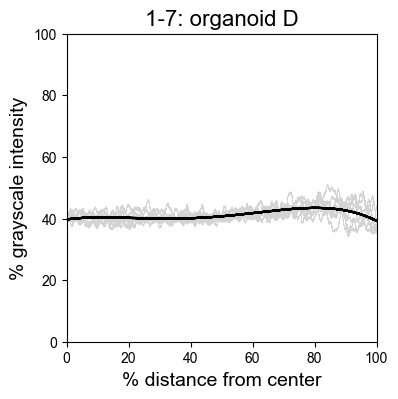

E


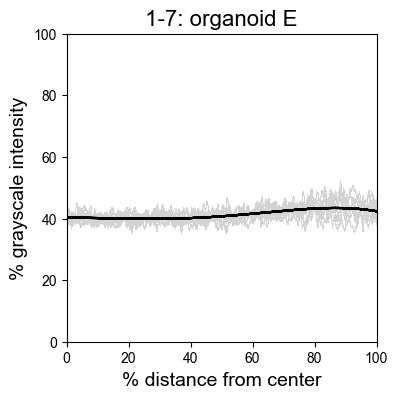

F


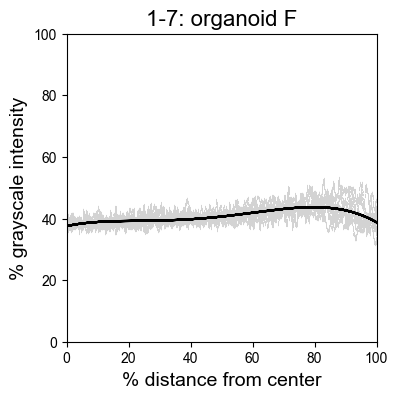

G


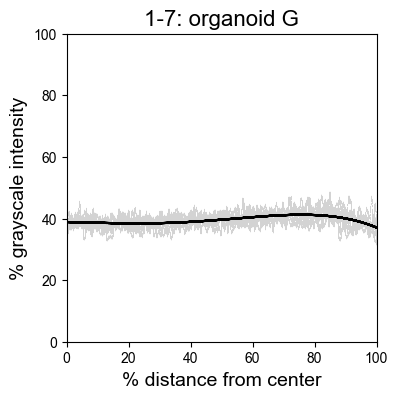

H


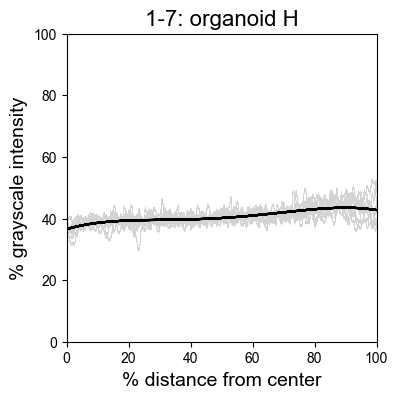

I


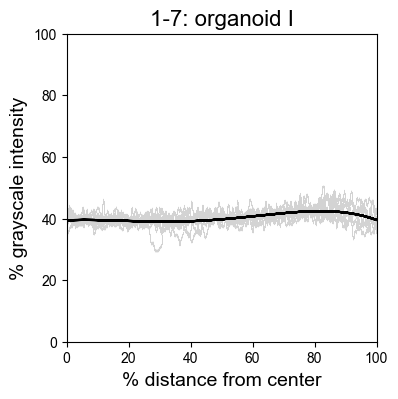

A


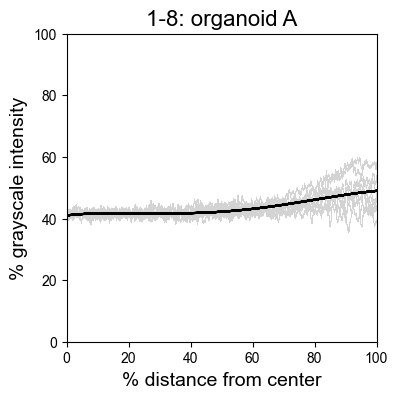

B


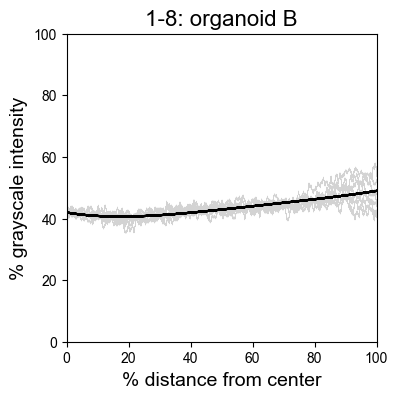

C


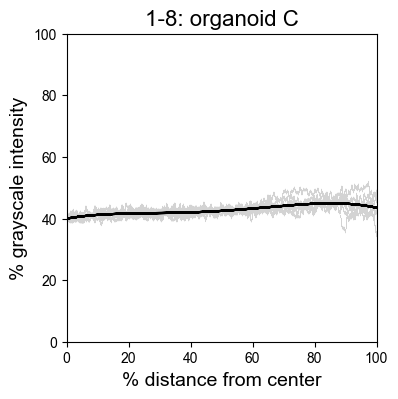

D


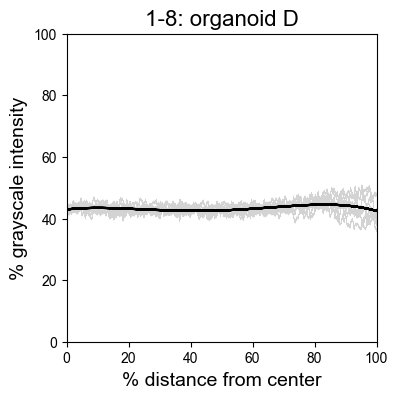

E


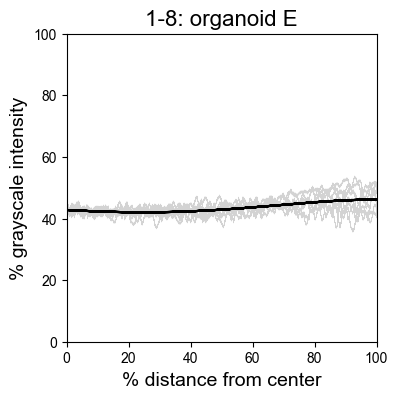

F


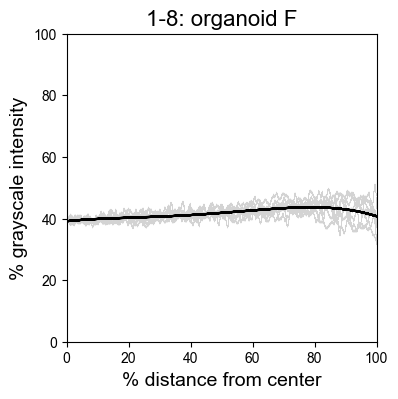

G


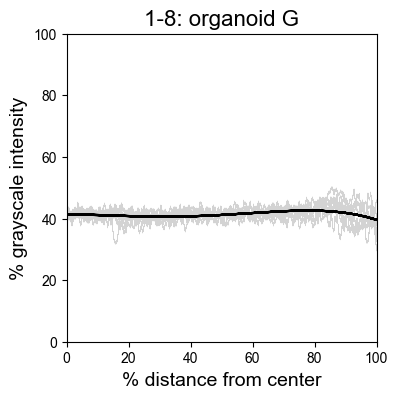

H


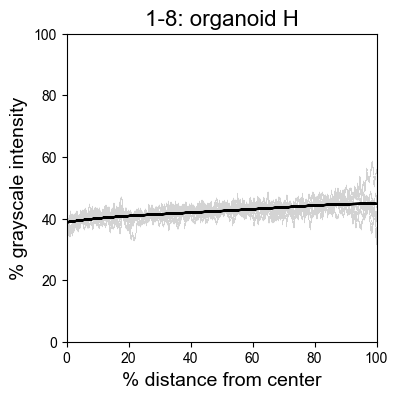

I


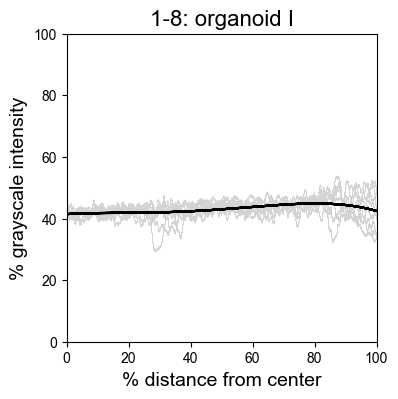

A


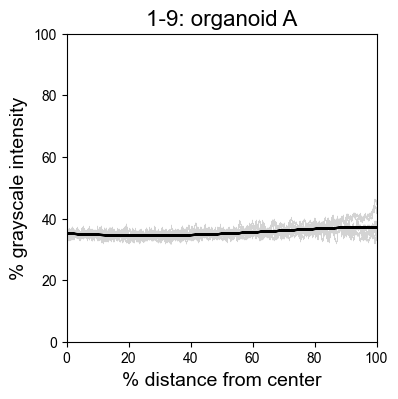

B


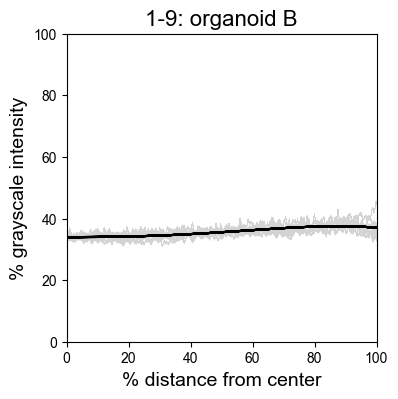

C


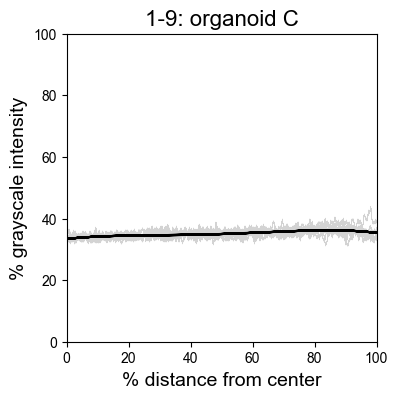

D


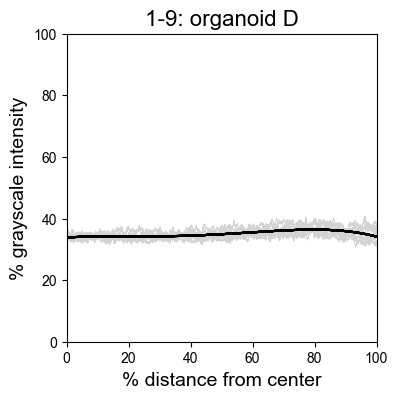

E


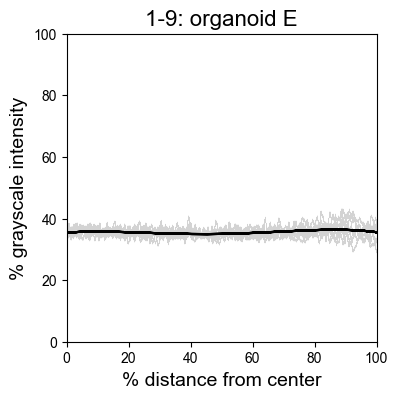

F


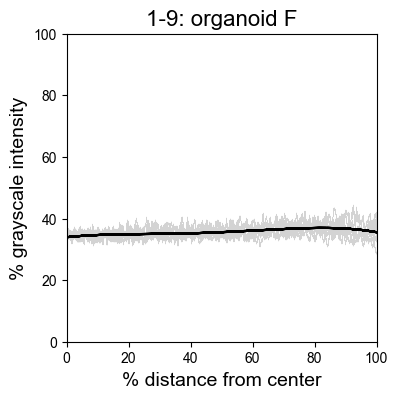

G


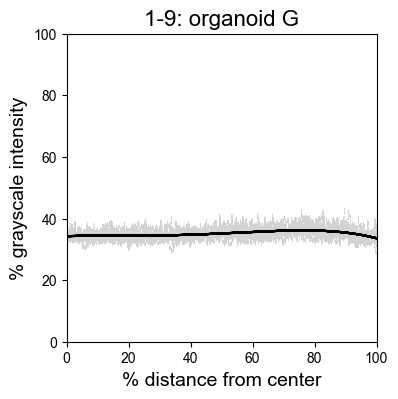

H


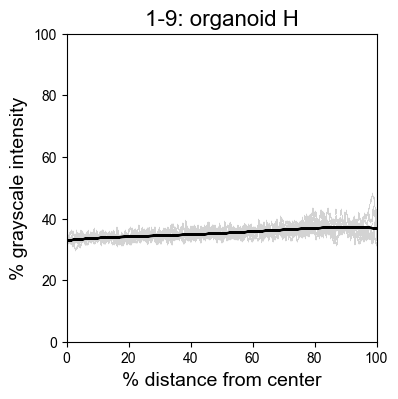

I


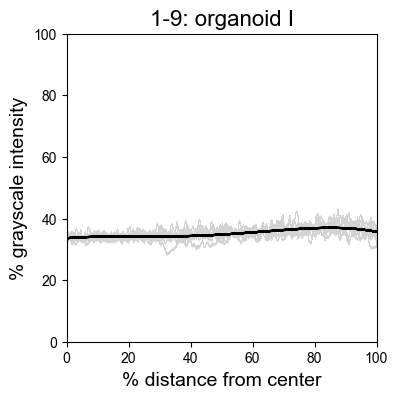

A


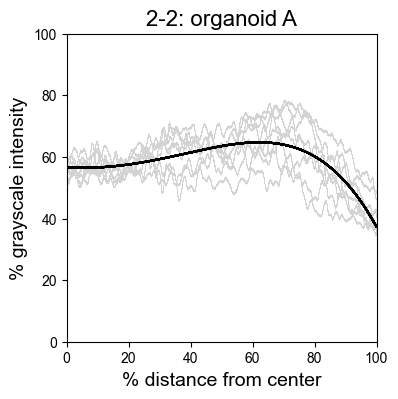

B


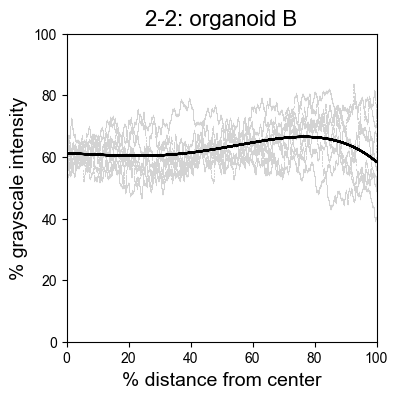

C


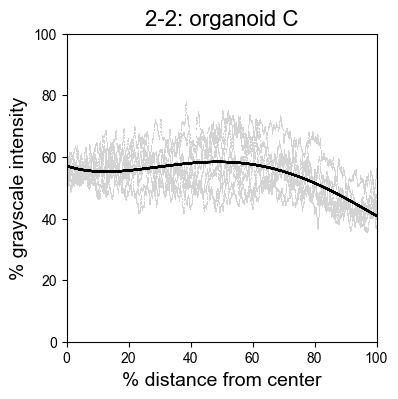

D


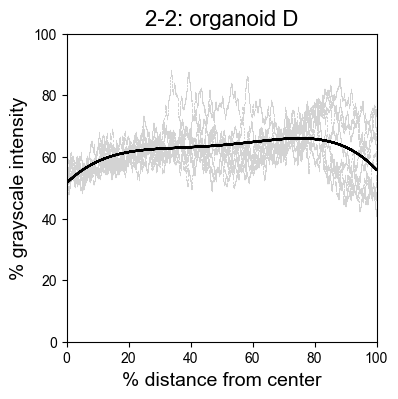

E


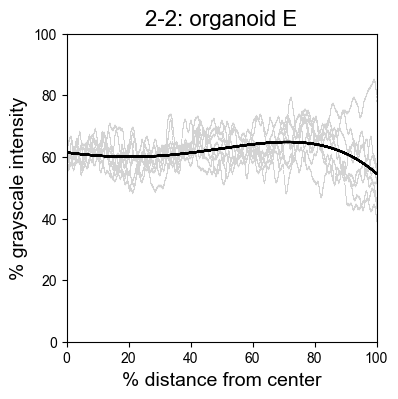

F


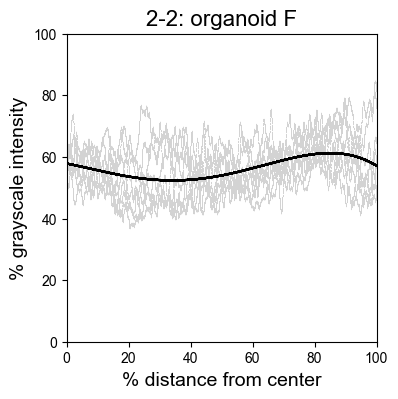

G


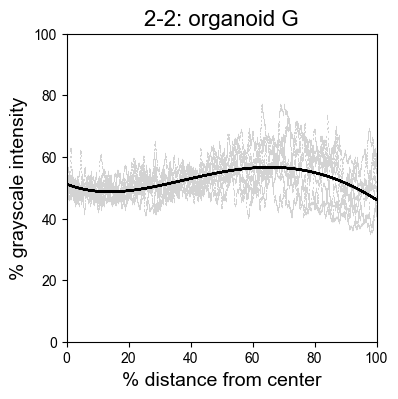

H


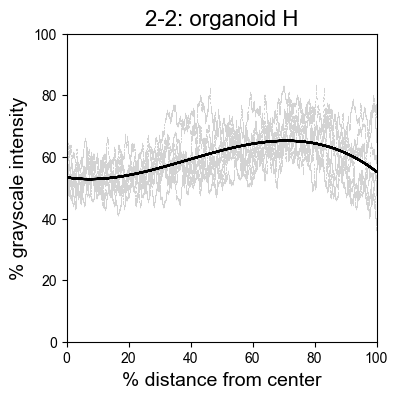

A


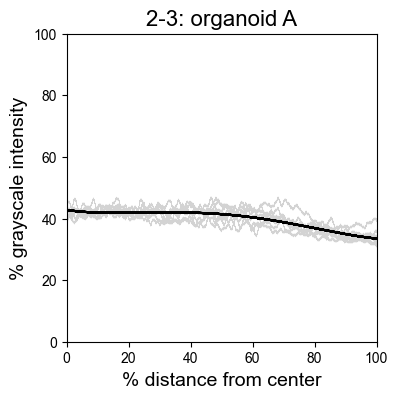

B


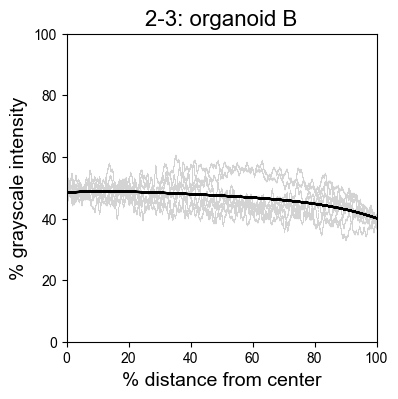

C


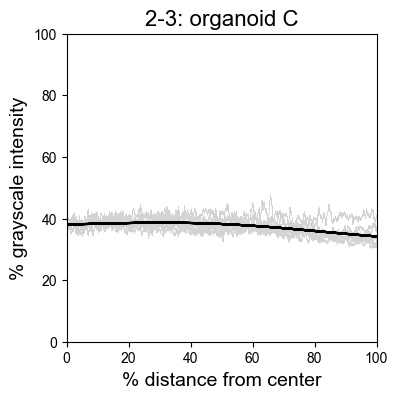

D


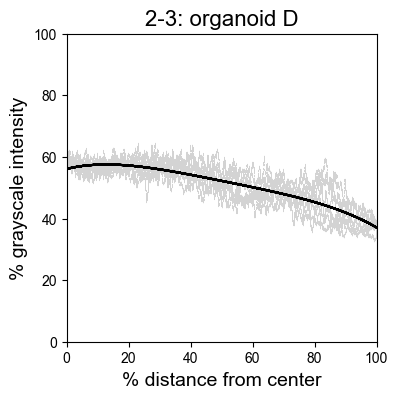

E


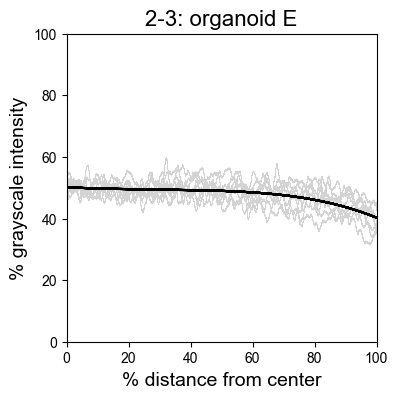

F


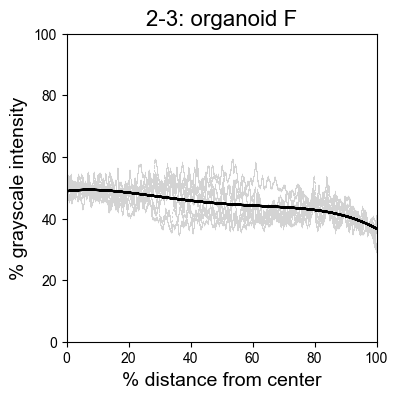

H


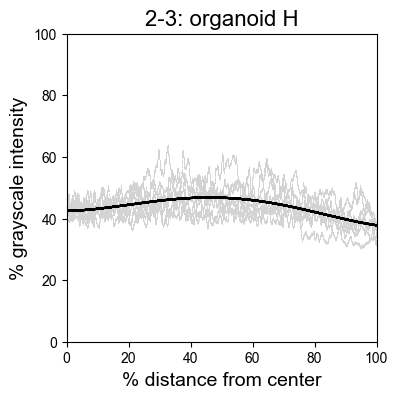

A


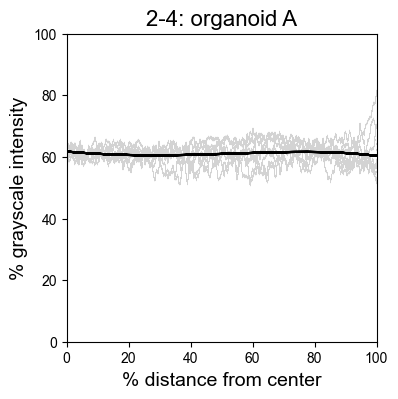

B


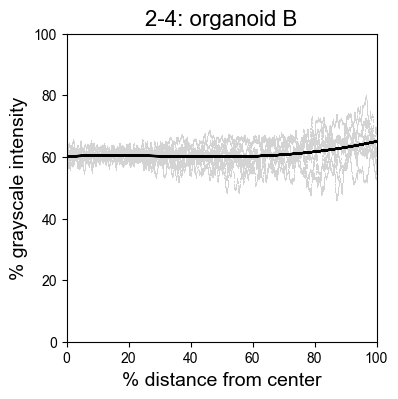

C


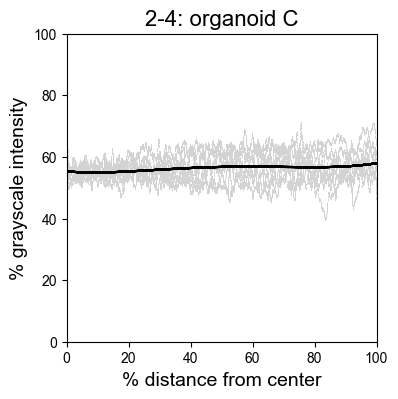

D


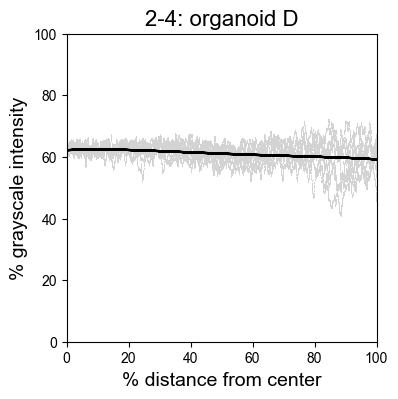

E


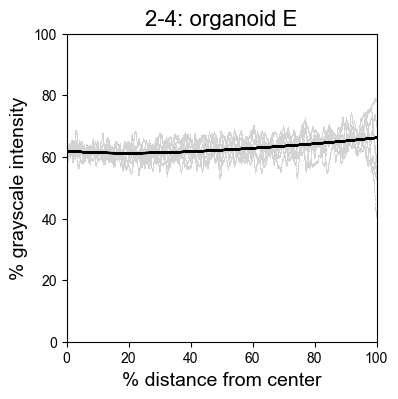

F


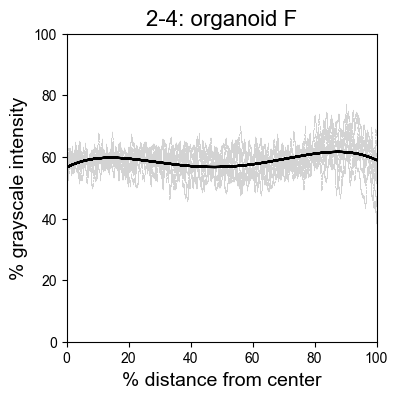

G


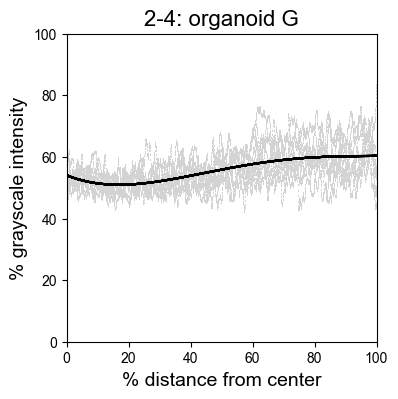

H


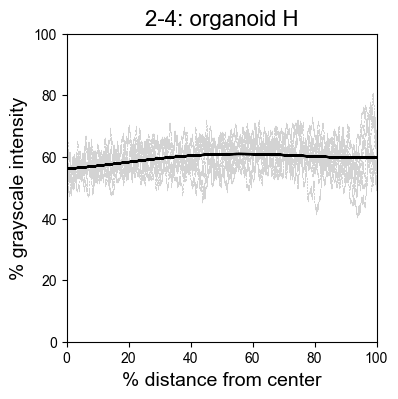

A


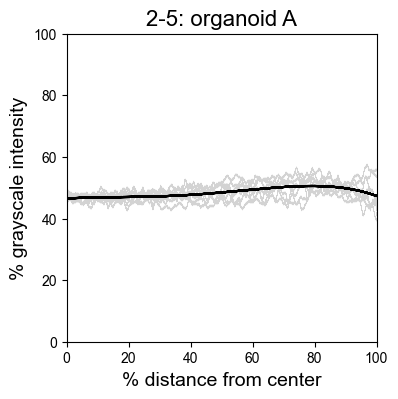

B


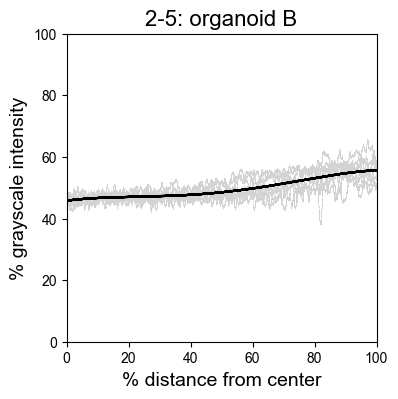

C


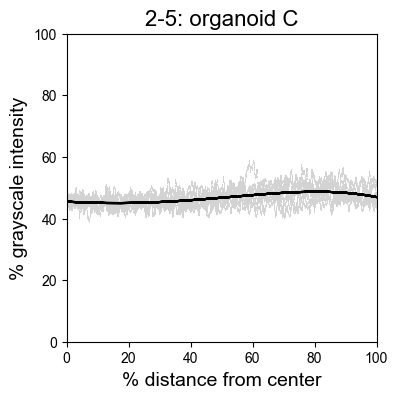

D


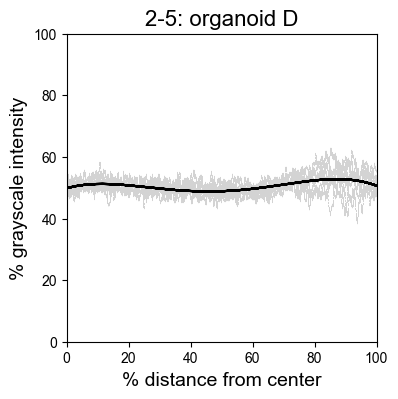

E


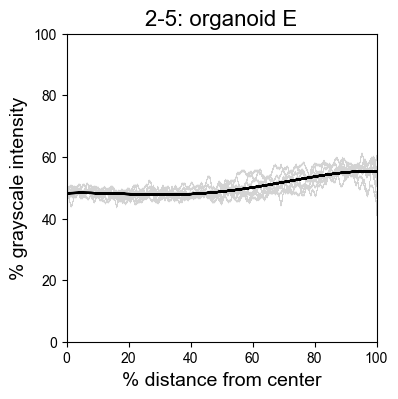

F


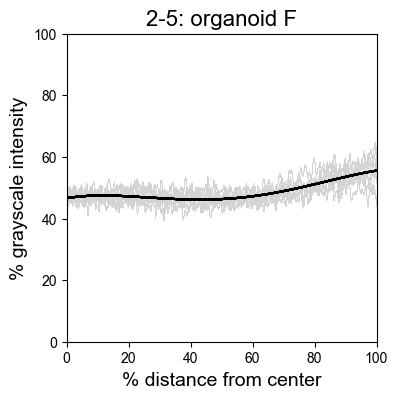

G


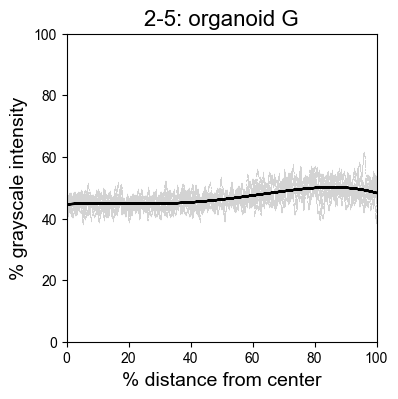

H


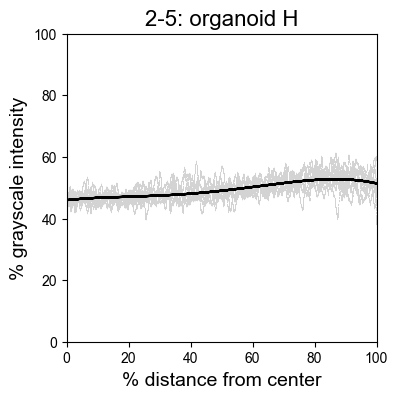

A


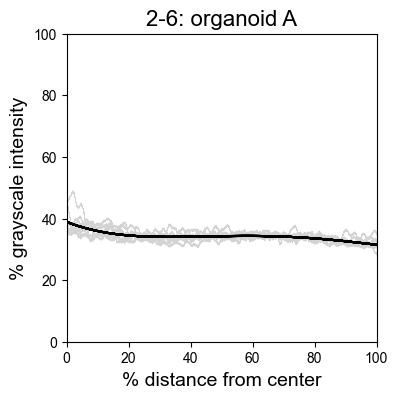

B


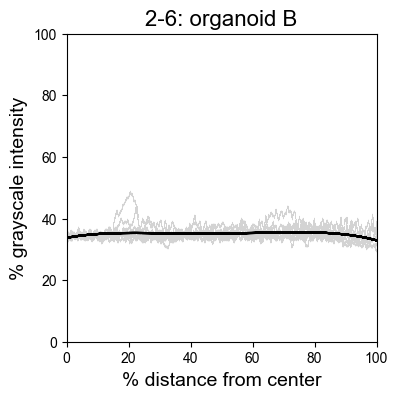

C


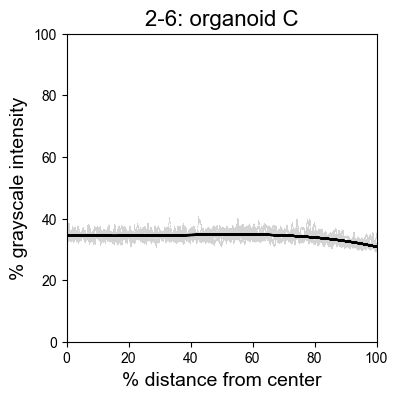

D


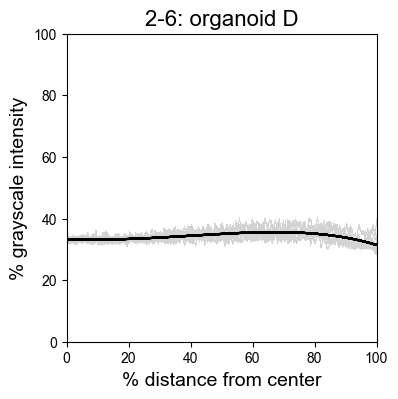

E


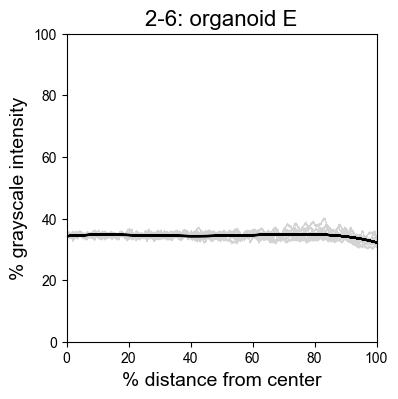

F


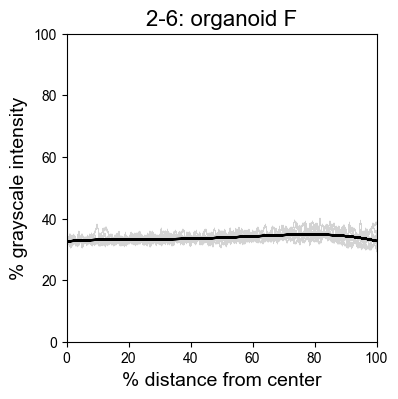

G


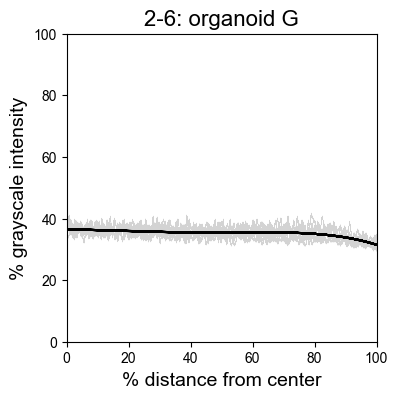

H


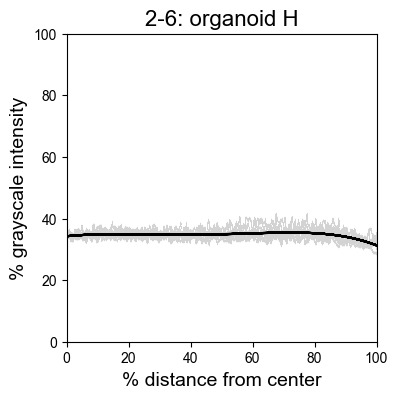

A


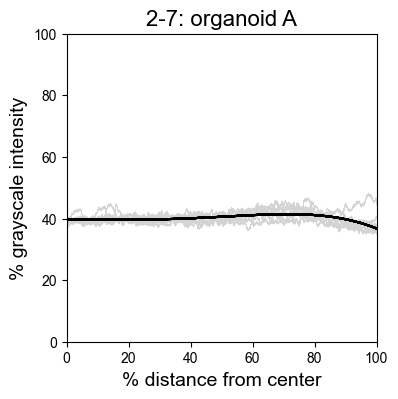

B


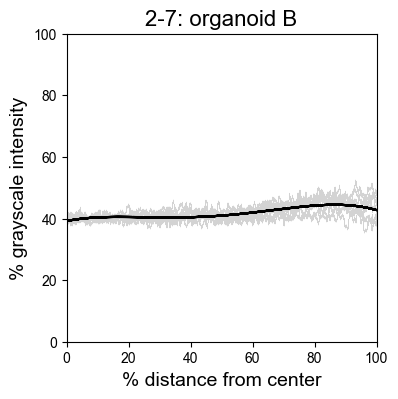

C


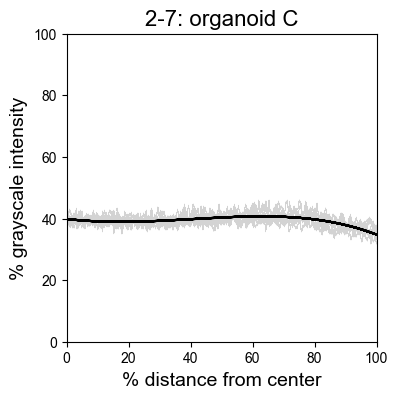

D


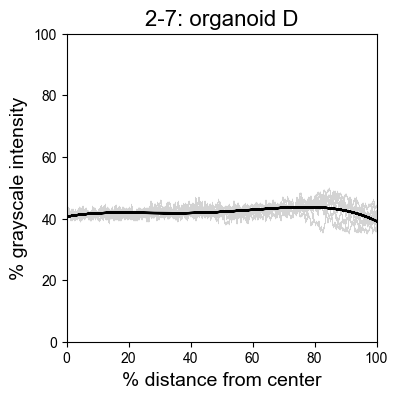

E


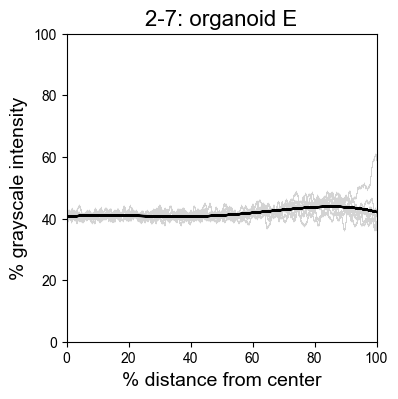

F


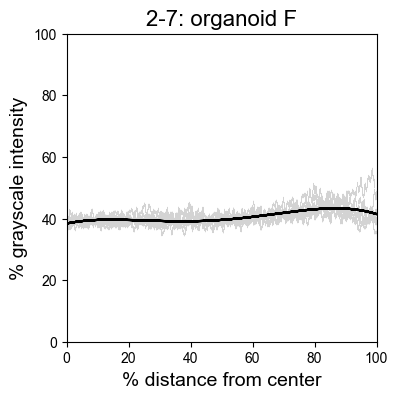

G


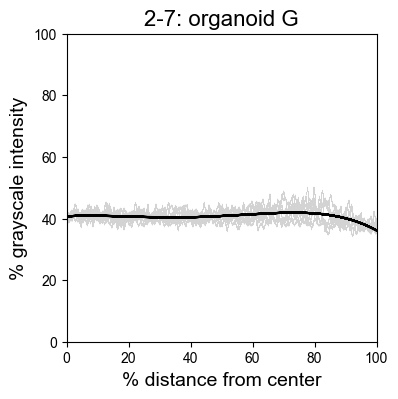

H


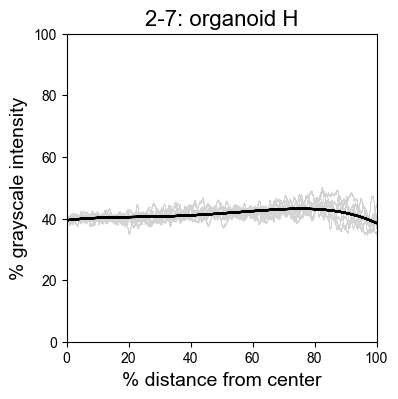

A


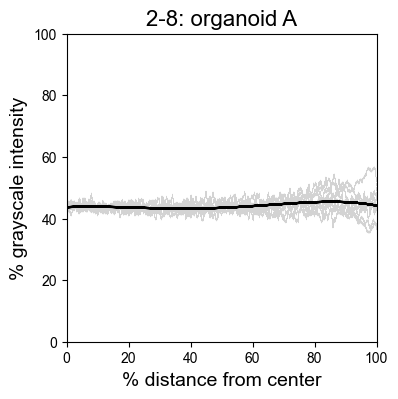

B


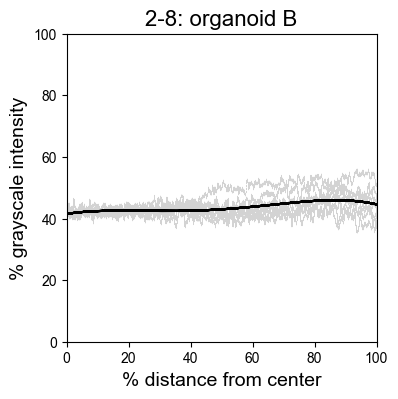

C


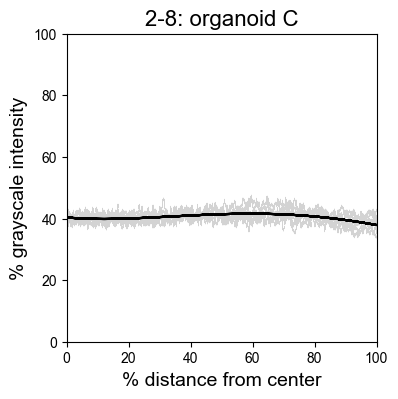

D


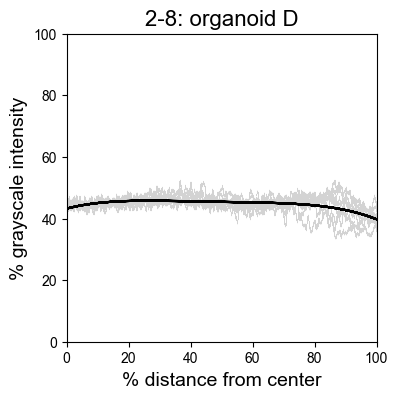

E


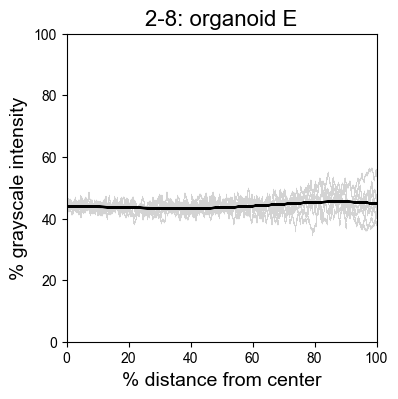

F


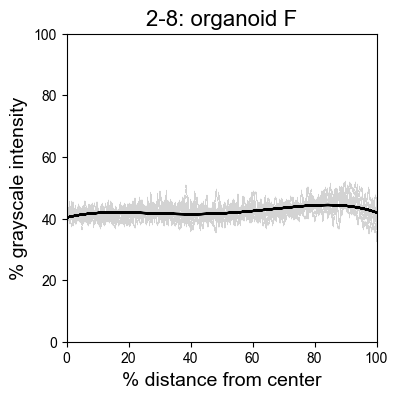

G


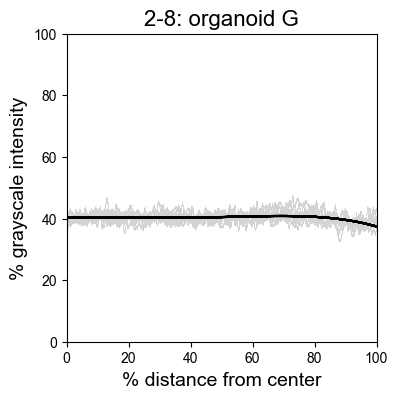

H


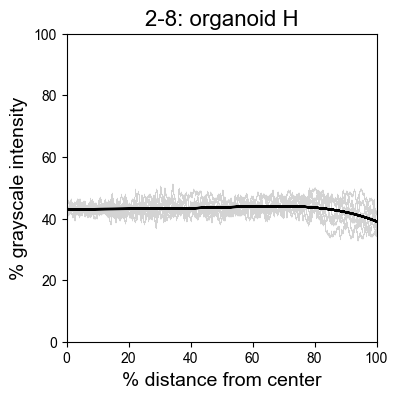

A


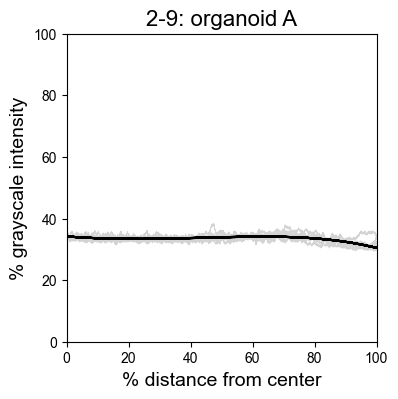

B


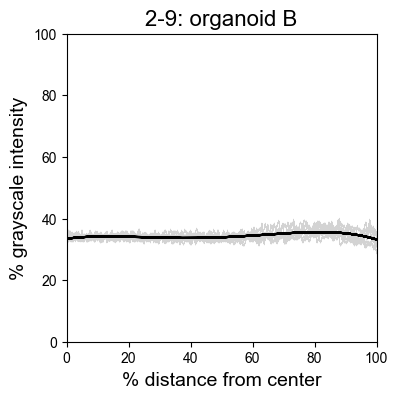

C


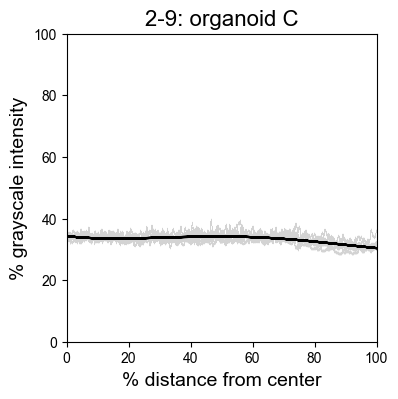

D


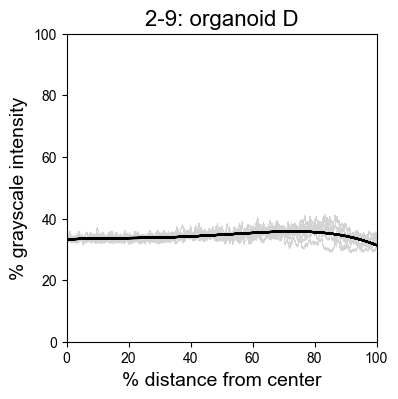

E


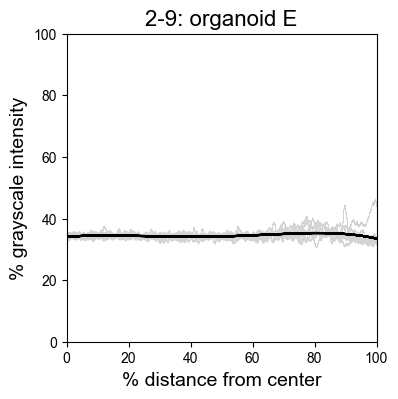

F


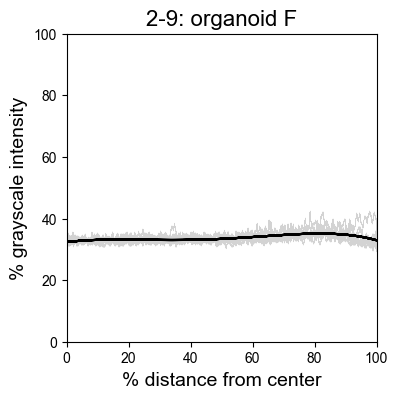

G


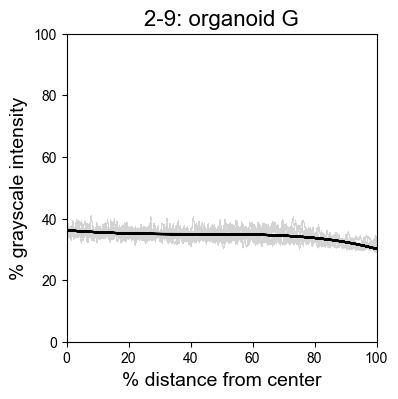

H


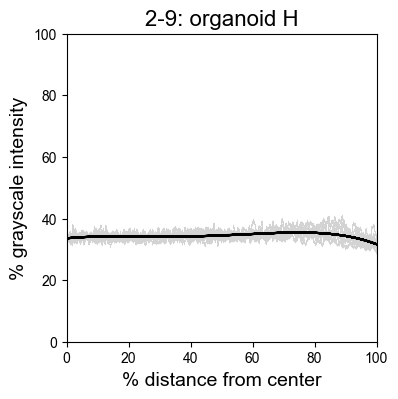

A


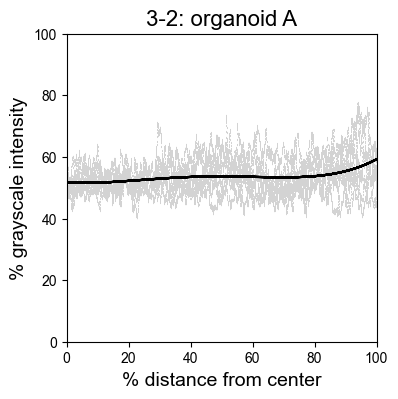

B


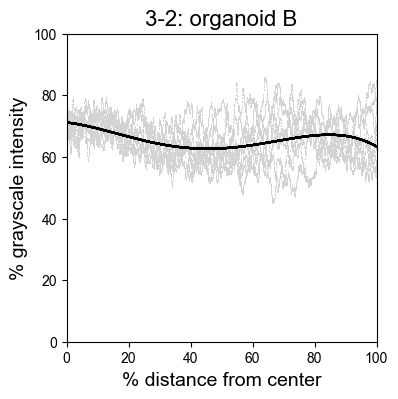

C


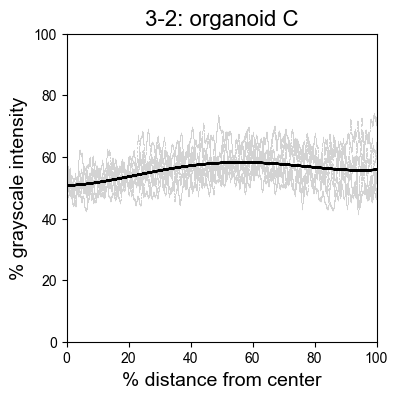

D


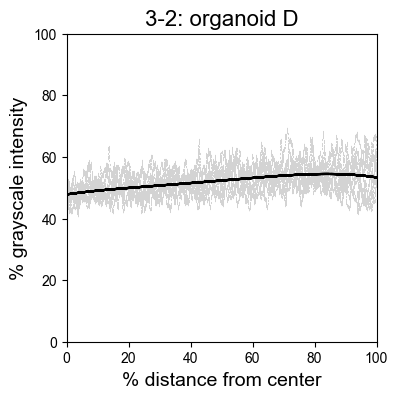

E


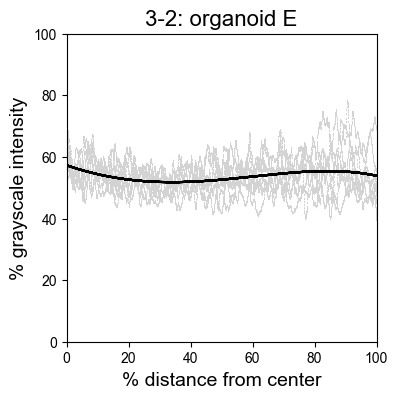

F


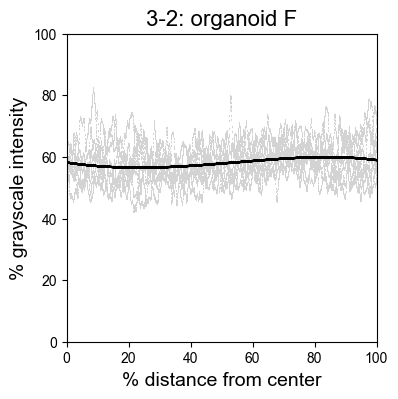

A


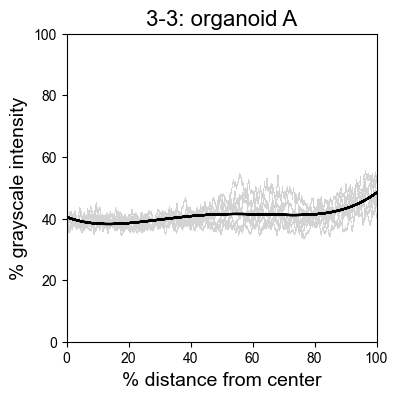

B


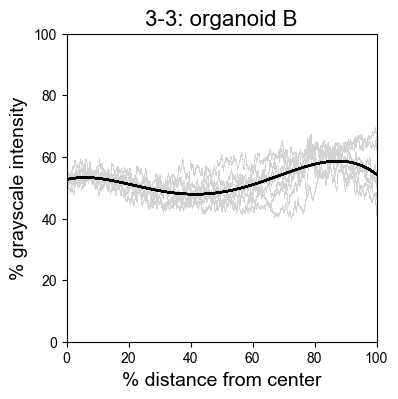

C


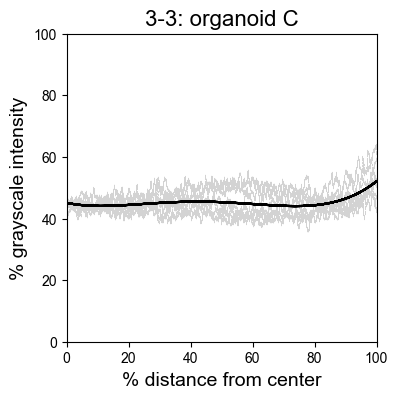

D


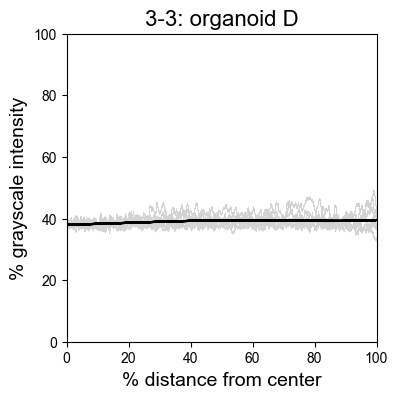

E


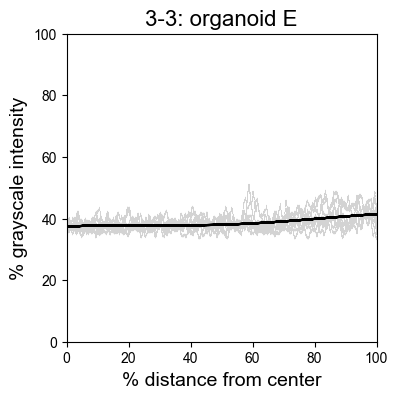

F


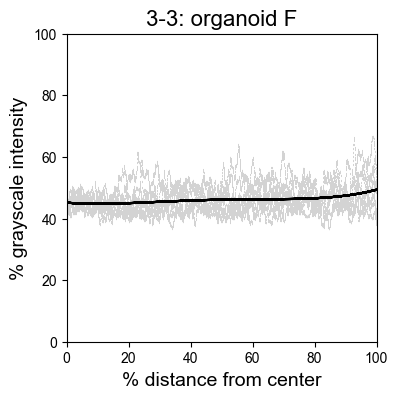

I


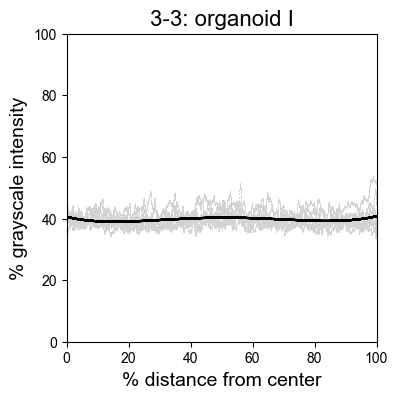

A


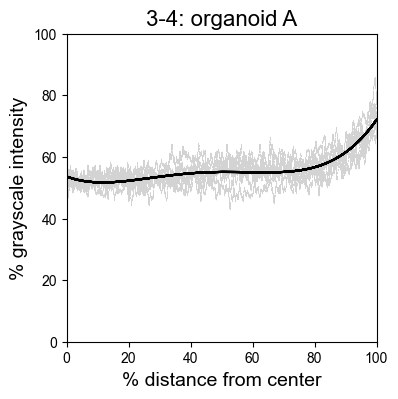

B


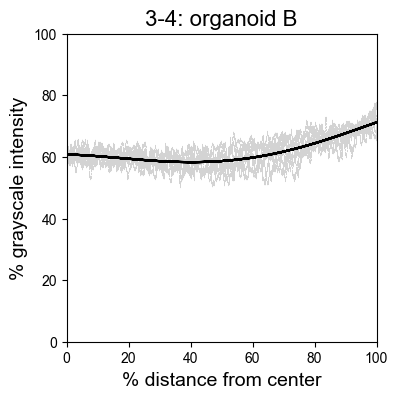

C


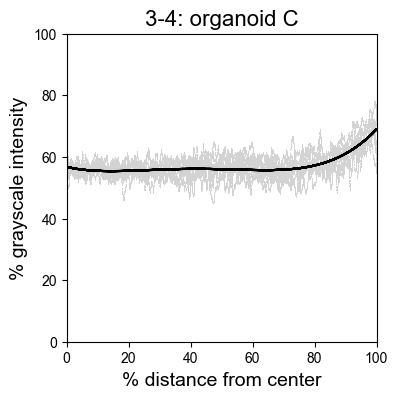

D


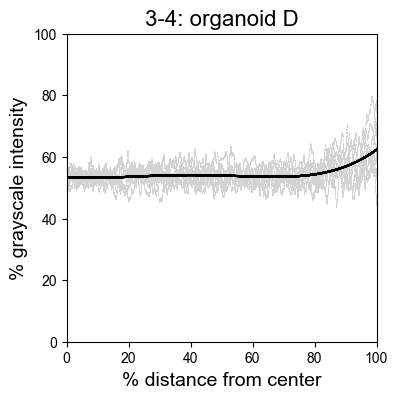

E


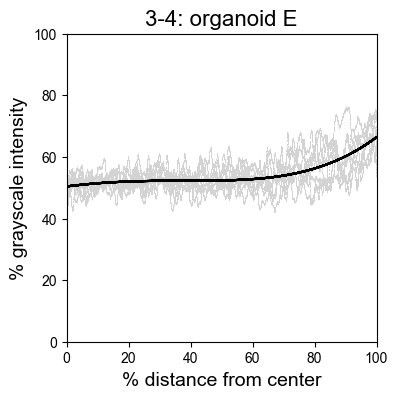

F


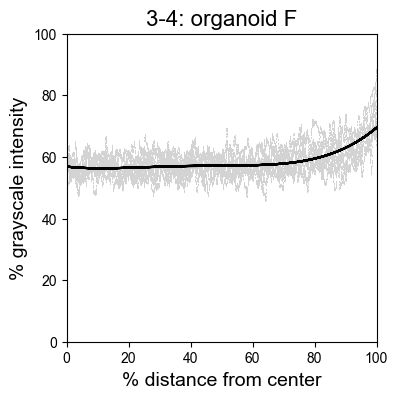

I


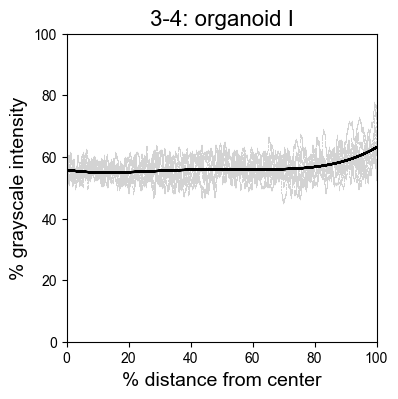

A


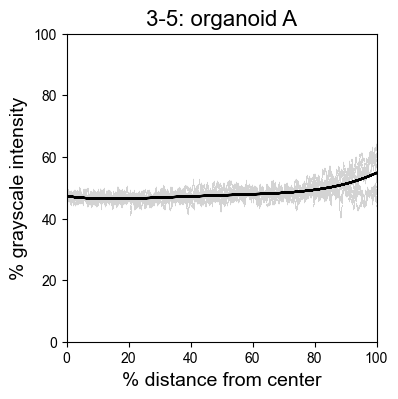

B


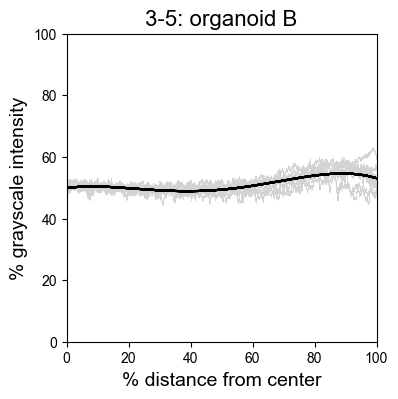

C


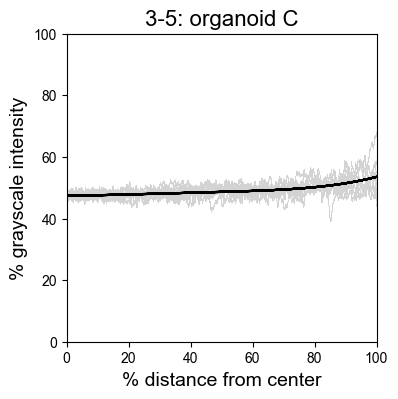

D


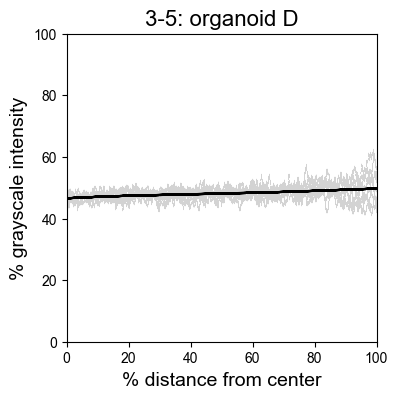

E


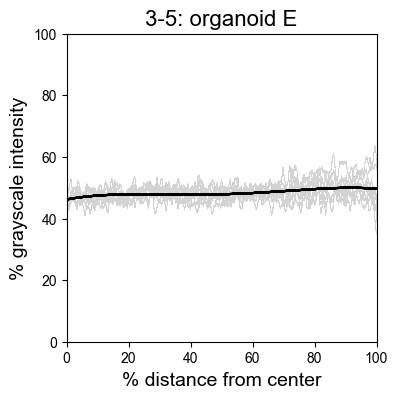

F


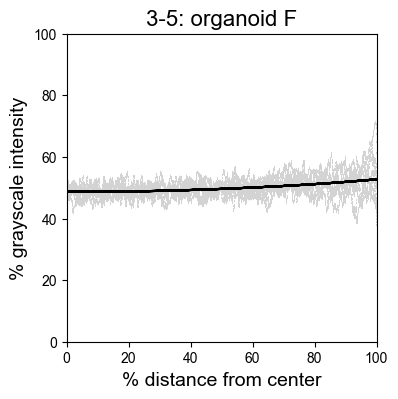

I


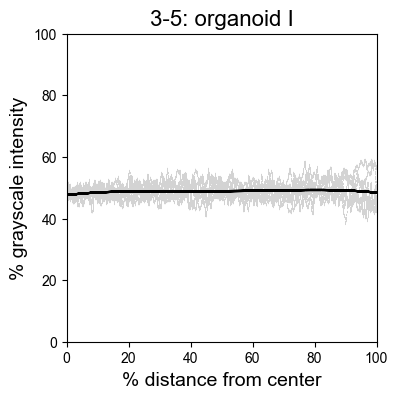

A


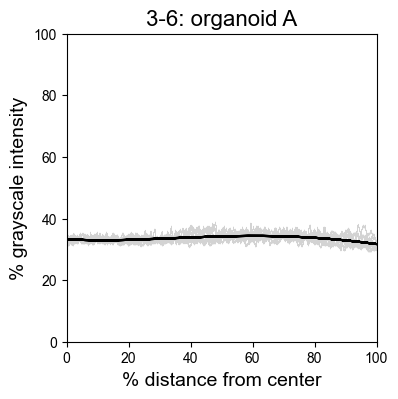

B


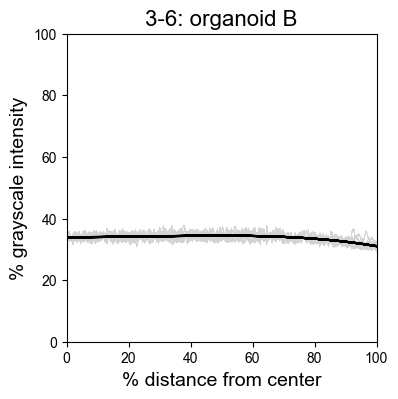

C


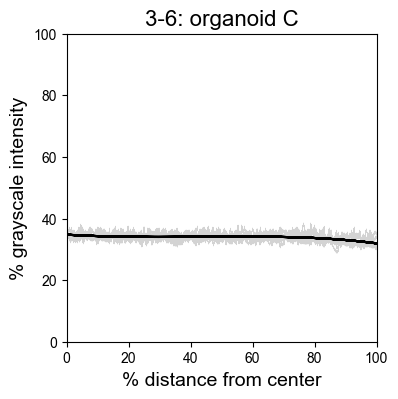

D


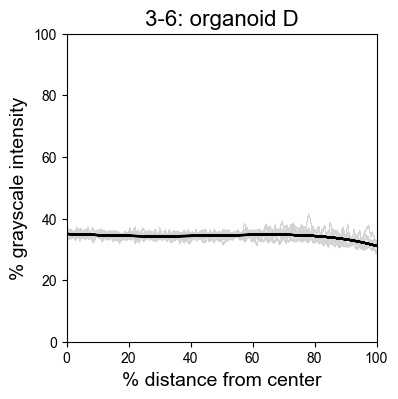

E


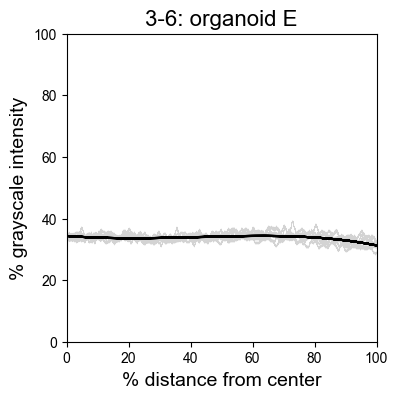

F


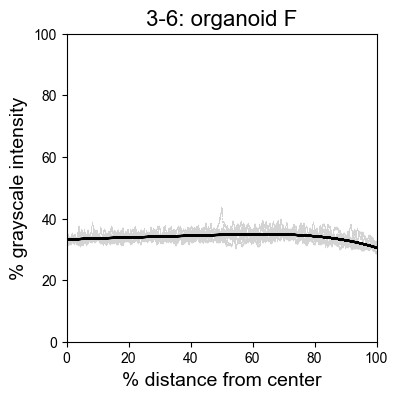

I


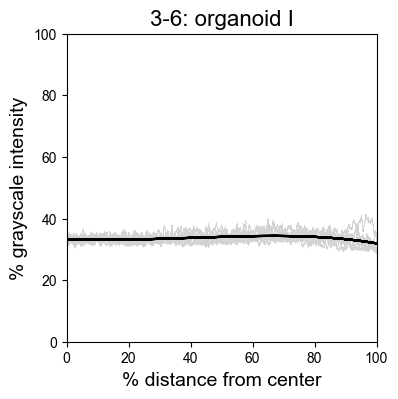

A


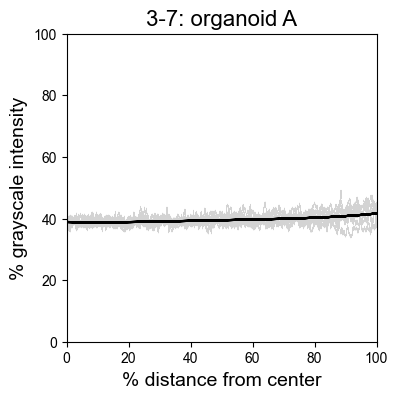

B


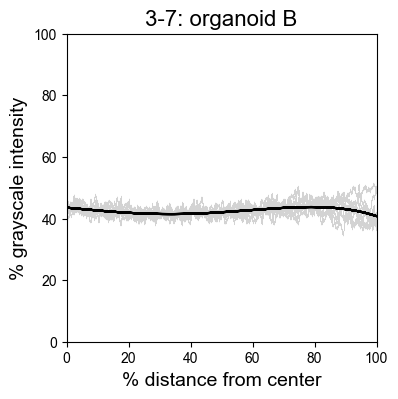

C


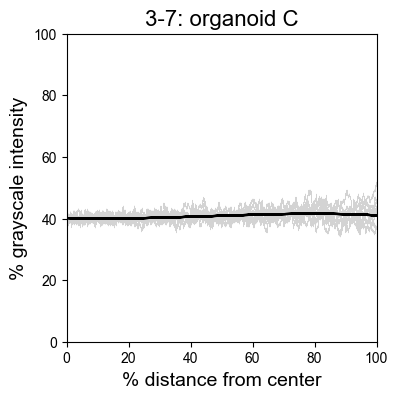

D


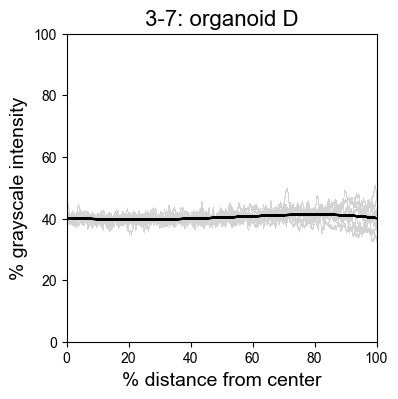

E


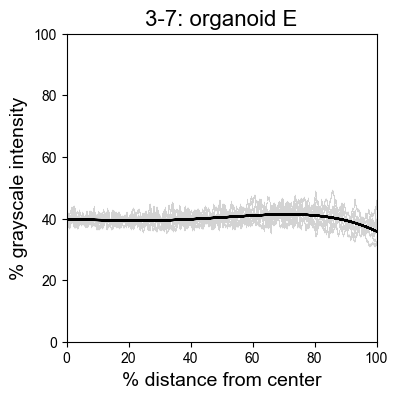

F


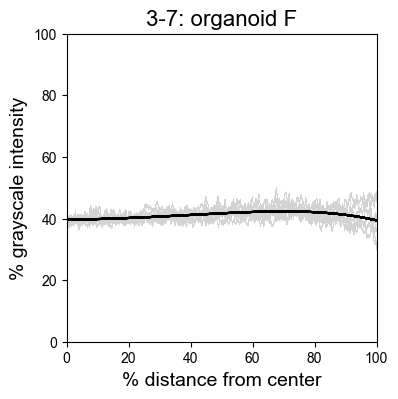

I


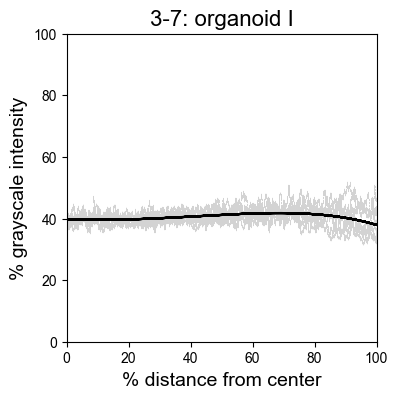

A


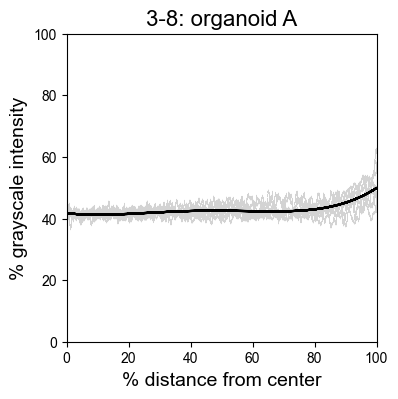

B


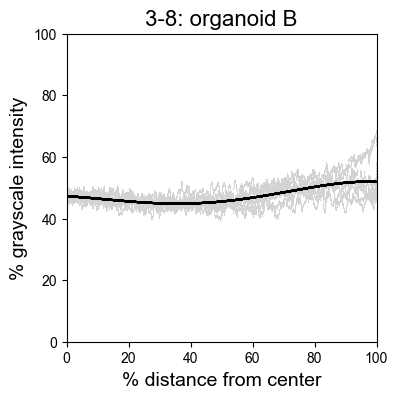

C


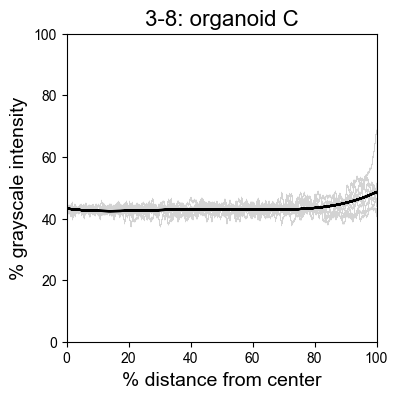

D


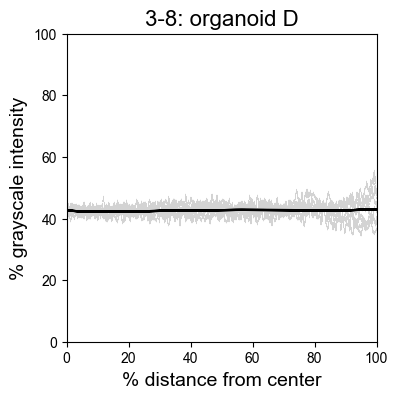

E


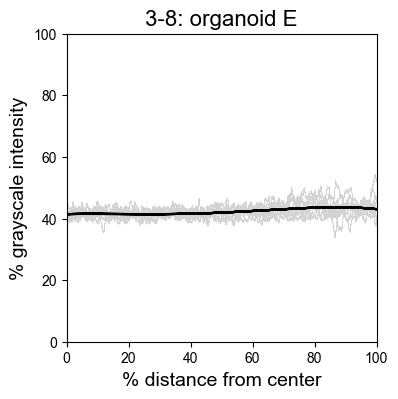

F


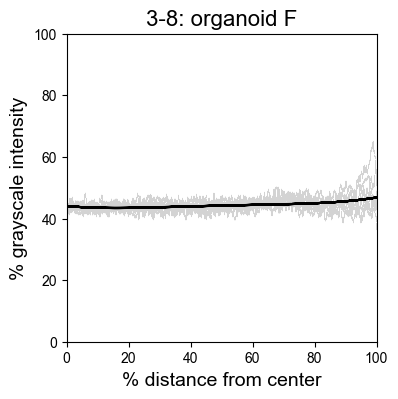

I


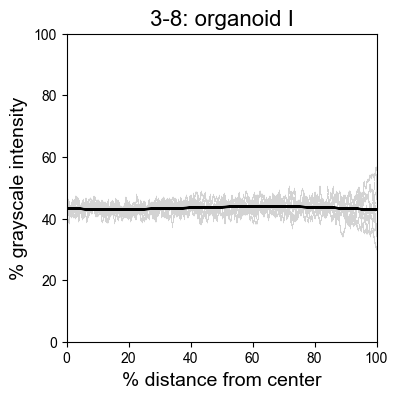

A


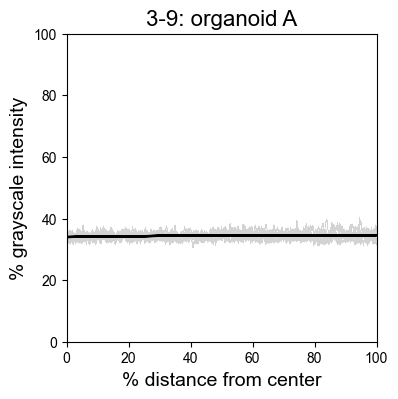

B


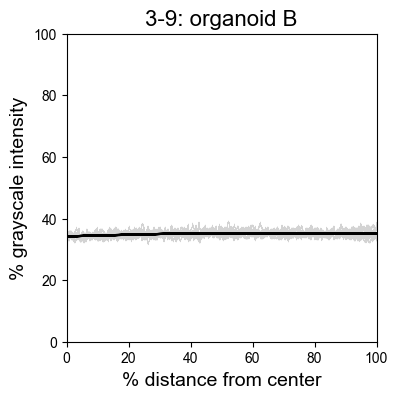

C


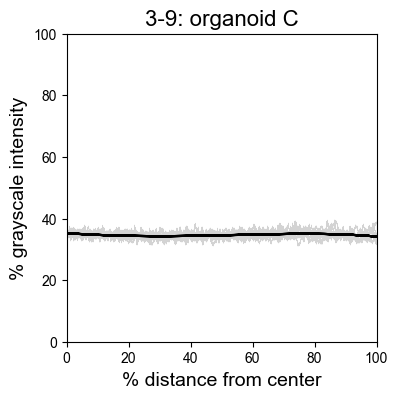

D


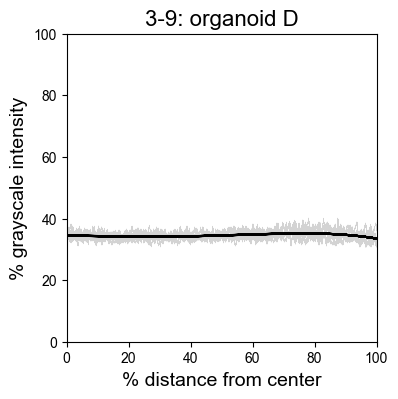

E


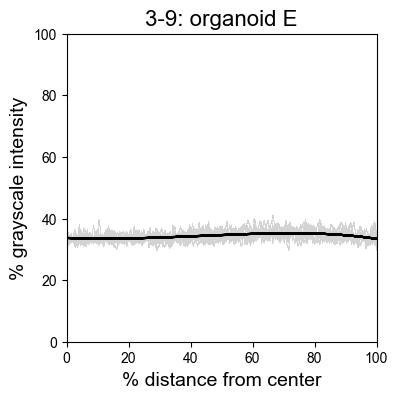

F


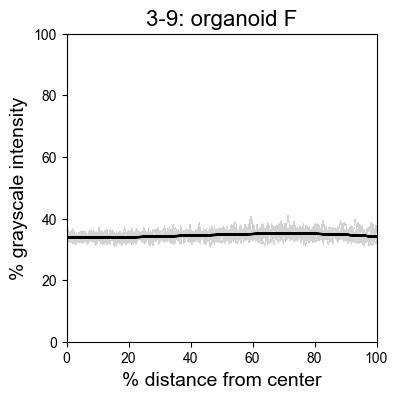

I


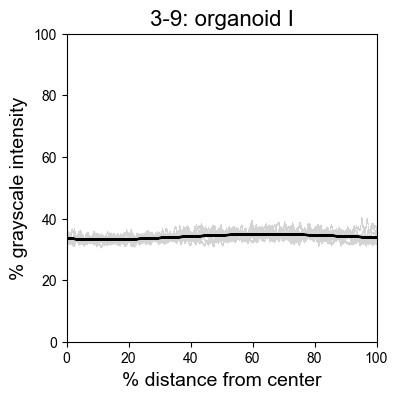

A


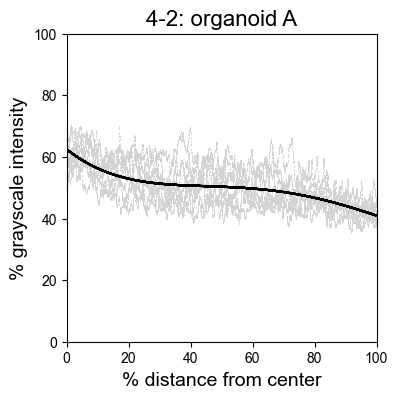

B


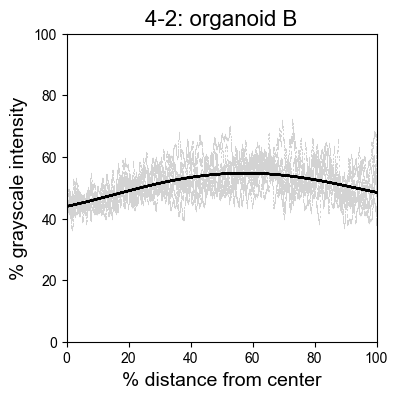

C


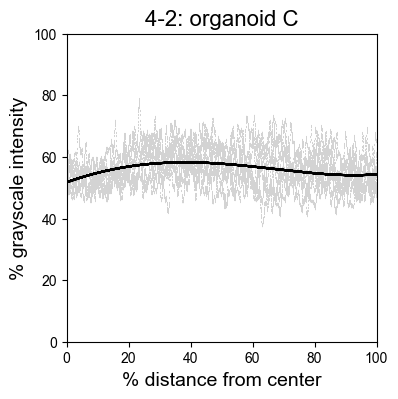

D


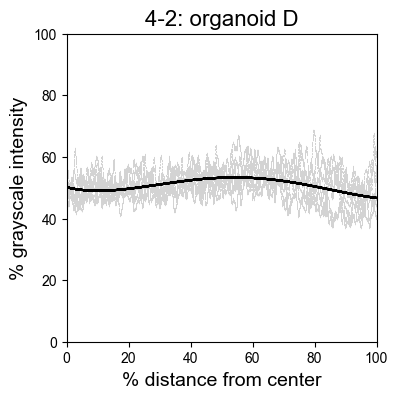

E


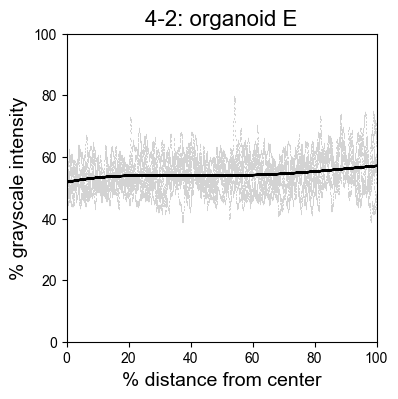

F


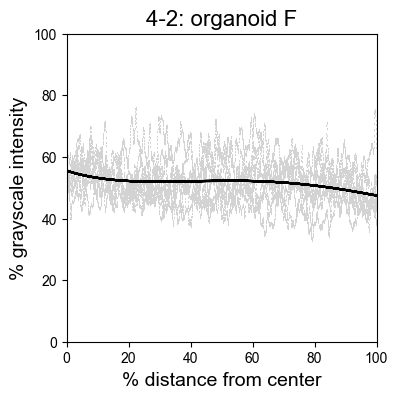

G


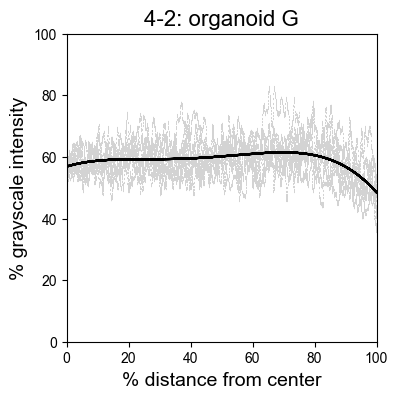

H


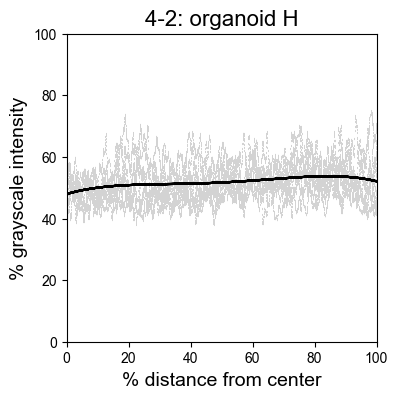

A


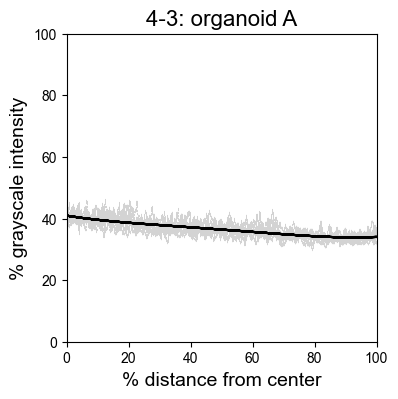

B


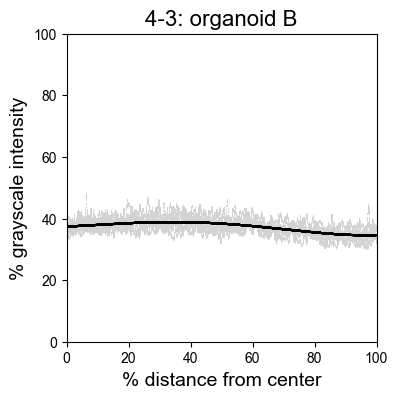

C


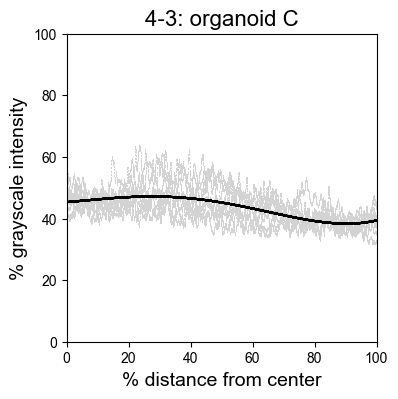

D


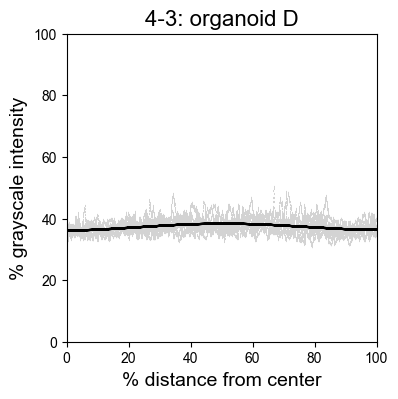

E


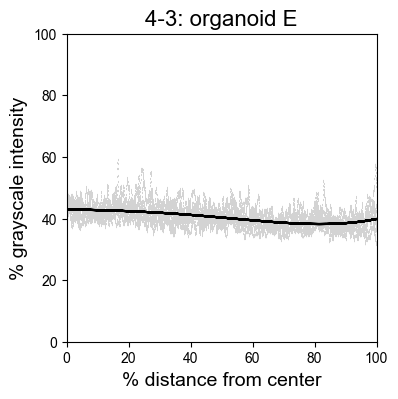

F


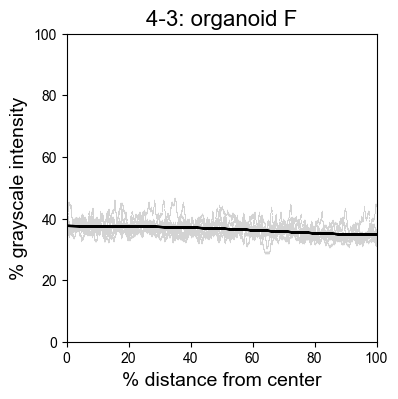

G


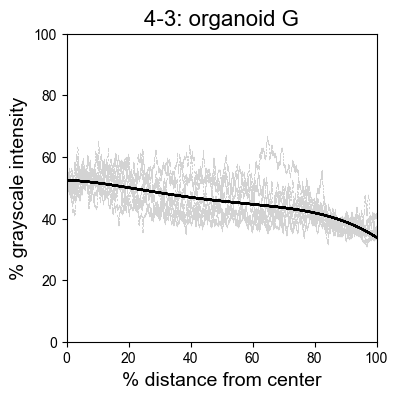

H


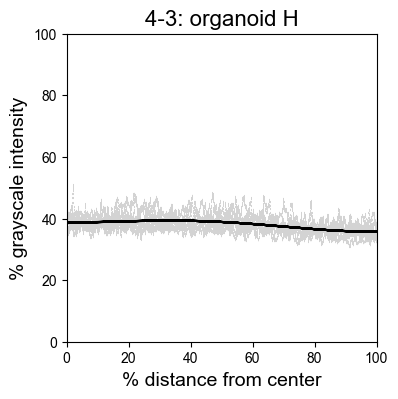

A


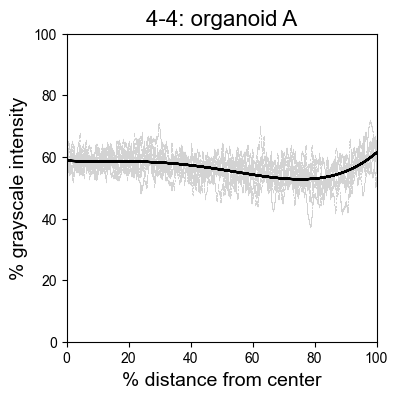

B


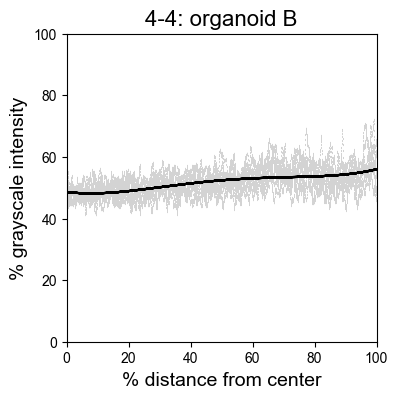

C


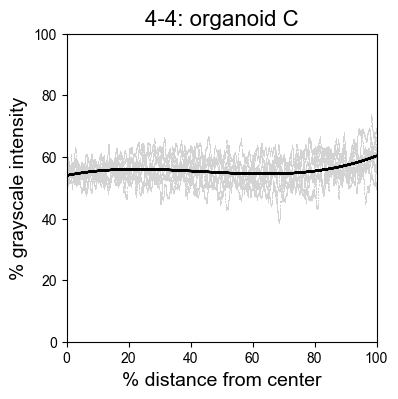

D


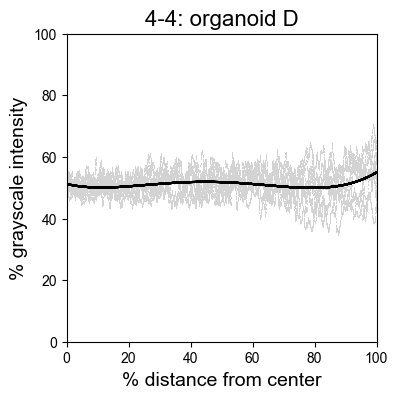

E


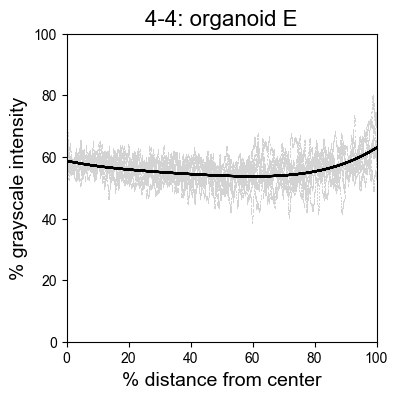

F


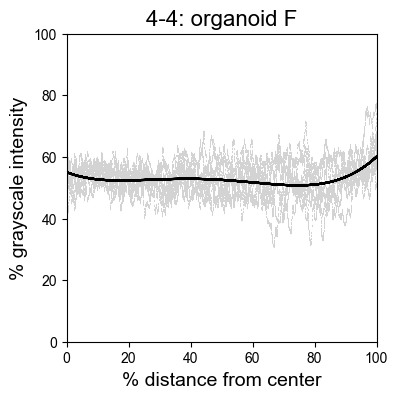

G


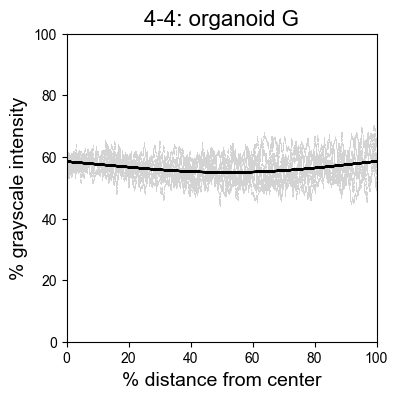

H


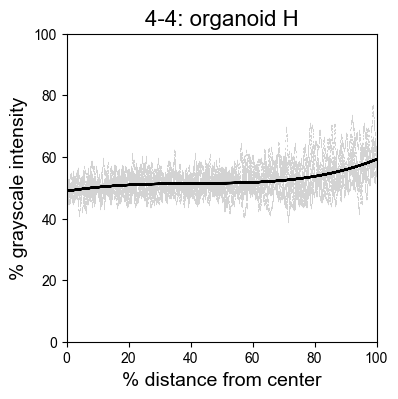

A


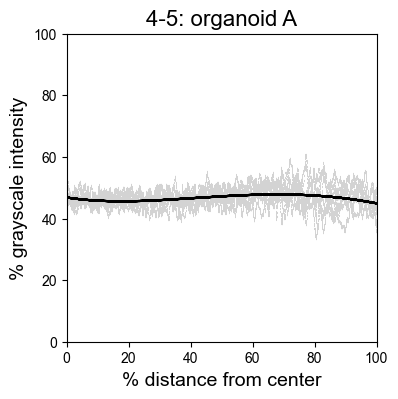

B


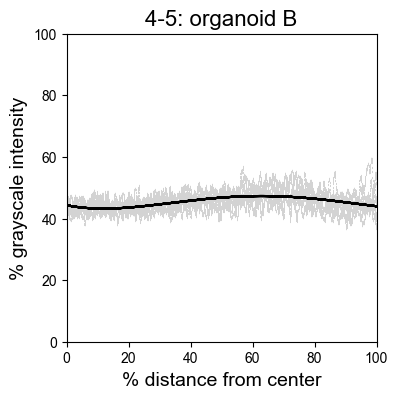

C


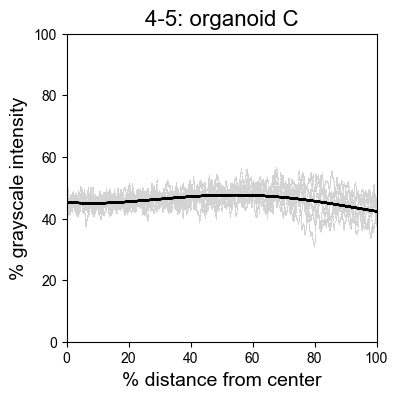

D


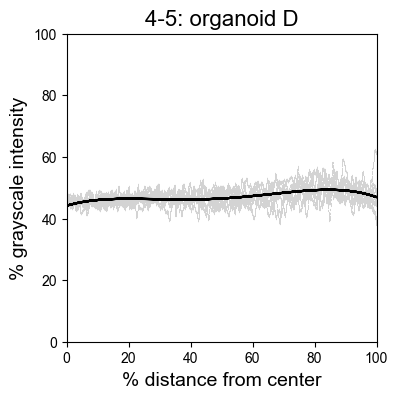

E


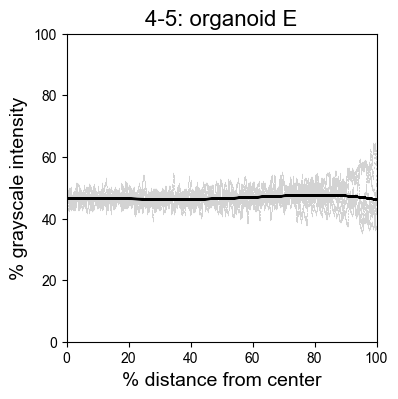

F


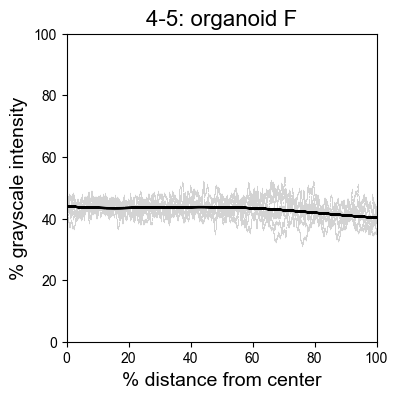

G


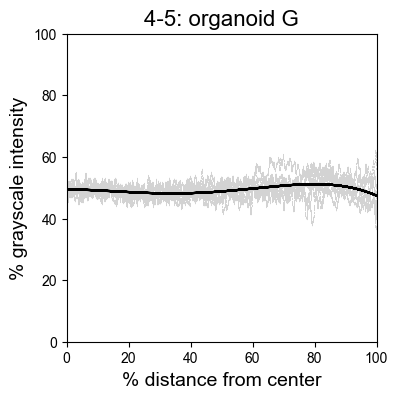

H


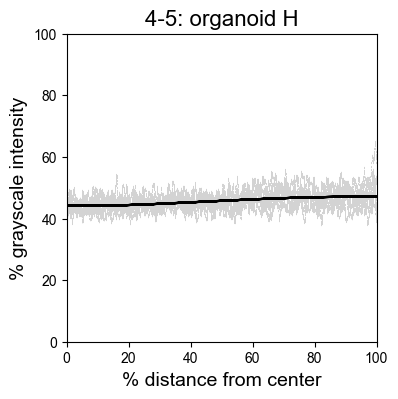

A


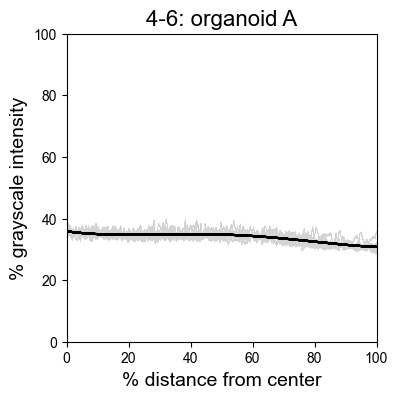

B


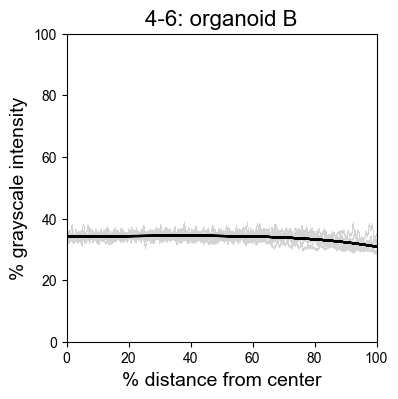

C


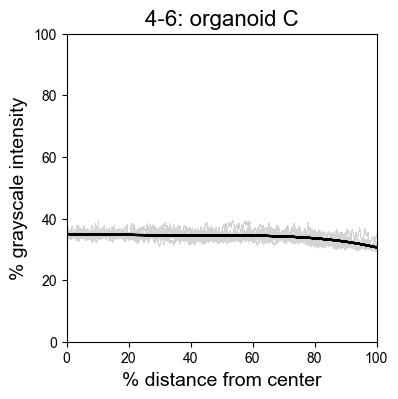

D


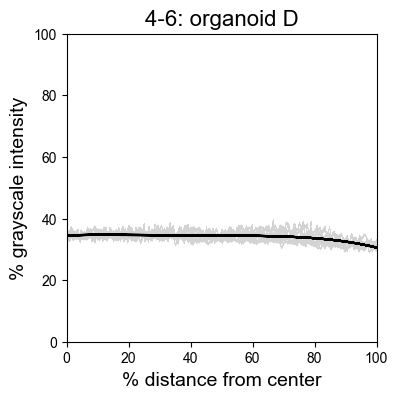

E


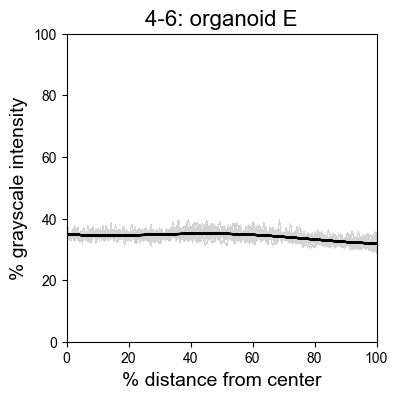

G


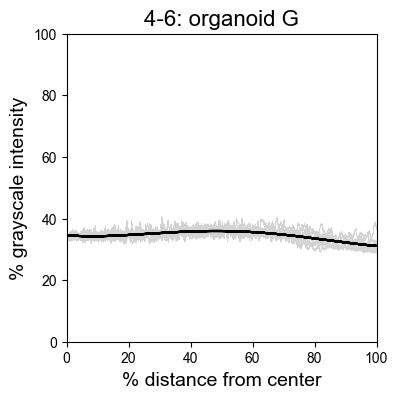

H


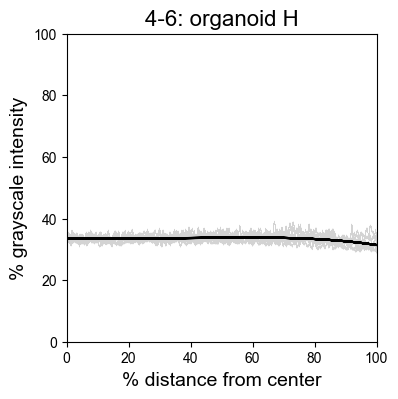

B


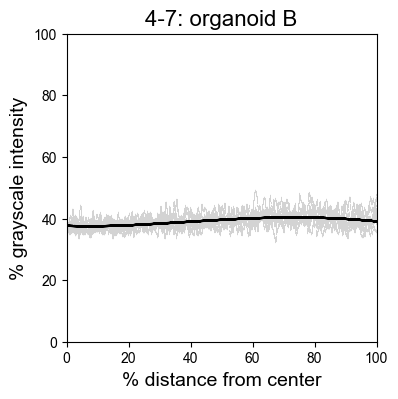

C


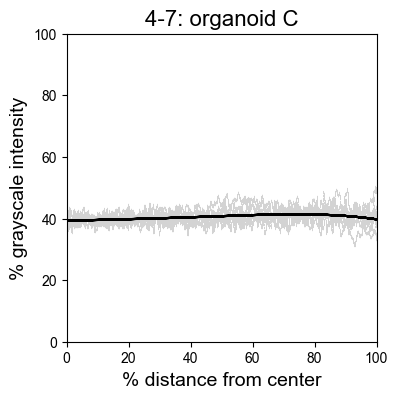

D


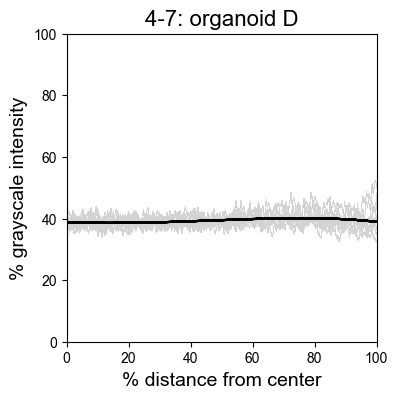

E


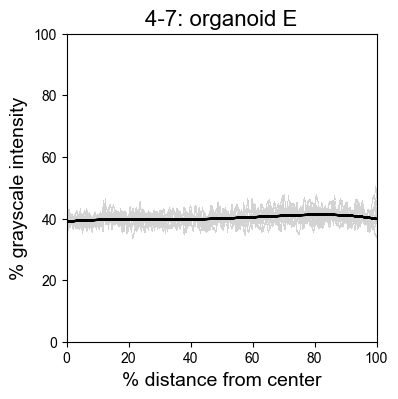

F


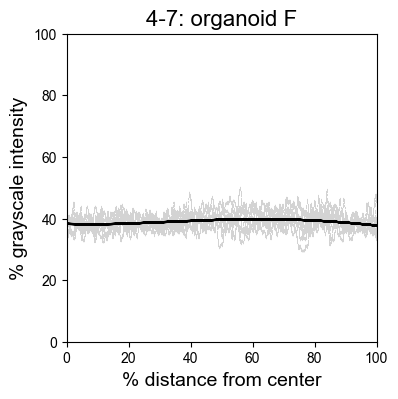

G


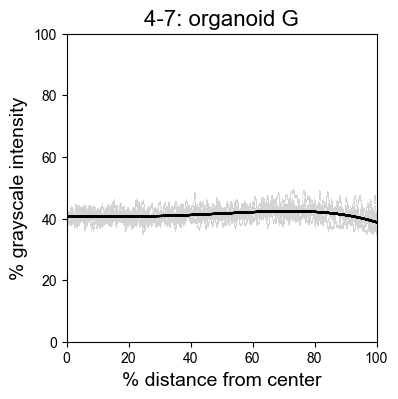

H


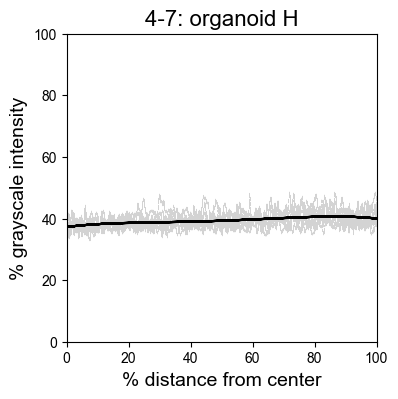

A


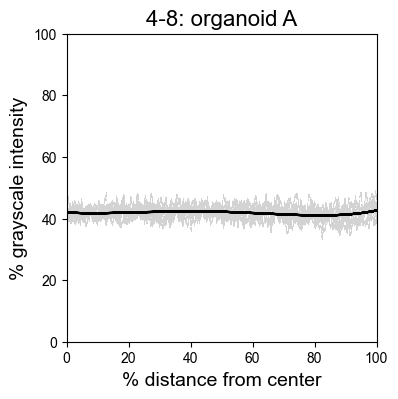

B


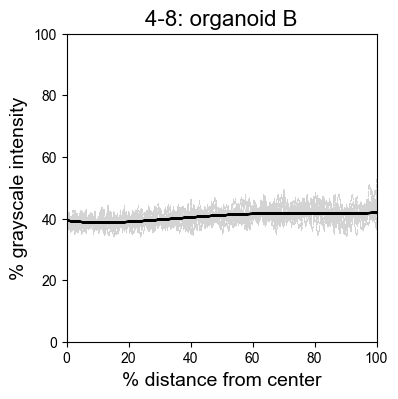

C


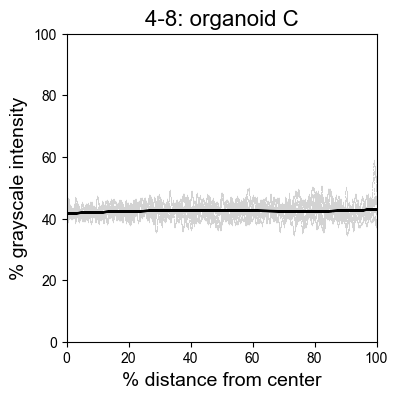

D


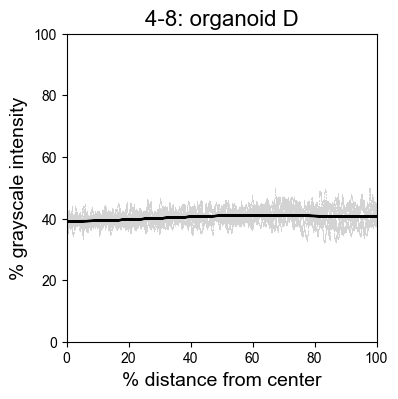

E


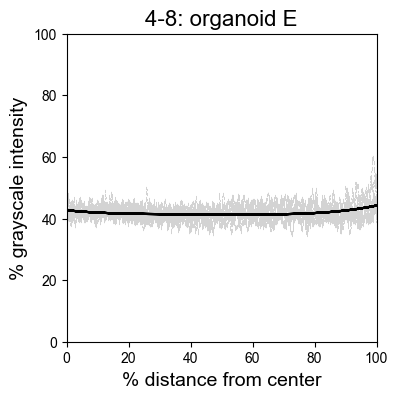

F


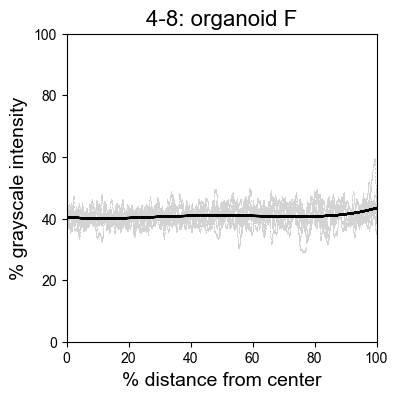

G


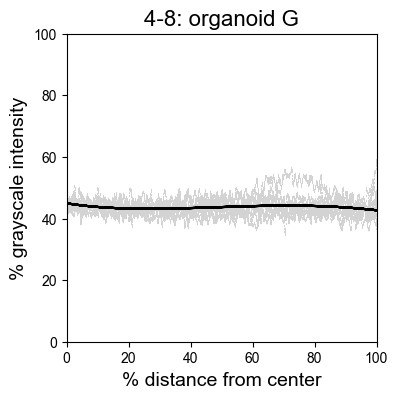

H


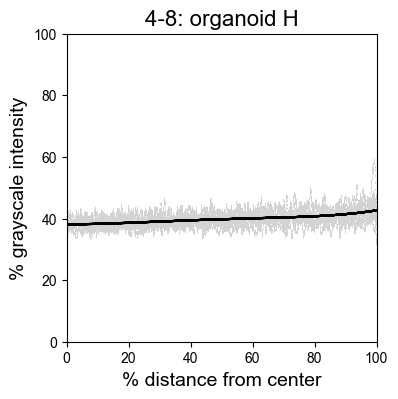

A


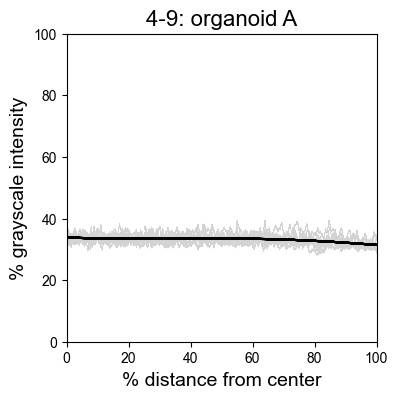

B


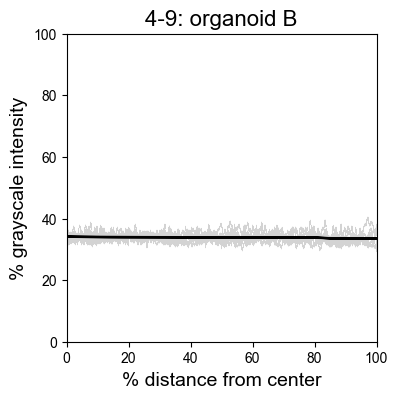

C


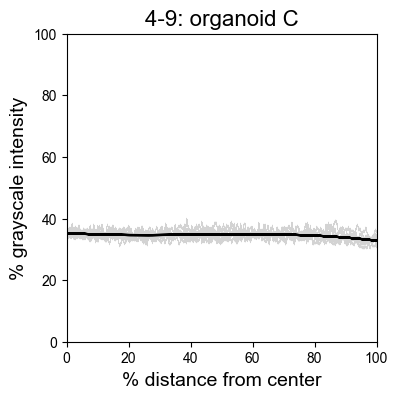

D


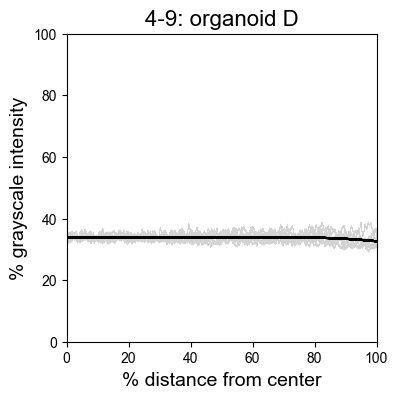

E


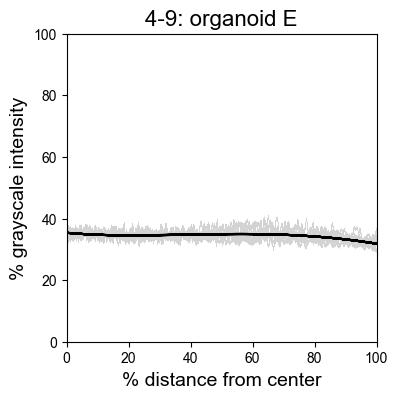

F


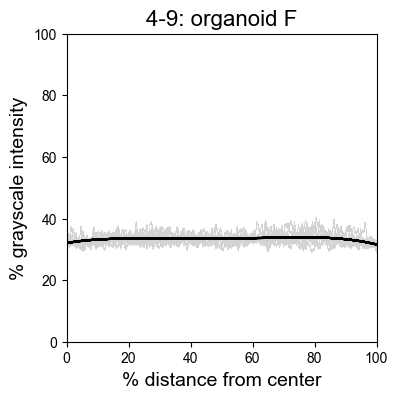

G


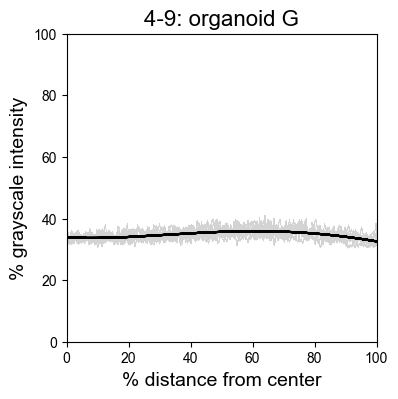

H


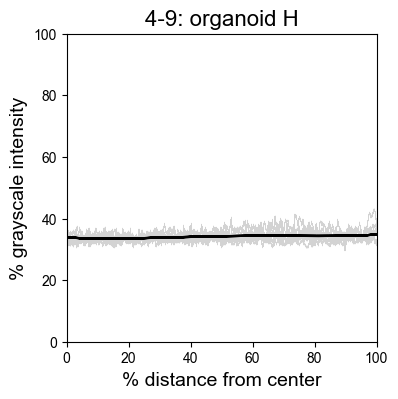

A


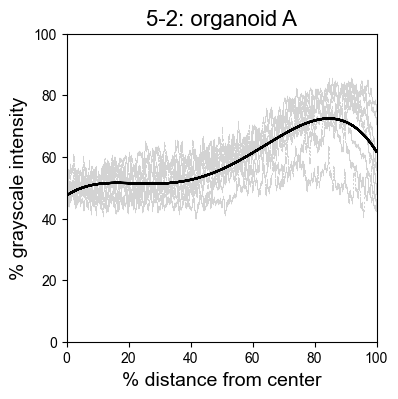

B


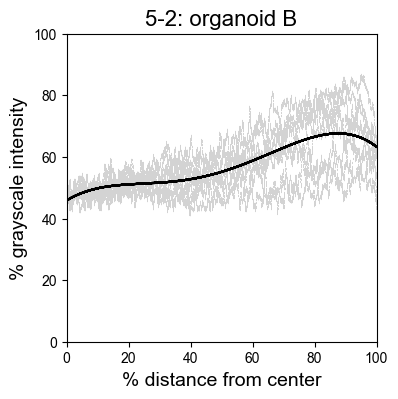

C


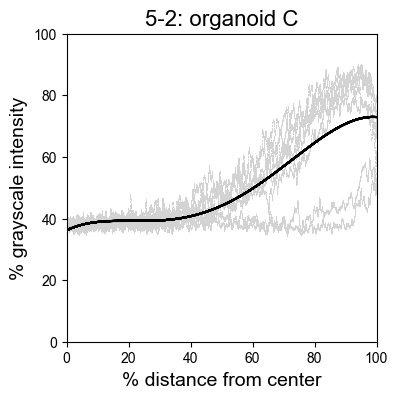

D


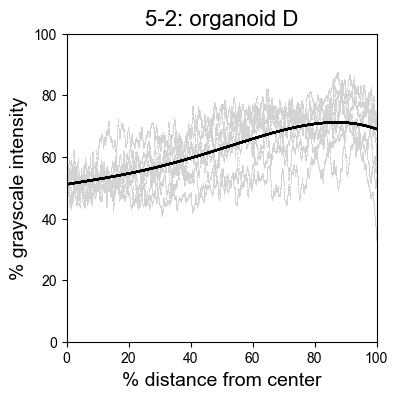

E


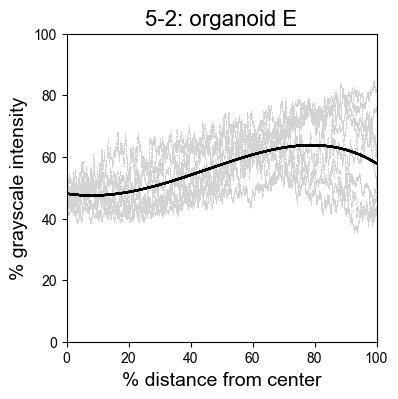

F


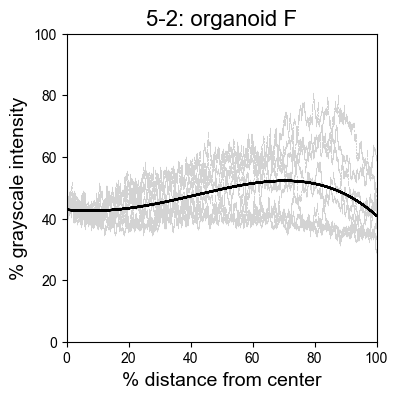

G


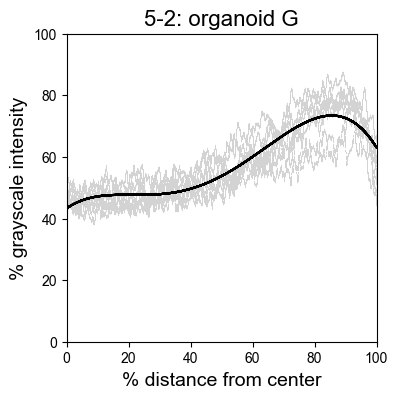

H


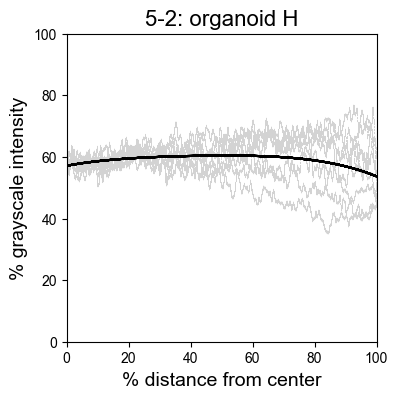

B


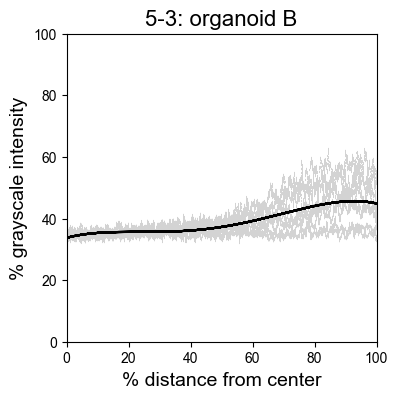

C


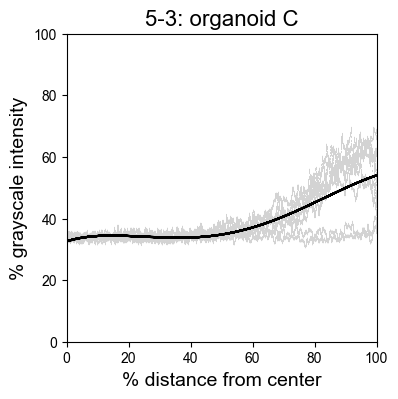

D


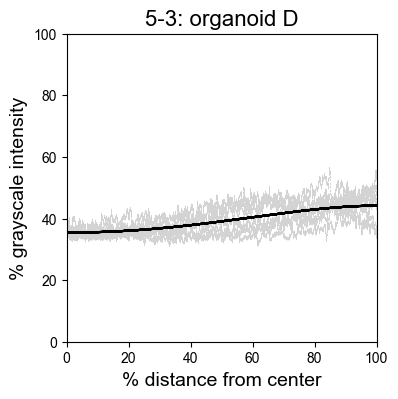

E


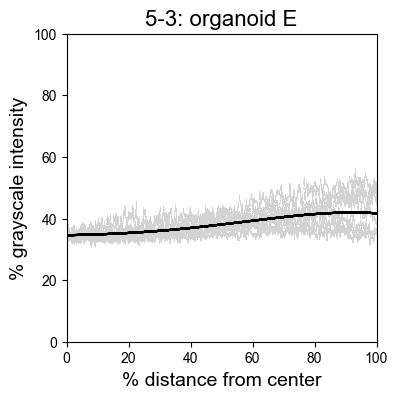

F


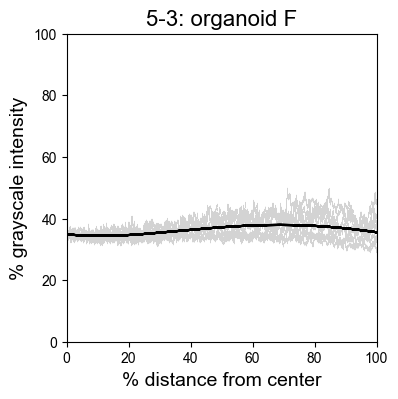

G


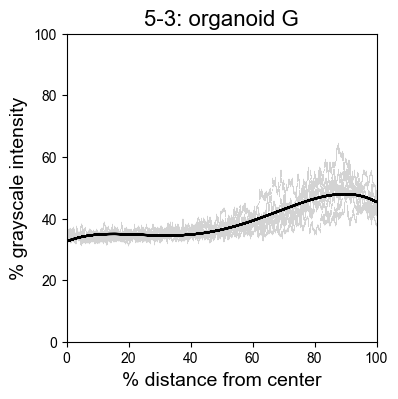

H


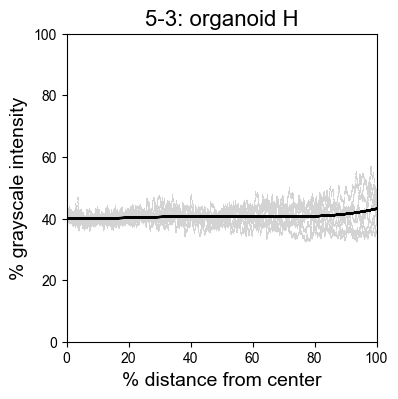

A


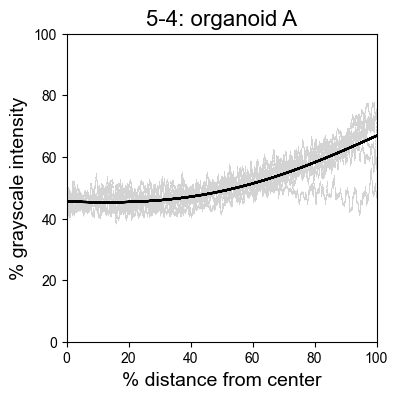

B


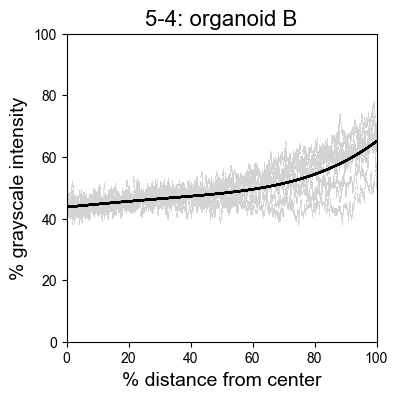

C


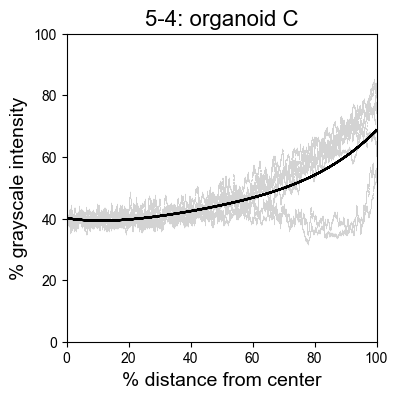

D


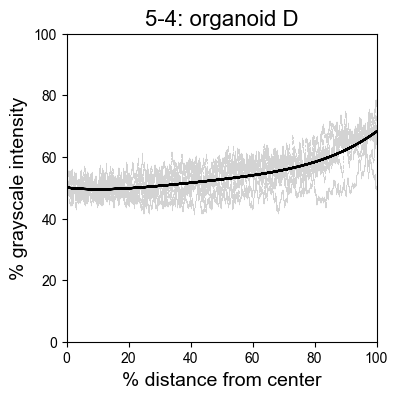

E


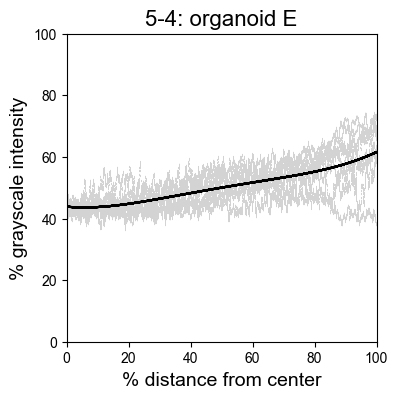

F


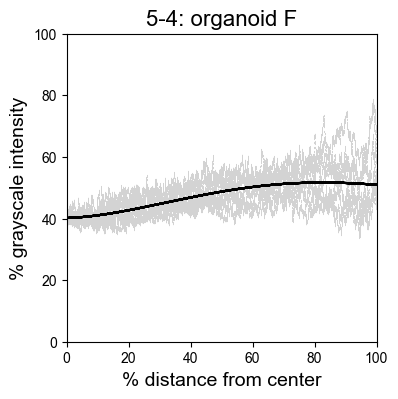

G


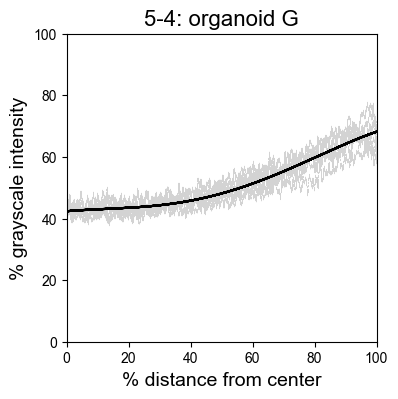

H


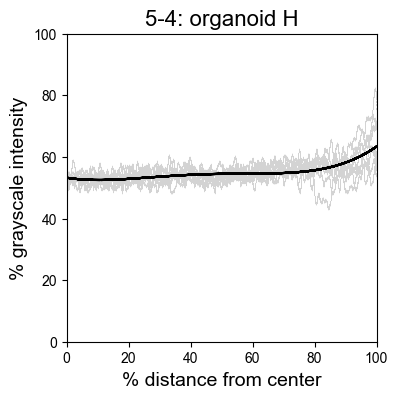

A


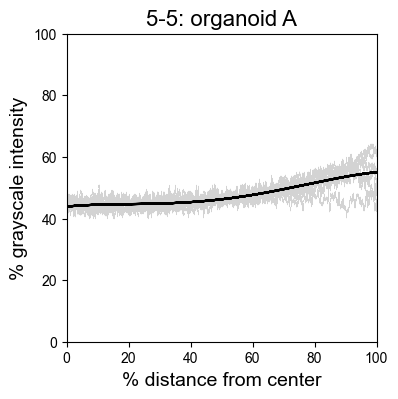

B


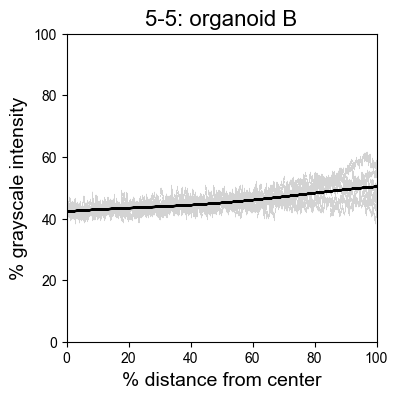

C


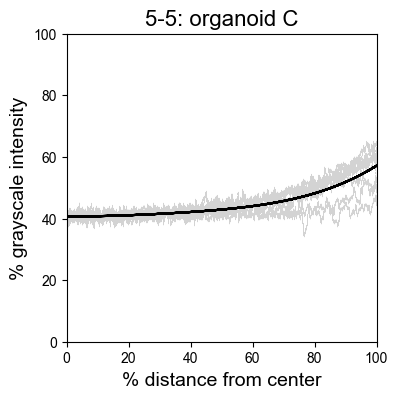

D


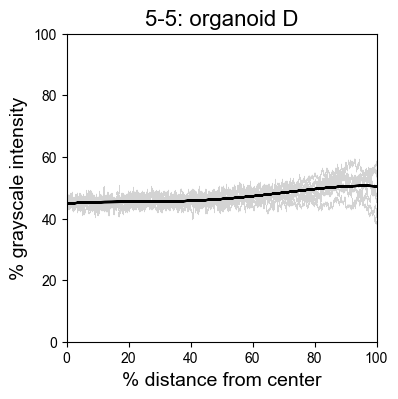

E


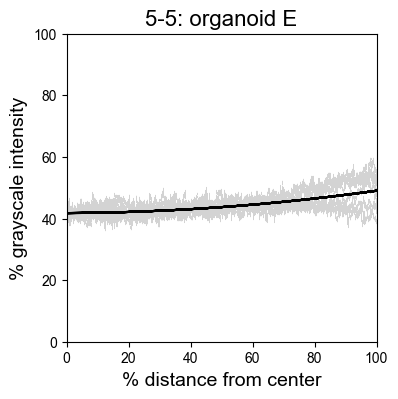

F


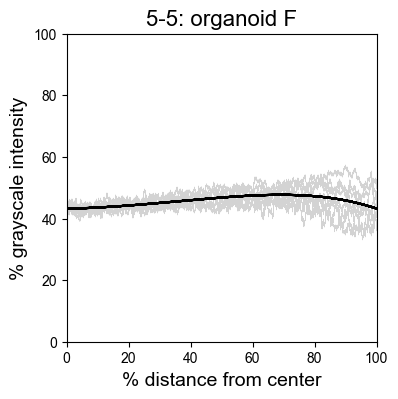

G


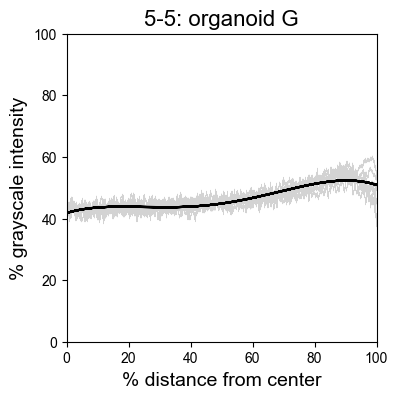

H


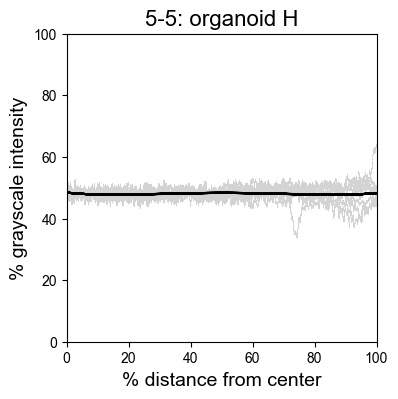

A


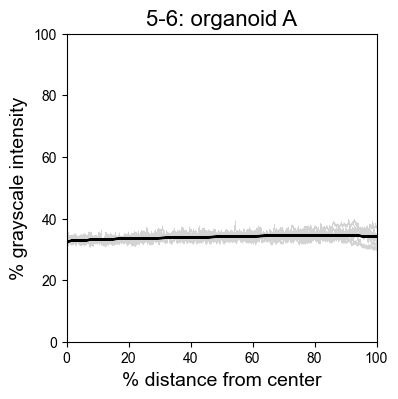

B


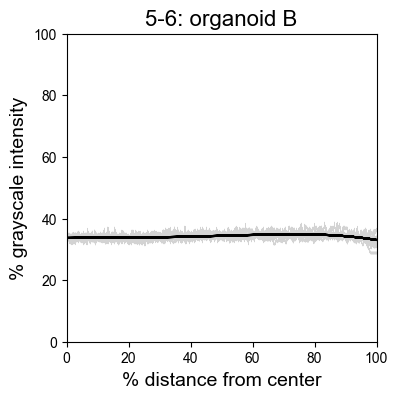

C


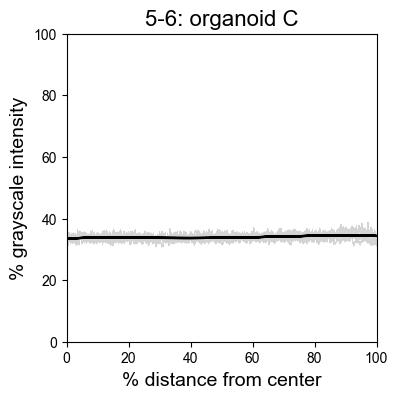

D


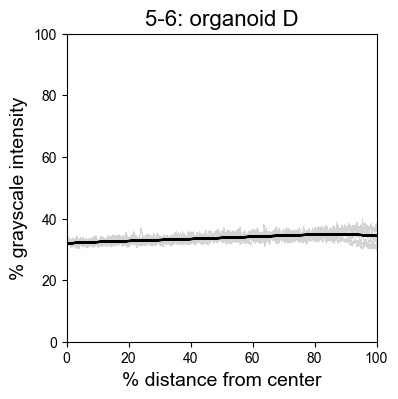

E


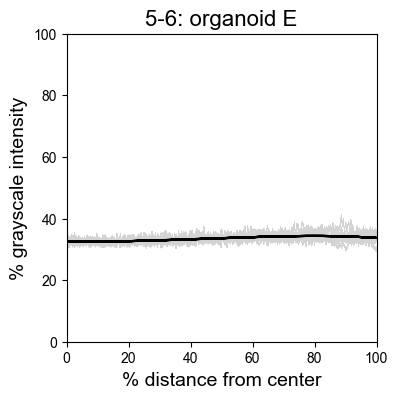

F


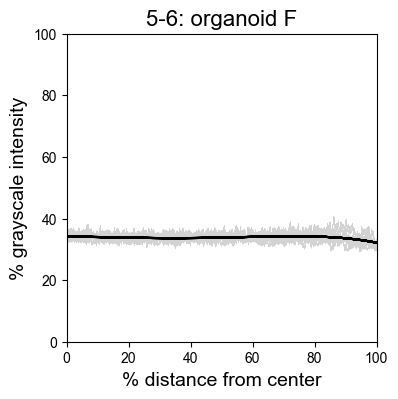

G


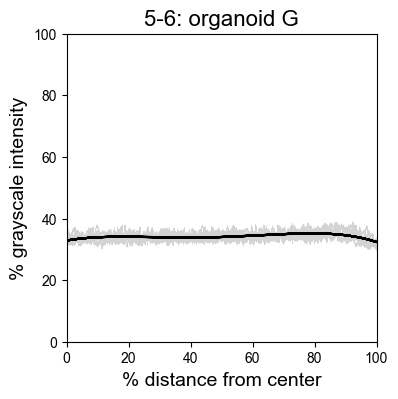

H


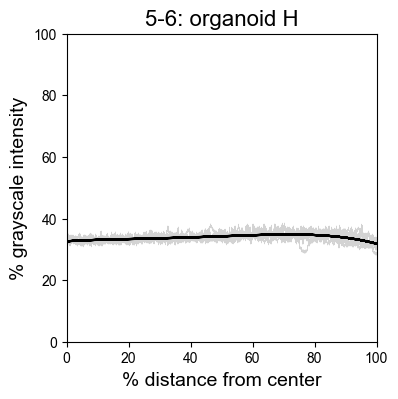

A


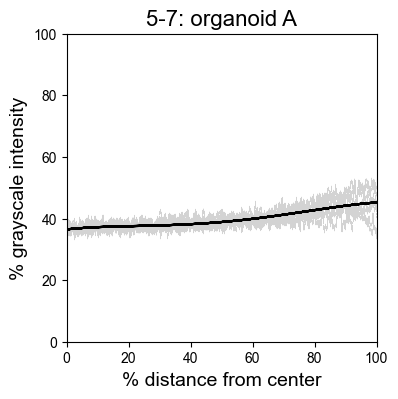

B


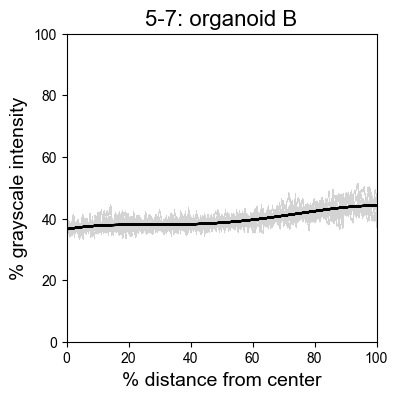

C


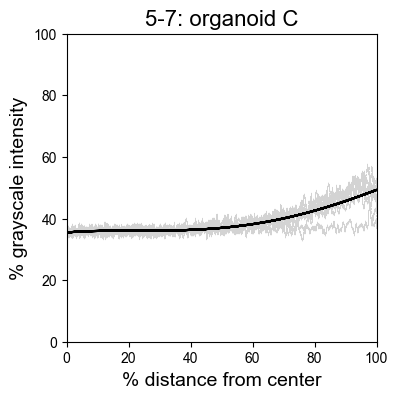

D


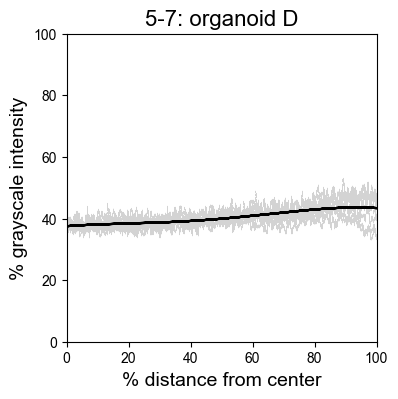

E


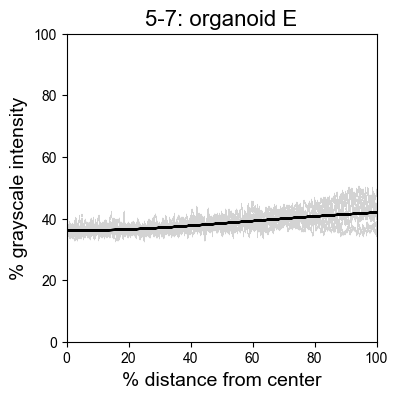

G


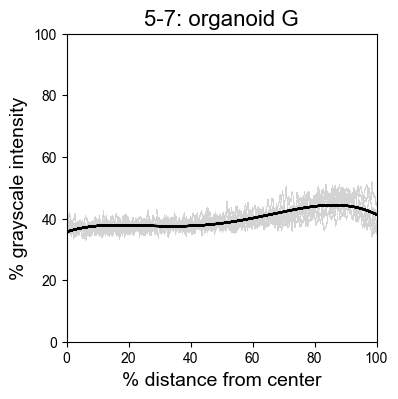

H


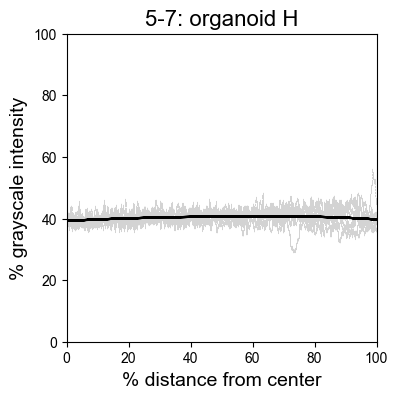

A


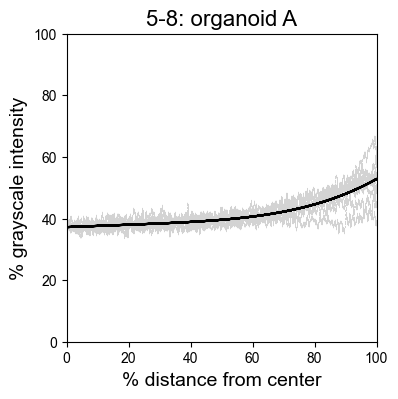

B


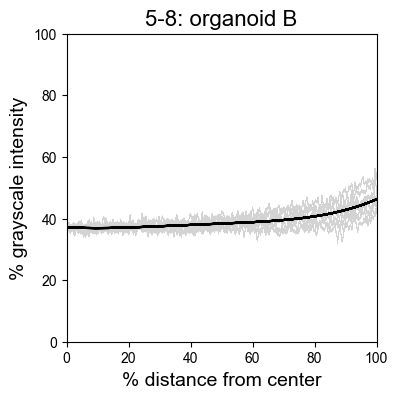

C


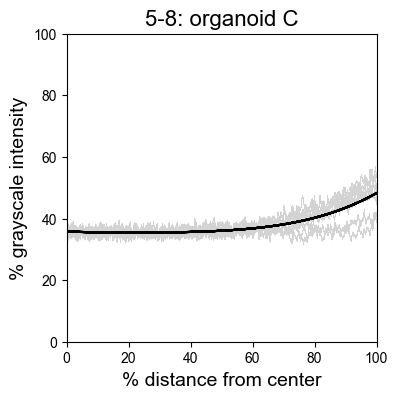

D


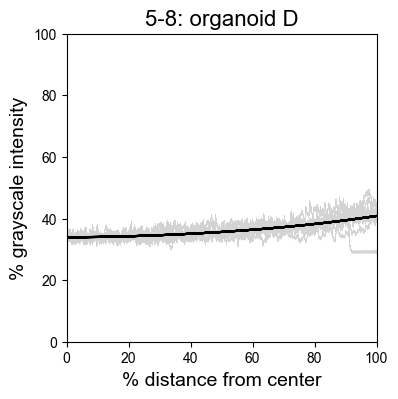

E


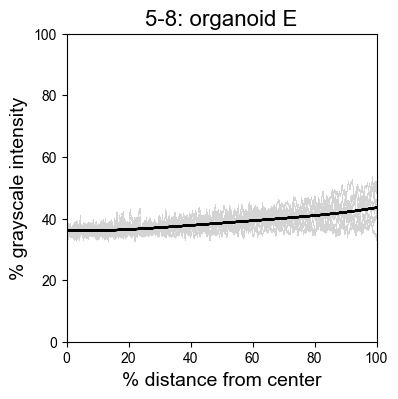

F


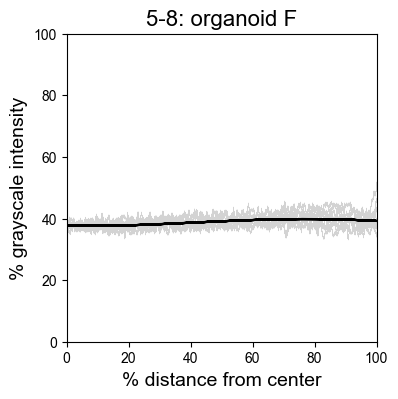

G


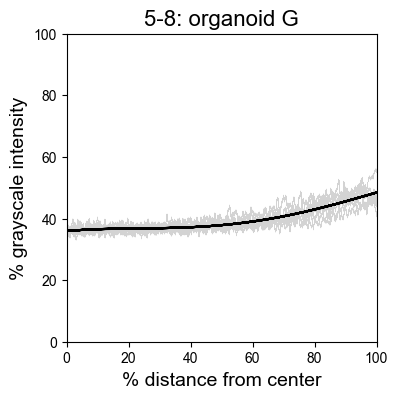

H


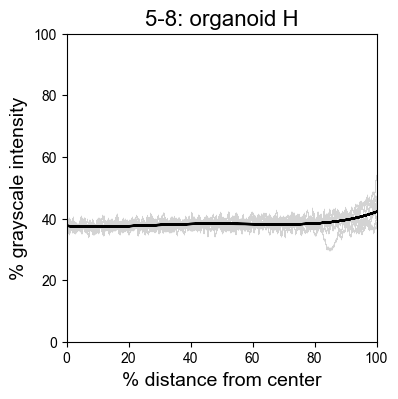

A


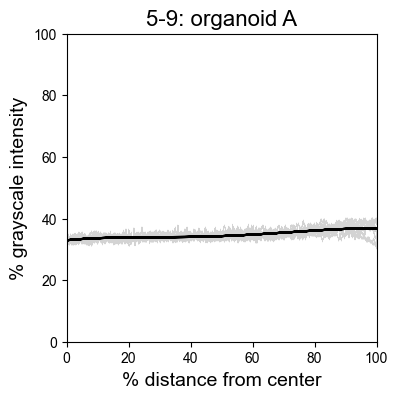

B


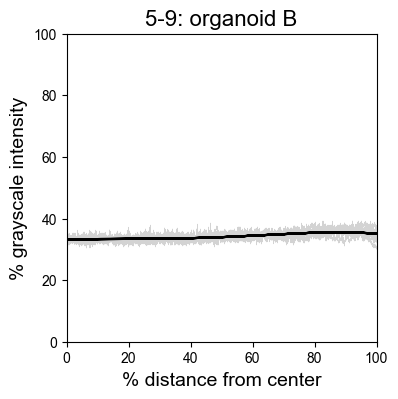

C


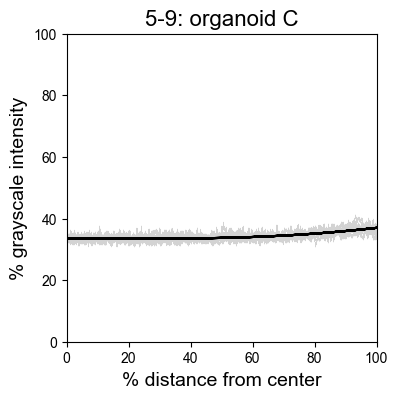

D


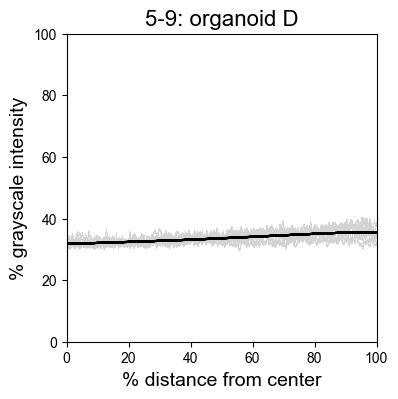

E


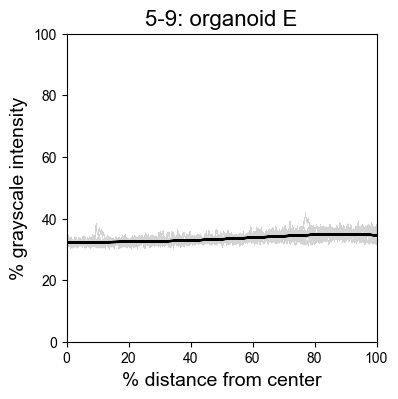

F


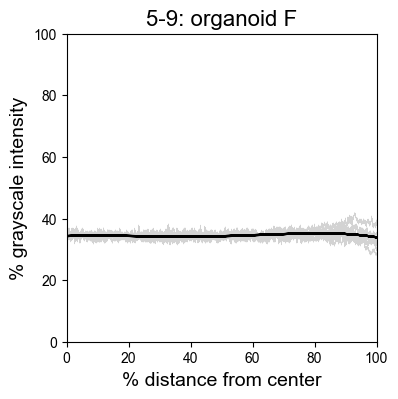

G


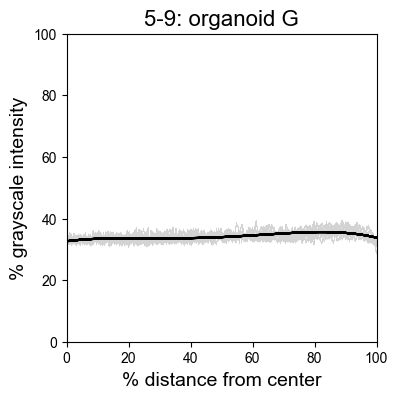

H


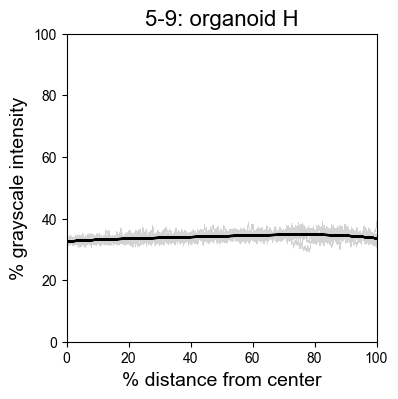

A


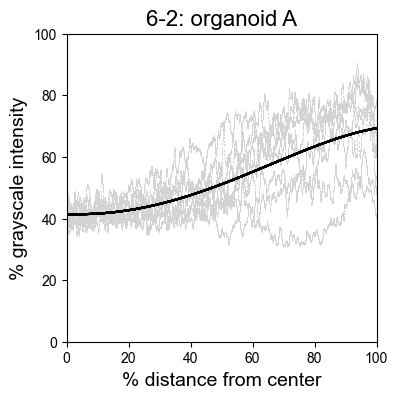

B


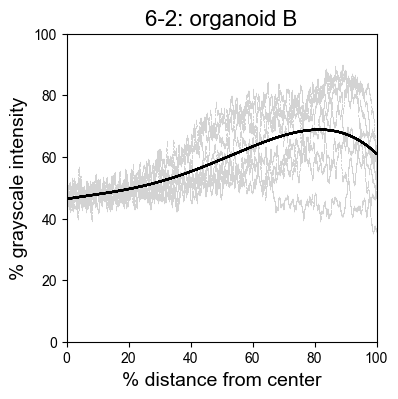

D


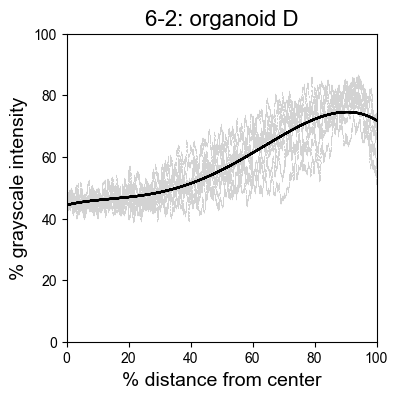

E


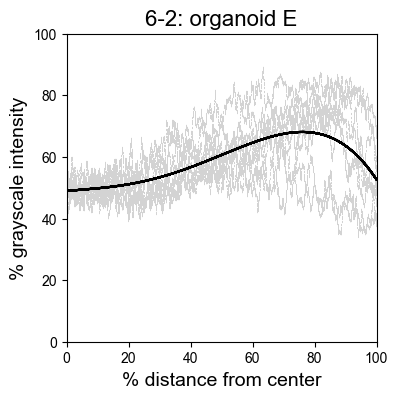

F


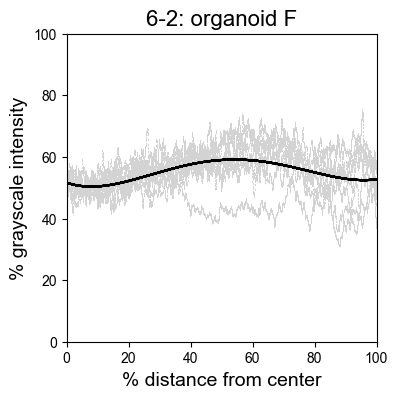

G


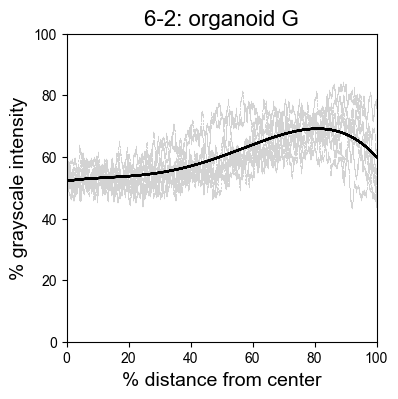

H


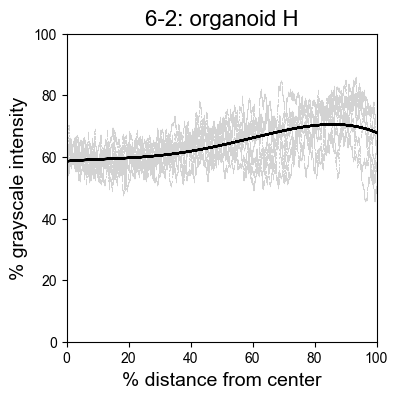

I


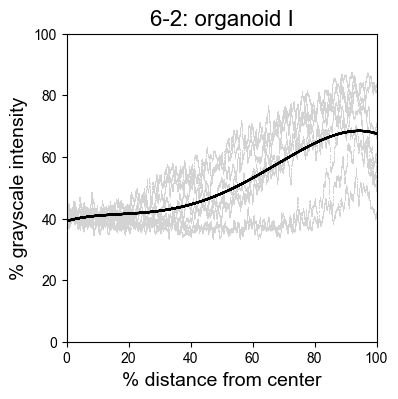

A


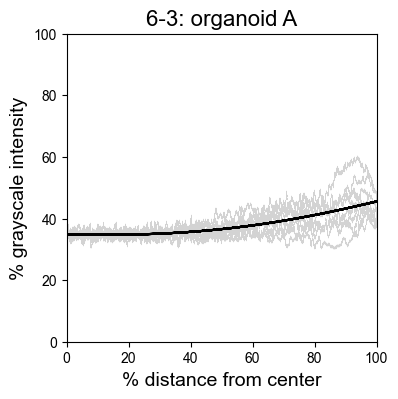

B


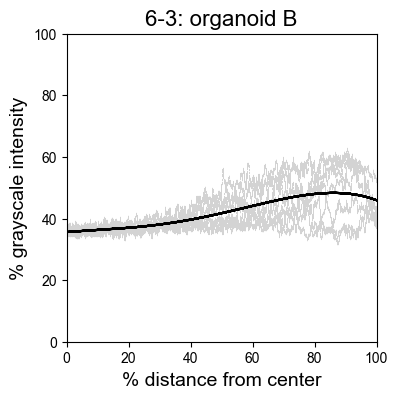

D


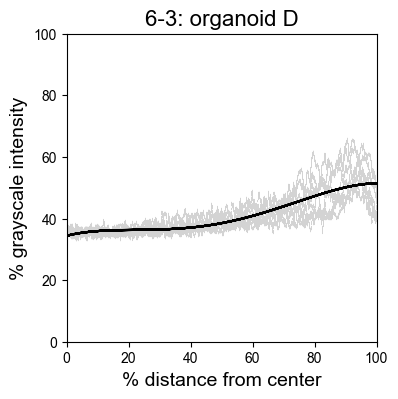

E


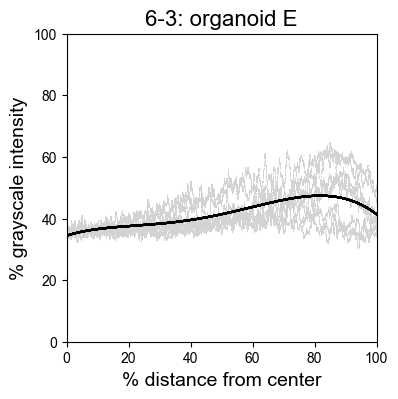

F


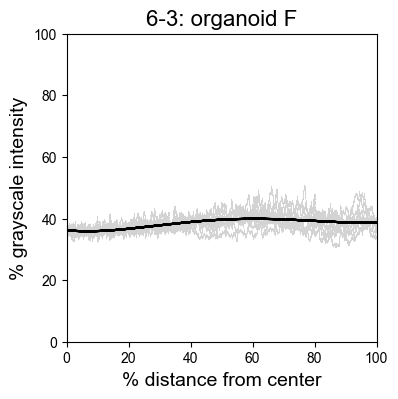

G


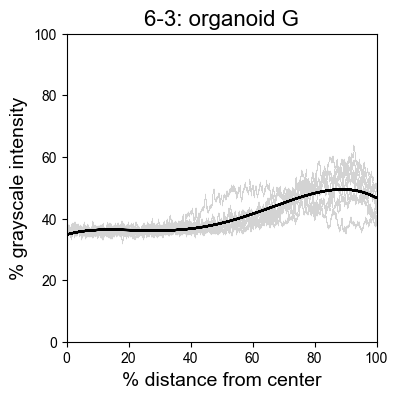

H


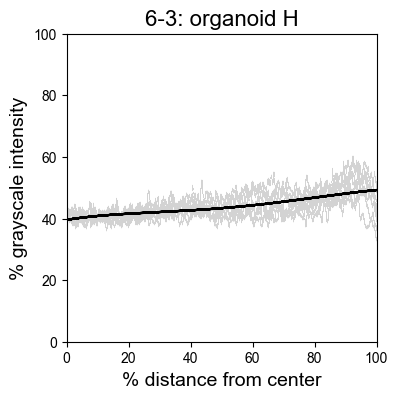

I


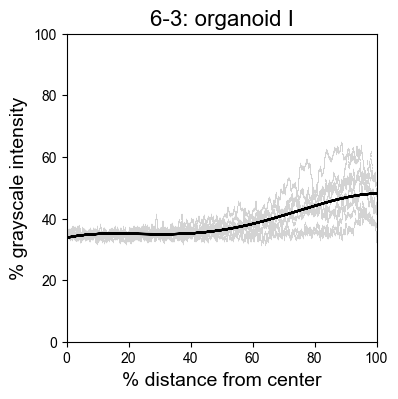

A


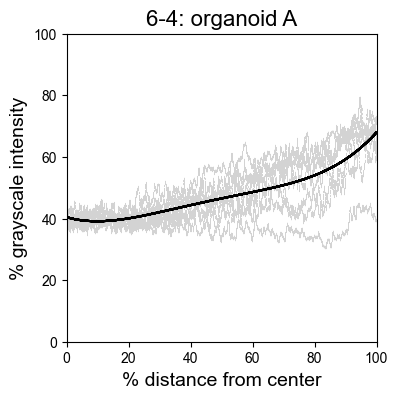

B


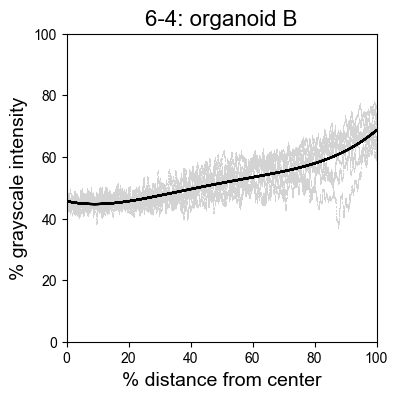

D


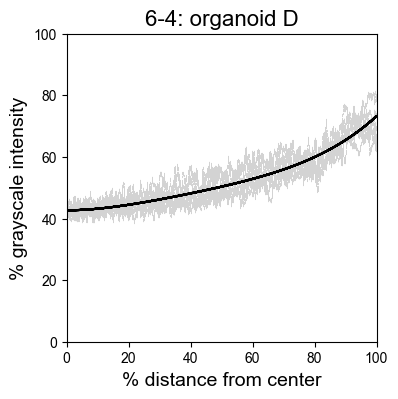

E


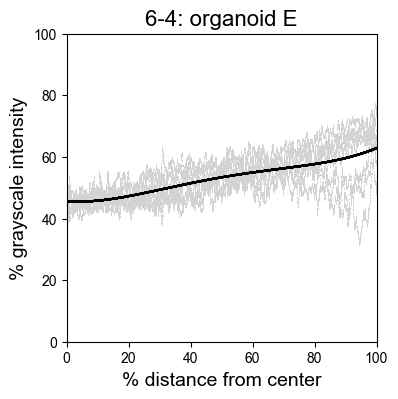

F


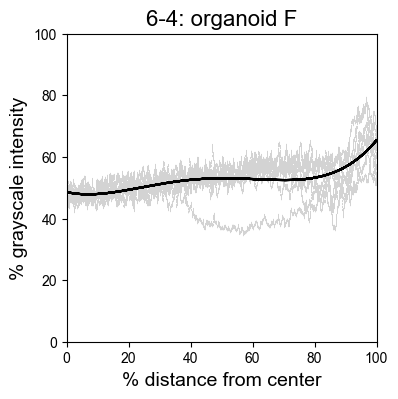

G


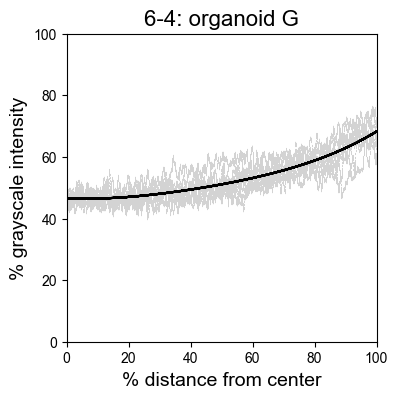

H


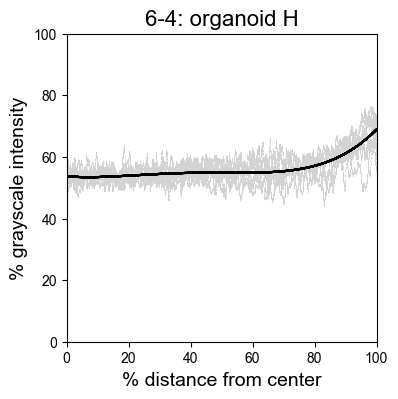

I


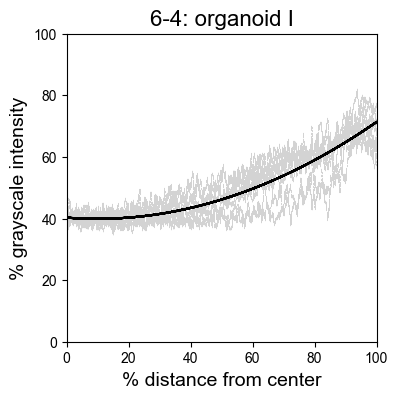

A


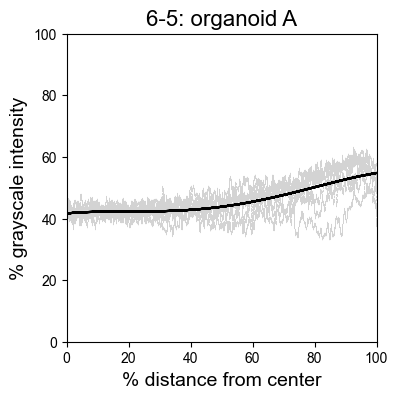

B


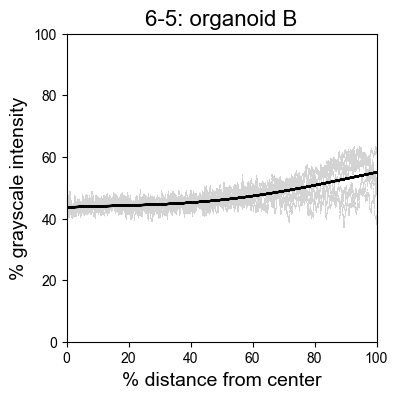

D


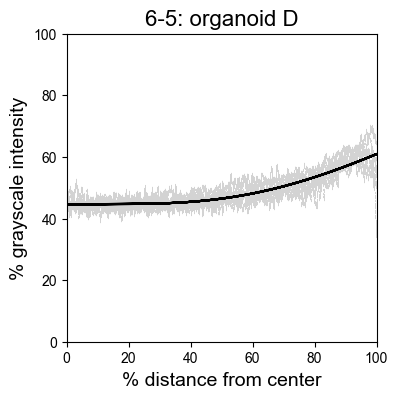

E


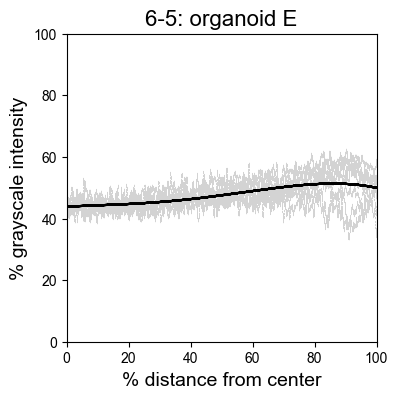

F


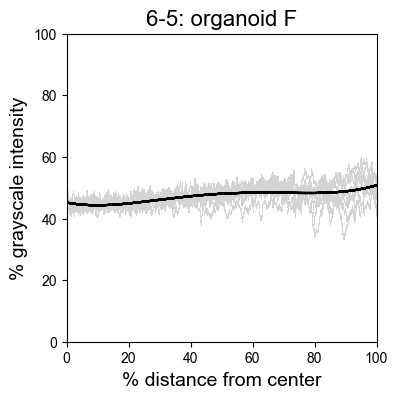

G


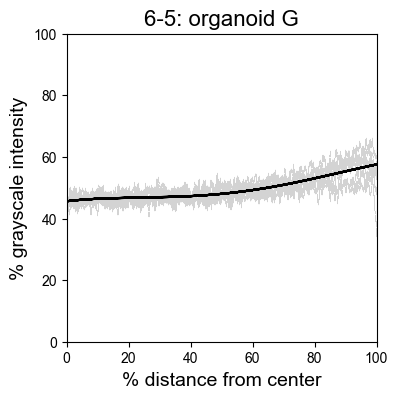

H


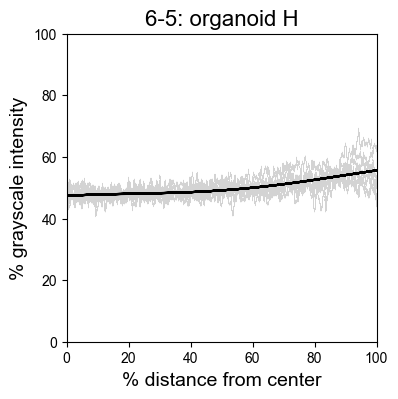

I


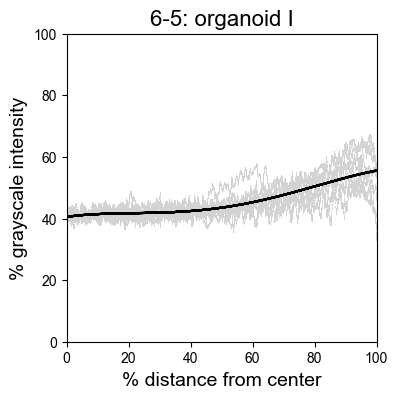

A


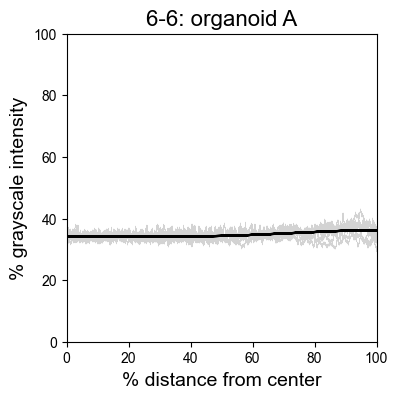

B


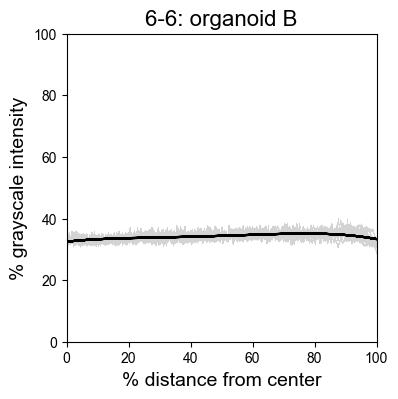

D


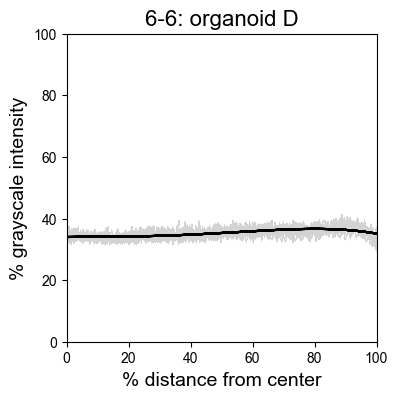

E


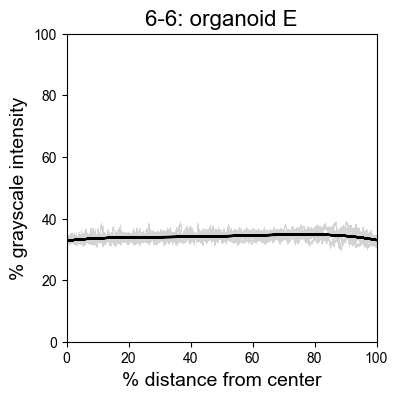

F


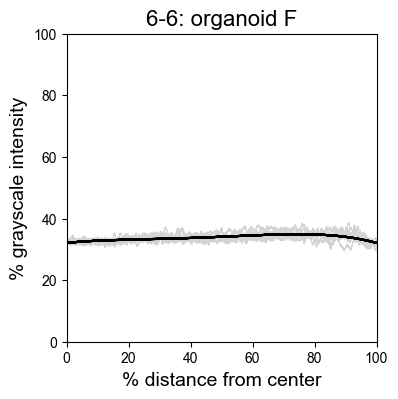

G


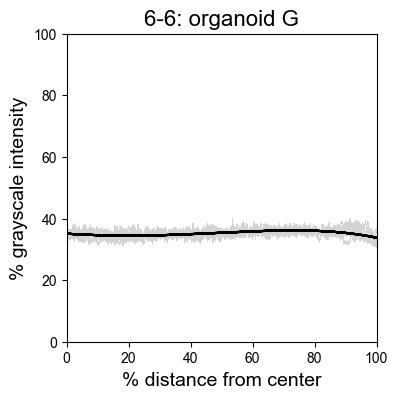

H


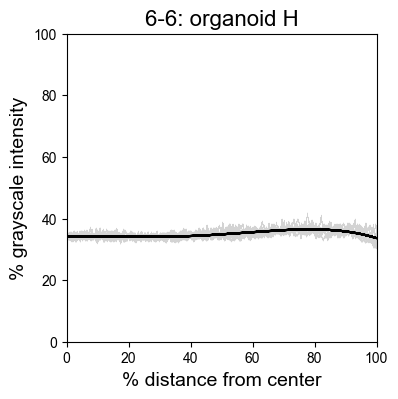

I


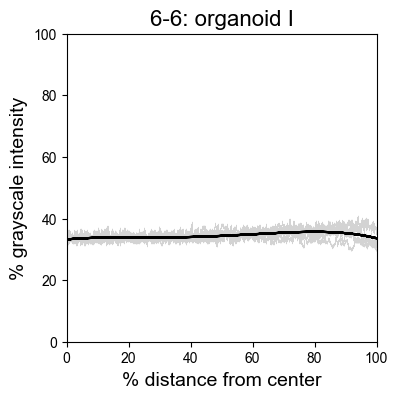

A


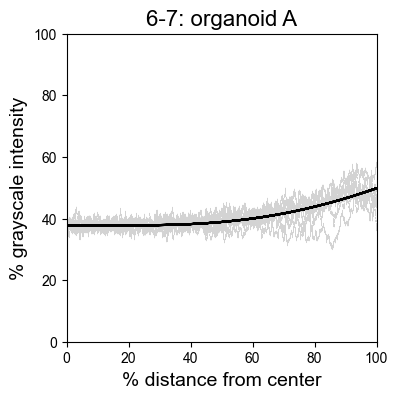

B


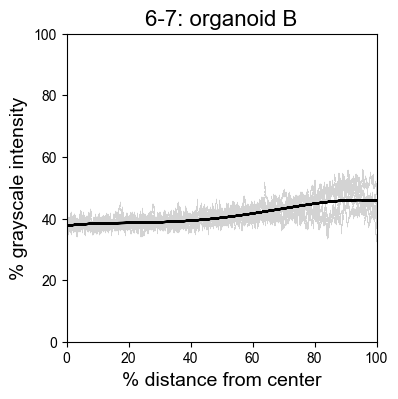

D


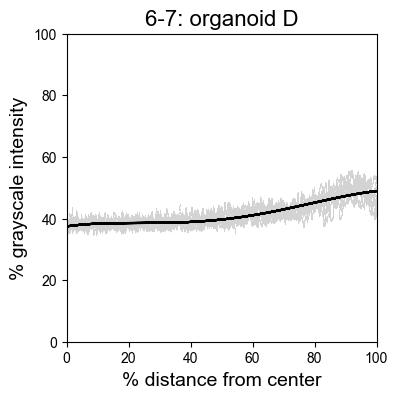

E


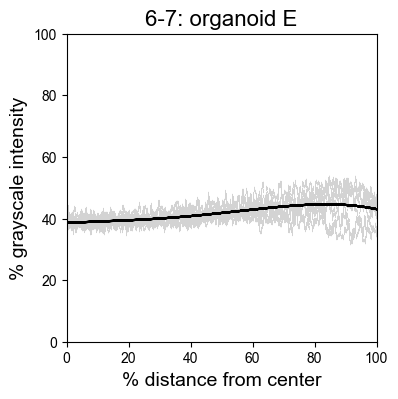

F


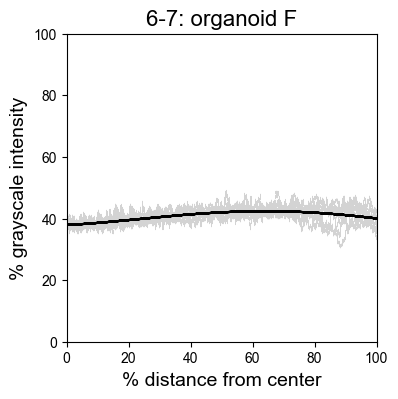

G


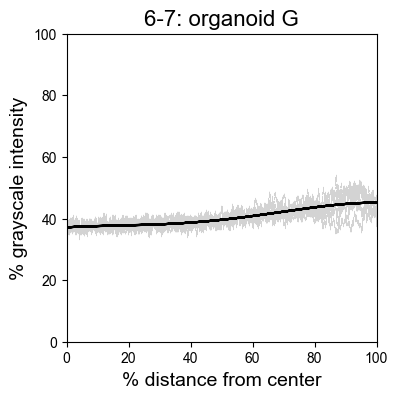

H


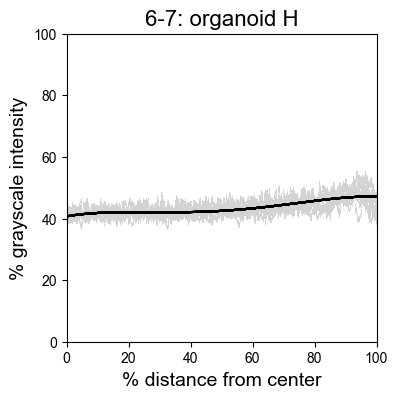

I


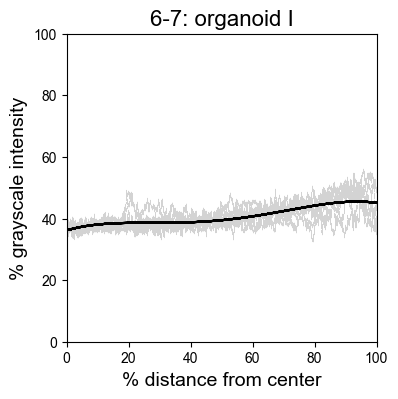

A


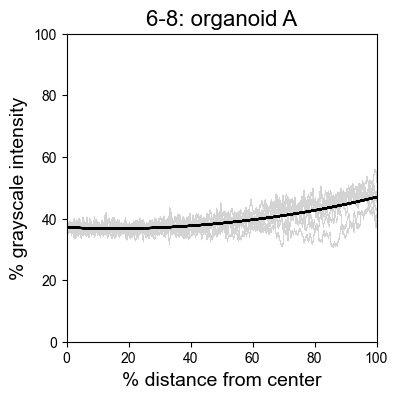

B


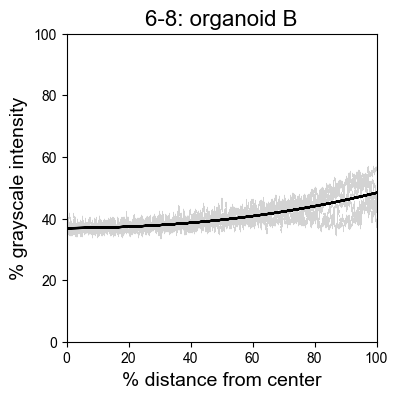

D


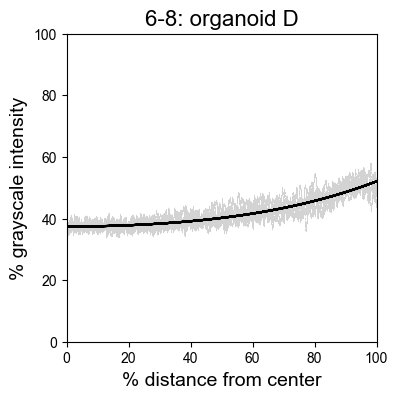

E


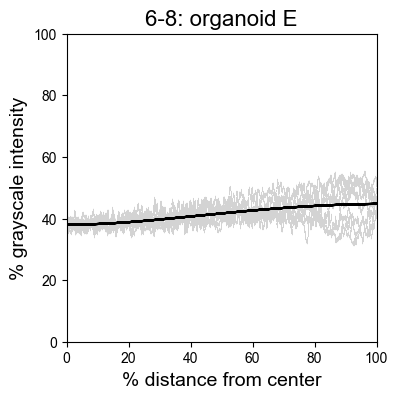

F


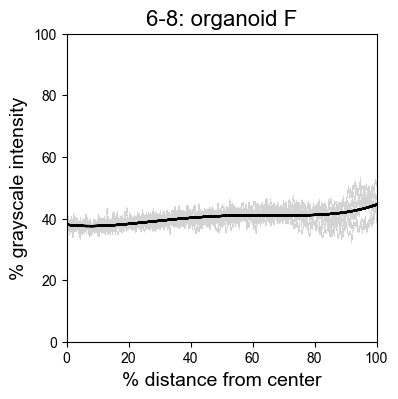

G


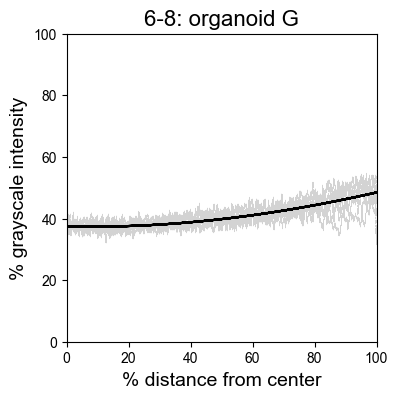

H


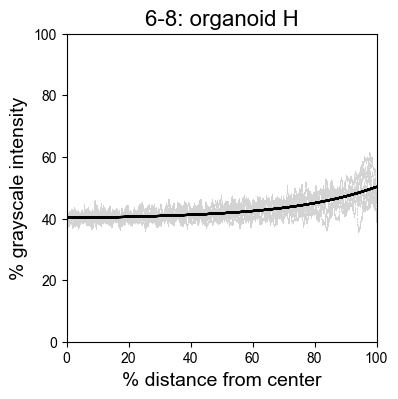

I


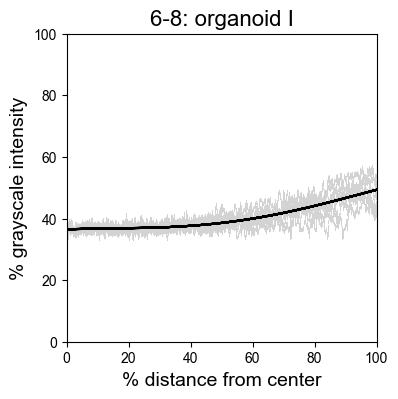

A


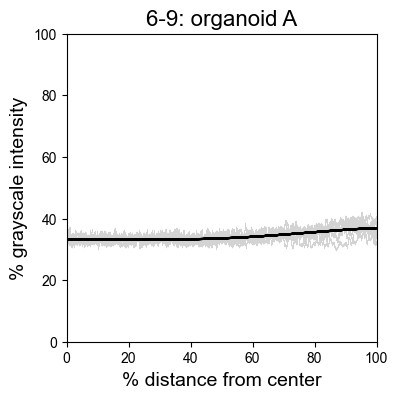

B


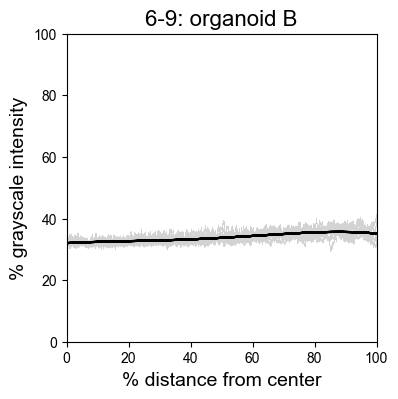

D


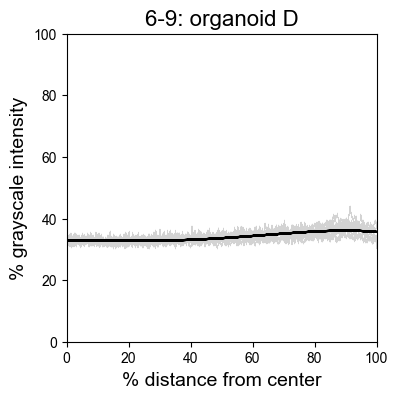

E


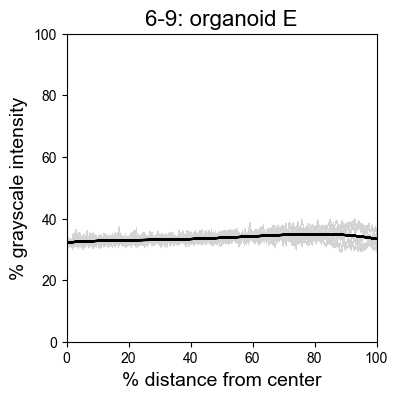

F


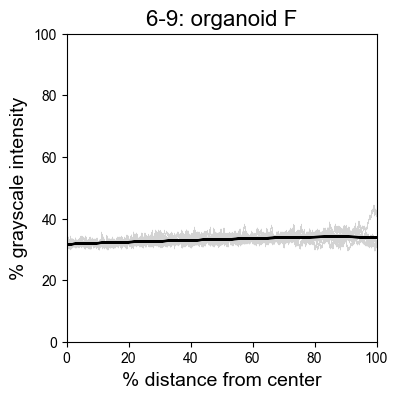

G


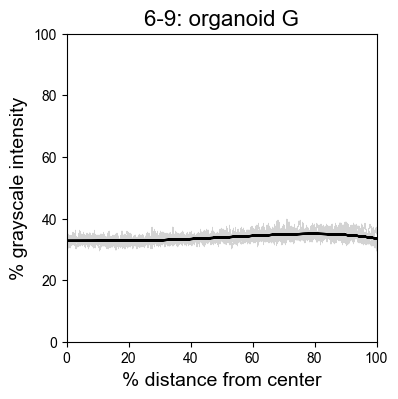

H


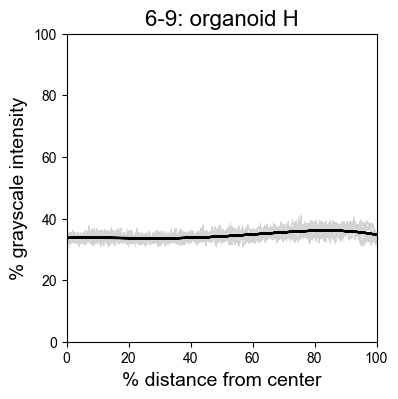

I


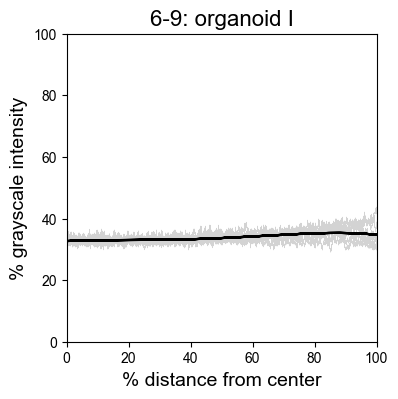

A


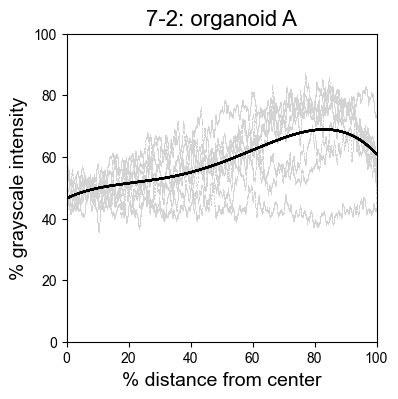

B


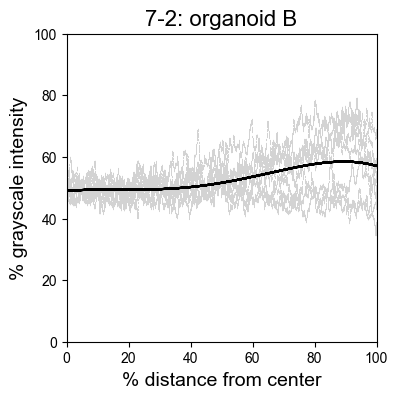

D


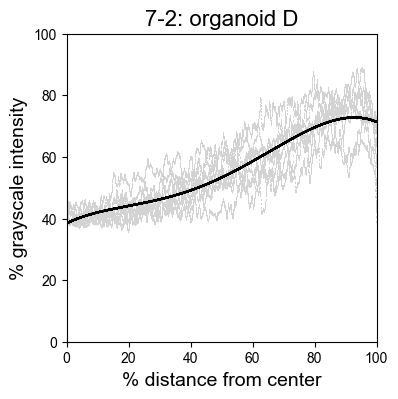

E


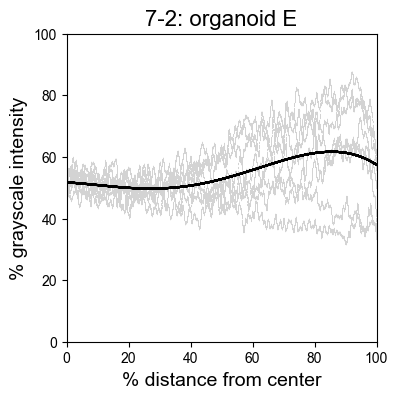

F


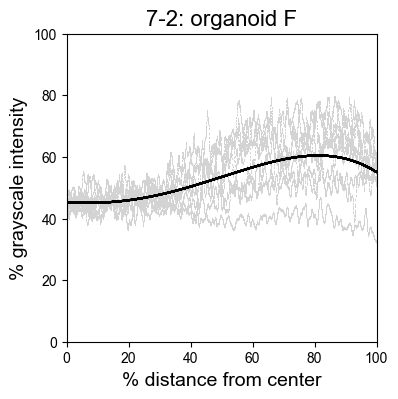

I


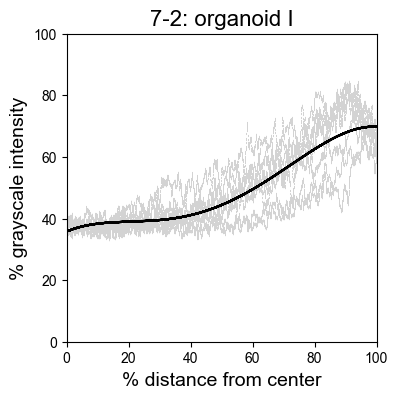

J


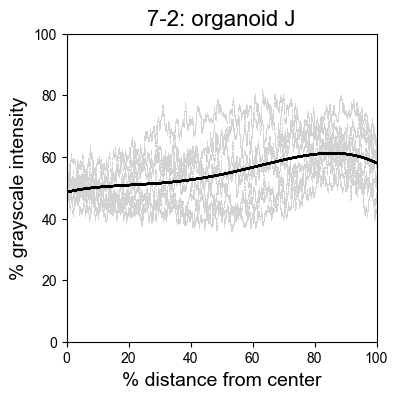

A


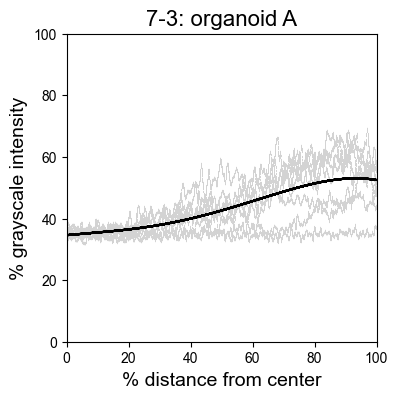

C


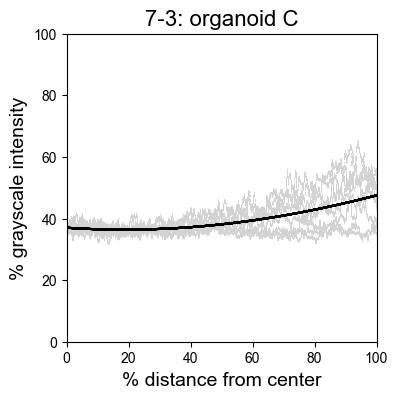

D


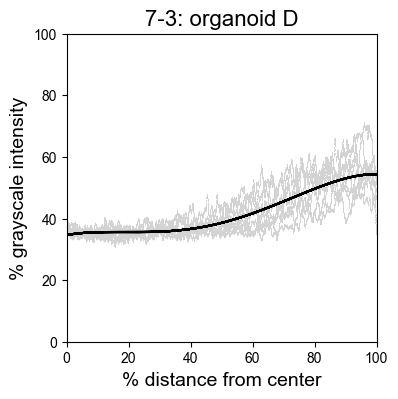

E


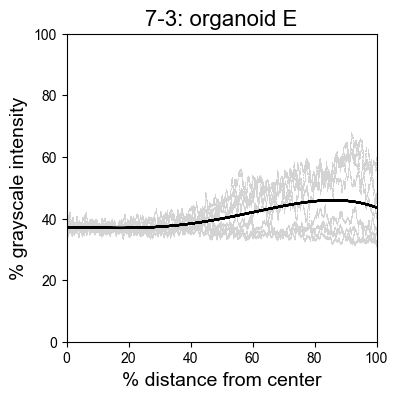

F


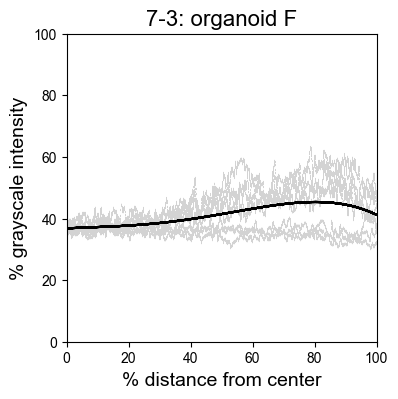

I


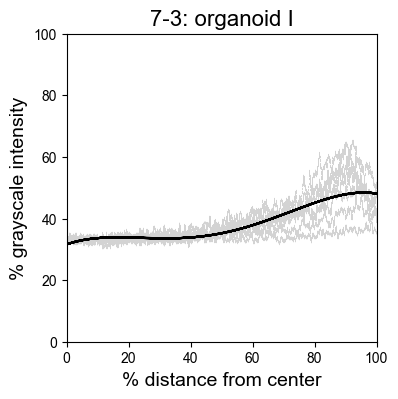

J


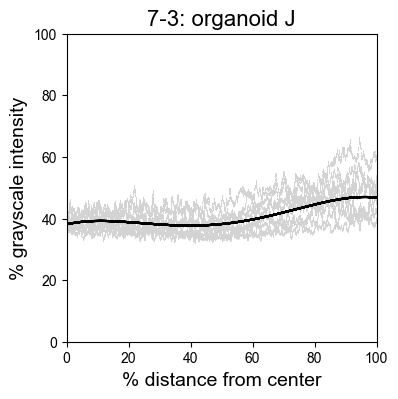

A


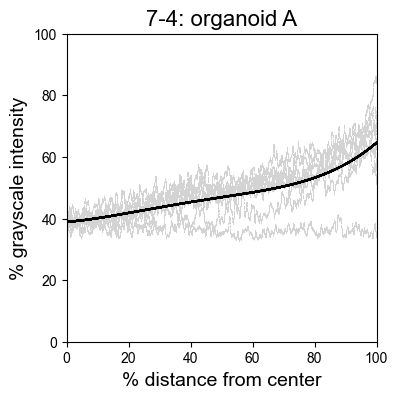

B


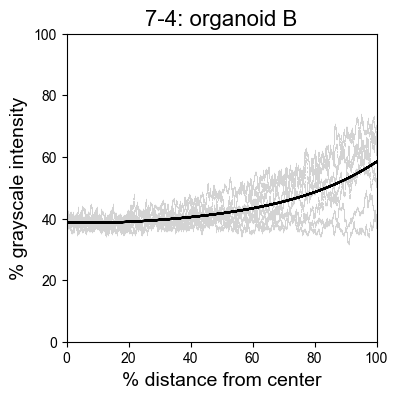

D


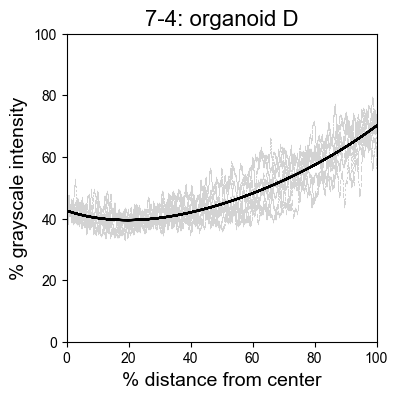

E


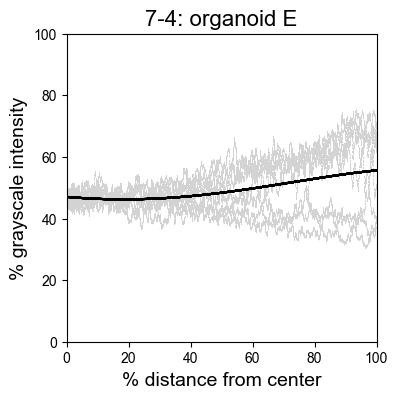

F


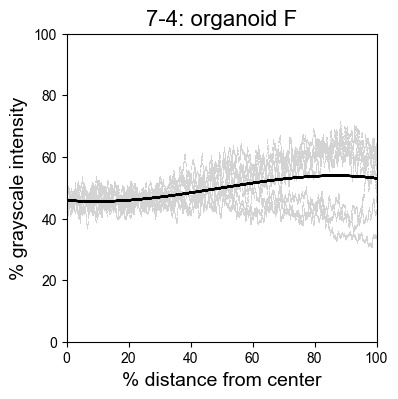

I


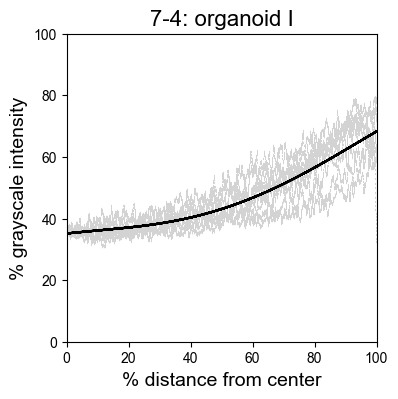

J


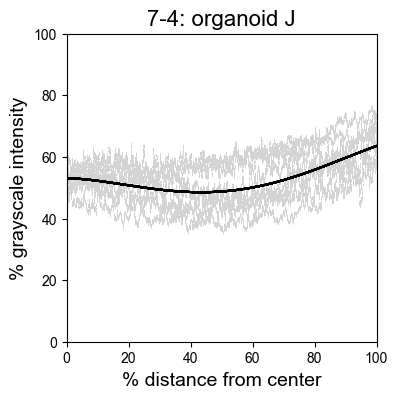

A


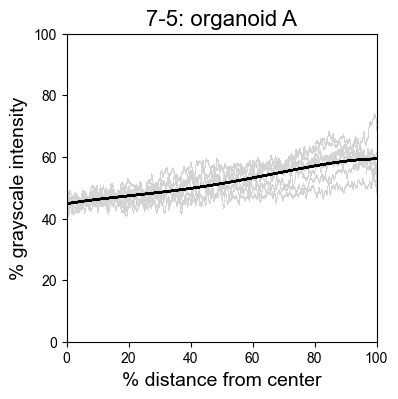

B


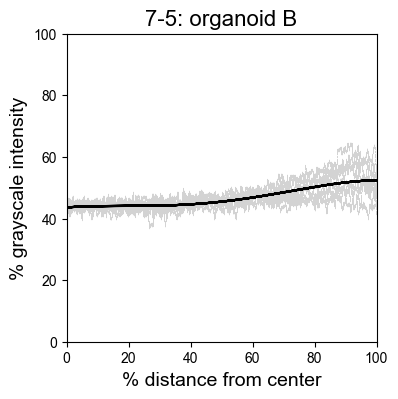

D


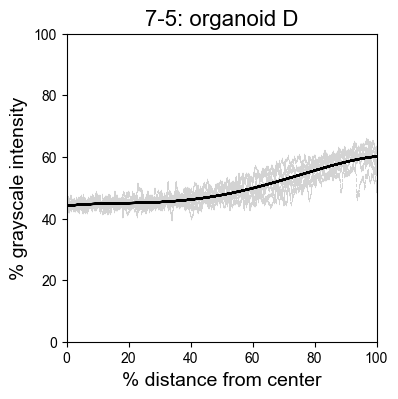

E


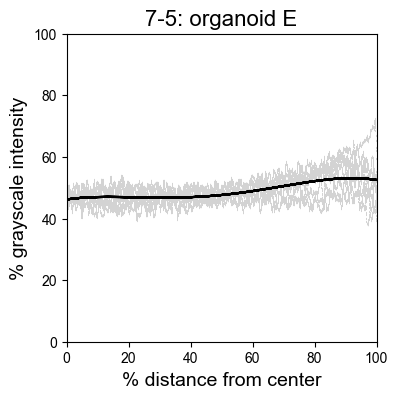

F


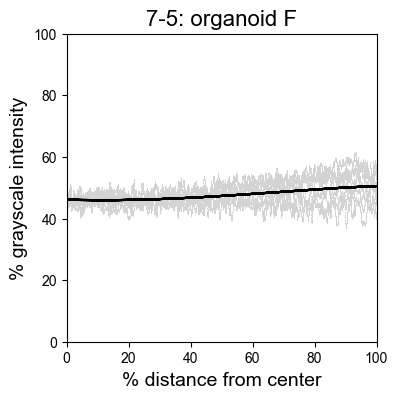

I


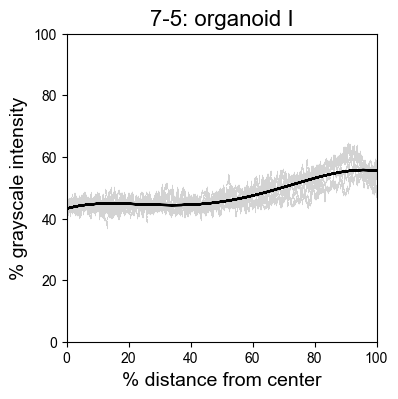

A


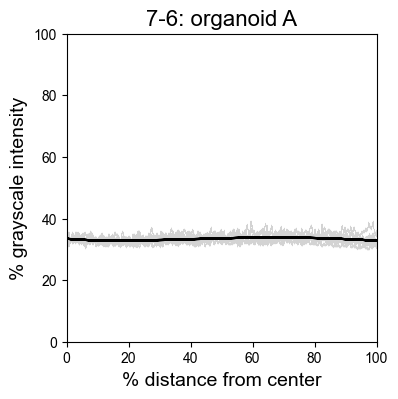

B


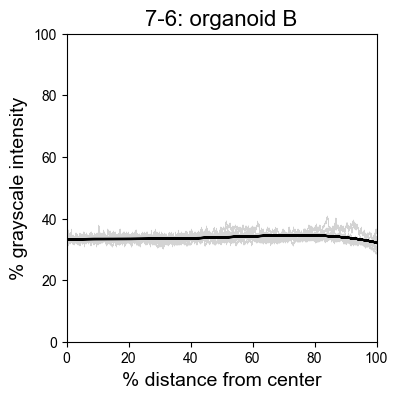

D


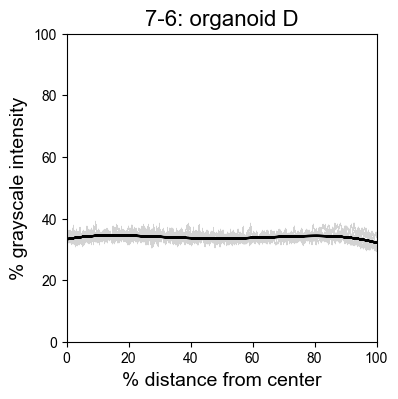

E


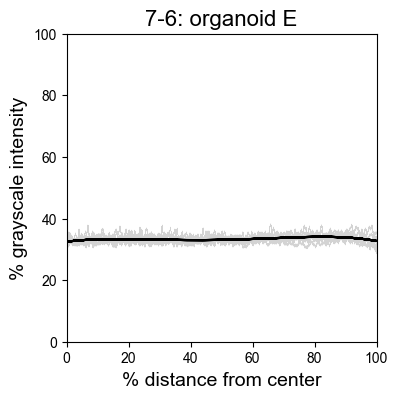

F


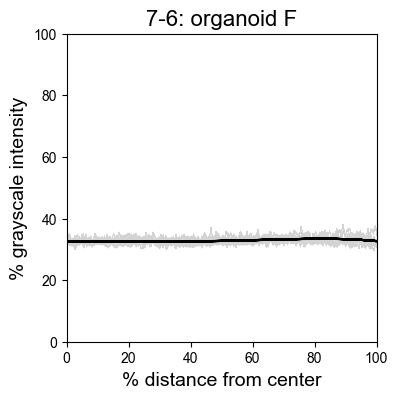

I


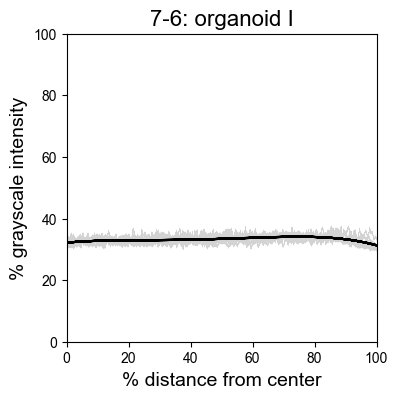

J


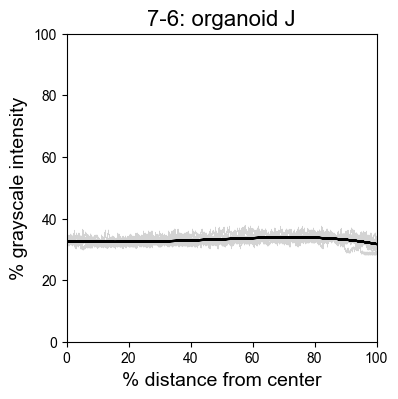

A


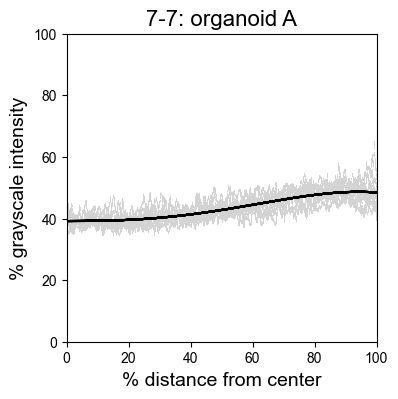

B


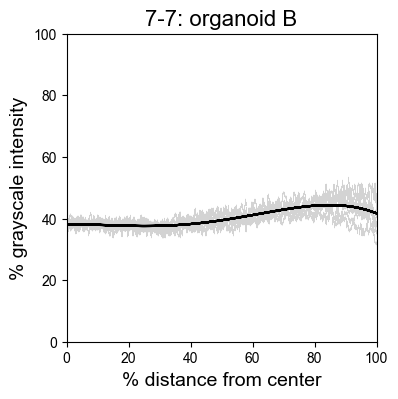

D


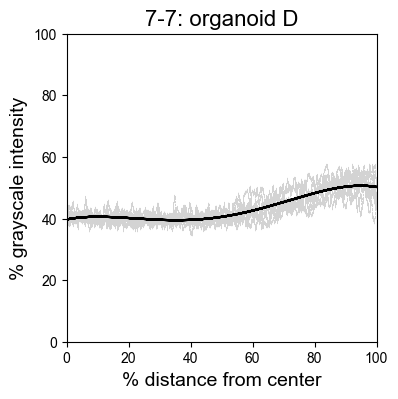

E


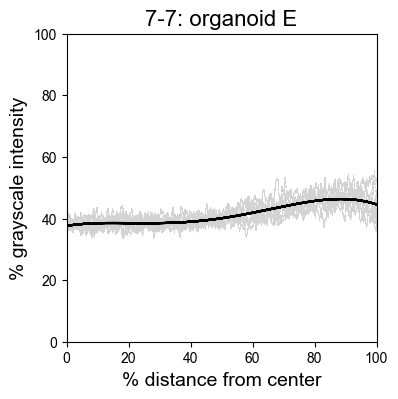

F


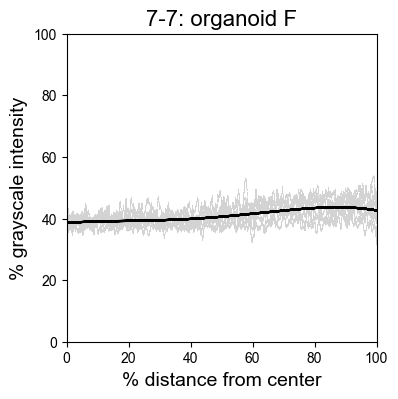

I


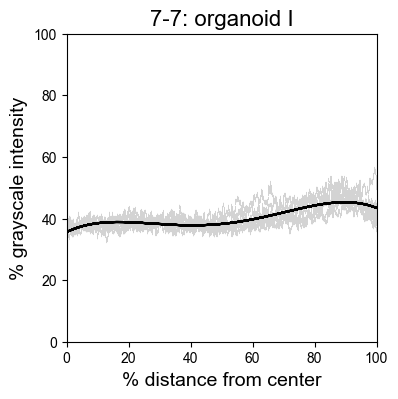

J


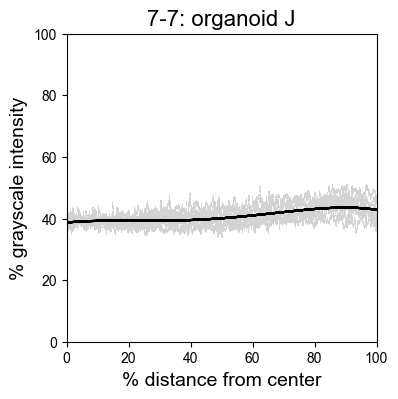

A


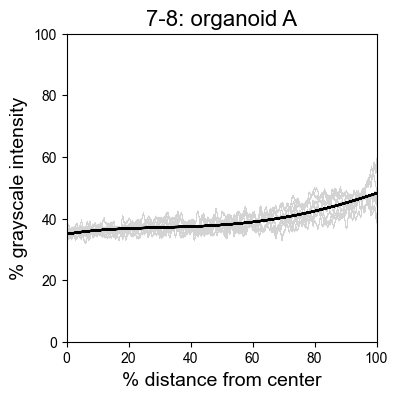

B


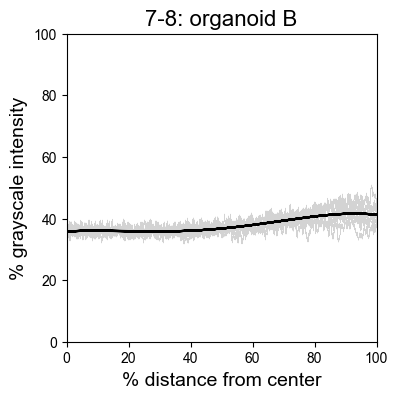

D


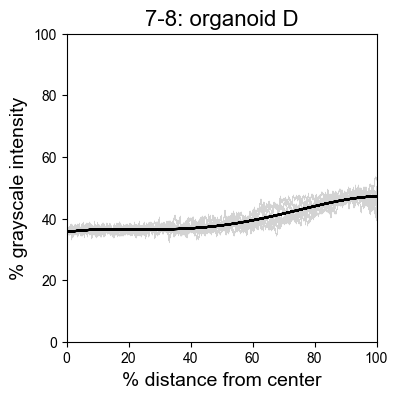

F


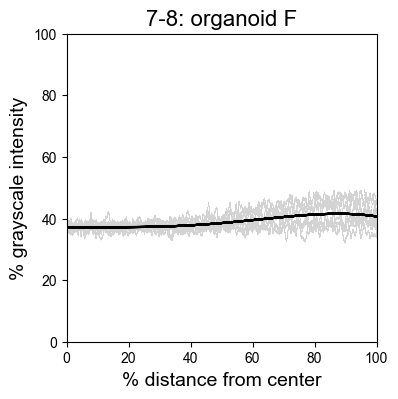

I


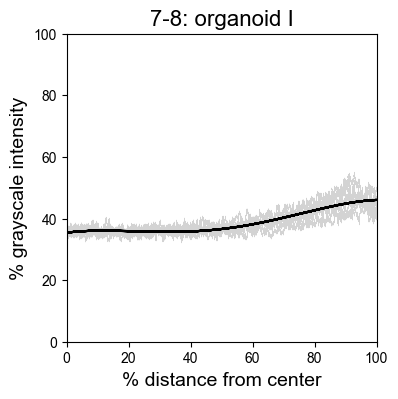

J


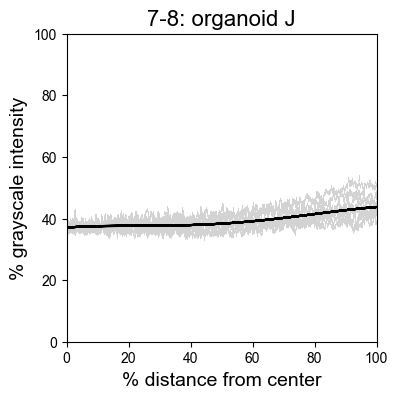

A


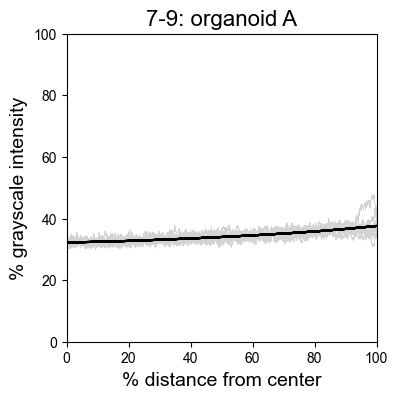

F


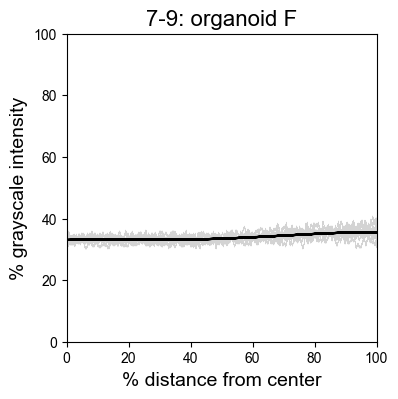

I


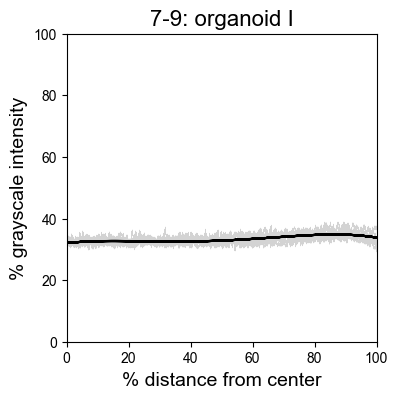

J


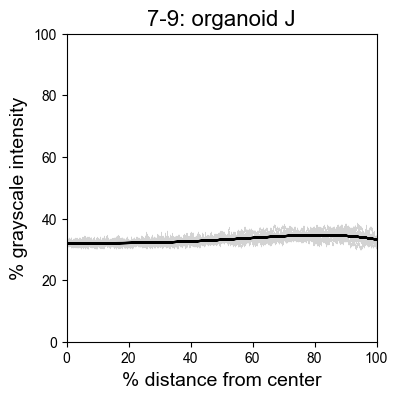

In [6]:
#NOTE: This one takes awhile to run (outputs 56 * ~8  = 500 graphs)
# step 3.2 concat and graph all reps of each organoid.
# 1 graph for each organoid in each condition: (1) %dist from center (x) vs. %gray (y) 
# **note that the graph of %dist vs. %gray was very similar in shape to dist_c vs. %gray (so just do % vs. %)

# print all graphs of all organoids (by themselves)--not concat between each folder
# graphs of all organoids (by themselves) from all reps, with setup as in graph above

import matplotlib.pyplot as plt
import matplotlib as mpl

# returns a polynomial for "x" values for the coeffs provided. Coeffs must be in ascending order
def poly_coeffs(x, coeffs):
    o = len(coeffs)
    #print("This is a polynomial of order ", o, ".")

    y = [0] * len(x)
    for i in range(o):
        for j in range(len(x)):
            y[j] += coeffs[i] * x[j]**i

    return y

# format graph
mpl.rcParams['scatter.marker'] = '.'
mpl.rcParams['lines.markersize'] = 0.5
mpl.rcParams['font.sans-serif'] = 'Arial'

# For every organoid rep in every folder: concat all csvs for that rep and plot 2 graphs.
for folder in ls_folders:
    n = get_numreps(folder)
    folder_i = d_condits[folder]
    
    for j in range(n):
        org_rep_name = ls_lsreps[folder_i][j*4]
        print(org_rep_name)
        ls_dfs = get_ls_dfs(folder_i, ls_d_reps[folder_i][org_rep_name])

        # get part of title based on where we are in loop
        title = folder + ": organoid " + org_rep_name

        #PLOT 1: %dist (x) vs. %gray (y)
        # concat x and y values 
        x1 = concat_reps(ls_dfs, "%dist")
        y1 = concat_reps(ls_dfs, "gray%")
        
        #plot scotter plot of x1,y1 values
        fig1, ax1 = plt.subplots(figsize=(4,4))
        ax1.set_xlim(left=0, right=100)
        ax1.set_ylim(bottom=0, top=100)
        ax1.set_xlabel("% distance from center" , fontsize=14)
        ax1.set_ylabel("% grayscale intensity", fontsize=14)
        ax1.set_title(title, fontsize=16)
        ax1.scatter(x1, y1, c="lightgray", marker=1)
            
        #fit and plot polynomial line of best fit
        ls_coeffs1 = []
        ls_coeffs1 = np.polyfit(x1, y1, 4).tolist()
        ls_coeffs1.reverse()
            
        ax1.plot(x1, poly_coeffs(x1, ls_coeffs1), "k-")
        plt.show()

        ls_dfs = []

i= 2 ab= MAP2
j= 1 orgline= A02
1-2
2-2


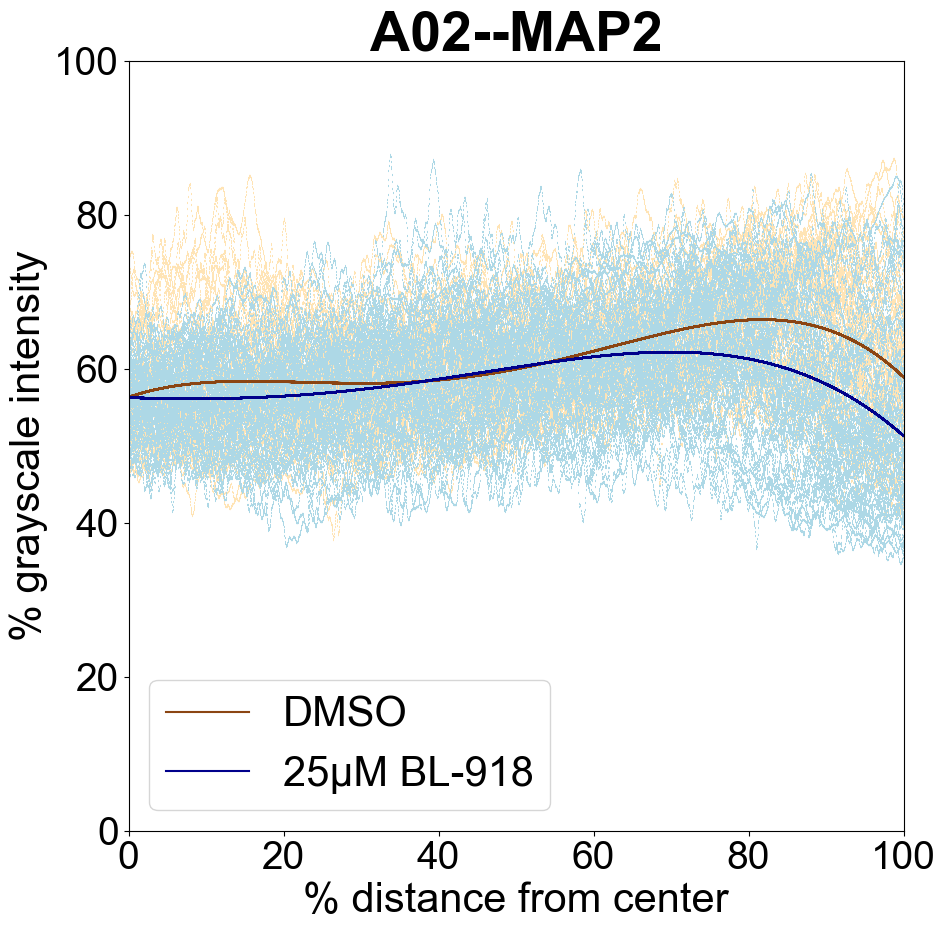

j= 3 orgline= E11
3-2
4-2


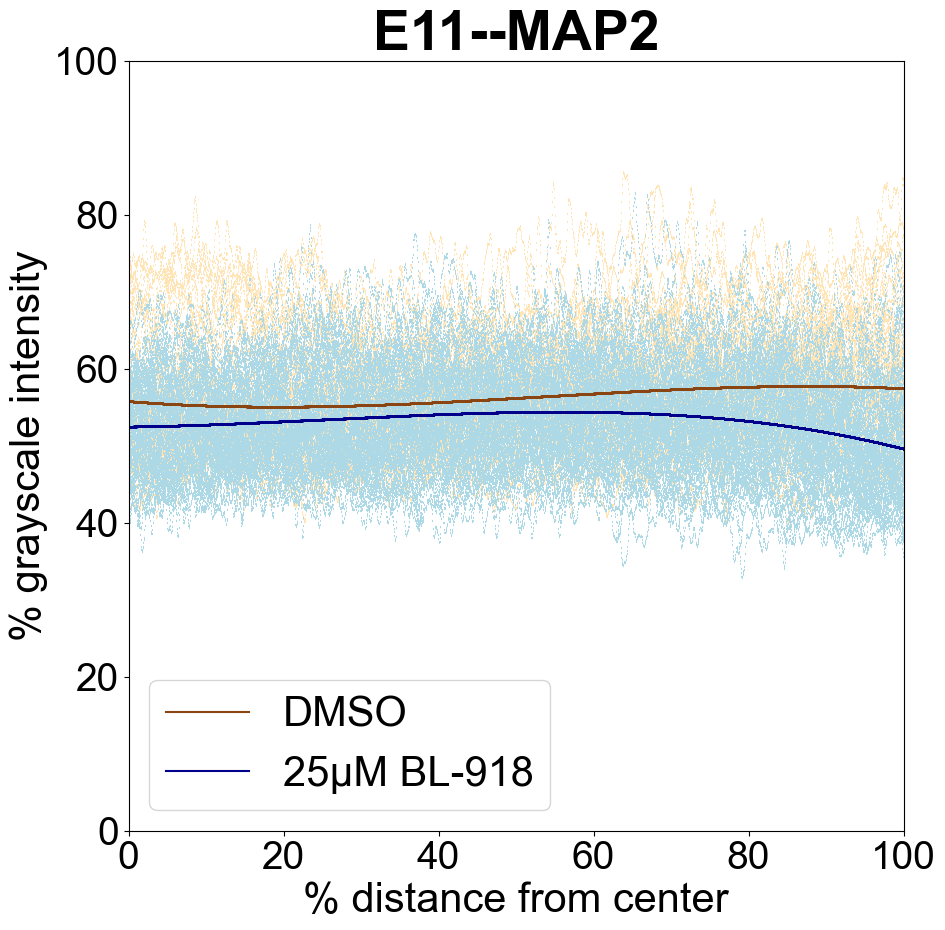

j= 5 orgline= A01
5-2
6-2


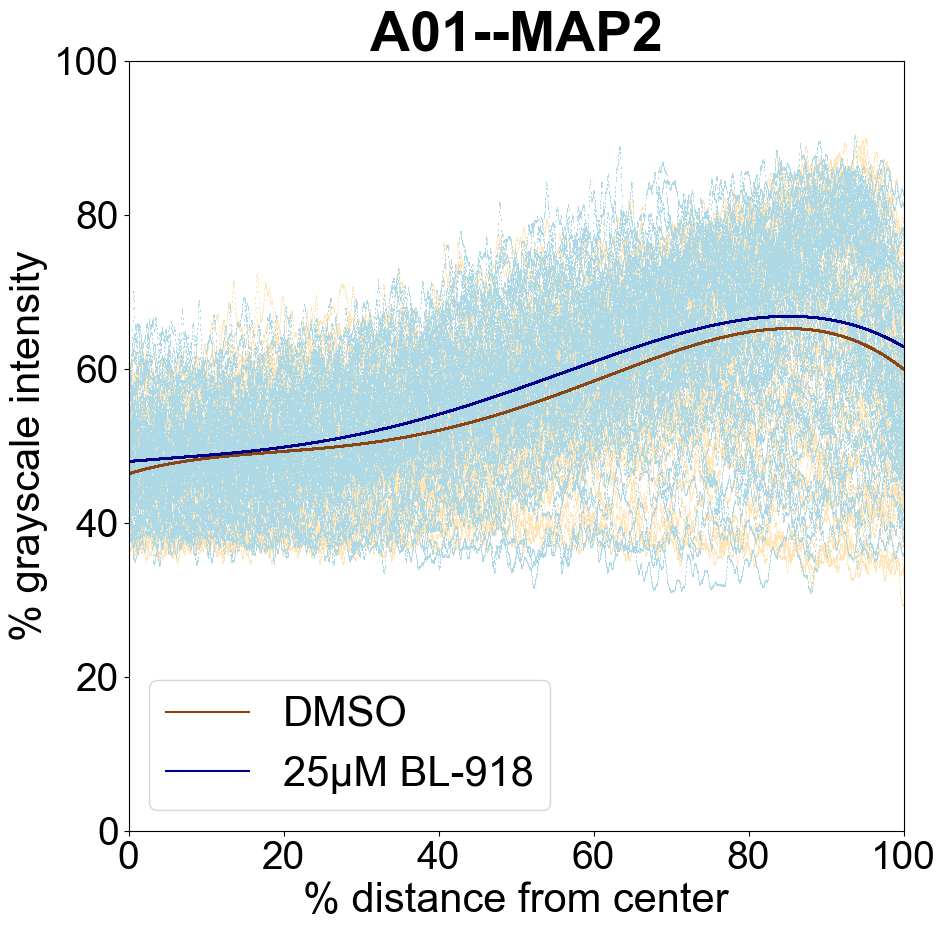

j= 7 orgline= B12
7-2


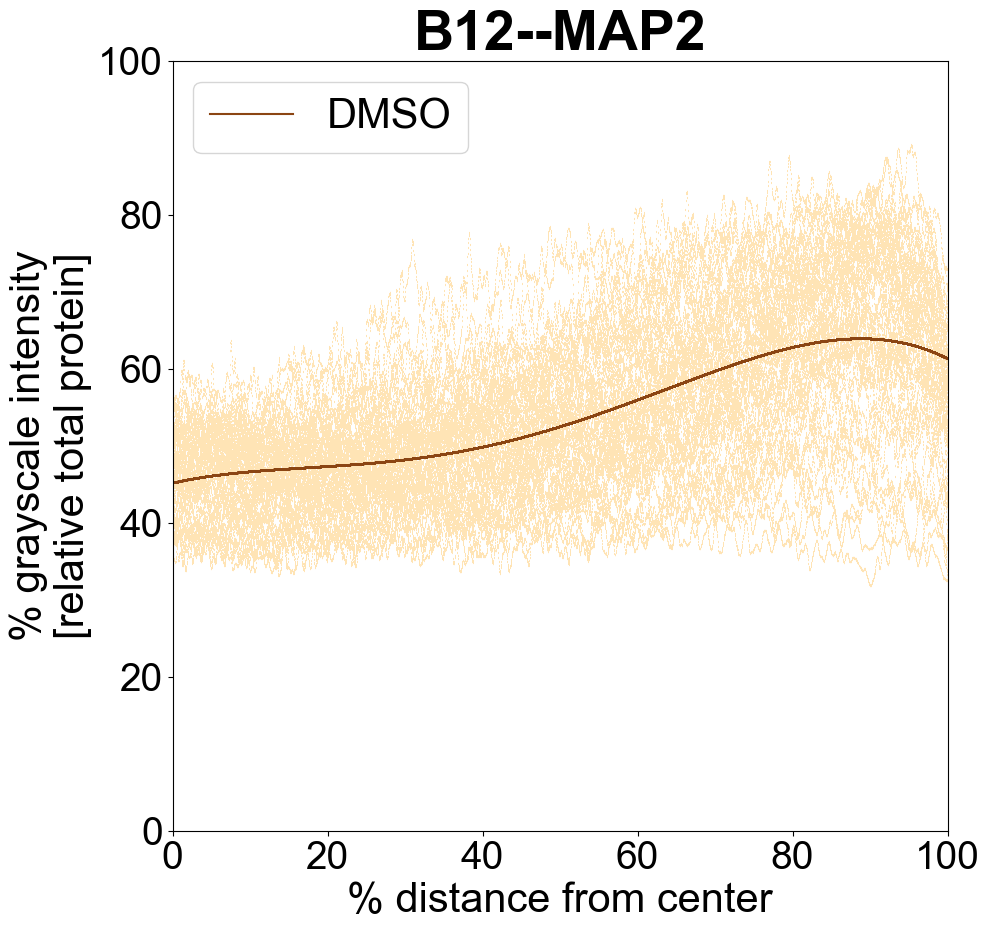

i= 3 ab= AT8
j= 1 orgline= A02
1-3
2-3


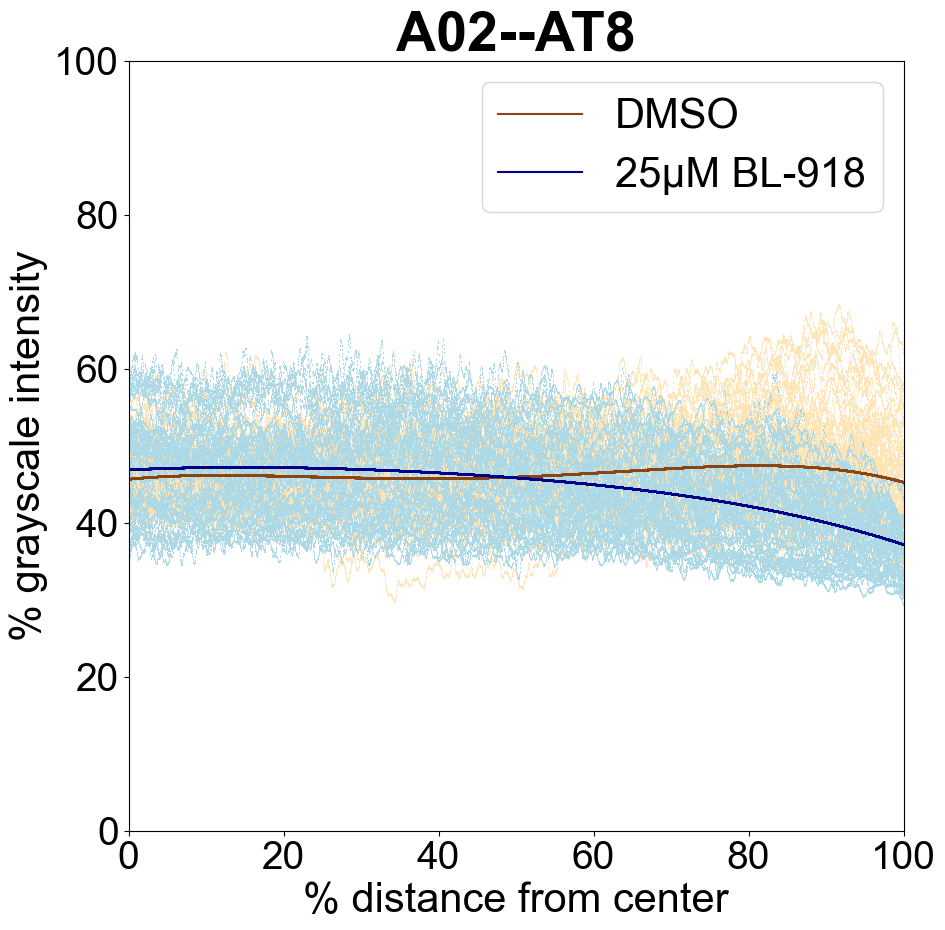

j= 3 orgline= E11
3-3
4-3


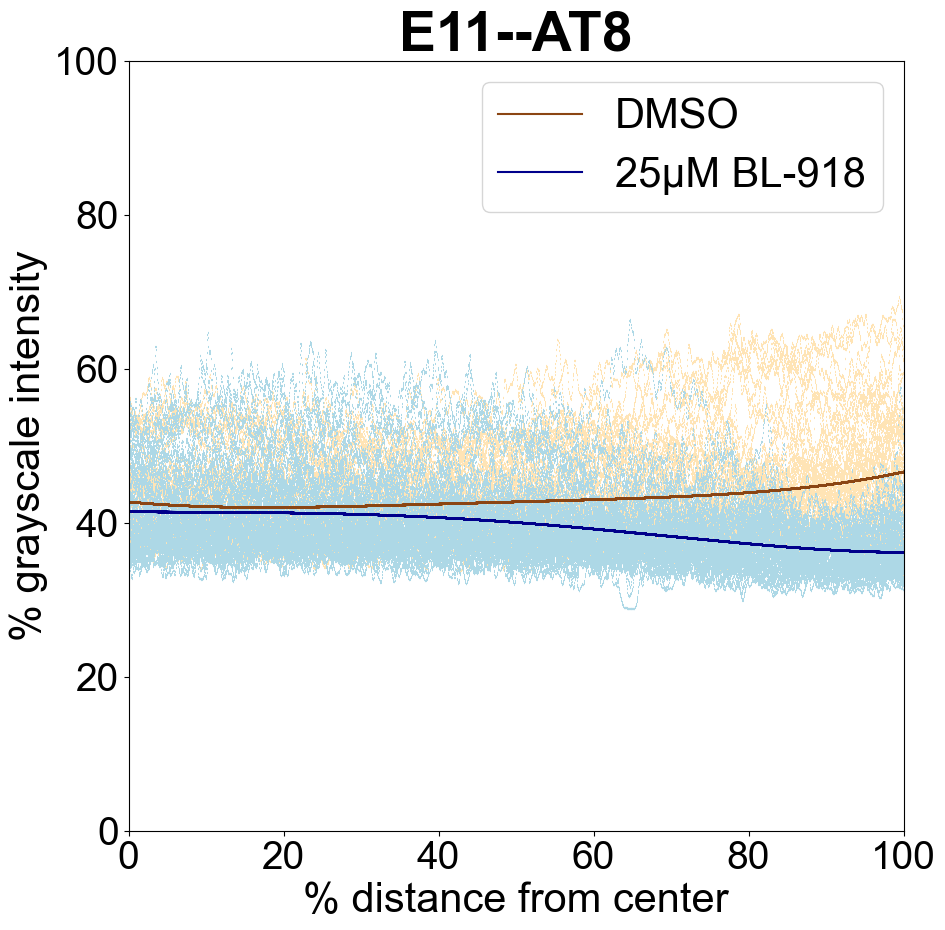

j= 5 orgline= A01
5-3
6-3


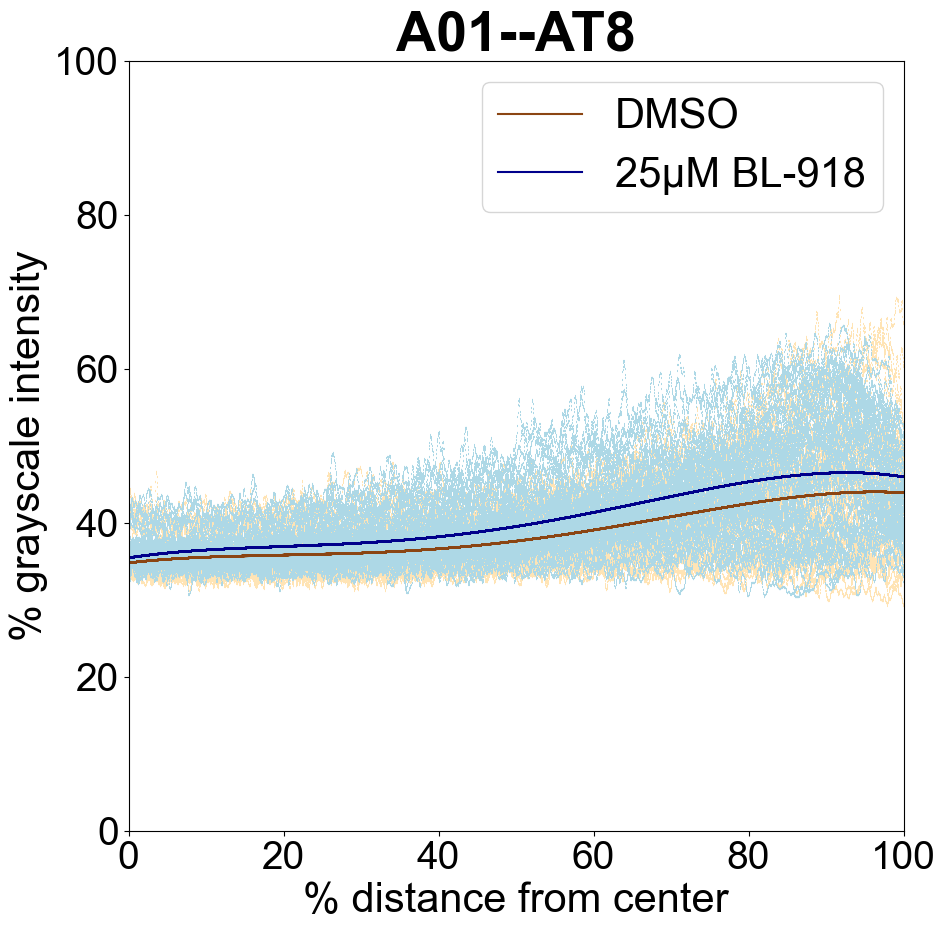

j= 7 orgline= B12
7-3


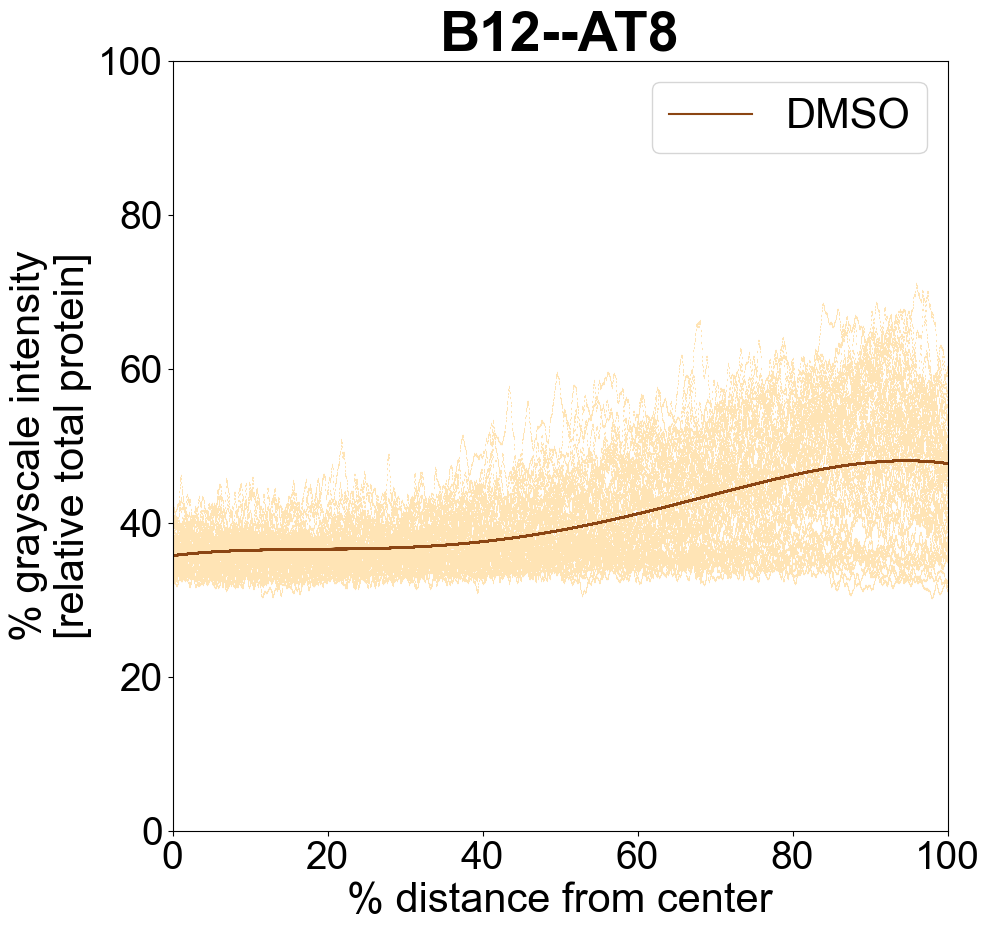

i= 4 ab= HT7
j= 1 orgline= A02
1-4
2-4


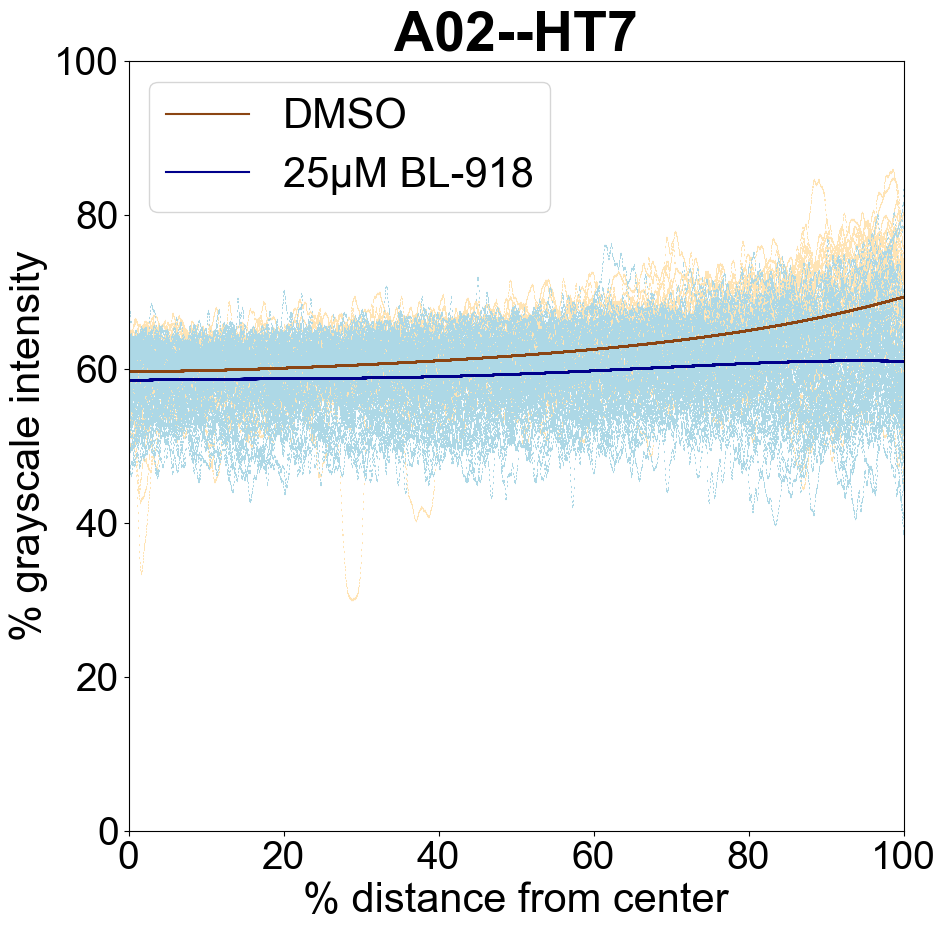

j= 3 orgline= E11
3-4
4-4


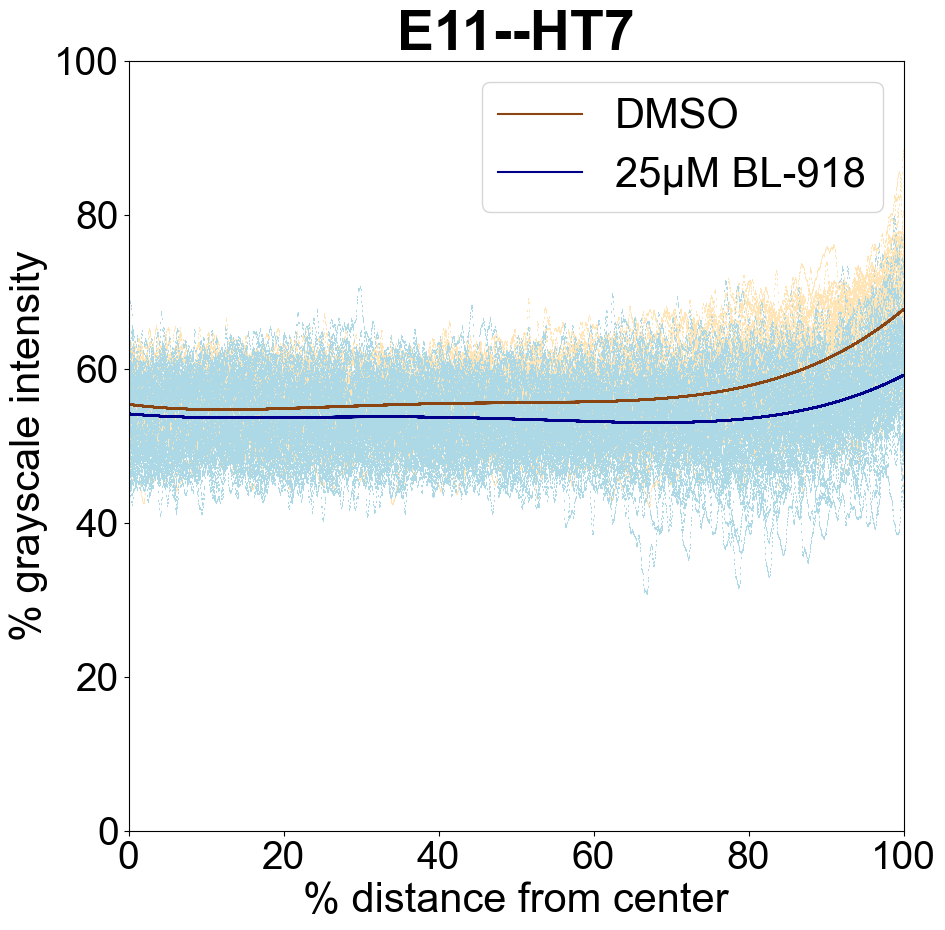

j= 5 orgline= A01
5-4
6-4


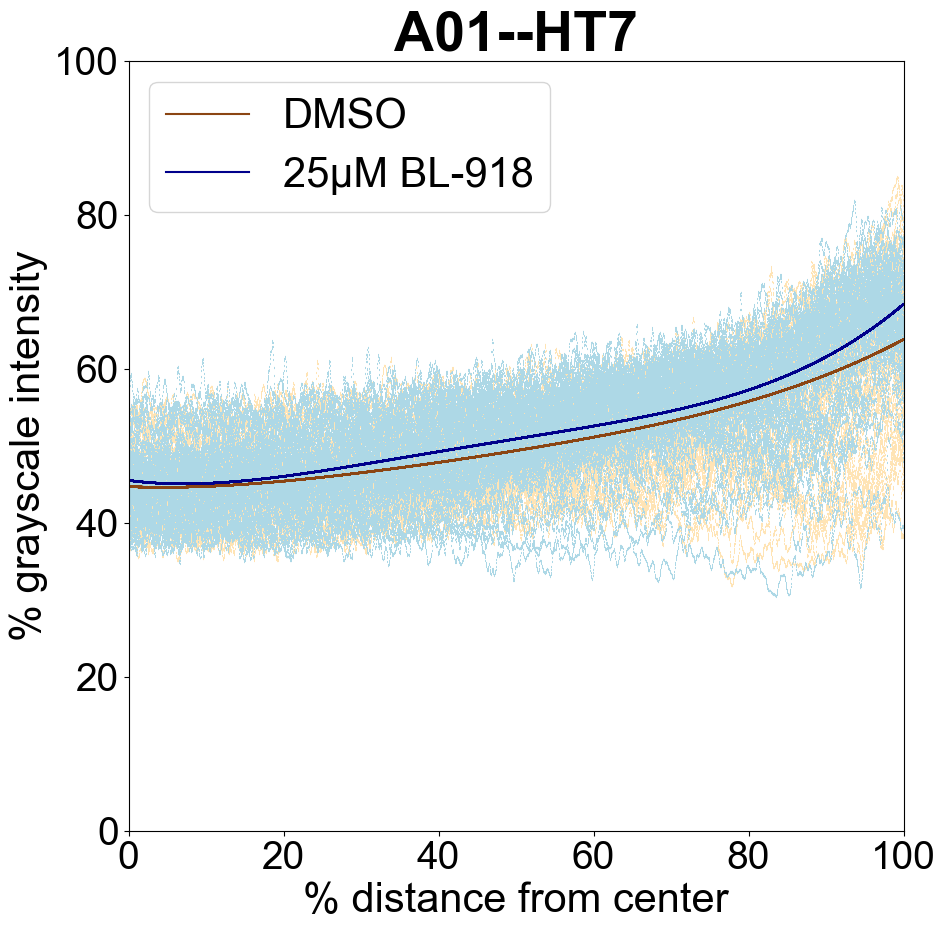

j= 7 orgline= B12
7-4


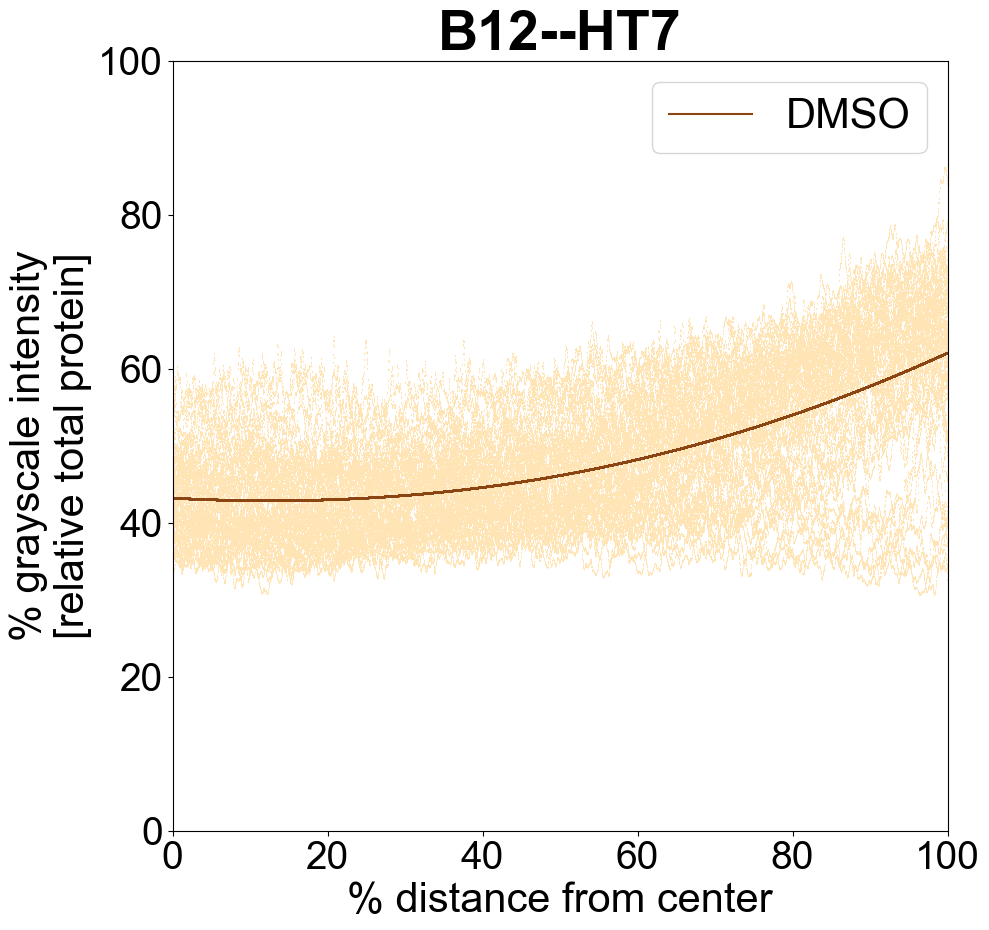

i= 5 ab= Beclin-1
j= 1 orgline= A02
1-5
2-5


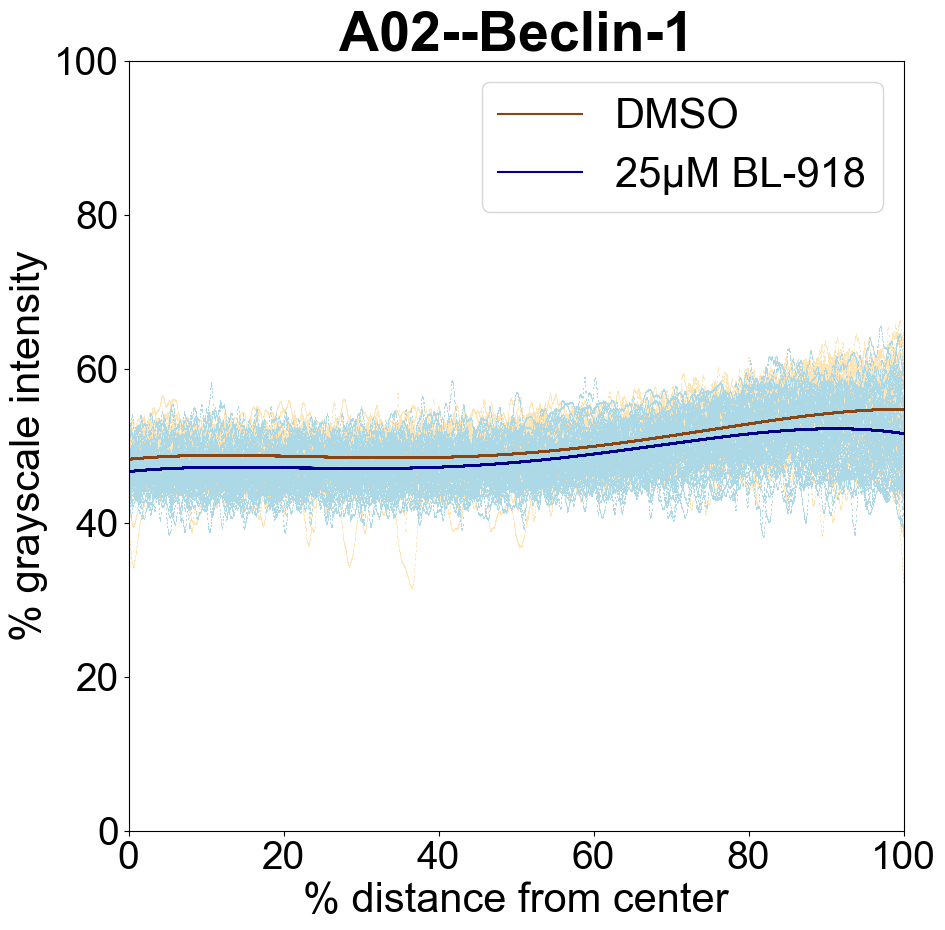

j= 3 orgline= E11
3-5
4-5


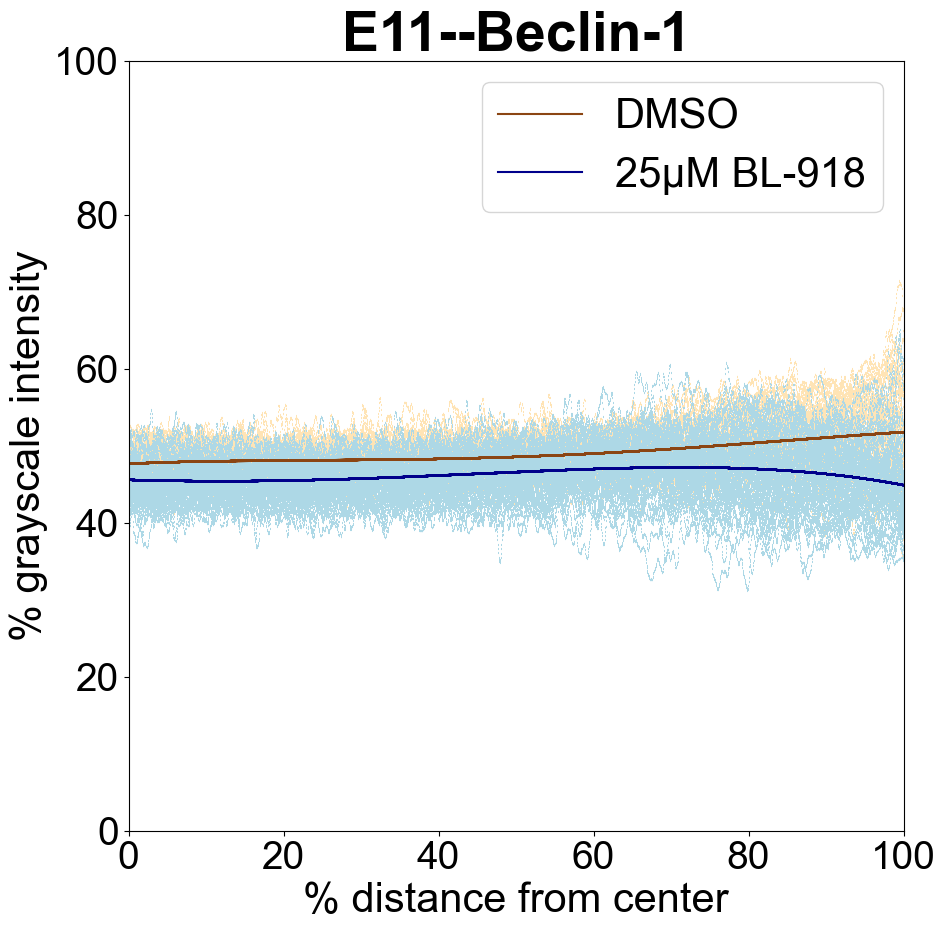

j= 5 orgline= A01
5-5
6-5


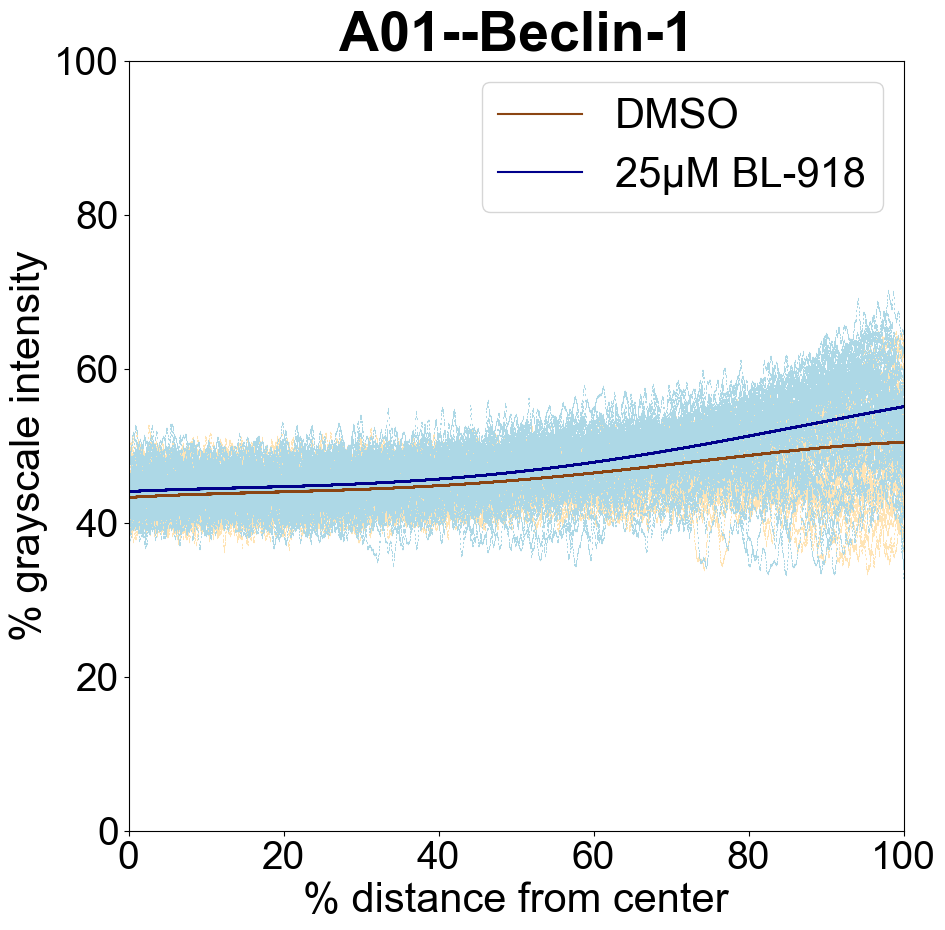

j= 7 orgline= B12
7-5


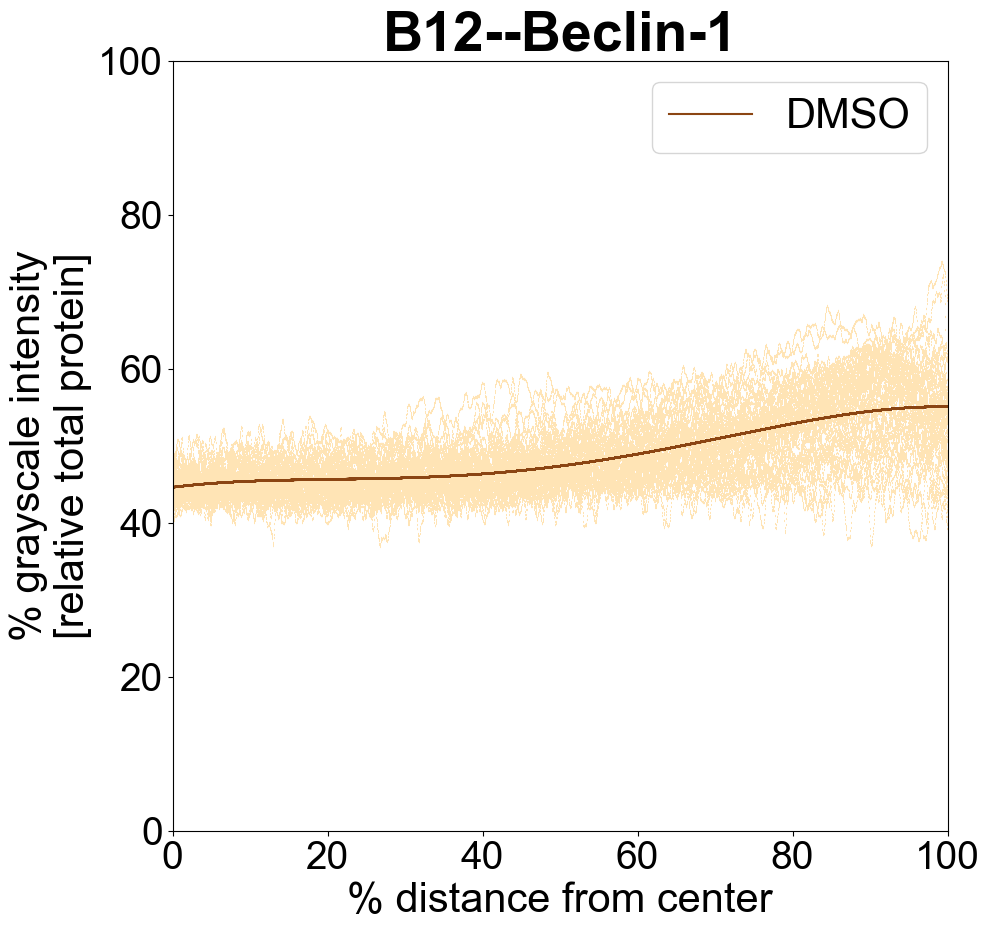

i= 6 ab= p62
j= 1 orgline= A02
1-6
2-6


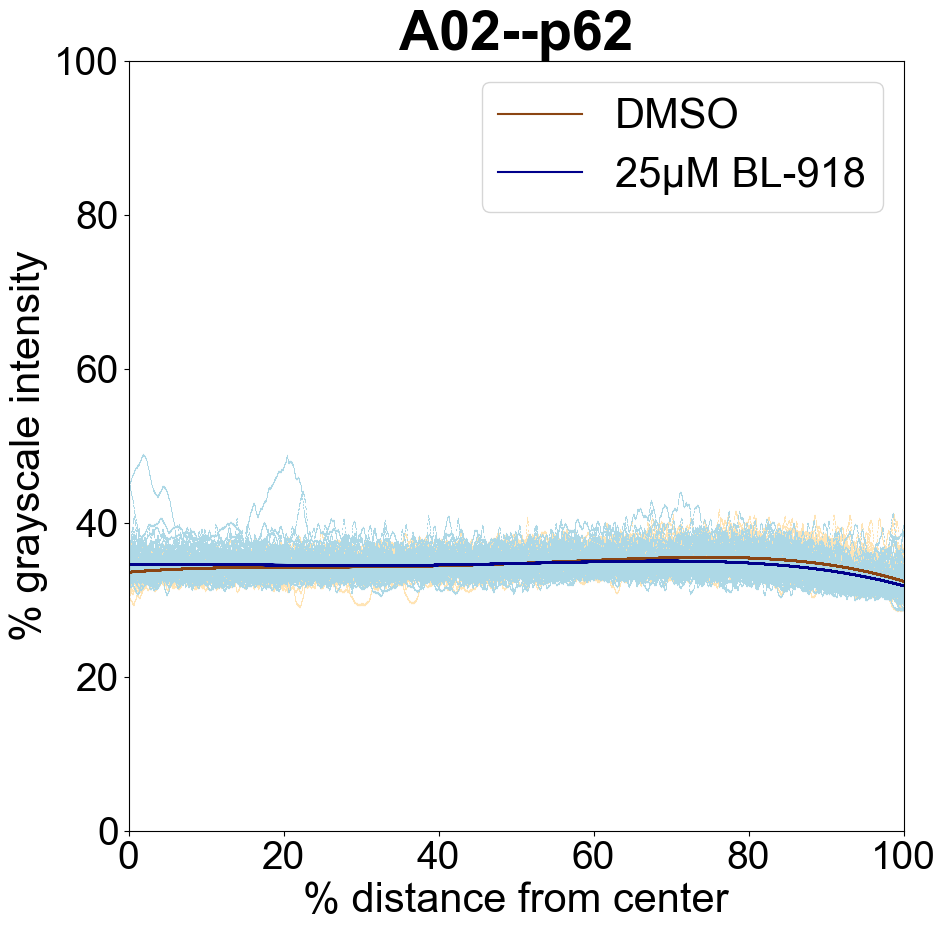

j= 3 orgline= E11
3-6
4-6


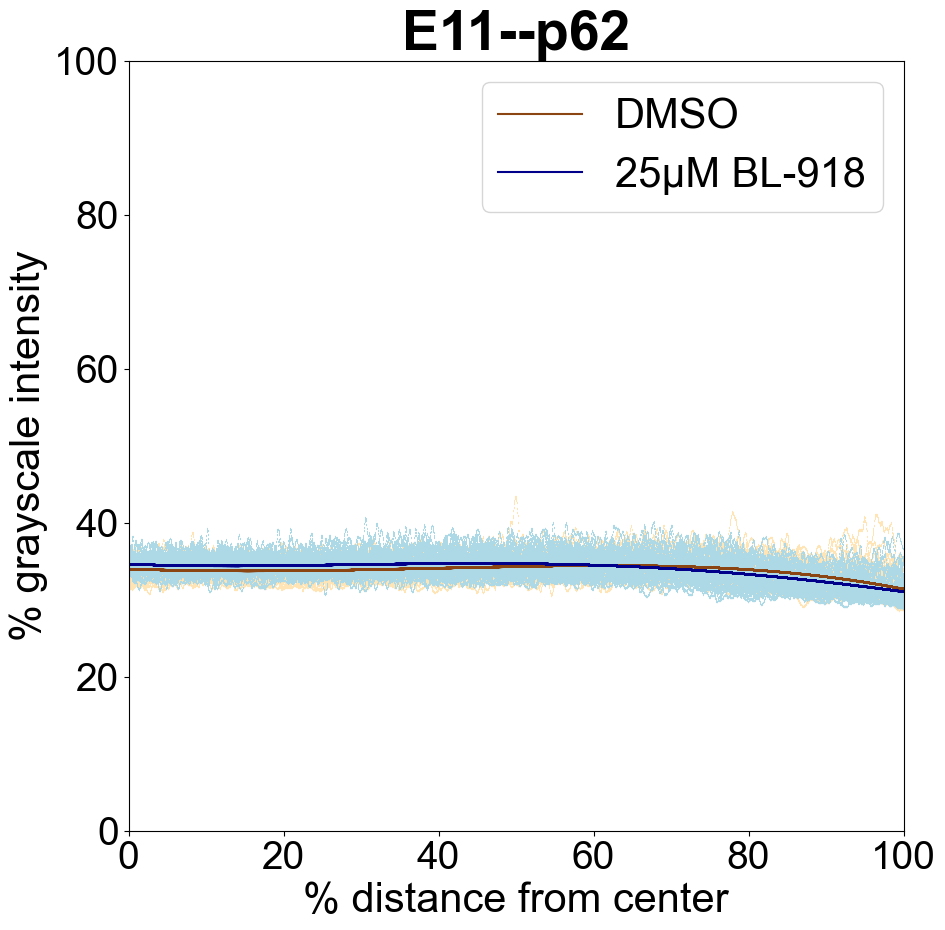

j= 5 orgline= A01
5-6
6-6


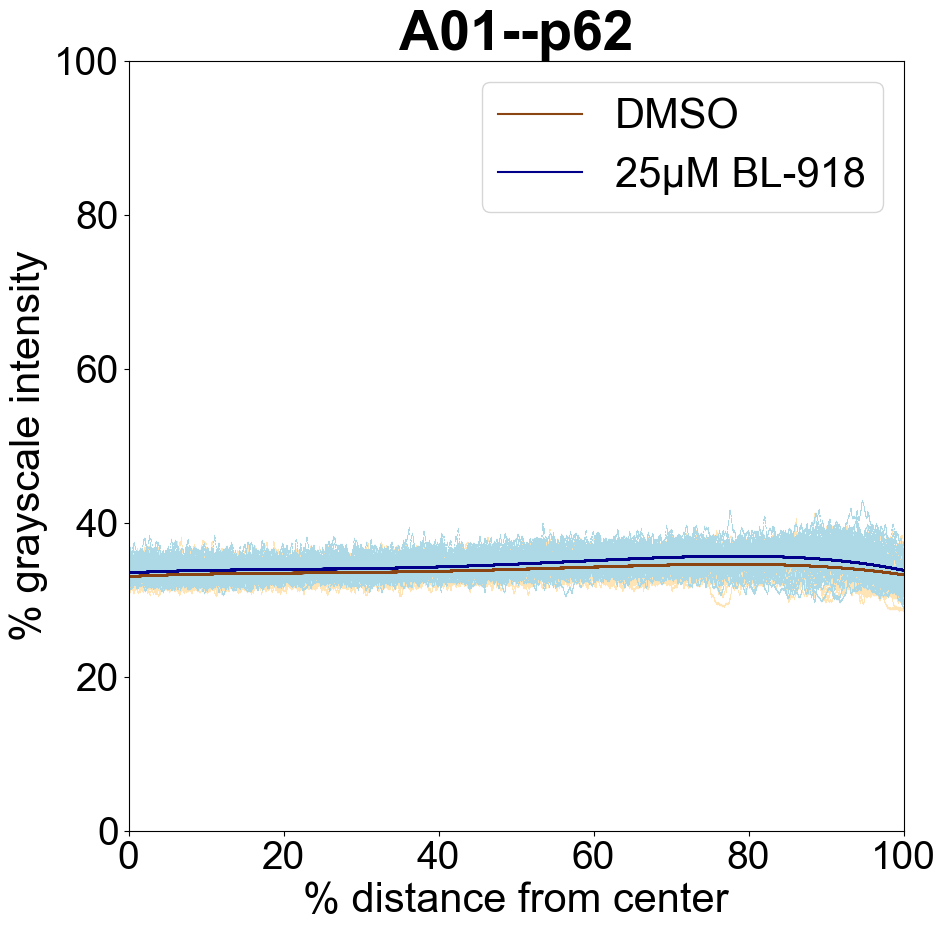

j= 7 orgline= B12
7-6


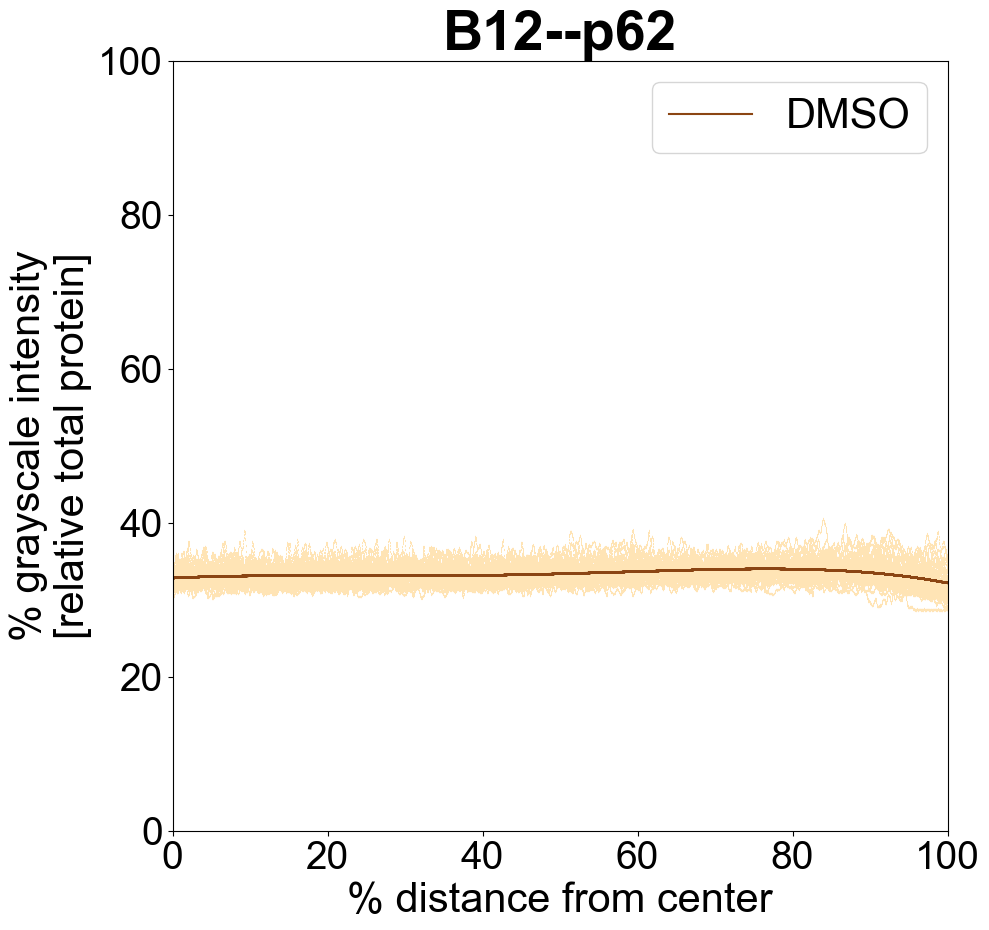

i= 7 ab= LC3
j= 1 orgline= A02
1-7
2-7


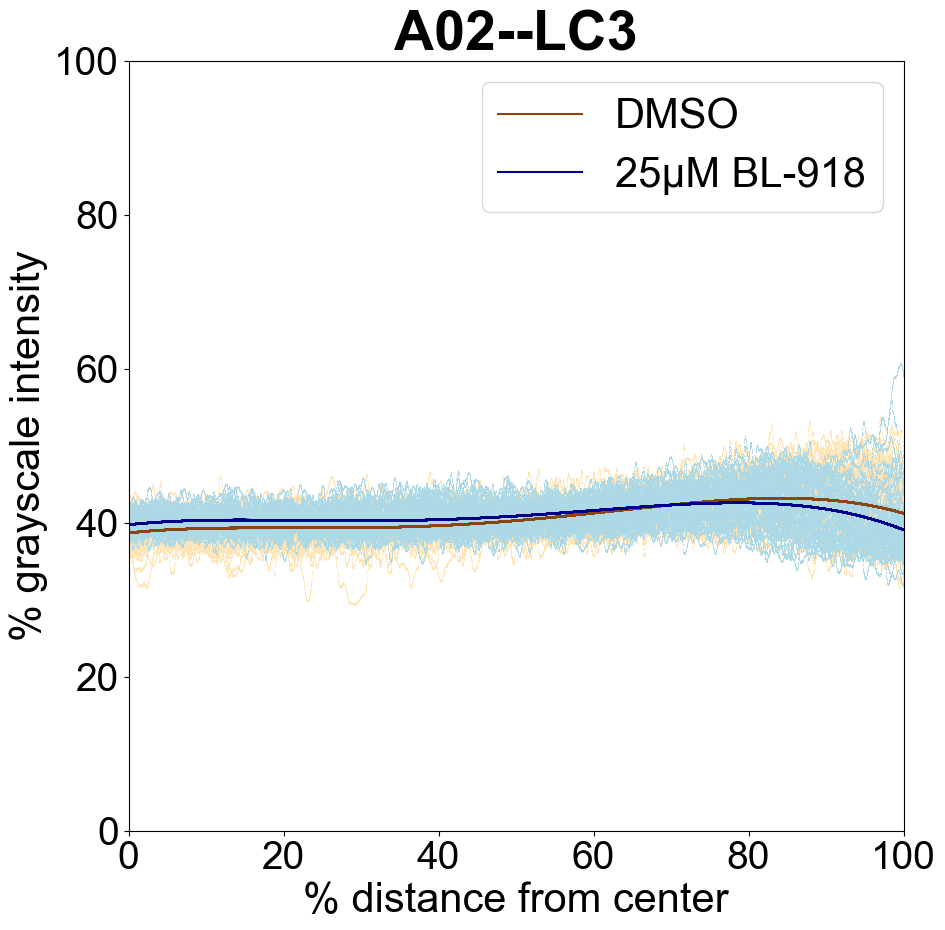

j= 3 orgline= E11
3-7
4-7


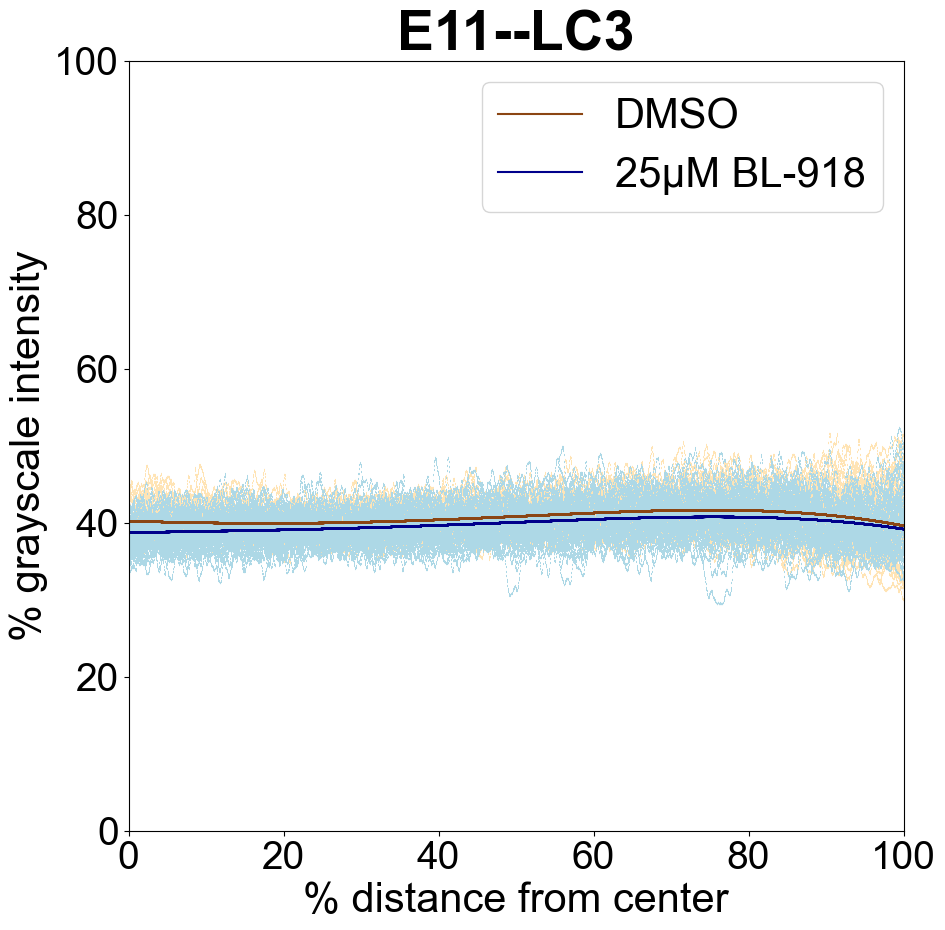

j= 5 orgline= A01
5-7
6-7


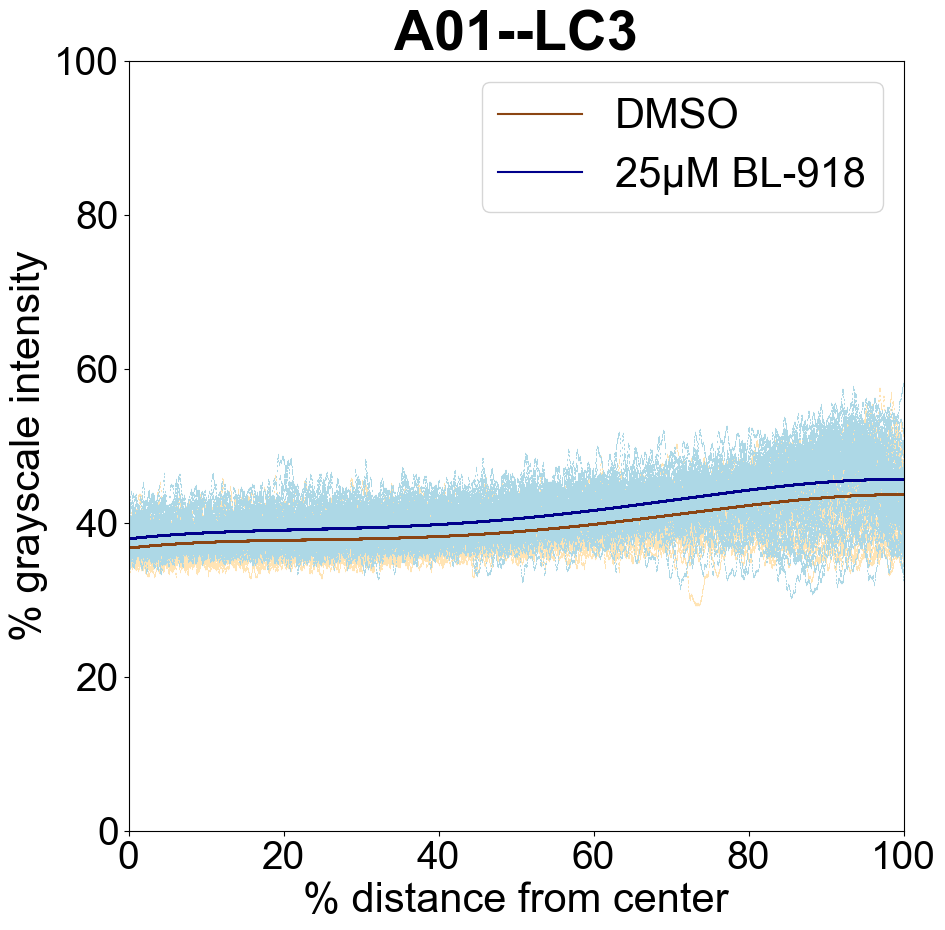

j= 7 orgline= B12
7-7


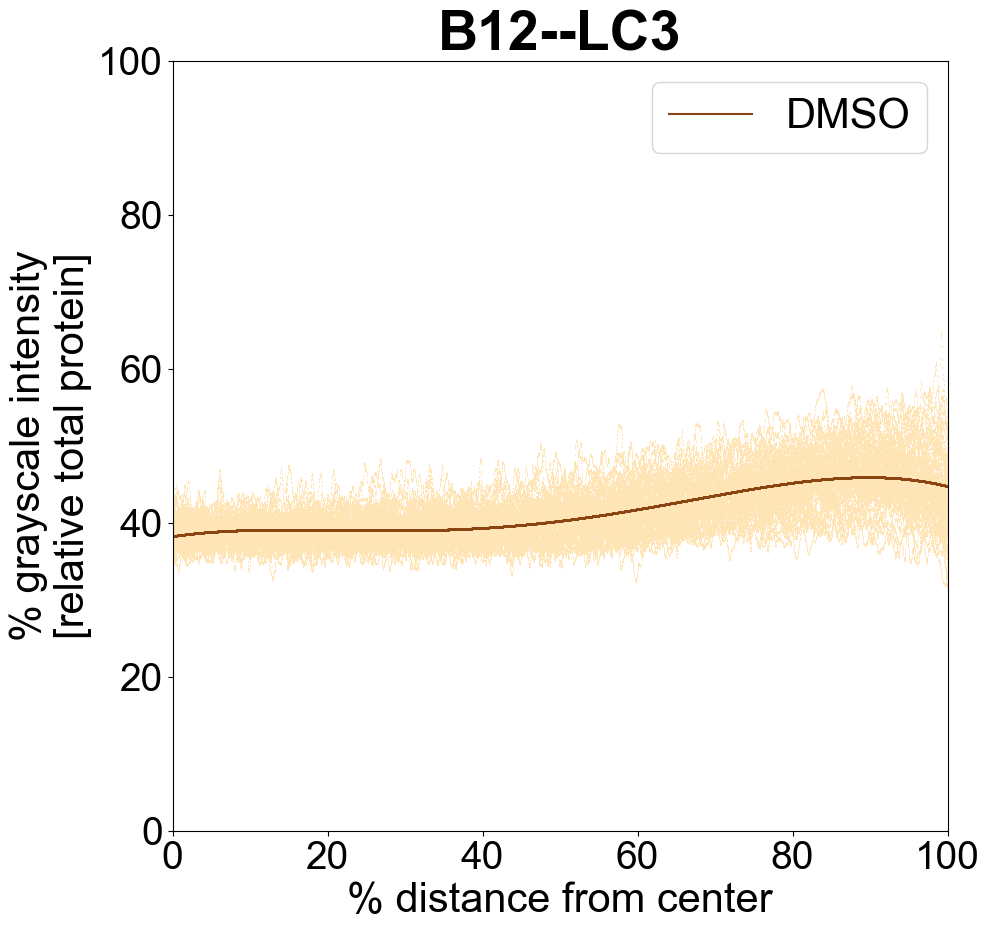

i= 8 ab= T22
j= 1 orgline= A02
1-8
2-8


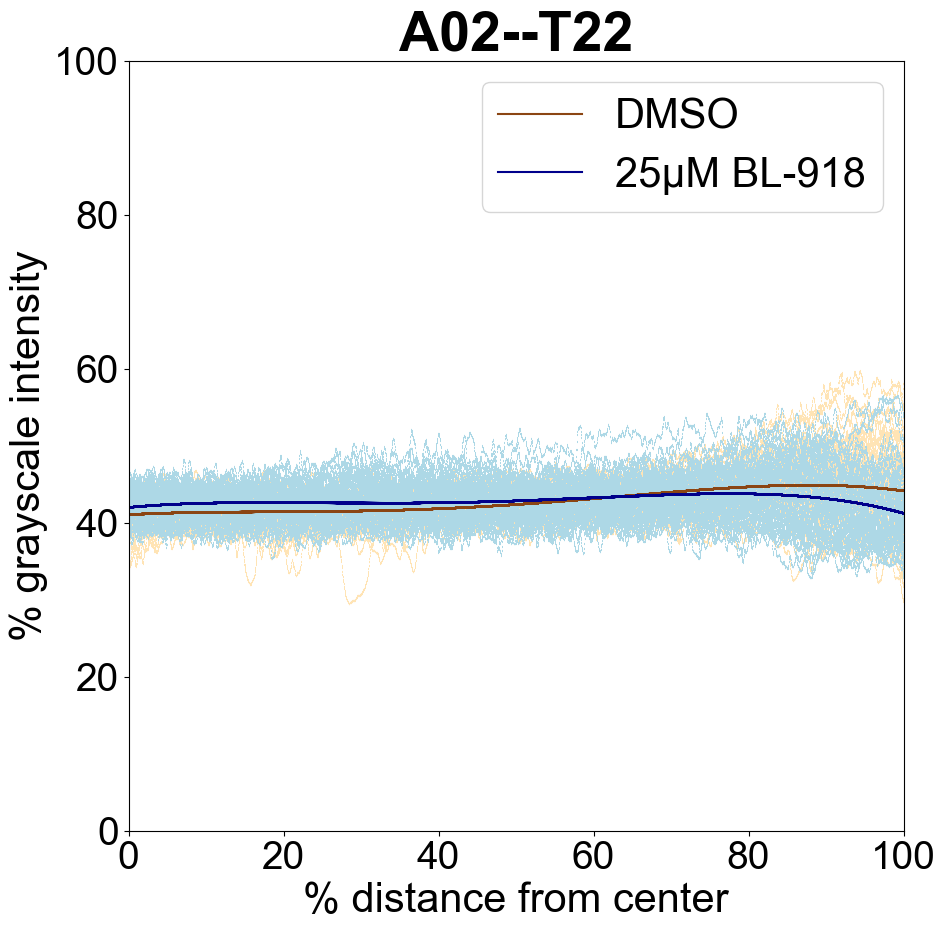

j= 3 orgline= E11
3-8
4-8


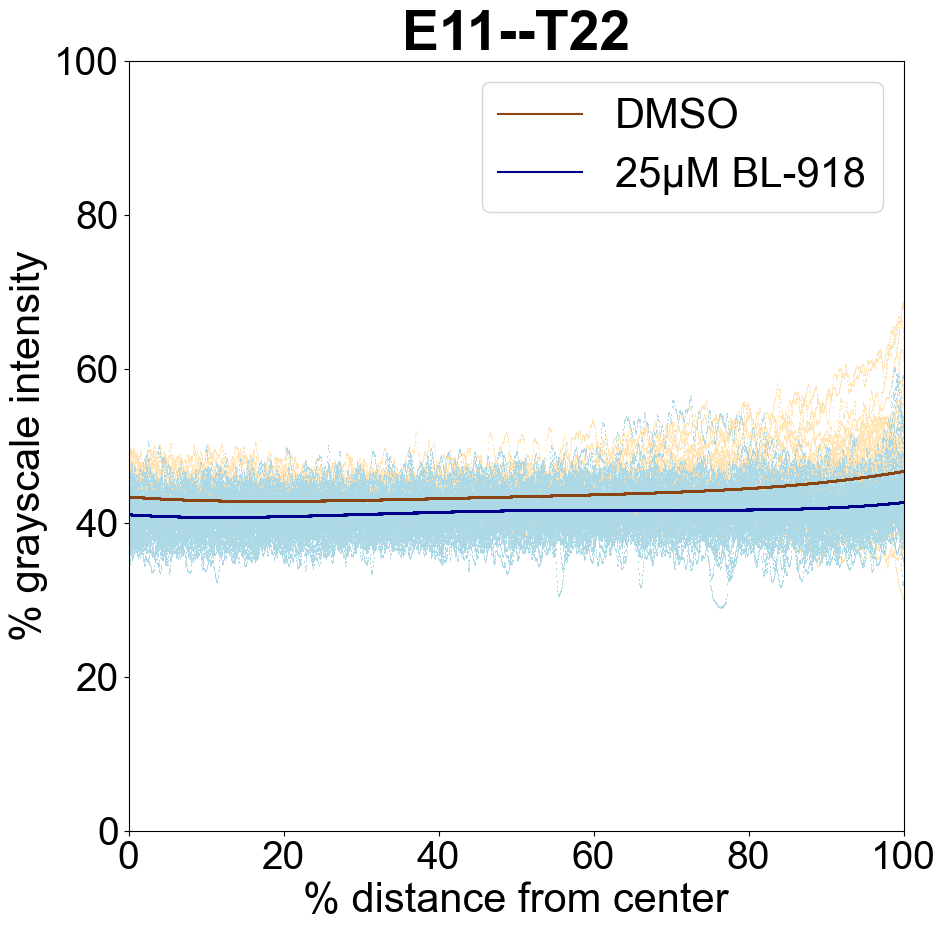

j= 5 orgline= A01
5-8
6-8


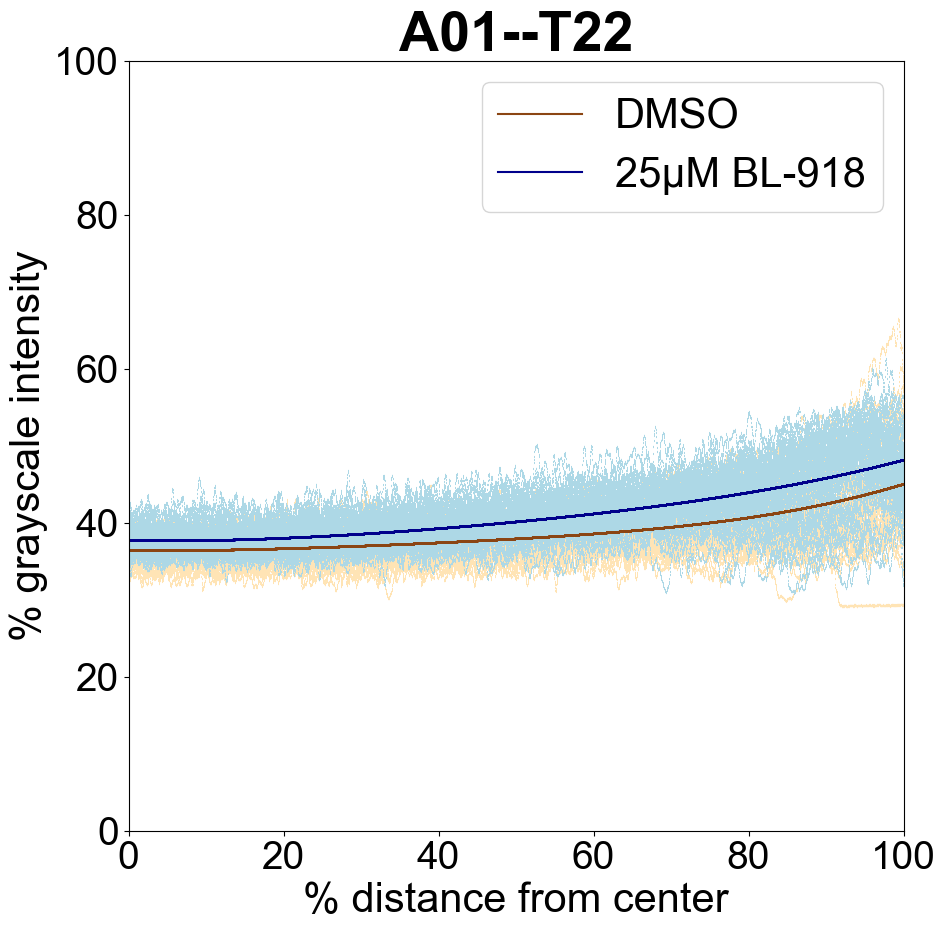

j= 7 orgline= B12
7-8


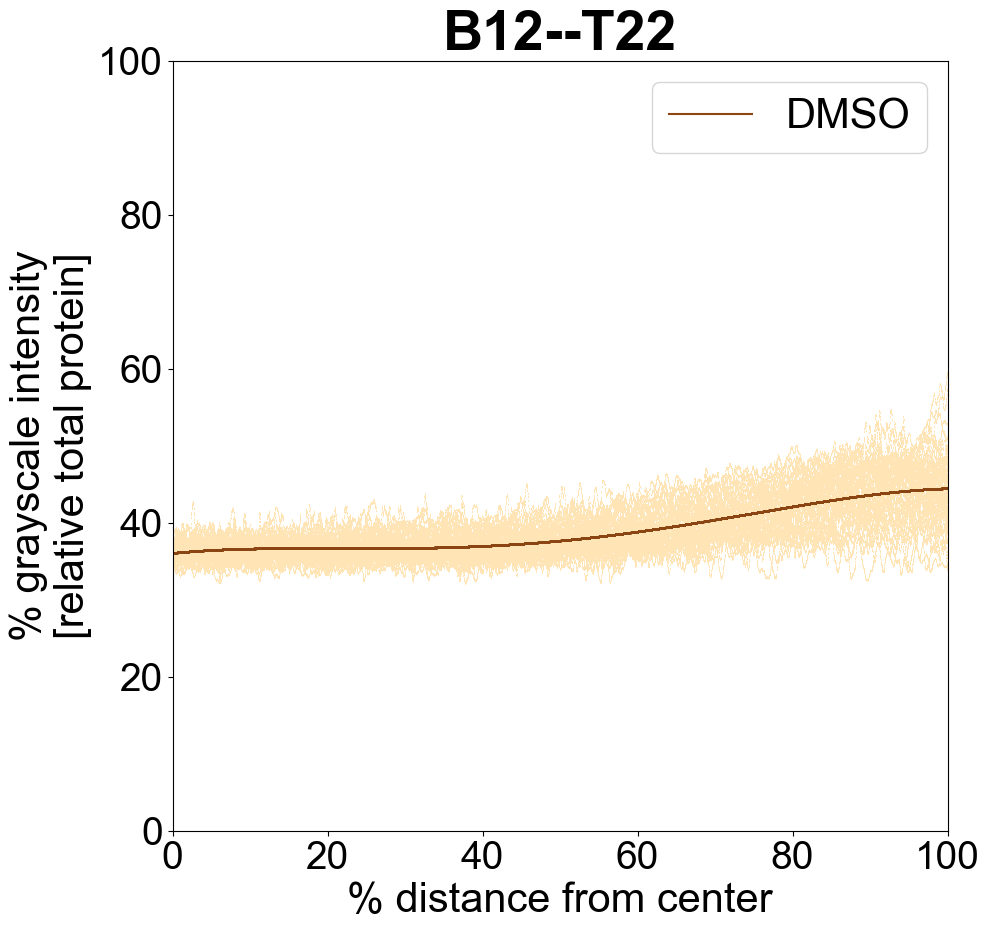

i= 9 ab= ULK1
j= 1 orgline= A02
1-9
2-9


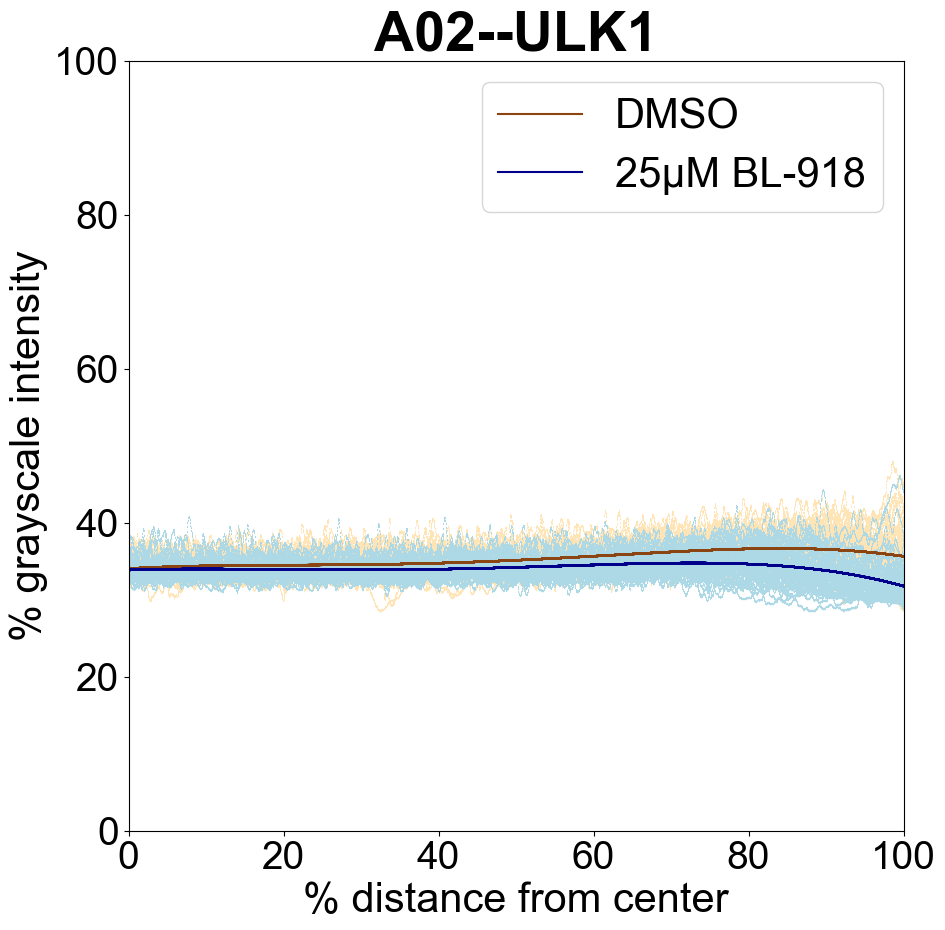

j= 3 orgline= E11
3-9
4-9


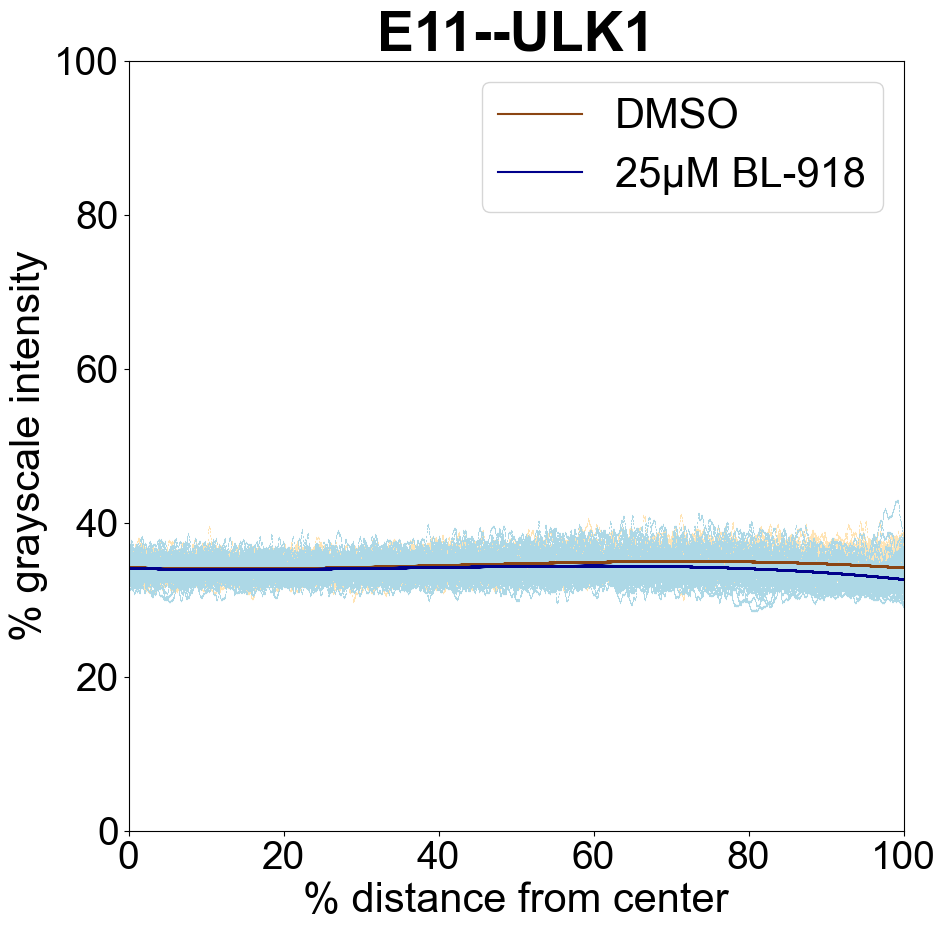

j= 5 orgline= A01
5-9
6-9


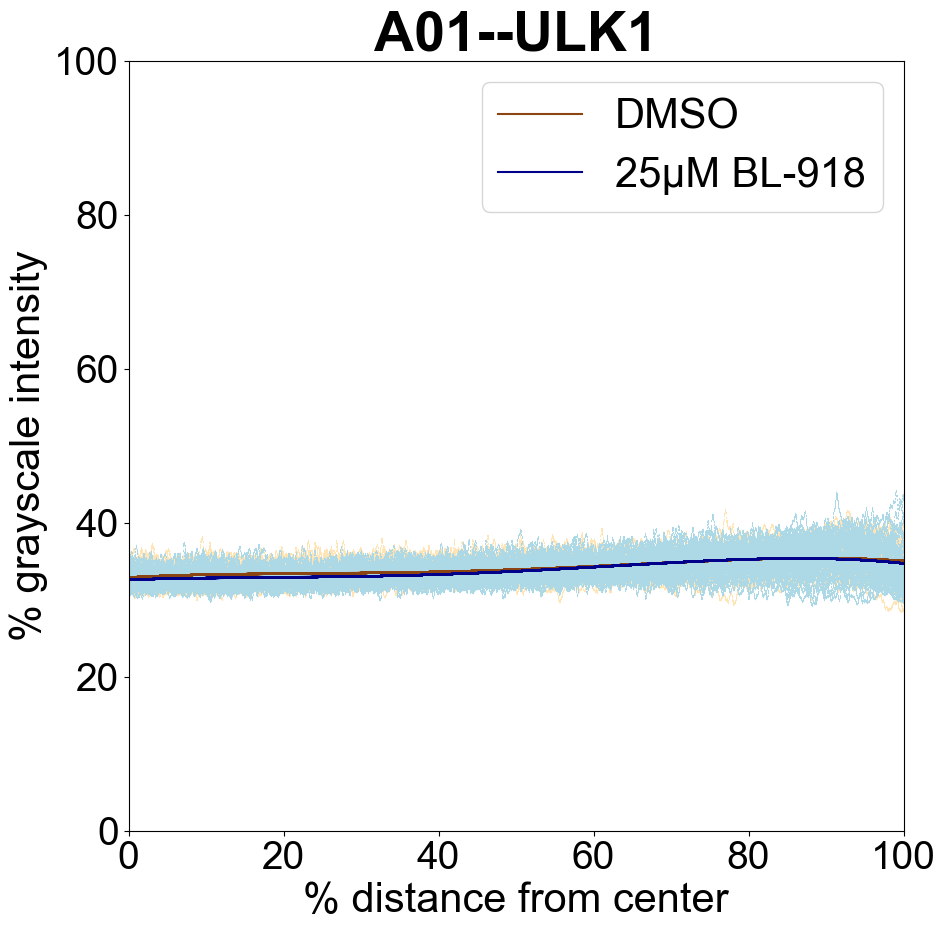

j= 7 orgline= B12
7-9


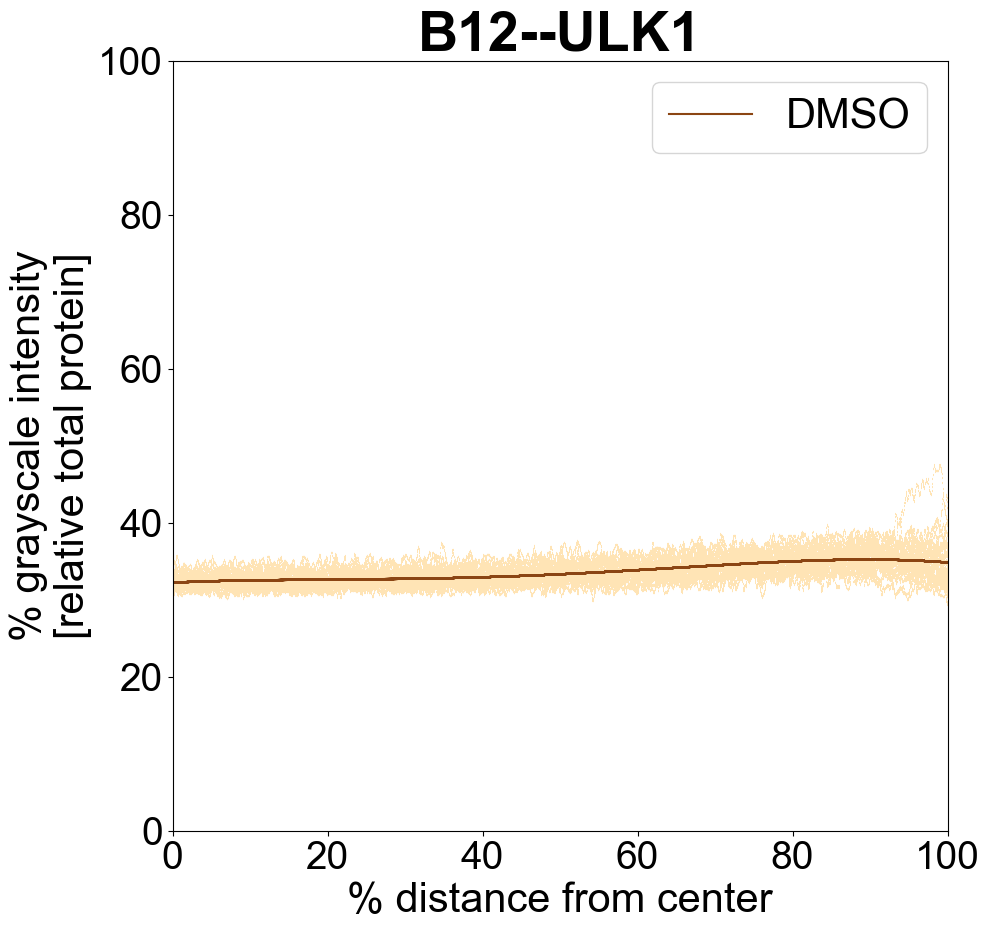

In [33]:
# step4: print one graph per condition, with one line each for the untreated, treated condition:

dict_titles = {"1-2":"A02: MAP2", "1-3":"A02: AT8", "1-4":"A02: HT7", "1-5":"A02: Beclin-1" , "1-6":"A02: p62", "1-7":"A02: LC3", "1-8": "A02: T22", "1-9":"A02: ULK1", 
               "2-2":"A02: MAP2", "2-3":"A02: AT8", "2-4":"A02: HT7", "2-5":"A02: Beclin-1" , "2-6":"A02: p62", "2-7":"A02: LC3", "2-8": "A02: T22", "2-9":"A02: ULK1",
               "3-2":"E11: MAP2", "3-3":"E11: AT8", "3-4":"E11: HT7", "3-5":"E11: Beclin-1" , "3-6":"E11: p62", "3-7":"E11: LC3", "3-8": "E11: T22", "3-9":"E11: ULK1",
               "4-2":"E11: MAP2", "4-3":"E11: AT8", "4-4":"E11: HT7", "4-5":"E11: Beclin-1" , "4-6":"E11: p62", "4-7":"E11: LC3", "4-8": "E11: T22", "4-9":"E11: ULK1",
               "5-2":"A01: MAP2", "5-3":"A01: AT8", "5-4":"A01: HT7", "5-5":"A01: Beclin-1" , "5-6":"A01: p62", "5-7":"A01: LC3", "5-8": "A01: T22", "5-9":"A01: ULK1", 
               "6-2":"A01: MAP2", "6-3":"A01: AT8", "6-4":"A01: HT7", "6-5":"A01: Beclin-1" , "6-6":"A01: p62", "6-7":"A01: LC3", "6-8": "A01: T22", "6-9":"A01: ULK1",
               "7-2":"B12: MAP2", "7-3":"B12: AT8", "7-4":"B12: HT7", "7-5":"B12: Beclin-1" , "7-6":"B12: p62", "7-7":"B12: LC3", "7-8": "B12: T22", "7-9":"B12: ULK1"}

dict_abs = {2: "MAP2", 3: "AT8", 4: "HT7", 5: "Beclin-1", 6: "p62", 7: "LC3", 8:"T22", 9:"ULK1"}
dict_orglines = {1: "A02", 2: "A02", 3:"E11", 4:"E11", 5:"A01", 6:"A01", 7:"B12"}

dict_gray_means = {}

# go through similar loop as previous step, just concat **all values** in one entire folder, then plot
# do only ONE graph--%dist (x) vs. %gray (y)
# Note that folders "7-x" will have no "treated" condition to compare to, so likely will need to do this one separately

i = 0
for i in dict_abs.keys():
    print("i=", i, "ab=", dict_abs[i])
    
    for j in dict_orglines.keys():        
        # only want one graph per condition pair--so skip even# keys (since j runs 1-7)
        if (j % 2) == 1 and j != 7:
            print("j=", j, "orgline=", dict_orglines[j])

            # untreated (1) + treated (2)
            folder1 = str(j) + "-" + str(i)
            print(folder1)
            folder2 = str(j+1) + "-" + str(i)
            print(folder2)

            title = dict_orglines[j] + "--" + dict_abs[i]
            
            # concat x, y for untreated (1) and treated (2) conditions
            x1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "%dist")
            x2 = concat_reps(ls_point_to_csvs[d_condits[folder2]], "%dist")

            y1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "gray%")
            y2 = concat_reps(ls_point_to_csvs[d_condits[folder2]], "gray%")

            # enter dictionary values with overall mean for each cell line, condition. where key = folder name and value = overall grayscale mean.
            # this won't be used now, but will be used in step6 (normalization) step.
            dict_gray_means[folder1] = mean(y1)
            dict_gray_means[folder2] = mean(y2)

            # plot scatter for set#1,2
            fig, ax = plt.subplots(figsize=(10,10))
            ax.set_xlim(left=0, right=100)
            ax.set_ylim(bottom=0, top=100)
            ax.set_xlabel("% distance from center" , fontsize=30)
            ax.set_ylabel("% grayscale intensity", fontsize=30)
            ax.set_title(title, fontsize=40, fontweight="bold")
        
            ax.scatter(x1, y1, c="moccasin", marker=1)
            ax.scatter(x2, y2, c="lightblue", marker=1)

            #fit and plot polynomial line of best fit for set#1
            ls_coeffs1 = np.polyfit(x1, y1, 4).tolist()
            ls_coeffs1.reverse()
            ax.plot(x1, poly_coeffs(x1, ls_coeffs1), linestyle='-', color='saddlebrown', label="DMSO")

            #fit and plot polynomial line of best fit for set#2
            ls_coeffs2 = np.polyfit(x2, y2, 4).tolist()
            ls_coeffs2.reverse()
            ax.plot(x2, poly_coeffs(x2, ls_coeffs2), linestyle='-', color='darkblue', label="25μM BL-918")

            #show plot
            ax.tick_params(axis='both', which='major', labelsize=28)
            ax.legend(loc='best',fontsize=30)
            plt.show()
            plt.tight_layout()
            #filepath = "./output_img_full/" + title + "-concat.png"
            #plt.savefig(filepath)
            plt.close()

        # for B12 (no treated condition)
        if j == 7: 
            print("j=", j, "orgline=", dict_orglines[j])
            # untreated
            folder1 = str(j) + "-" + str(i)
            print(folder1)

            title = dict_orglines[j] + "--" + dict_abs[i]

            # concat x, y for untreated (1) and treated (2) conditions
            x1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "%dist")
            y1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "gray%")

            # enter dictionary values with overall mean for each cell line, condition. where key = folder name and value = overall grayscale mean.
            # this won't be used now, but will be used in step6 (normalization) step.
            dict_gray_means[folder1] = mean(y1)

            # plot scatter for set#1,2
            fig, ax = plt.subplots(figsize=(10,10))
            ax.set_xlim(left=0, right=100)
            ax.set_ylim(bottom=0, top=100)
            ax.set_xlabel("% distance from center" , fontsize=30)
            ax.set_ylabel("% grayscale intensity\n[relative total protein]", fontsize=30)
            ax.set_title(title, fontsize=40, fontweight="bold")
        
            ax.scatter(x1, y1, c="moccasin", marker=1)
            
            #fit and plot polynomial line of best fit for set#1
            ls_coeffs1 = np.polyfit(x1, y1, 4).tolist()
            ls_coeffs1.reverse()
            ax.plot(x1, poly_coeffs(x1, ls_coeffs1), linestyle='-', color='saddlebrown', label="DMSO")

            #show plot
            ax.tick_params(axis='both', which='major', labelsize=28)
            ax.legend(loc='best', fontsize=30)
            plt.show()
            plt.tight_layout()
            #filepath = "./output_img_full/" + title + "-concat.png"
            #plt.savefig(filepath)
            plt.close()
            



i= 2 Ab= MAP2
j= 1 orgline= A02
1-2
2-2
A02--MAP2 --DMSO, center var:  0.25332427629005466
A02--MAP2 --DMSO, edge var:  0.4054892593187518
A02--MAP2 --25μM BL-918, center var:  1.2063154269635257
A02--MAP2 --25μM BL-918, edge var:  2.6847789590315765


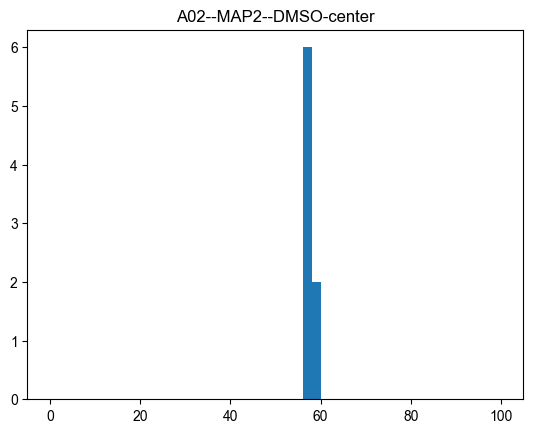

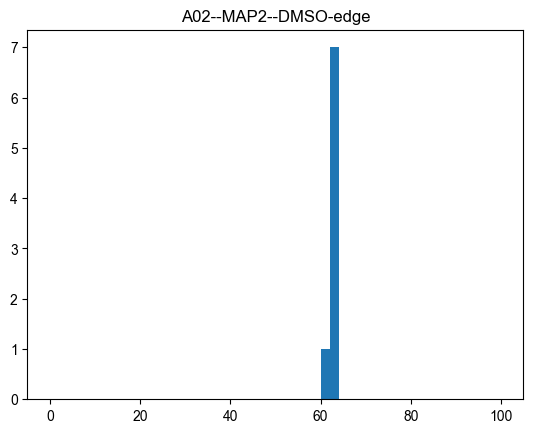

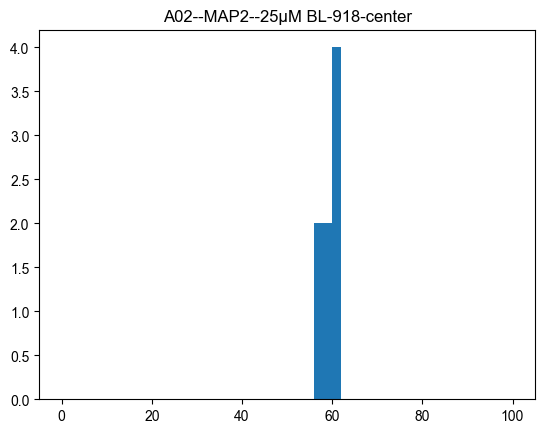

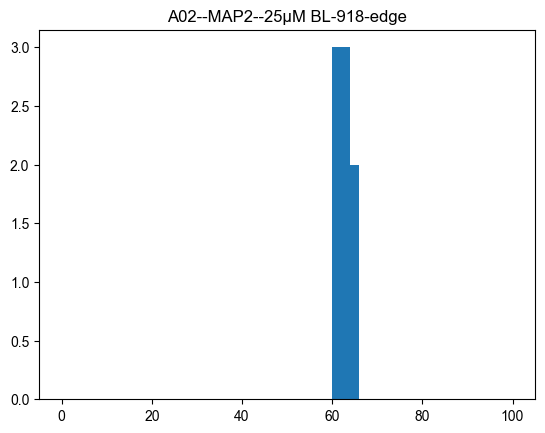

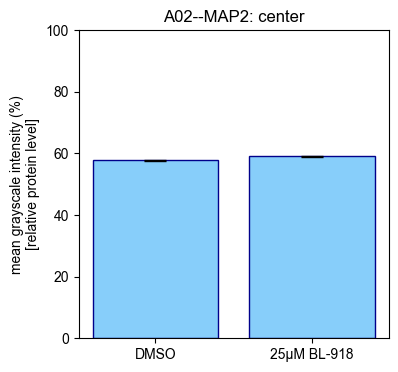

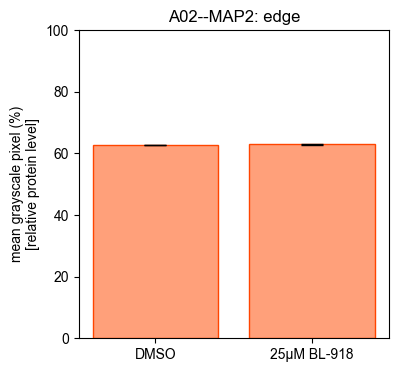

Center t-test 2 tailed:  TtestResult(statistic=-3.1898932952872148, pvalue=0.00987885136443957, df=9.815802259109441)
Center t-test 1 tailed:  TtestResult(statistic=-3.1898932952872148, pvalue=0.9950605743177803, df=9.815802259109441)
Edge t-test 2 tailed:  TtestResult(statistic=-0.347799804114569, pvalue=0.7359281356455919, df=9.067300096836684)
Edge t-test 1 tailed:  TtestResult(statistic=-0.347799804114569, pvalue=0.632035932177204, df=9.067300096836684)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  46.88287681113159
edge effect size:  13.850617196162048
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 2 Ab= MAP2
j= 3 orgline= E11
3-2
4-2
E11--MAP2 --DMSO, center var:  3.3642794912668643
E11--MAP2 --DMSO, edge var:  4.311686165549081
E11--MAP2 --25μM BL-918, center var:  1.1934880737574212
E11--MAP2 --25μM BL-918, 

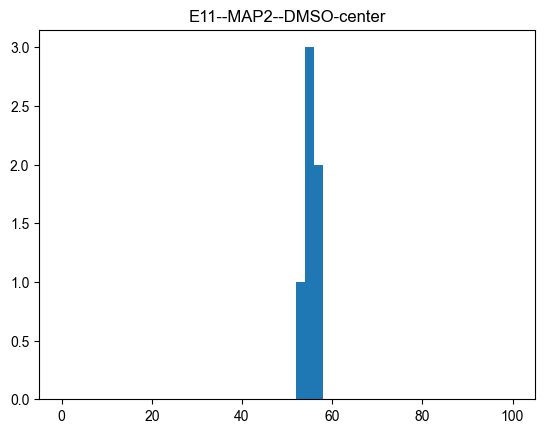

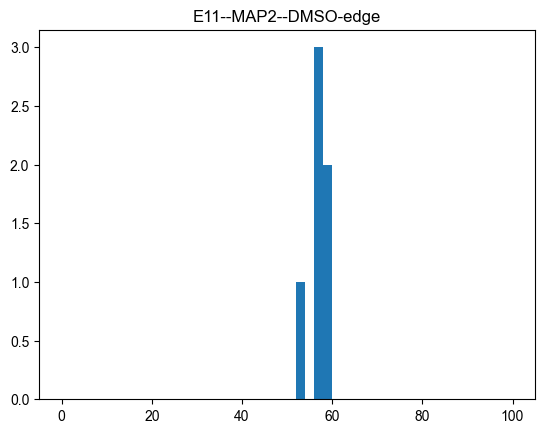

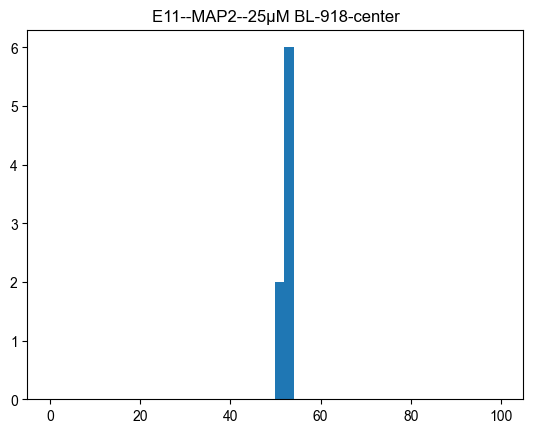

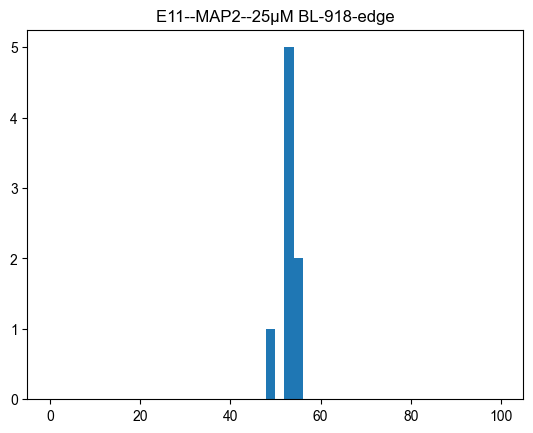

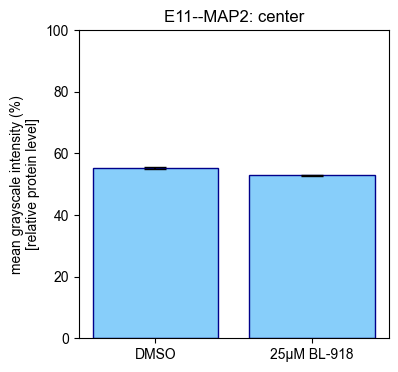

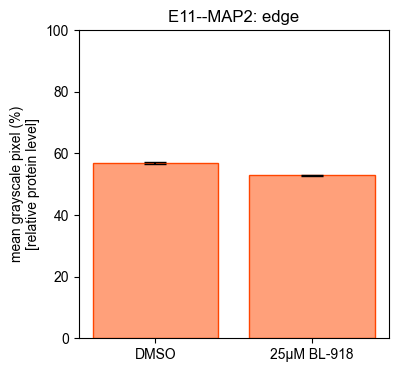

Center t-test 2 tailed:  TtestResult(statistic=2.7740786923271847, pvalue=0.02528239454591125, df=7.62884959961385)
Center t-test 1 tailed:  TtestResult(statistic=2.7740786923271847, pvalue=0.012641197272955625, df=7.62884959961385)
Edge t-test 2 tailed:  TtestResult(statistic=3.6916462458668304, pvalue=0.004522917069592063, df=9.525882444572249)
Edge t-test 1 tailed:  TtestResult(statistic=3.6916462458668304, pvalue=0.0022614585347960313, df=9.525882444572249)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  1.30103559596499
edge effect size:  13.88276741539294
DMSO bioreps (N) =  6
Treated bioreps(N) =  8 


\n
i= 2 Ab= MAP2
j= 5 orgline= A01
5-2
6-2
A01--MAP2 --DMSO, center var:  1.7364800932739473
A01--MAP2 --DMSO, edge var:  2.397992110155504
A01--MAP2 --25μM BL-918, center var:  6.601726044607697
A01--MAP2 --25μM BL-918,

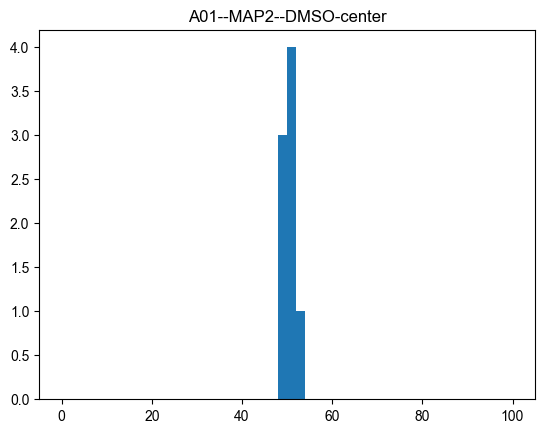

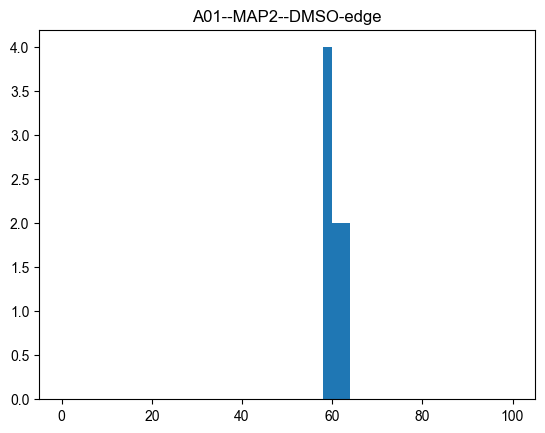

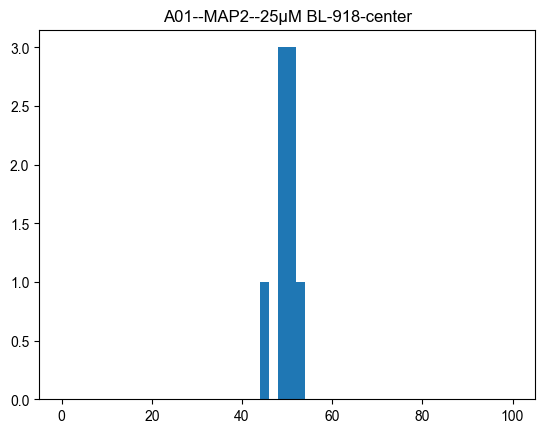

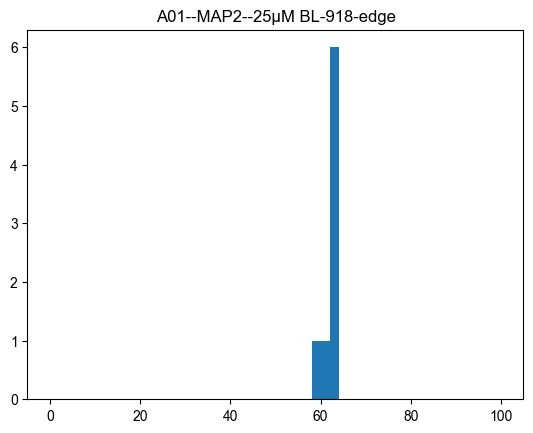

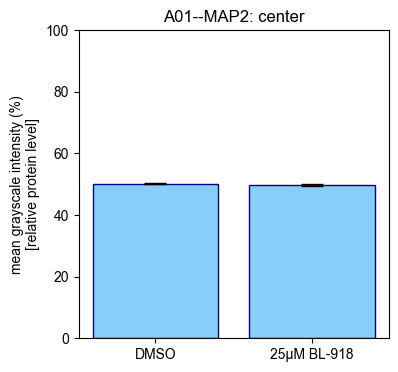

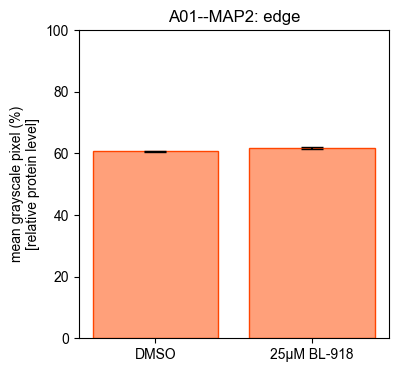

Center t-test 2 tailed:  TtestResult(statistic=0.2891207682008782, pvalue=0.7781468563597064, df=10.44418656991766)
Center t-test 1 tailed:  TtestResult(statistic=0.2891207682008782, pvalue=0.3890734281798532, df=10.44418656991766)
Edge t-test 2 tailed:  TtestResult(statistic=-1.298173989258352, pvalue=0.21524444096395115, df=13.974626862689169)
Edge t-test 1 tailed:  TtestResult(statistic=-1.298173989258352, pvalue=0.8923777795180244, df=13.974626862689169)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  13.245896282525372
edge effect size:  1.7356249960321009
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 3 Ab= AT8
j= 1 orgline= A02
1-3
2-3
A02--AT8 --DMSO, center var:  0.43383703054052564
A02--AT8 --DMSO, edge var:  1.070368196373536
A02--AT8 --25μM BL-918, center var:  4.976407161868941
A02--AT8 --25μM BL-918, edg

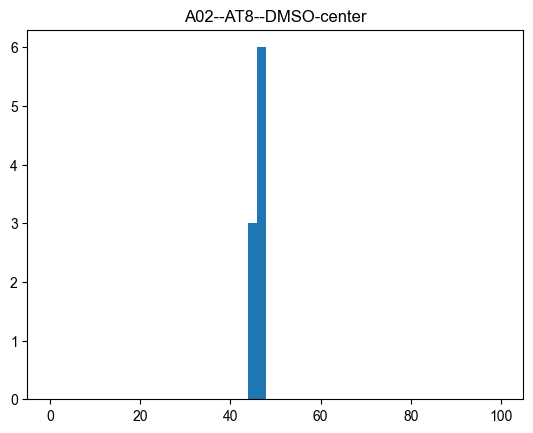

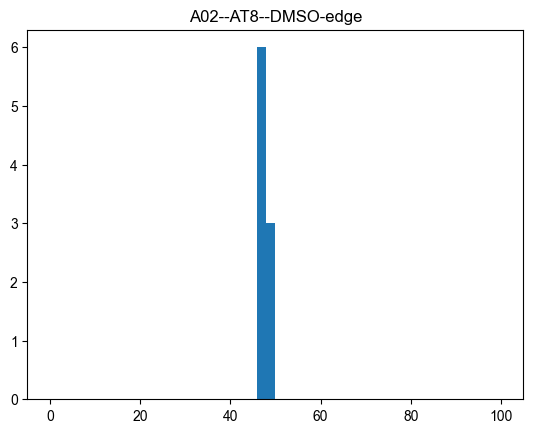

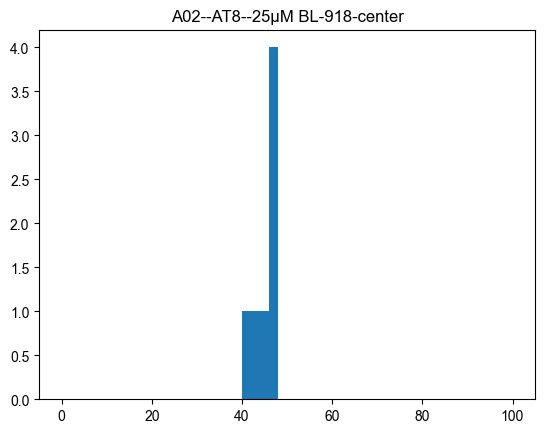

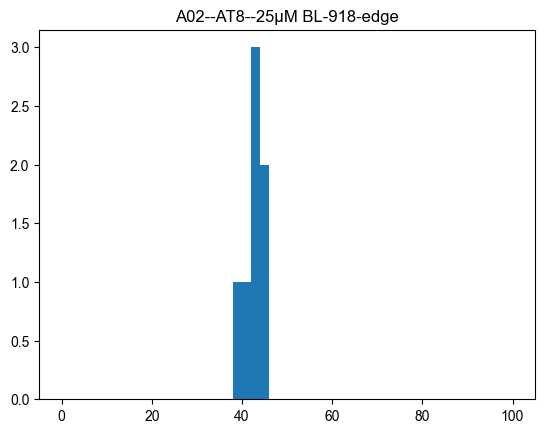

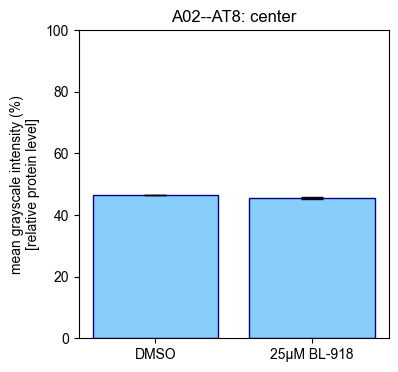

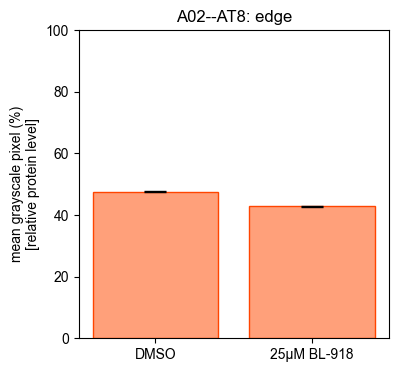

Center t-test 2 tailed:  TtestResult(statistic=1.1718390866614832, pvalue=0.28057914573027465, df=6.817745136832128)
Center t-test 1 tailed:  TtestResult(statistic=1.1718390866614832, pvalue=0.14028957286513732, df=6.817745136832128)
Edge t-test 2 tailed:  TtestResult(statistic=6.894913012847691, pvalue=4.614612109849848e-05, df=9.822984566857064)
Edge t-test 1 tailed:  TtestResult(statistic=6.894913012847691, pvalue=2.307306054924924e-05, df=9.822984566857064)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  4.320525089699061
edge effect size:  0.9999957461685298
DMSO bioreps (N) =  9
Treated bioreps(N) =  7 


\n
i= 3 Ab= AT8
j= 3 orgline= E11
3-3
4-3
E11--AT8 --DMSO, center var:  2.5405747529380474
E11--AT8 --DMSO, edge var:  2.6386021755144435
E11--AT8 --25μM BL-918, center var:  2.07198028005366
E11--AT8 --25μM BL-918, ed

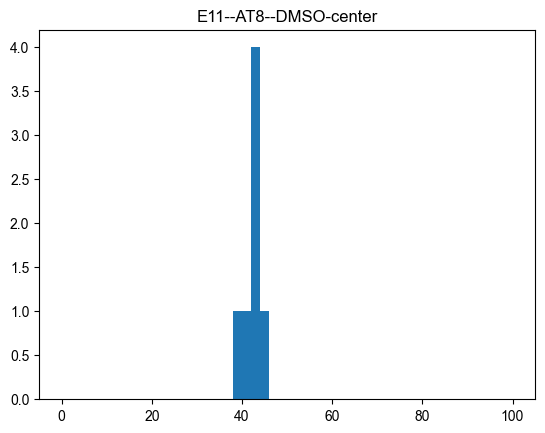

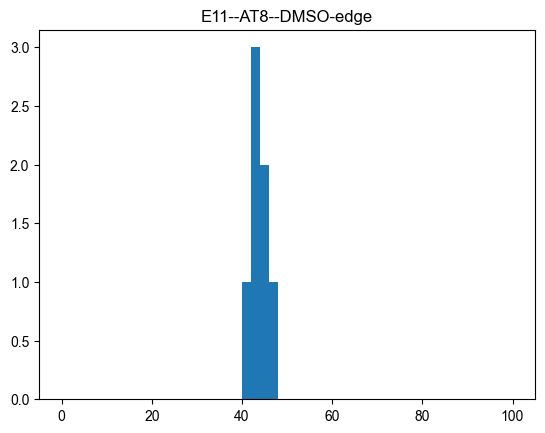

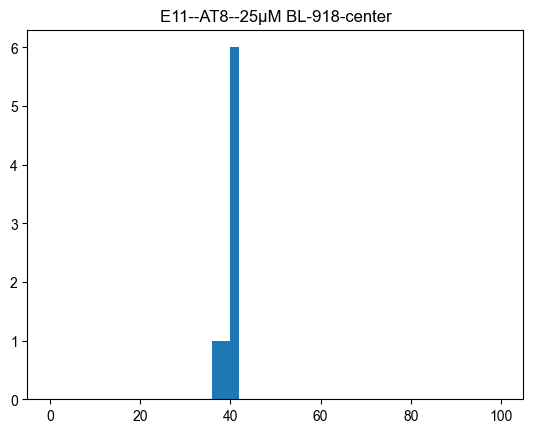

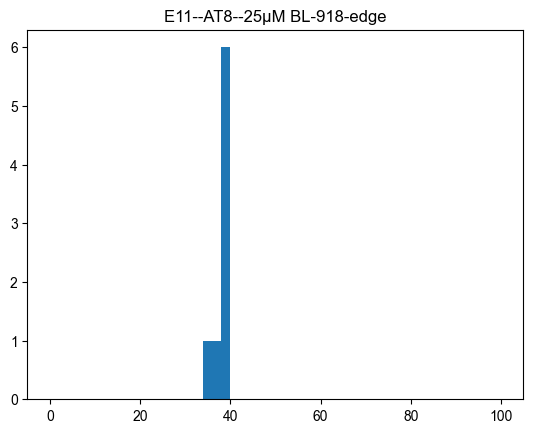

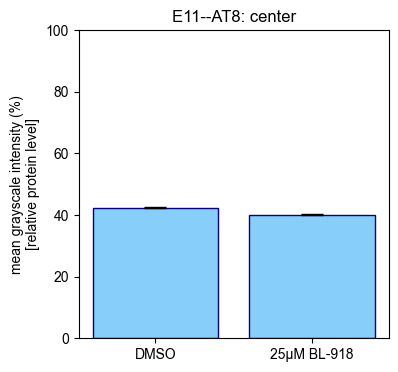

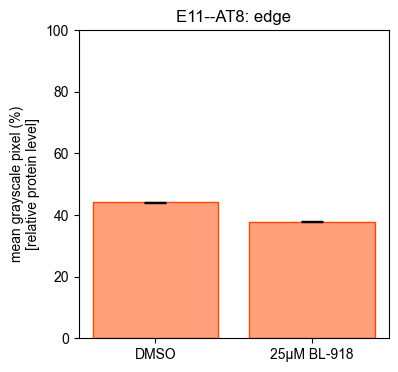

Center t-test 2 tailed:  TtestResult(statistic=2.8090888689737166, pvalue=0.015490926855508269, df=12.265141376633954)
Center t-test 1 tailed:  TtestResult(statistic=2.8090888689737166, pvalue=0.007745463427754134, df=12.265141376633954)
Edge t-test 2 tailed:  TtestResult(statistic=8.423830931503062, pvalue=3.8851321985667264e-06, df=11.041823783498788)
Edge t-test 1 tailed:  TtestResult(statistic=8.423830931503062, pvalue=1.9425660992833632e-06, df=11.041823783498788)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  2.1681644785513896
edge effect size:  4.001028787292547
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 3 Ab= AT8
j= 5 orgline= A01
5-3
6-3
A01--AT8 --DMSO, center var:  0.13296895478827567
A01--AT8 --DMSO, edge var:  0.09091911775419975
A01--AT8 --25μM BL-918, center var:  0.7145445874703878
A01--AT8 --25μ

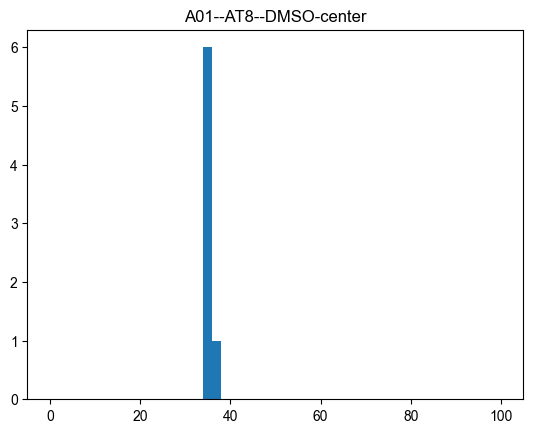

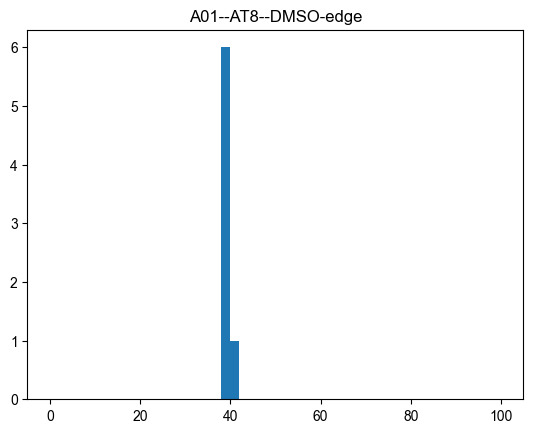

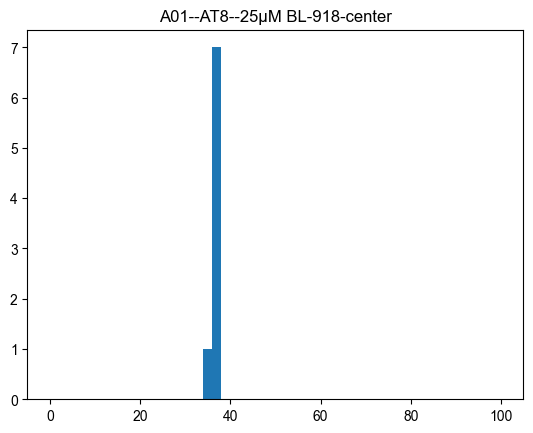

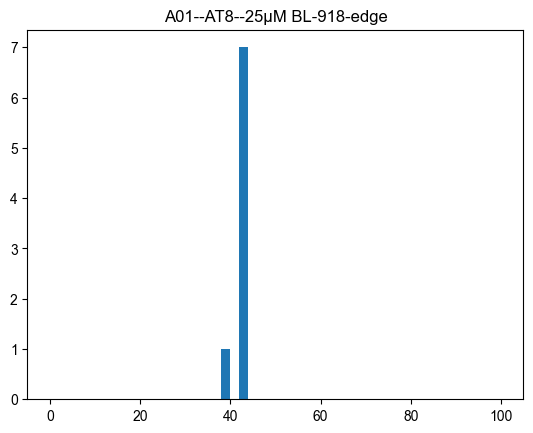

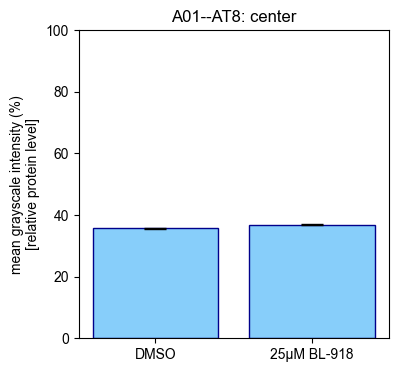

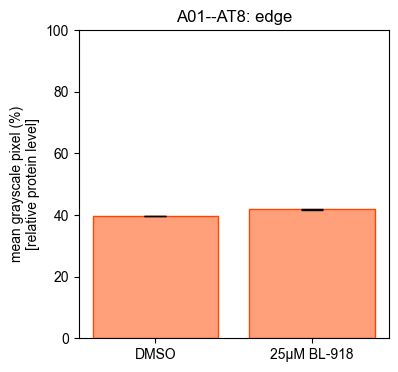

Center t-test 2 tailed:  TtestResult(statistic=-3.717035678145845, pvalue=0.004151470273617462, df=9.77806376425302)
Center t-test 1 tailed:  TtestResult(statistic=-3.717035678145845, pvalue=0.9979242648631913, df=9.77806376425302)
Edge t-test 2 tailed:  TtestResult(statistic=-4.735581027168733, pvalue=0.0015052545305383723, df=7.935593997311731)
Edge t-test 1 tailed:  TtestResult(statistic=-4.735581027168733, pvalue=0.9992473727347309, df=7.935593997311731)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  50.14795773890682
edge effect size:  30.427200115878023
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 4 Ab= HT7
j= 1 orgline= A02
1-4
2-4
A02--HT7 --DMSO, center var:  0.05021379175323669
A02--HT7 --DMSO, edge var:  0.2510159628011371
A02--HT7 --25μM BL-918, center var:  0.4440048792387314
A02--HT7 --25μM BL-918, ed

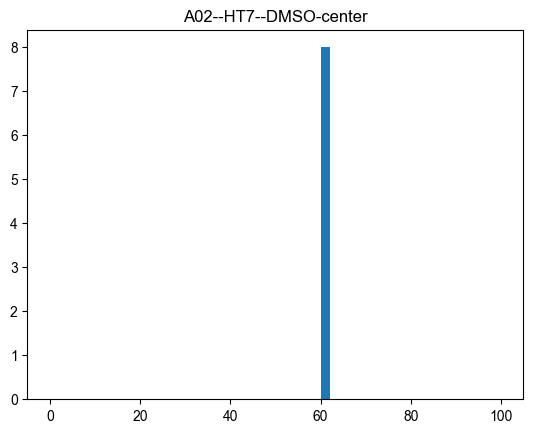

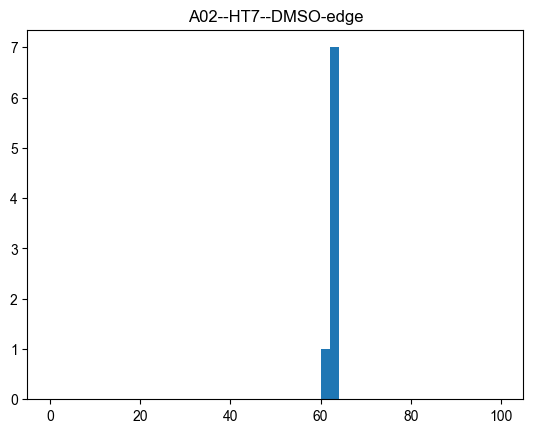

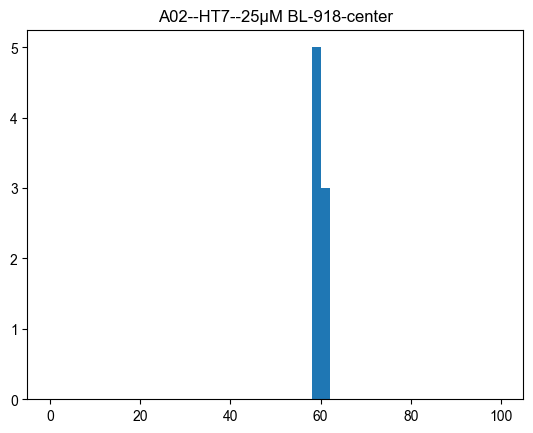

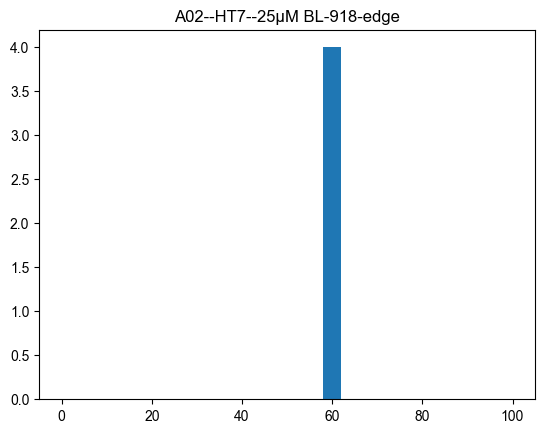

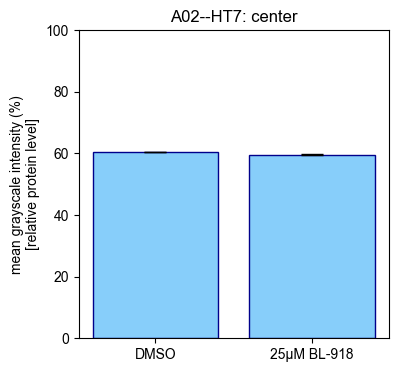

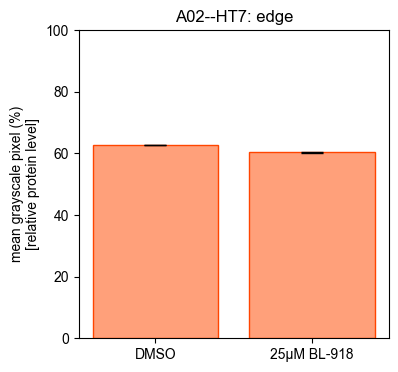

Center t-test 2 tailed:  TtestResult(statistic=3.5466558188949695, pvalue=0.006763522895104268, df=8.563305678822267)
Center t-test 1 tailed:  TtestResult(statistic=3.5466558188949695, pvalue=0.003381761447552134, df=8.563305678822267)
Edge t-test 2 tailed:  TtestResult(statistic=8.010704595445032, pvalue=2.7311110963528104e-06, df=12.580579989519283)
Edge t-test 1 tailed:  TtestResult(statistic=8.010704595445032, pvalue=1.3655555481764052e-06, df=12.580579989519283)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  120.80743628016401
edge effect size:  85.57369649437571
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 4 Ab= HT7
j= 3 orgline= E11
3-4
4-4
E11--HT7 --DMSO, center var:  0.731346747394309
E11--HT7 --DMSO, edge var:  0.7338772731376475
E11--HT7 --25μM BL-918, center var:  2.3257714533426133
E11--HT7 --25μM BL-

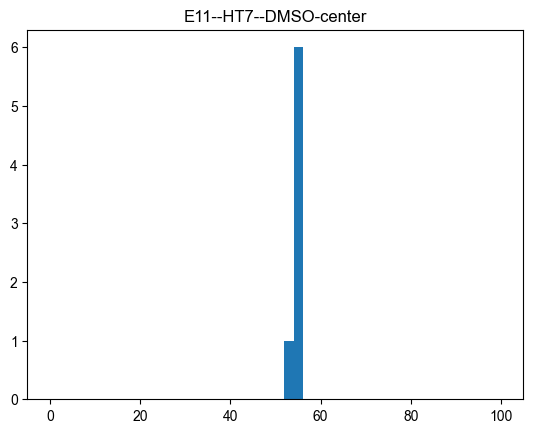

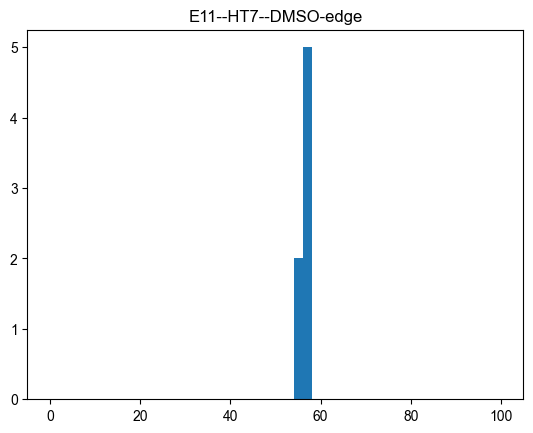

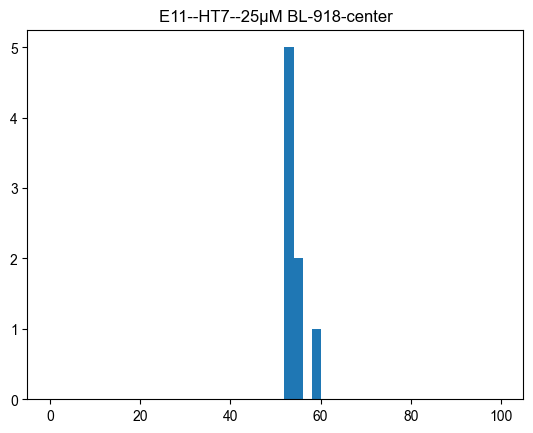

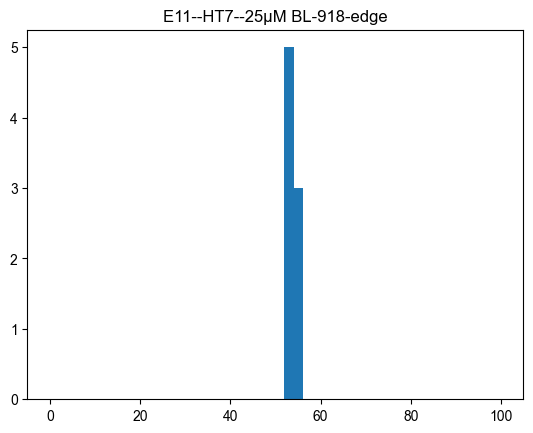

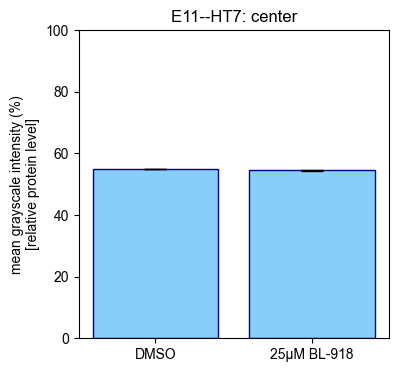

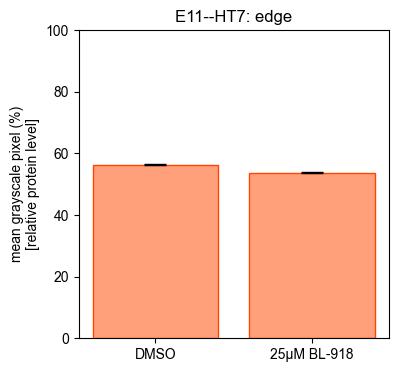

Center t-test 2 tailed:  TtestResult(statistic=0.67814806152632, pvalue=0.5113955826392558, df=11.241489264589037)
Center t-test 1 tailed:  TtestResult(statistic=0.67814806152632, pvalue=0.2556977913196279, df=11.241489264589037)
Edge t-test 2 tailed:  TtestResult(statistic=7.116265493742874, pvalue=5.9626623397140456e-05, df=8.879210005928151)
Edge t-test 1 tailed:  TtestResult(statistic=7.116265493742874, pvalue=2.9813311698570228e-05, df=8.879210005928151)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  11.881672456305331
edge effect size:  63.11604307666904
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 4 Ab= HT7
j= 5 orgline= A01
5-4
6-4
A01--HT7 --DMSO, center var:  0.34677435630498166
A01--HT7 --DMSO, edge var:  0.37591412606865965
A01--HT7 --25μM BL-918, center var:  4.406395361168576
A01--HT7 --25μM BL-918, e

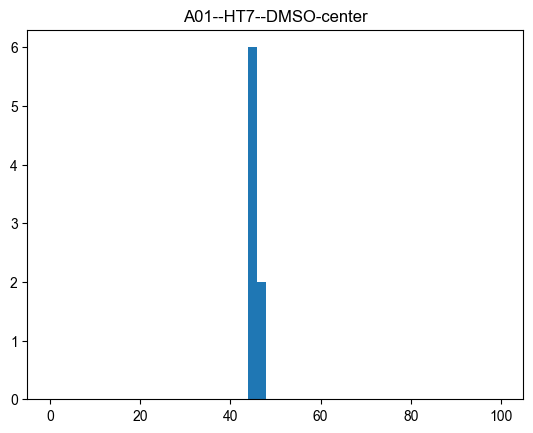

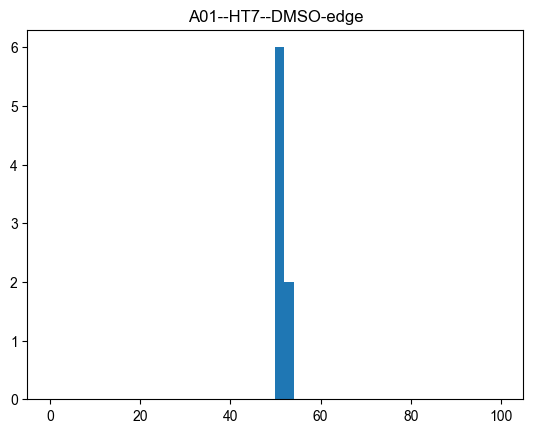

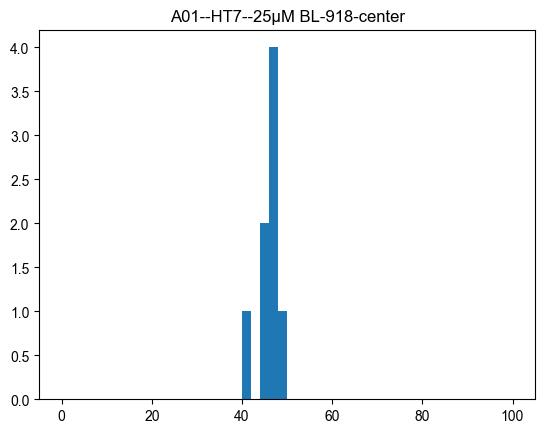

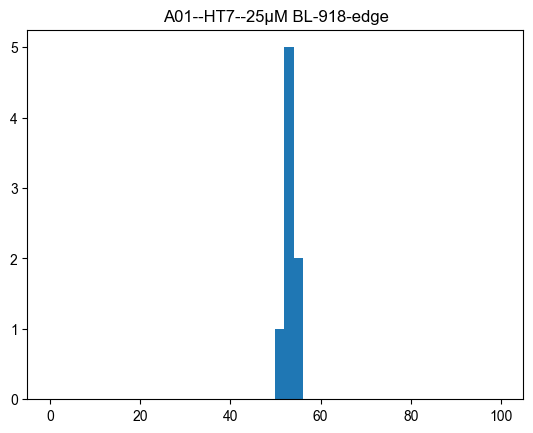

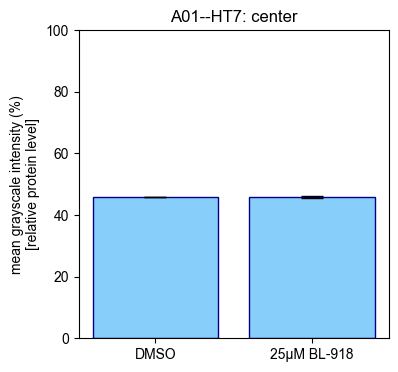

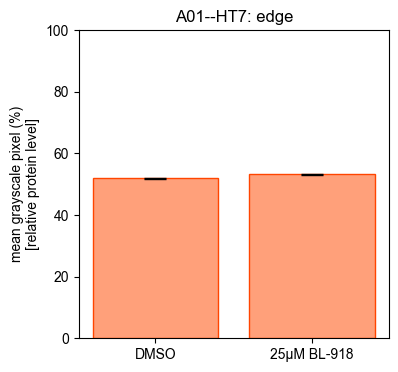

Center t-test 2 tailed:  TtestResult(statistic=-0.1896038426146282, pvalue=0.8542876320873583, df=8.094989859334756)
Center t-test 1 tailed:  TtestResult(statistic=-0.1896038426146282, pvalue=0.5728561839563209, df=8.094989859334756)
Edge t-test 2 tailed:  TtestResult(statistic=-2.738042721183631, pvalue=0.02094639582647157, df=9.975718261601576)
Edge t-test 1 tailed:  TtestResult(statistic=-2.738042721183631, pvalue=0.9895268020867642, df=9.975718261601576)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  0.740441562054464
edge effect size:  27.480587917932176
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 5 Ab= Beclin-1
j= 1 orgline= A02
1-5
2-5
A02--Beclin-1 --DMSO, center var:  0.05872418698331945
A02--Beclin-1 --DMSO, edge var:  0.07974077735327262
A02--Beclin-1 --25μM BL-918, center var:  0.08242582145128573
A02-

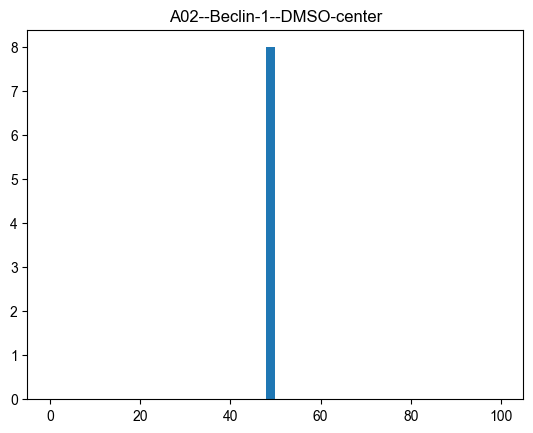

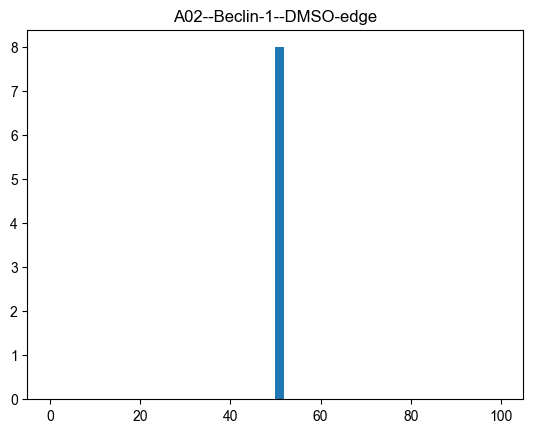

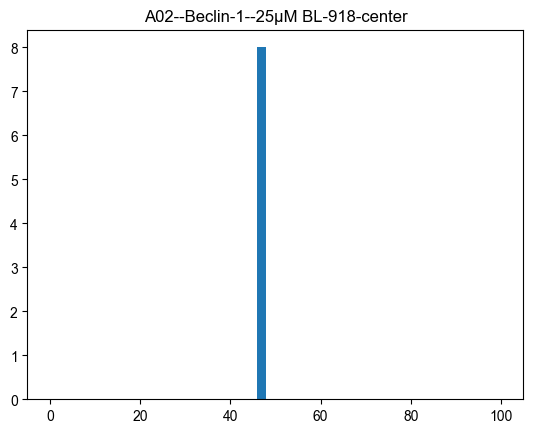

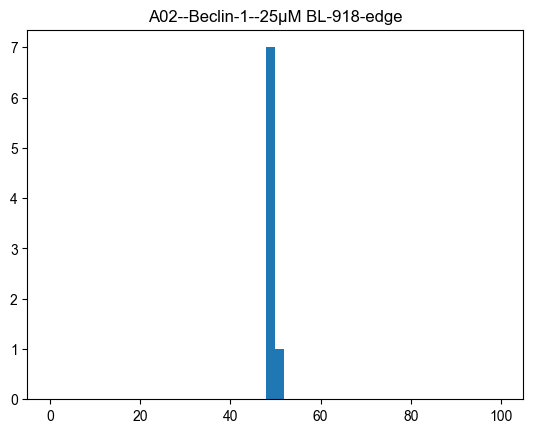

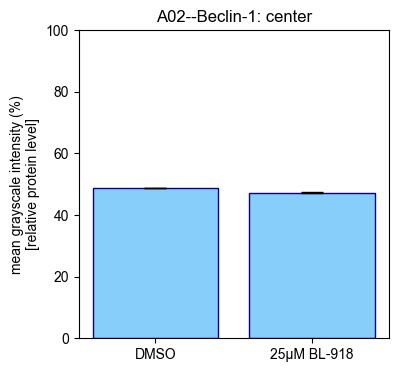

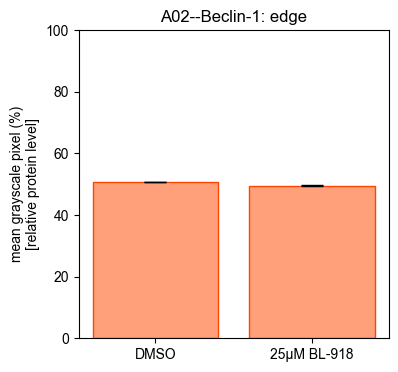

Center t-test 2 tailed:  TtestResult(statistic=10.473768810944955, pvalue=6.821677256470296e-08, df=13.61607472726636)
Center t-test 1 tailed:  TtestResult(statistic=10.473768810944955, pvalue=3.410838628235148e-08, df=13.61607472726636)
Edge t-test 2 tailed:  TtestResult(statistic=9.344855770584575, pvalue=2.2877221518403934e-07, df=13.893011827623683)
Edge t-test 1 tailed:  TtestResult(statistic=9.344855770584575, pvalue=1.1438610759201967e-07, df=13.893011827623683)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  220.48725506876704
edge effect size:  225.99213290004536
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 5 Ab= Beclin-1
j= 3 orgline= E11
3-5
4-5
E11--Beclin-1 --DMSO, center var:  0.27152009548602535
E11--Beclin-1 --DMSO, edge var:  0.19136469620193383
E11--Beclin-1 --25μM BL-918, center var:  0.0584550743

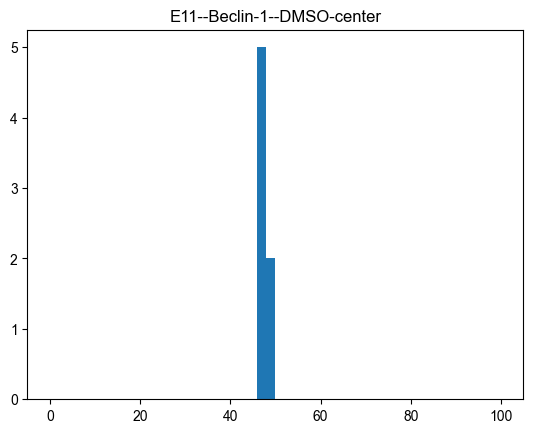

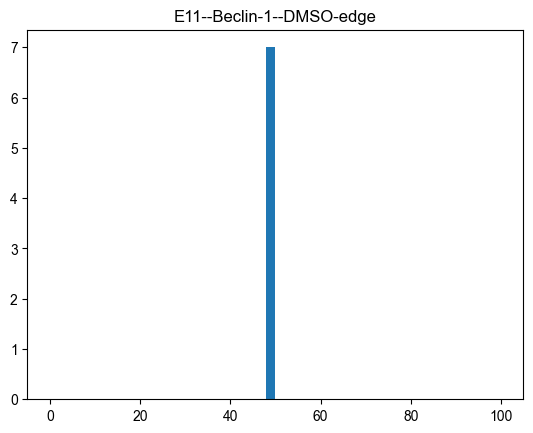

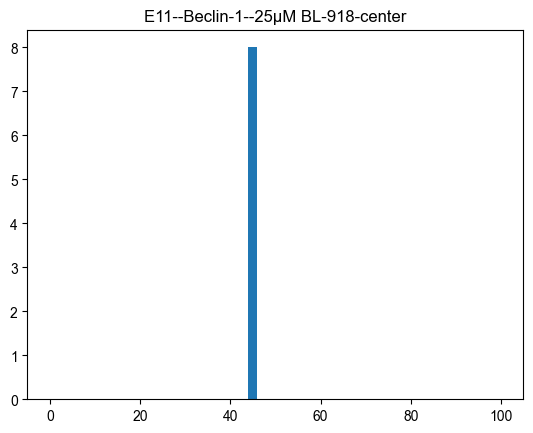

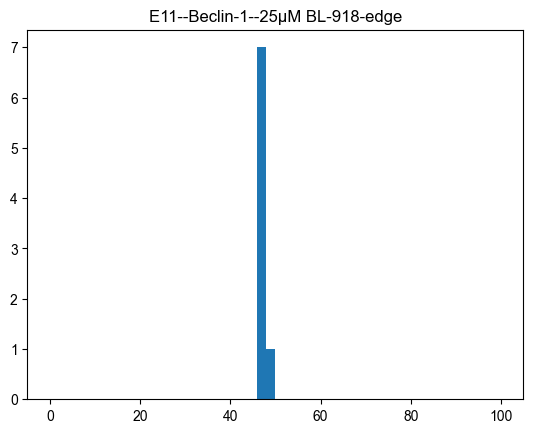

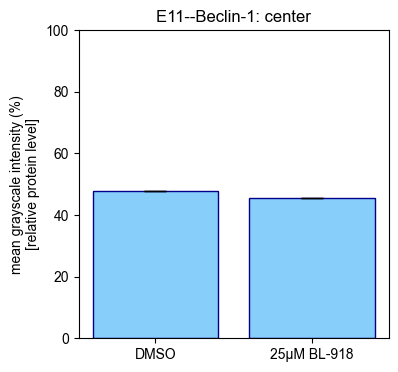

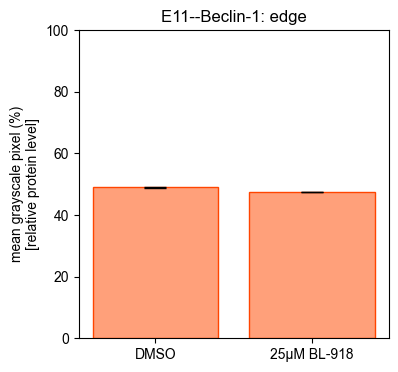

Center t-test 2 tailed:  TtestResult(statistic=10.086438959405562, pvalue=6.520054223236938e-06, df=8.223317095892128)
Center t-test 1 tailed:  TtestResult(statistic=10.086438959405562, pvalue=3.260027111618469e-06, df=8.223317095892128)
Edge t-test 2 tailed:  TtestResult(statistic=6.200450799993352, pvalue=3.697510787252929e-05, df=12.597866083490418)
Edge t-test 1 tailed:  TtestResult(statistic=6.200450799993352, pvalue=1.8487553936264647e-05, df=12.597866083490418)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  123.50401652307971
edge effect size:  119.2502069801231
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 5 Ab= Beclin-1
j= 5 orgline= A01
5-5
6-5
A01--Beclin-1 --DMSO, center var:  0.20883676326225398
A01--Beclin-1 --DMSO, edge var:  0.4222768603170063
A01--Beclin-1 --25μM BL-918, center var:  1.0069670482894

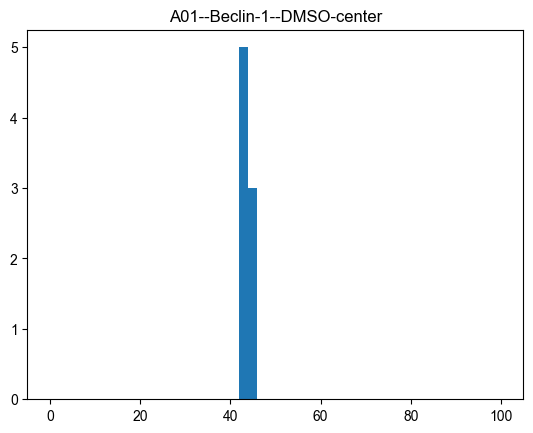

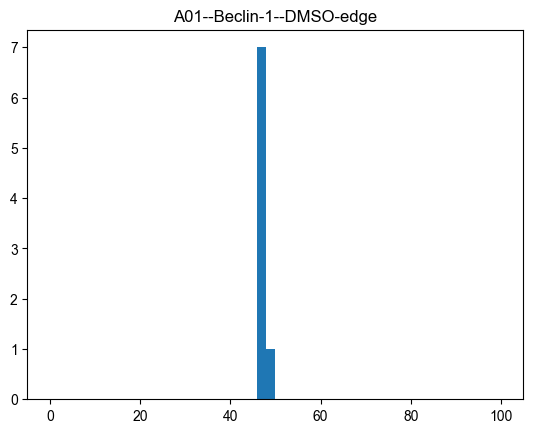

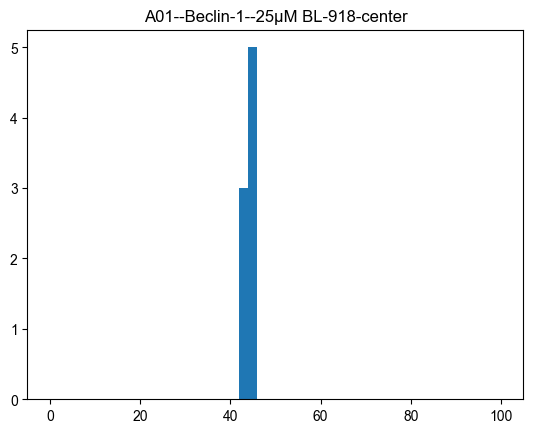

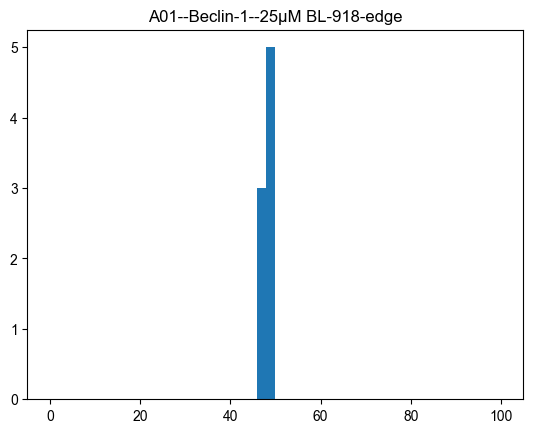

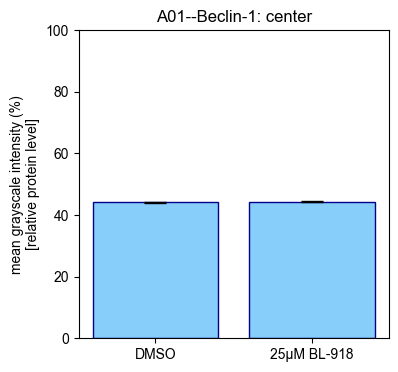

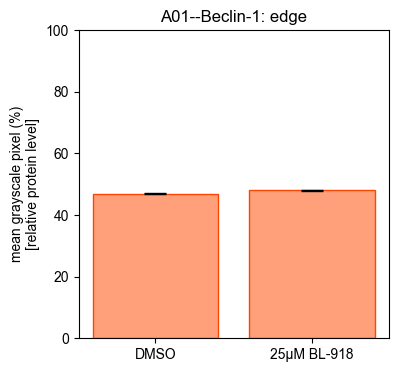

Center t-test 2 tailed:  TtestResult(statistic=-0.5133188809120499, pvalue=0.6191192295733599, df=9.783752901604272)
Center t-test 1 tailed:  TtestResult(statistic=-0.5133188809120499, pvalue=0.6904403852133201, df=9.783752901604272)
Edge t-test 2 tailed:  TtestResult(statistic=-2.927773634791348, pvalue=0.011580836018803583, df=13.229878417147498)
Edge t-test 1 tailed:  TtestResult(statistic=-2.927773634791348, pvalue=0.9942095819905982, df=13.229878417147498)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  41.79521653229978
edge effect size:  50.41680073472675
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 6 Ab= p62
j= 1 orgline= A02
1-6
2-6
A02--p62 --DMSO, center var:  0.019293441543629285
A02--p62 --DMSO, edge var:  0.01519197245952388
A02--p62 --25μM BL-918, center var:  0.04199878275114064
A02--p62 --25μM BL-91

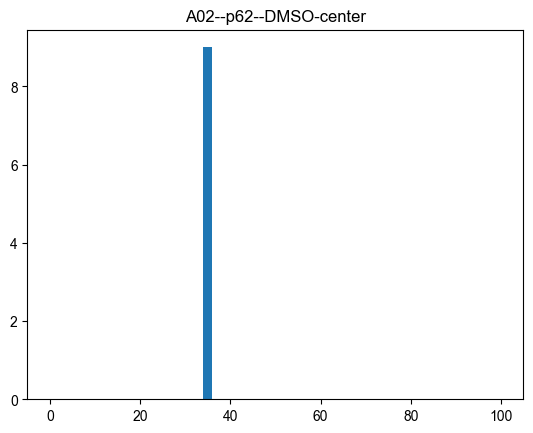

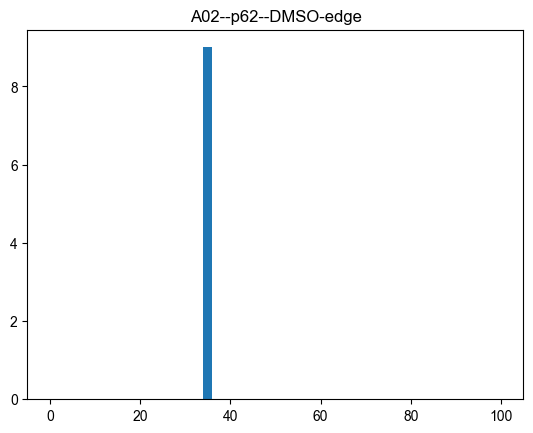

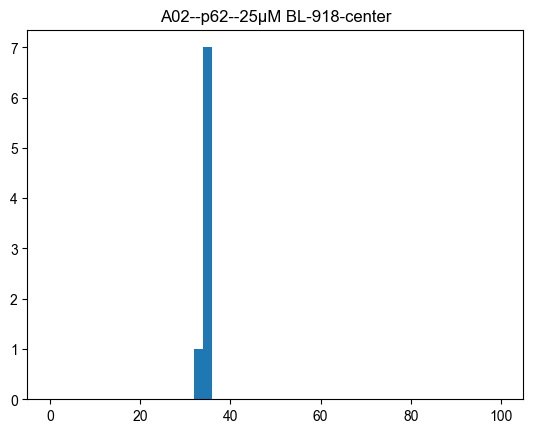

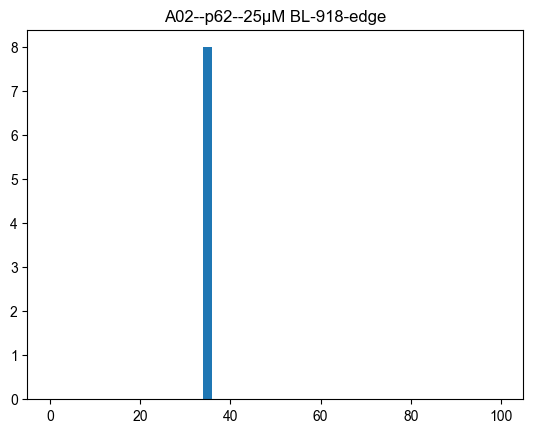

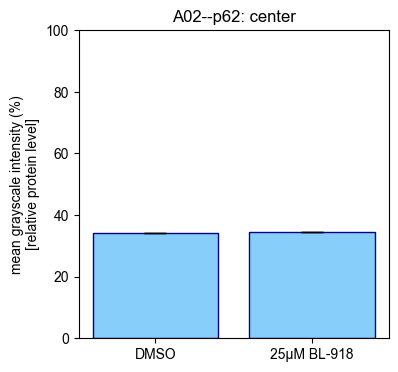

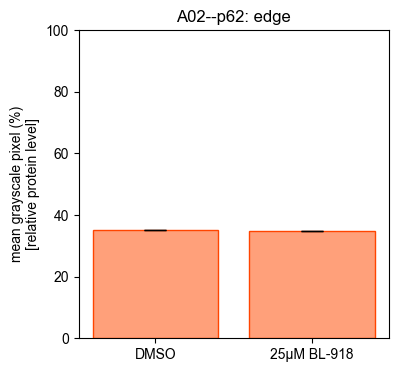

Center t-test 2 tailed:  TtestResult(statistic=-0.91165464821343, pvalue=0.3797317496712673, df=12.116196565528973)
Center t-test 1 tailed:  TtestResult(statistic=-0.91165464821343, pvalue=0.8101341251643663, df=12.116196565528973)
Edge t-test 2 tailed:  TtestResult(statistic=1.9997463966351283, pvalue=0.07330994016449999, df=10.038493996958906)
Edge t-test 1 tailed:  TtestResult(statistic=1.9997463966351283, pvalue=0.036654970082249994, df=10.038493996958906)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  261.8542140743269
edge effect size:  235.51322804082753
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 6 Ab= p62
j= 3 orgline= E11
3-6
4-6
E11--p62 --DMSO, center var:  0.04275765380573584
E11--p62 --DMSO, edge var:  0.011168459109313454
E11--p62 --25μM BL-918, center var:  0.005442607453278485
E11--p62 --25μM BL-9

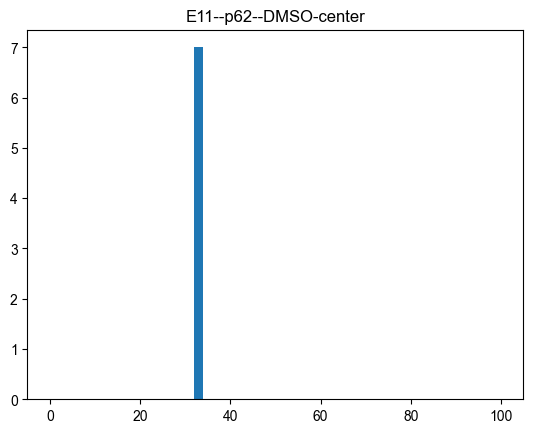

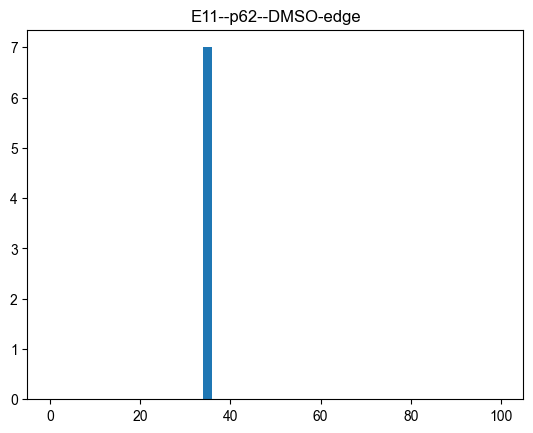

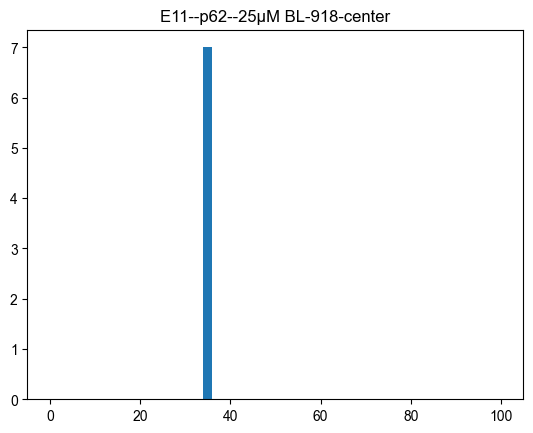

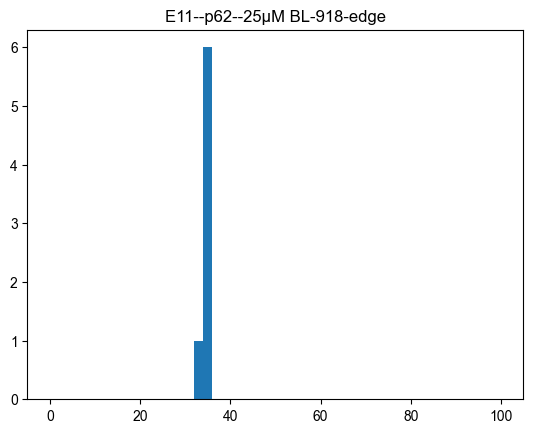

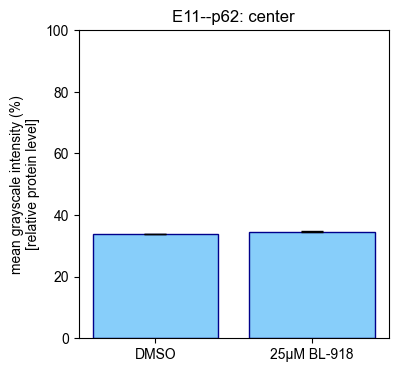

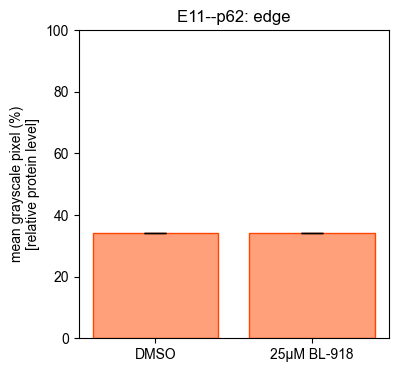

Center t-test 2 tailed:  TtestResult(statistic=-10.214662717433614, pvalue=1.1475789706888555e-05, df=7.503121422988998)
Center t-test 1 tailed:  TtestResult(statistic=-10.214662717433614, pvalue=0.9999942621051465, df=7.503121422988998)
Edge t-test 2 tailed:  TtestResult(statistic=1.676949708590188, pvalue=0.12354880353285592, df=10.316235441977874)
Edge t-test 1 tailed:  TtestResult(statistic=1.676949708590188, pvalue=0.06177440176642796, df=10.316235441977874)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  307.2589761156578
edge effect size:  347.3638712874759
DMSO bioreps (N) =  7
Treated bioreps(N) =  7 


\n
i= 6 Ab= p62
j= 5 orgline= A01
5-6
6-6
A01--p62 --DMSO, center var:  0.023148306067629236
A01--p62 --DMSO, edge var:  0.007731256053896651
A01--p62 --25μM BL-918, center var:  0.003584573347427155
A01--p62 --25μM B

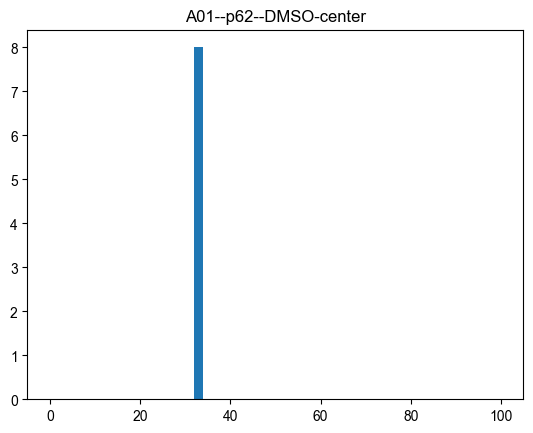

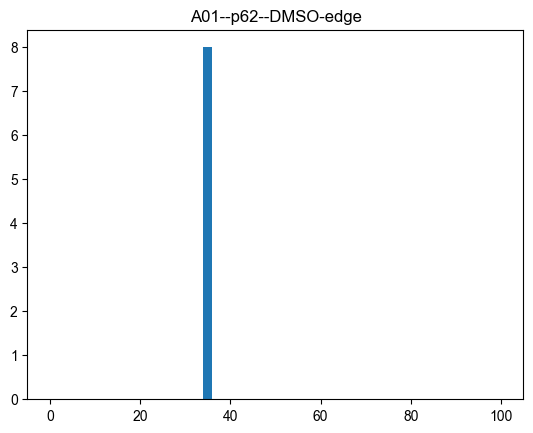

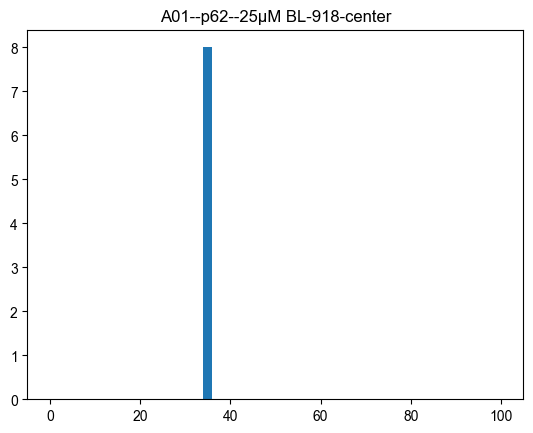

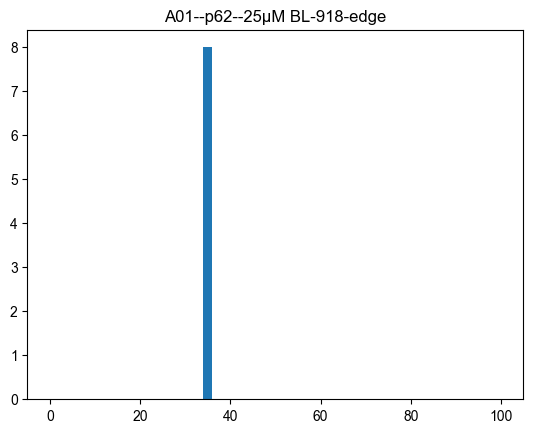

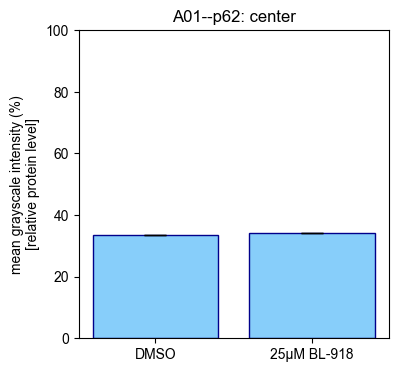

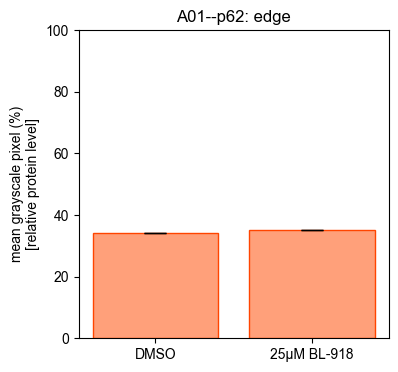

Center t-test 2 tailed:  TtestResult(statistic=-8.40757115646132, pvalue=1.3696102162406265e-05, df=9.1171669871488)
Center t-test 1 tailed:  TtestResult(statistic=-8.40757115646132, pvalue=0.9999931519489188, df=9.1171669871488)
Edge t-test 2 tailed:  TtestResult(statistic=-12.516757493785635, pvalue=7.37967349495542e-08, df=11.021998358476877)
Edge t-test 1 tailed:  TtestResult(statistic=-12.516757493785635, pvalue=0.9999999631016325, df=11.021998358476877)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  412.69696053400054
edge effect size:  383.7250894227118
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 7 Ab= LC3
j= 1 orgline= A02
1-7
2-7
A02--LC3 --DMSO, center var:  0.021421879108258792
A02--LC3 --DMSO, edge var:  0.021402724279804542
A02--LC3 --25μM BL-918, center var:  0.07559614428555102
A02--LC3 --25μM BL-91

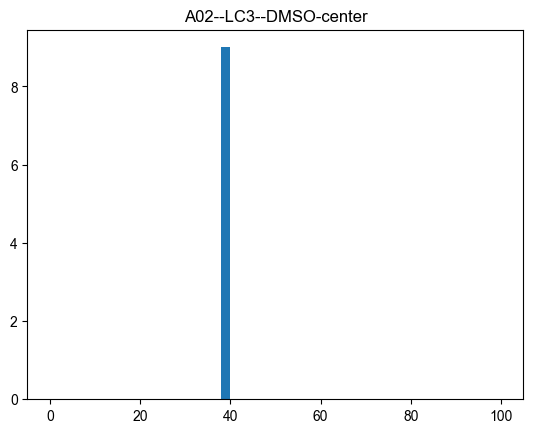

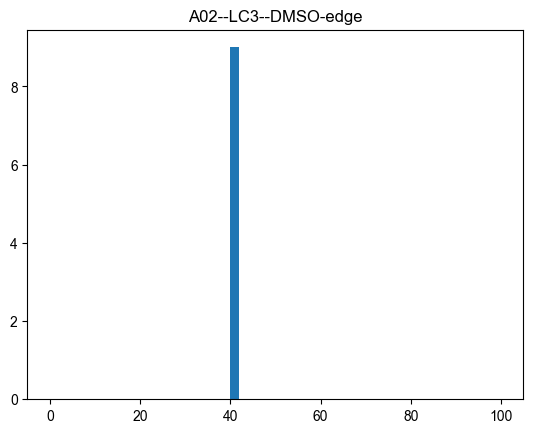

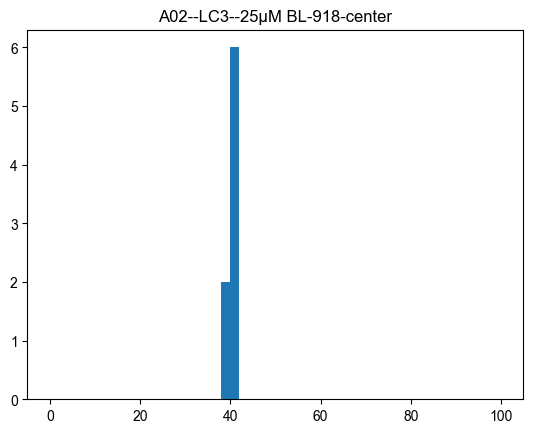

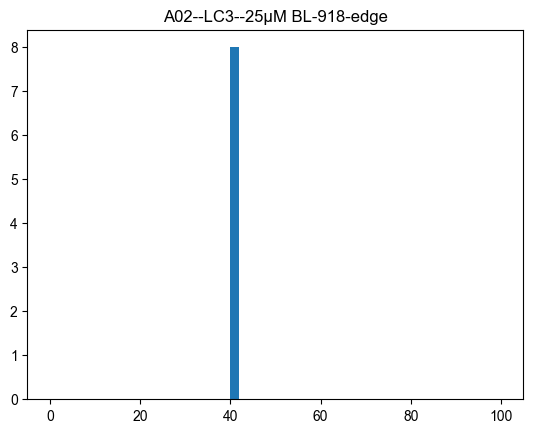

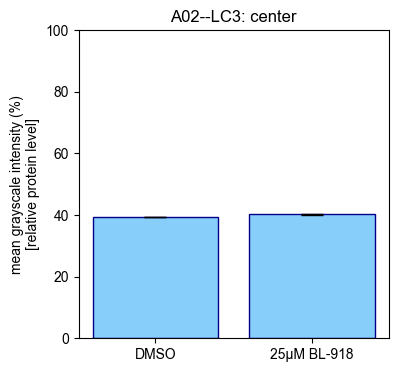

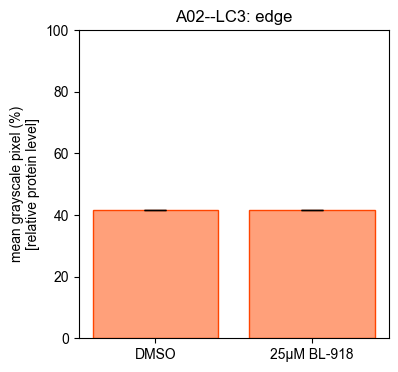

Center t-test 2 tailed:  TtestResult(statistic=-6.363715515585418, pvalue=6.902324280595743e-05, df=10.393535378910206)
Center t-test 1 tailed:  TtestResult(statistic=-6.363715515585418, pvalue=0.999965488378597, df=10.393535378910206)
Edge t-test 2 tailed:  TtestResult(statistic=-0.8669882314099052, pvalue=0.40000736464698505, df=14.564299436718423)
Edge t-test 1 tailed:  TtestResult(statistic=-0.8669882314099052, pvalue=0.7999963176765075, df=14.564299436718423)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  235.9977826178154
edge effect size:  377.9635400886898
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 7 Ab= LC3
j= 3 orgline= E11
3-7
4-7
E11--LC3 --DMSO, center var:  0.1699553951267787
E11--LC3 --DMSO, edge var:  0.3253424958010111
E11--LC3 --25μM BL-918, center var:  0.08533021937851443
E11--LC3 --25μM BL-91

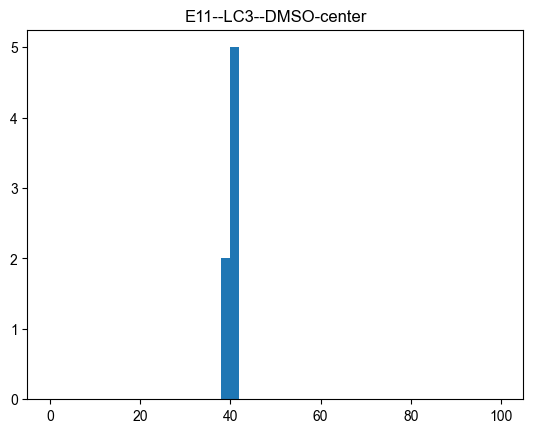

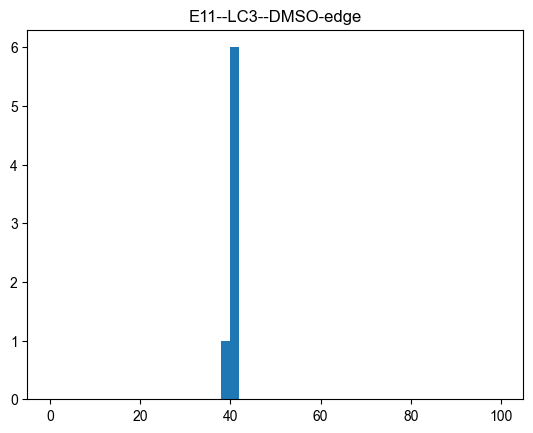

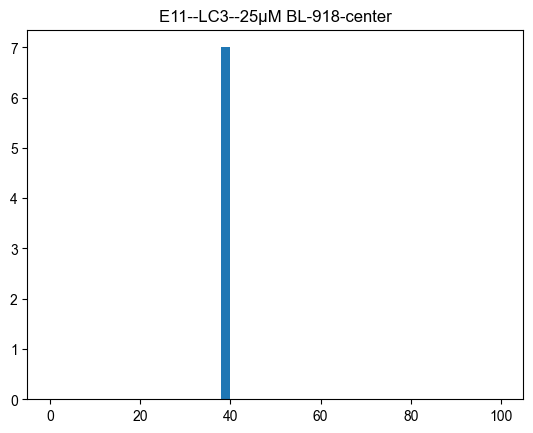

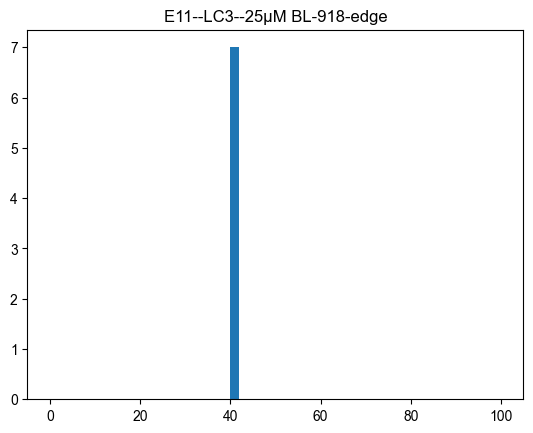

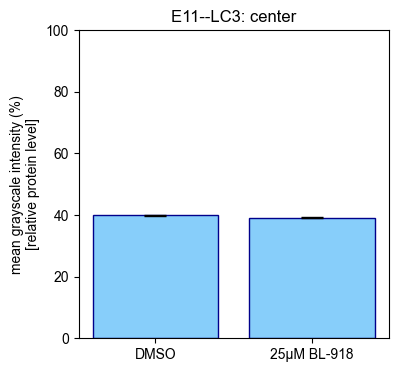

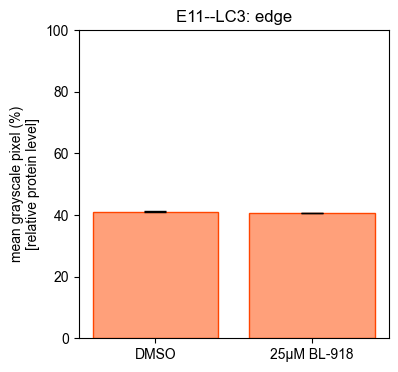

Center t-test 2 tailed:  TtestResult(statistic=3.865660098799395, pvalue=0.002711601336926392, df=10.81191107667431)
Center t-test 1 tailed:  TtestResult(statistic=3.865660098799395, pvalue=0.001355800668463196, df=10.81191107667431)
Edge t-test 2 tailed:  TtestResult(statistic=2.3612106607380614, pvalue=0.049943271308396354, df=7.061705299050764)
Edge t-test 1 tailed:  TtestResult(statistic=2.3612106607380614, pvalue=0.024971635654198177, df=7.061705299050764)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  127.58817997763678
edge effect size:  106.15692641885329
DMSO bioreps (N) =  7
Treated bioreps(N) =  7 


\n
i= 7 Ab= LC3
j= 5 orgline= A01
5-7
6-7
A01--LC3 --DMSO, center var:  0.05297955913787487
A01--LC3 --DMSO, edge var:  0.033552823573670475
A01--LC3 --25μM BL-918, center var:  0.30437190922064317
A01--LC3 --25μM BL-

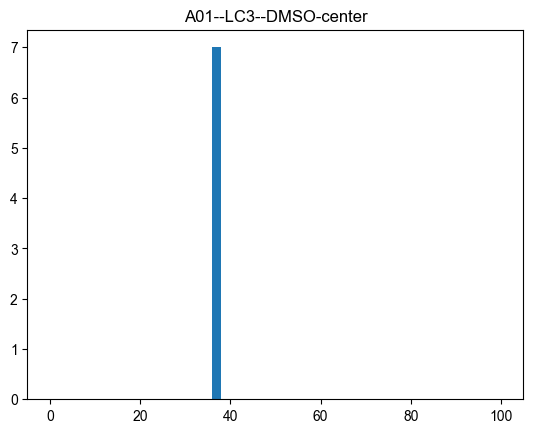

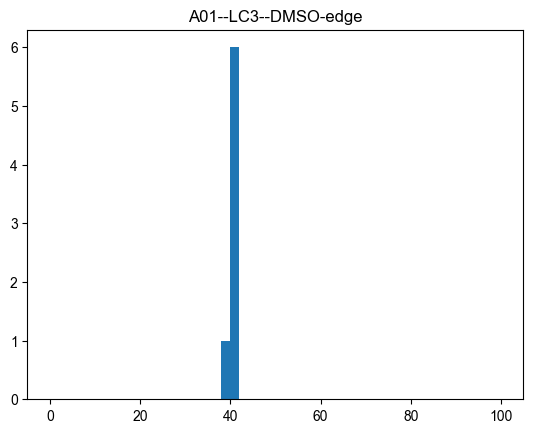

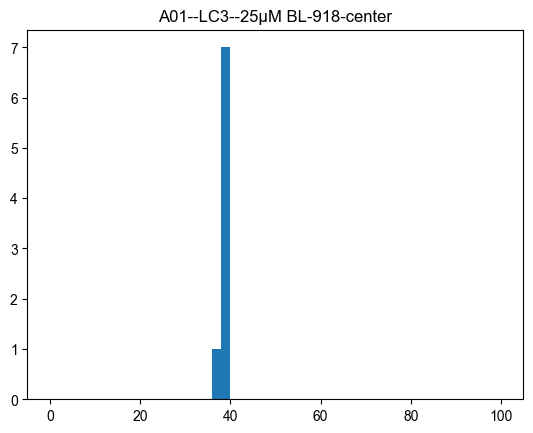

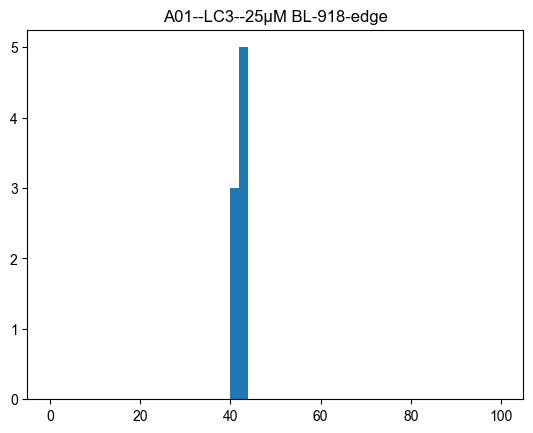

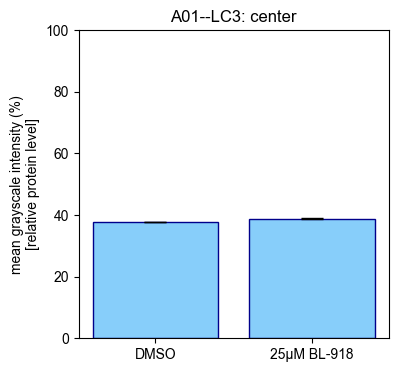

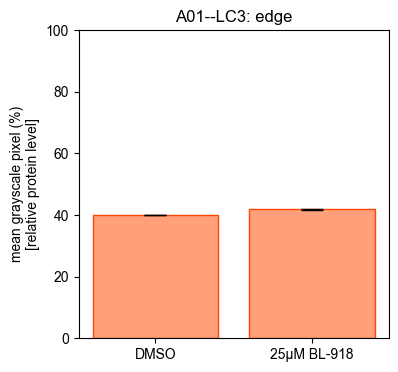

Center t-test 2 tailed:  TtestResult(statistic=-5.46313729230371, pvalue=0.00031615916868326337, df=9.617957939857455)
Center t-test 1 tailed:  TtestResult(statistic=-5.46313729230371, pvalue=0.9998419204156583, df=9.617957939857455)
Edge t-test 2 tailed:  TtestResult(statistic=-9.10339312393813, pvalue=6.91404908286622e-06, df=9.155777318696833)
Edge t-test 1 tailed:  TtestResult(statistic=-9.10339312393813, pvalue=0.9999965429754586, df=9.155777318696833)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  101.42714940907103
edge effect size:  131.59966854375884
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 8 Ab= T22
j= 1 orgline= A02
1-8
2-8
A02--T22 --DMSO, center var:  0.029292820575339752
A02--T22 --DMSO, edge var:  0.04255082518876526
A02--T22 --25μM BL-918, center var:  0.14937512448019802
A02--T22 --25μM BL-918,

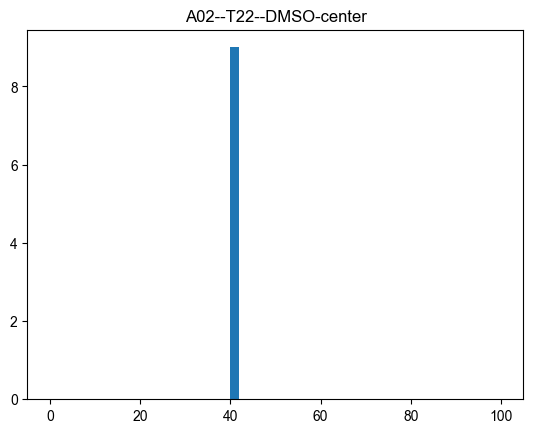

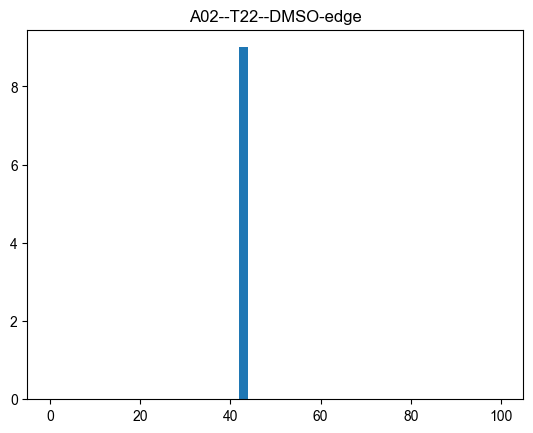

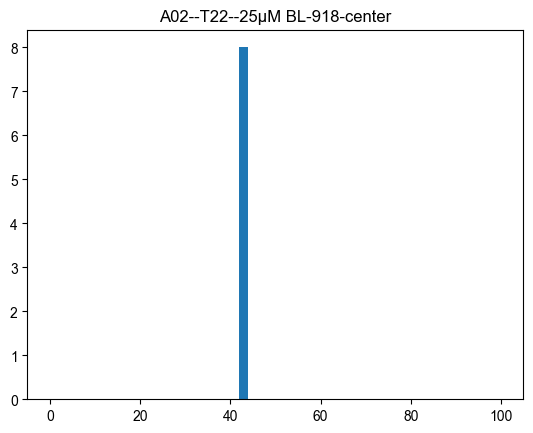

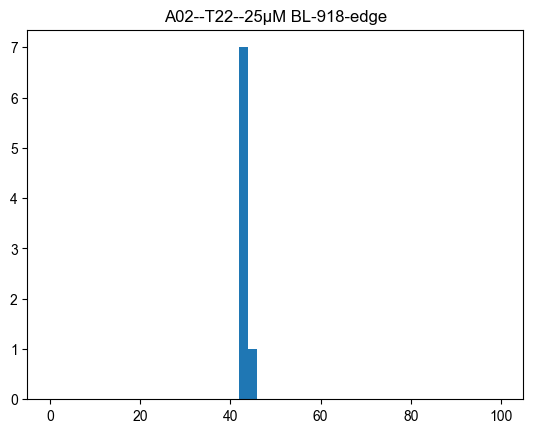

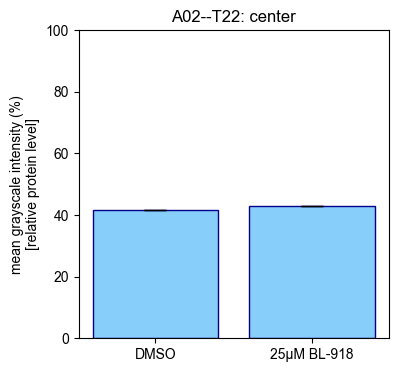

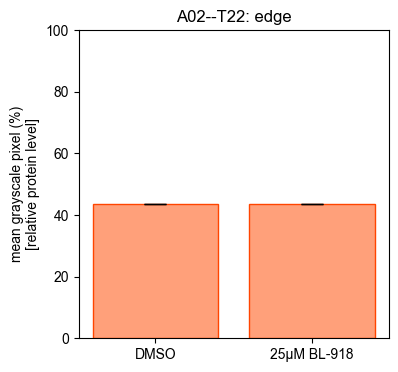

Center t-test 2 tailed:  TtestResult(statistic=-8.563972226900514, pvalue=9.654636595977168e-06, df=9.403081744942831)
Center t-test 1 tailed:  TtestResult(statistic=-8.563972226900514, pvalue=0.999995172681702, df=9.403081744942831)
Edge t-test 2 tailed:  TtestResult(statistic=-0.10018143489110498, pvalue=0.9219994878511474, df=11.020836584072772)
Edge t-test 1 tailed:  TtestResult(statistic=-0.10018143489110498, pvalue=0.5390002560744263, df=11.020836584072772)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  175.0861189390363
edge effect size:  184.15276829952612
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 8 Ab= T22
j= 3 orgline= E11
3-8
4-8
E11--T22 --DMSO, center var:  0.21028851226599343
E11--T22 --DMSO, edge var:  0.4973869482027652
E11--T22 --25μM BL-918, center var:  0.16555370227692853
E11--T22 --25μM BL-9

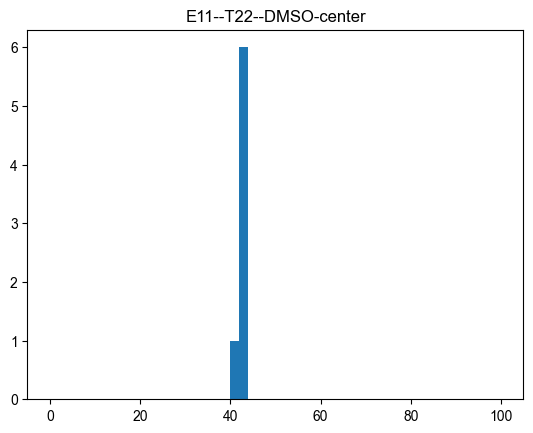

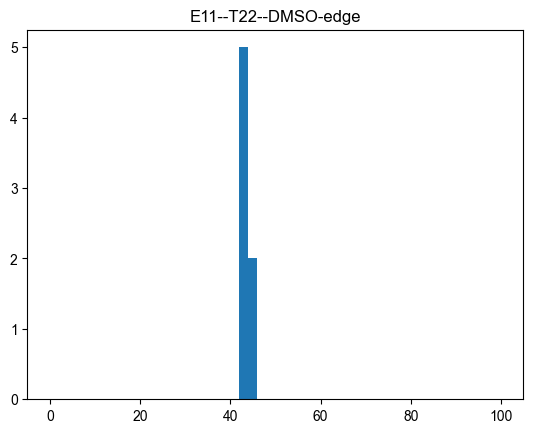

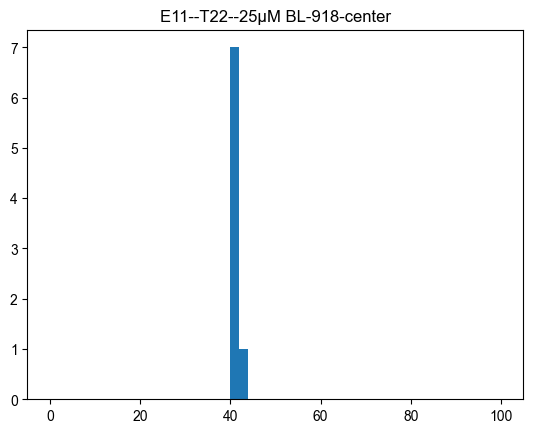

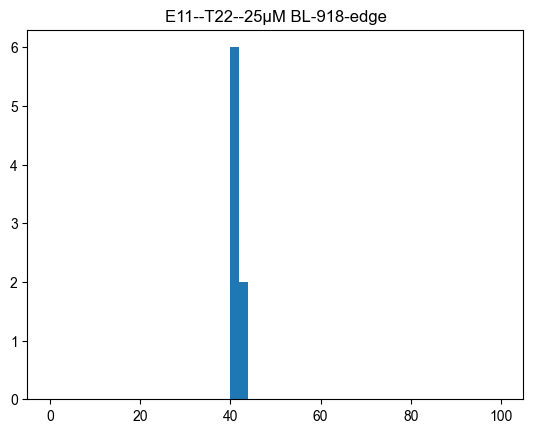

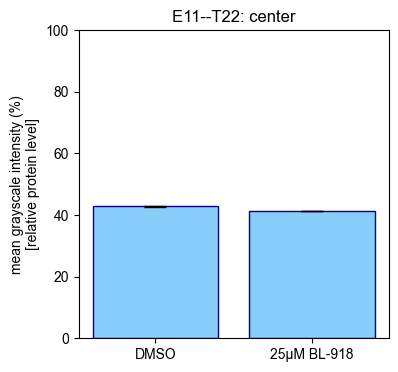

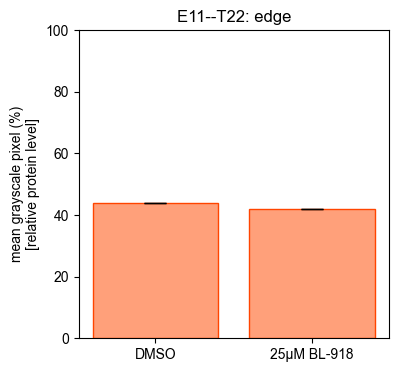

Center t-test 2 tailed:  TtestResult(statistic=6.848670423632535, pvalue=1.654629308276376e-05, df=12.165369919398271)
Center t-test 1 tailed:  TtestResult(statistic=6.848670423632535, pvalue=8.27314654138188e-06, df=12.165369919398271)
Edge t-test 2 tailed:  TtestResult(statistic=7.486145328901494, pvalue=0.00022529881148480857, df=6.34268739706578)
Edge t-test 1 tailed:  TtestResult(statistic=7.486145328901494, pvalue=0.00011264940574240429, df=6.34268739706578)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  101.90362716415399
edge effect size:  82.26226855267353
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 8 Ab= T22
j= 5 orgline= A01
5-8
6-8
A01--T22 --DMSO, center var:  0.5158356064780251
A01--T22 --DMSO, edge var:  0.9198308322401764
A01--T22 --25μM BL-918, center var:  0.33975941545758226
A01--T22 --25μM BL-9

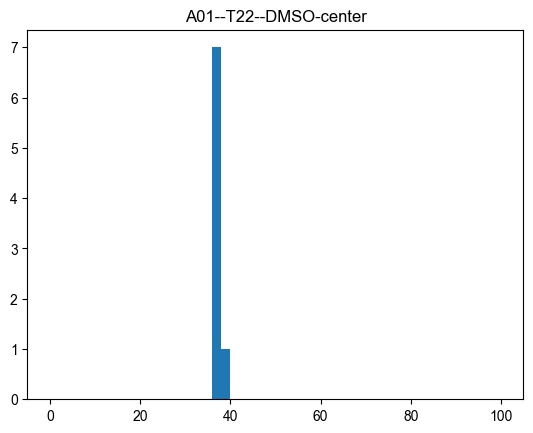

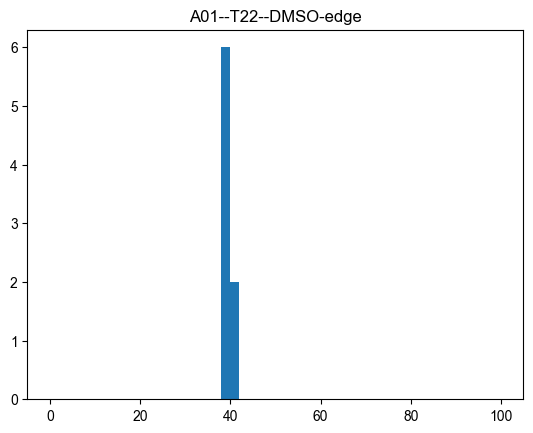

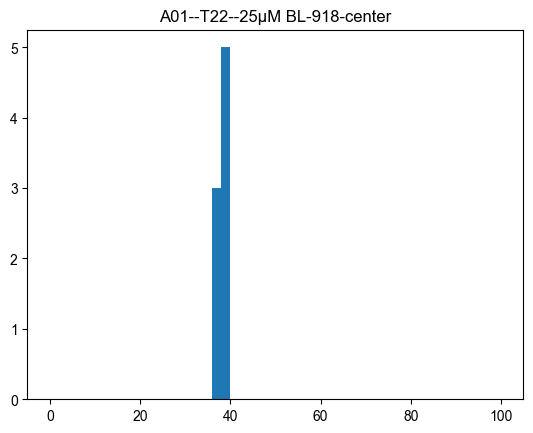

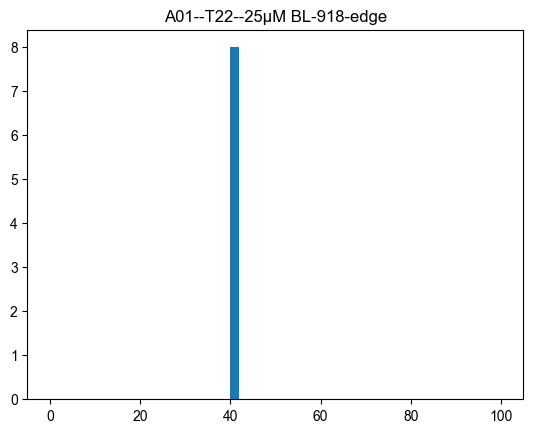

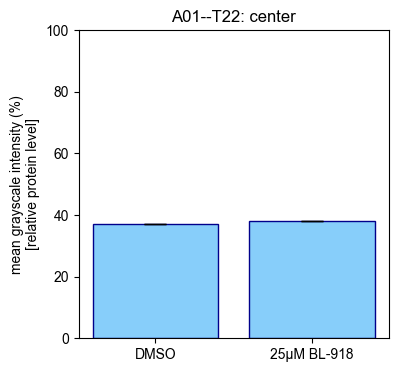

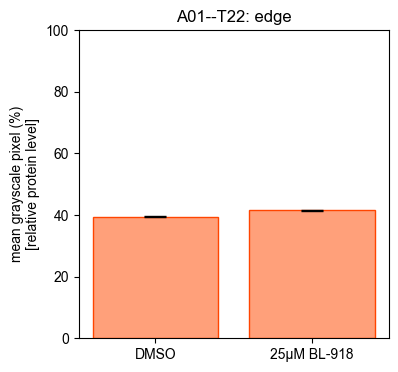

Center t-test 2 tailed:  TtestResult(statistic=-2.904902004993383, pvalue=0.011946806811508743, df=13.431174869846576)
Center t-test 1 tailed:  TtestResult(statistic=-2.904902004993383, pvalue=0.9940265965942456, df=13.431174869846576)
Edge t-test 2 tailed:  TtestResult(statistic=-5.3020688482973855, pvalue=0.00028819615397342836, df=10.564679903513742)
Edge t-test 1 tailed:  TtestResult(statistic=-5.3020688482973855, pvalue=0.9998559019230133, df=10.564679903513742)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  50.902074396619454
edge effect size:  42.546236927379
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 9 Ab= ULK1
j= 1 orgline= A02
1-9
2-9
A02--ULK1 --DMSO, center var:  0.013751068016093982
A02--ULK1 --DMSO, edge var:  0.013305347543224226
A02--ULK1 --25μM BL-918, center var:  0.027877344780021282
A02--ULK1 

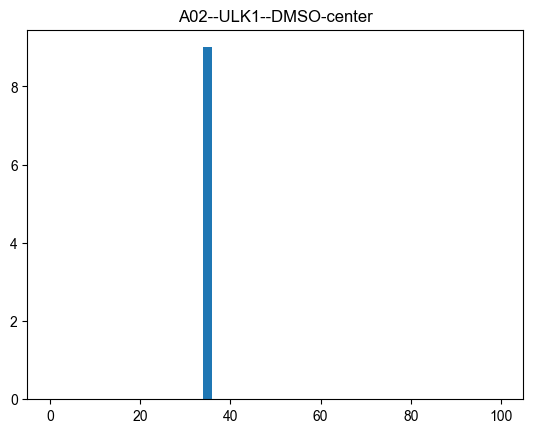

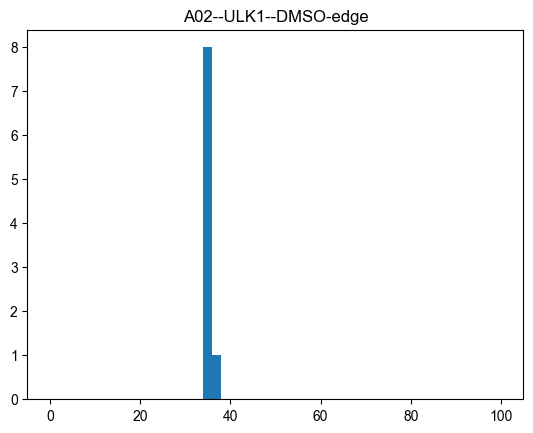

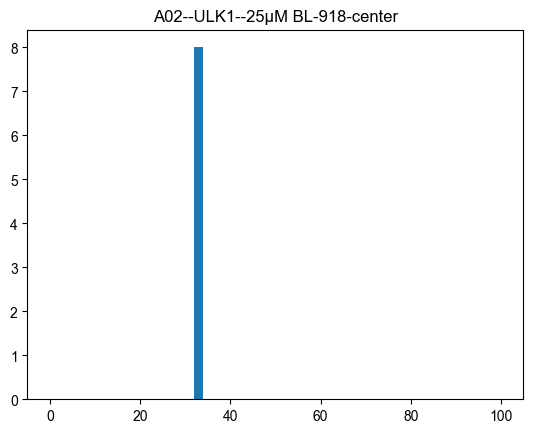

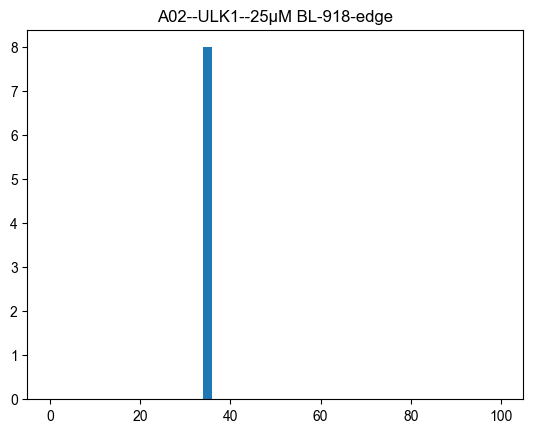

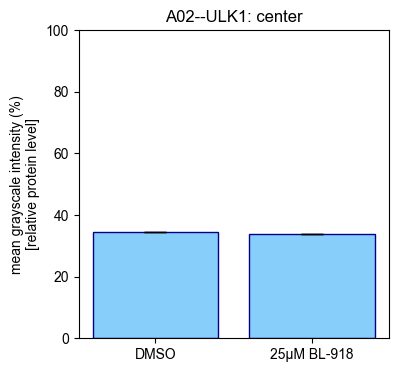

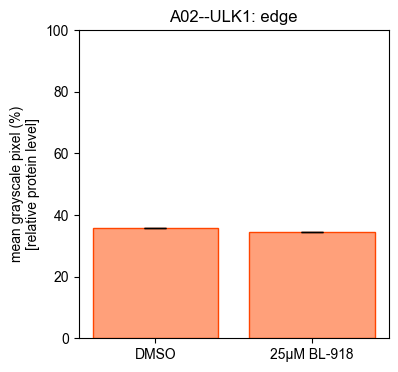

Center t-test 2 tailed:  TtestResult(statistic=12.123356325681879, pvalue=3.0639877669132734e-08, df=12.398558007759632)
Center t-test 1 tailed:  TtestResult(statistic=12.123356325681879, pvalue=1.5319938834566367e-08, df=12.398558007759632)
Edge t-test 2 tailed:  TtestResult(statistic=23.817849875917446, pvalue=5.555279566886615e-13, df=14.416058804129564)
Edge t-test 1 tailed:  TtestResult(statistic=23.817849875917446, pvalue=2.7776397834433074e-13, df=14.416058804129564)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  317.9985091409841
edge effect size:  396.6987746069209
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 9 Ab= ULK1
j= 3 orgline= E11
3-9
4-9
E11--ULK1 --DMSO, center var:  0.01889145782239269
E11--ULK1 --DMSO, edge var:  0.025656085668271114
E11--ULK1 --25μM BL-918, center var:  0.06446633102808651
E11-

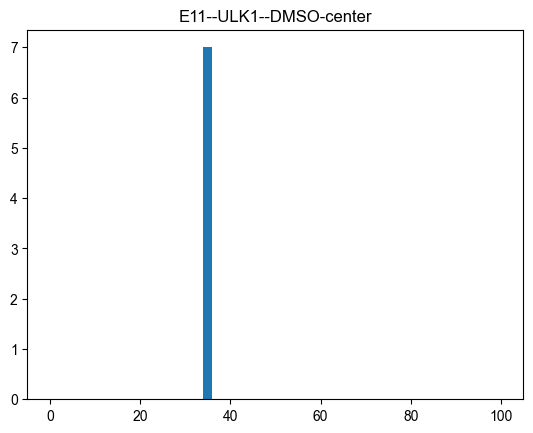

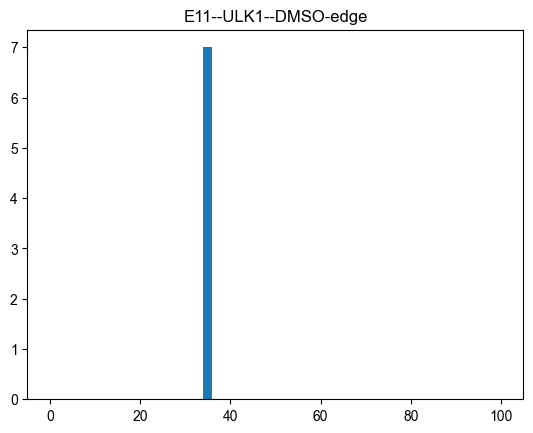

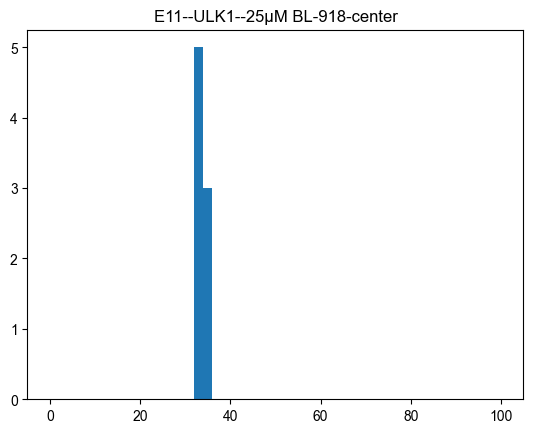

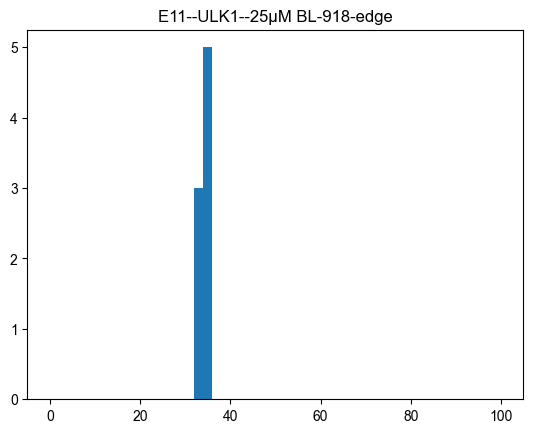

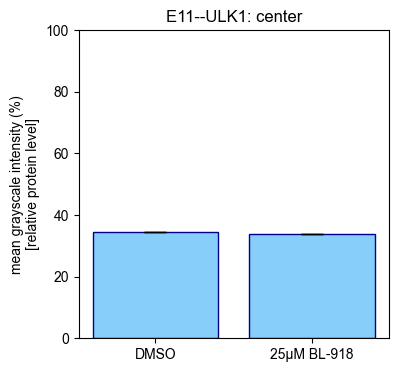

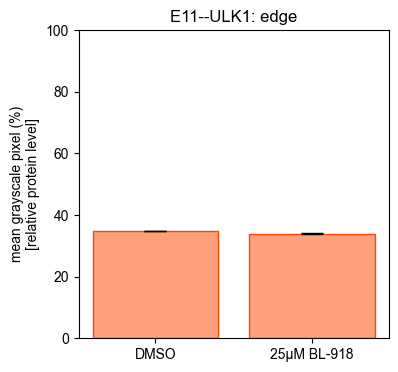

Center t-test 2 tailed:  TtestResult(statistic=4.98690936942408, pvalue=0.0004075208190407142, df=11.030434864023649)
Center t-test 1 tailed:  TtestResult(statistic=4.98690936942408, pvalue=0.0002037604095203571, df=11.030434864023649)
Edge t-test 2 tailed:  TtestResult(statistic=6.03179652856493, pvalue=0.0001310471986190435, df=9.917134870220574)
Edge t-test 1 tailed:  TtestResult(statistic=6.03179652856493, pvalue=6.552359930952174e-05, df=9.917134870220574)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  217.04150602726762
edge effect size:  149.49671976608795
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 9 Ab= ULK1
j= 5 orgline= A01
5-9
6-9
A01--ULK1 --DMSO, center var:  0.04239400632819465
A01--ULK1 --DMSO, edge var:  0.03639364271713374
A01--ULK1 --25μM BL-918, center var:  0.007647243028100767
A01--ULK1 --25μ

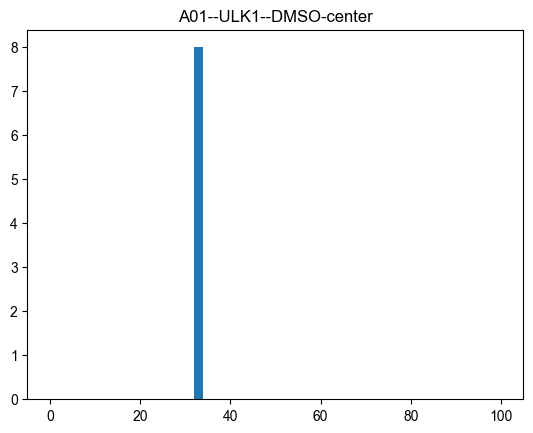

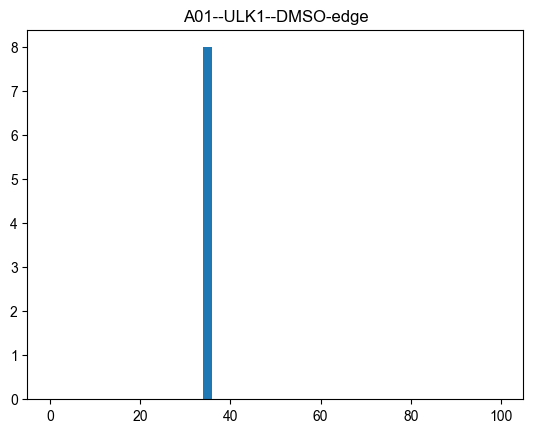

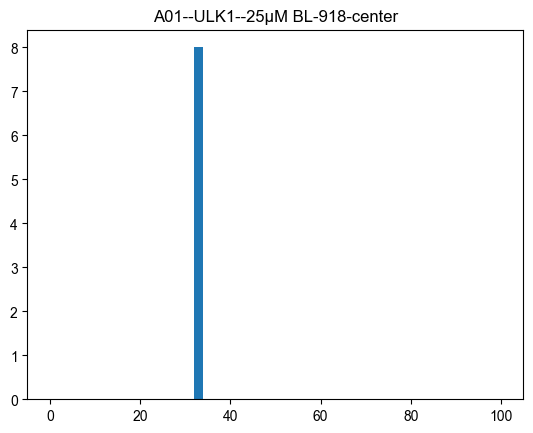

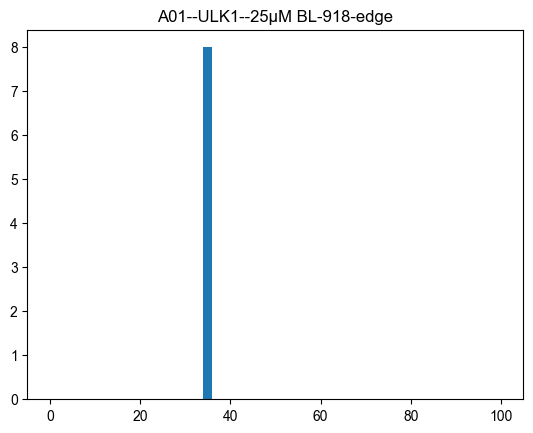

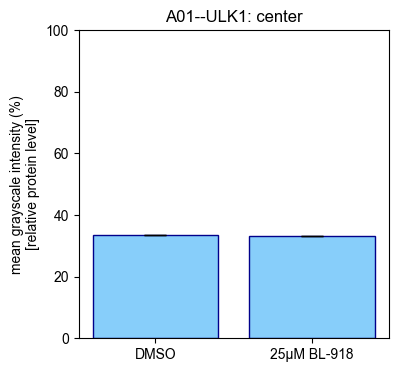

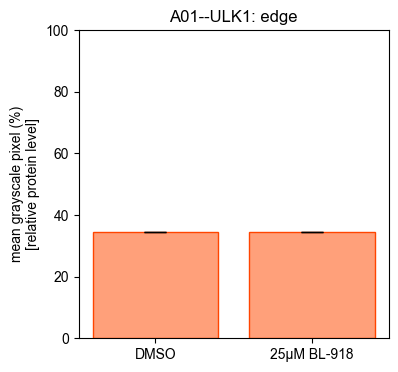

Center t-test 2 tailed:  TtestResult(statistic=5.860692540843612, pvalue=0.00019924331057809185, df=9.445806576431472)
Center t-test 1 tailed:  TtestResult(statistic=5.860692540843612, pvalue=9.962165528904593e-05, df=9.445806576431472)
Edge t-test 2 tailed:  TtestResult(statistic=1.2946777853354137, pvalue=0.22724731265709505, df=9.12022298591091)
Edge t-test 1 tailed:  TtestResult(statistic=1.2946777853354137, pvalue=0.11362365632854753, df=9.12022298591091)
Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2, medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.
center effect size:  282.7548711694754
edge effect size:  324.7435693999406
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n


In [17]:
# step5: statistical testing and bar graphs.
# get 4 lists per Ab (2 per folder): center-DMSO (0-20%), edge-DMSO (80-100%), center-BL(0-20%), edge-BL(80-100%)
# perform t-test between center-DMSO + center-BL, between edge-DMSO + edge-BL
# output: variances between comparison groups; p-val for each t-test, histogram of each group (to check normality), 
# 2 bar graphs for each Ab (one for center comparison [vehicle vs. treated], one for edge [vehicle vs. treated])

# future: could also consider comparing V337M vs V337V (A02 vs. E11 same condits) and different patient lines (A02 vs. A01)

import statistics as stats 
import matplotlib.pyplot as plt
import numpy as np
import scipy
import math
import pandas as pd

# initialize empty lists to output for manipulation in other graphing software
org_s, ab_s, c_vs_e, d_vs_t, means, stdevs, ns, vals = [], [], [], [], [], [], [], []

# similar to excel xlookup: return a list of grayscale values from column "gray" in df that are in 
# between the range provided (min_val, max_val) in column "col_name" (default percent, other option "dist_e" or "dist_c")
def get_percent_range(df, min_val, max_val, col="%dist", col_to_return="gray%"): 
    ls = []
    for i in range(len(df[col])):
        if (df[col][i] >= min_val) and (df[col][i] <= max_val):
            ls.append(df[col_to_return][i])
    return(ls)

# For all the dfs in one folder (condition), calculate the mean of the values in df[col_to_return] that are between df[col]. 
# Return a dictionary of means, where the key is the label of the organoid biorep and the value is the mean for that organoid biorep
def concat_gray_means_range(folder, min_val, max_val, ls=ls_point_to_csvs, col="%dist", col_to_return="gray%", csvs_per_organoid=4):

    # get index of folder of interest for ls
    folder_ind = d_condits[folder]
    
    # get the number of bioreps, for the folder of interest
    bioreps = get_numreps(folder, num_csvs_per_rep = csvs_per_organoid)

    # initialize dictionary that will be return arg
    dict_means = {}
    
    # concat all csv gray vals in same organoid into one list. then, take the mean of that and add it to the dict with orgname as key
    temp_ls = []
    for i in range(bioreps):
        org_name = ls_lsreps[folder_ind][i*4]
        
        # get indicies of dfs for specific org rep of interest
        indices = ls_d_reps[folder_ind][org_name]

        # concat all gray values w/in range for specific org rep of interest
        for j in indices:
            temp_ls.extend(get_percent_range(ls[folder_ind][j], min_val, max_val, col, col_to_return))

        # calculate mean of gray values from org of interest + add to dict
        mean = sum(temp_ls) / len(temp_ls)
        dict_means[org_name] = mean
        
    return dict_means


# TEST:
# d = concat_gray_means_range("2-2", 0, 20)
# print(d)

# take a list of values and turn into a semicolon separated string with the format: "[val1;val2;val3;...valn]
def ls_to_str(ls):
    s = ""
    for item in ls:
        s = s+str(item)+";"
    s = s[0:len(s)-1]
    return s

#return mean of list
def mean(ls):
    return sum(ls)/len(ls)

# go through similar loop as previous step, but this time finding means and doing t-tests between treat-untreat on center vs. edge
# Note that folders "7-x" will have no "treated" condition to compare to, so skip this one

# find gray means of all organoid bioreps in every folder between 20-30%, and 50-70% (subject to change)
min_center, max_center, min_edge, max_edge = 20, 40, 55, 75
i = 0
for i in dict_abs.keys():
    
    for j in dict_orglines.keys():
        # only want one graph per condition pair--so skip even# keys (since j runs 1-7)
        if (j % 2) == 1 and j != 7:
            print("i=", i, "Ab=", dict_abs[i])
            print("j=", j, "orgline=", dict_orglines[j])

            # untreated (1) + treated (2)
            folder1 = str(j) + "-" + str(i)
            print(folder1)
            folder2 = str(j+1) + "-" + str(i)
            print(folder2)

            title = dict_orglines[j] + "--" + dict_abs[i]

            # concat all four relevant lists: dmso/treat, center/edge for this ab. each dict will be n=#bio replicates long,
            # with key = org-biorep-name (ie. "A") and value = mean grayscale intensity % of all csvs for that biorep between the 
            # min,max %dist values passed
            dmso_center = concat_gray_means_range(folder1, min_center, max_center)
            dmso_center_ls = list(dmso_center.values())
            dmso_edge = concat_gray_means_range(folder1, min_edge, max_edge)
            dmso_edge_ls = list(dmso_edge.values())
            treat_center = concat_gray_means_range(folder2, min_center, max_center)
            treat_center_ls = list(treat_center.values())
            treat_edge = concat_gray_means_range(folder2, min_edge, max_edge)
            treat_edge_ls = list(treat_edge.values())
    
            # calc variances of all four lists
            print(title, "--DMSO, center var: ", stats.variance(dmso_center_ls))
            print(title, "--DMSO, edge var: ", stats.variance(dmso_edge_ls))
            print(title, "--25μM BL-918, center var: ", stats.variance(treat_center_ls))
            print(title, "--25μM BL-918, edge var: ", stats.variance(treat_edge_ls))
    
            # plot histograms for all four lists (check normality of distribution)
            plt.hist(dmso_center_ls, bins=50, range=(0,100))
            plt.title(title+"--DMSO-center")
            plt.show()
            plt.hist(dmso_edge_ls, bins=50, range=(0,100))
            plt.title(title+"--DMSO-edge")
            plt.show()
            plt.hist(treat_center_ls, bins=50, range=(0,100))
            plt.title(title+"--25μM BL-918-center")
            plt.show()
            plt.hist(treat_edge_ls, bins=50, range=(0,100))
            plt.title(title+"--25μM BL-918-edge")
            plt.show()

            # plot 2 bar graphs: one for edge, one for center
            x = ["DMSO", "25μM BL-918"]
            fig1, ax1 = plt.subplots(figsize=(4,4))
            ls_center_y = [mean(dmso_center_ls) , mean(treat_center_ls)]
            ls_center_stderr = [np.std(dmso_center_ls)/len(dmso_center_ls) , np.std(treat_center_ls)/len(treat_center_ls)]
            ax1.bar(x, ls_center_y, color="lightskyblue", edgecolor="darkblue", linewidth=1,yerr=ls_center_stderr, ecolor='k', capsize=8)
            ax1.set_ylabel("mean grayscale intensity (%)\n[relative protein level]")
            ax1.set_title(title+": center")
            ax1.set_ylim(bottom=0, top=100)
            plt.show()

            fig2, ax2 = plt.subplots(figsize=(4,4))
            ls_edge_y = [mean(dmso_edge_ls) , mean(treat_edge_ls)]
            ls_edge_stderr = [np.std(dmso_edge_ls)/len(dmso_edge_ls) , np.std(treat_edge_ls)/len(treat_edge_ls)]
            ax2.bar(x, ls_edge_y, color="lightsalmon", edgecolor="orangered", linewidth=1, yerr=ls_edge_stderr, ecolor='k', capsize=8)
            ax2.set_ylabel("mean grayscale pixel (%)\n[relative protein level]")
            ax2.set_title(title+": edge")
            ax2.set_ylim(bottom=0, top=100)
            plt.show()
    
            # do relevant t-tests and report p-values of all four lists
            center_2_result = scipy.stats.ttest_ind(dmso_center_ls, treat_center_ls, equal_var=False)
            center_1_result = scipy.stats.ttest_ind(dmso_center_ls, treat_center_ls, equal_var=False, alternative='greater')
            print("Center t-test 2 tailed: ", center_2_result)
            print("Center t-test 1 tailed: ", center_1_result)
    
            edge_2_result = scipy.stats.ttest_ind(dmso_edge_ls, treat_edge_ls, equal_var=False)
            edge_1_result = scipy.stats.ttest_ind(dmso_edge_ls, treat_edge_ls, equal_var=False, alternative='greater')
            print("Edge t-test 2 tailed: ",edge_2_result)
            print("Edge t-test 1 tailed: ",edge_1_result)

            # calculate effect size
            # https://www.scribbr.com/statistics/effect-size/
            print("Effect size indicates the practical effect of a certain perturbation. Effect size is small if ~0.2" + 
                    ", medium if ~0.5, and large if ~0.8. Similar in range to Pearson's correlation coefficient.")
            center_denom = math.sqrt(np.std(dmso_center_ls) ** 2 + np.std(treat_center_ls) ** 2) / 2
            center_effect = abs(mean(dmso_center_ls) - mean(treat_center_ls) / center_denom)
            print("center effect size: ", center_effect)
            edge_denom = math.sqrt(np.std(dmso_edge_ls) ** 2 + np.std(treat_edge_ls) ** 2) / 2
            edge_effect = abs(mean(dmso_edge_ls) - mean(treat_edge_ls) / edge_denom)
            print("edge effect size: ", edge_effect)

            # print biorep numebers
            print("DMSO bioreps (N) = " , len(dmso_center_ls))
            print("Treated bioreps(N) = ", len(treat_center_ls), "\n\n\n\\n")

            # add to lists to create df, so data can be written to csv
            org_s.extend([dict_orglines[j], dict_orglines[j], dict_orglines[j], dict_orglines[j]]) 
            ab_s.extend([dict_abs[i], dict_abs[i], dict_abs[i], dict_abs[i]])
            c_vs_e.extend(["center", "center", "edge", "edge"])
            d_vs_t.extend(["dmso", "treat", "dmso", "treat"])
            means.extend([mean(dmso_center_ls), mean(treat_center_ls), mean(dmso_edge_ls), mean(treat_edge_ls)])
            stdevs.extend([np.std(dmso_center_ls), np.std(treat_center_ls), np.std(dmso_edge_ls), np.std(treat_edge_ls)])
            ns.extend([len(dmso_center), len(treat_center), len(dmso_edge), len(treat_edge)])
            vals.extend([ls_to_str(dmso_center_ls), ls_to_str(treat_center_ls), ls_to_str(dmso_edge_ls), ls_to_str(treat_edge_ls)])



#create df with lists
df_out = pd.DataFrame()
df_out["Orgline"] = org_s
df_out["Abs"] = ab_s
df_out["center/edge"] = c_vs_e
df_out["dmso/treat"] = d_vs_t
df_out["mean"] = means
df_out["stdev"] = stdevs
df_out["N"] = ns
df_out["values"] = vals

#output df to csv
df_out.to_csv("./output_img_full/bar_graph_output_full.csv")
#print(df_out)


In [31]:
# TEST:: Can you normalize to overall mean before OR after getting center, edge means?
# conclusion: yes
# in my situation, likely easier to just copy step5, but normalize to already calculated mean values for each biorep/condition.
x1 = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11] # mean = 6.0
x = [4, 1, 2, 56, 7, 9, 40, 23, 91, 85, 3, 20, 34, 2, 15, 34, 50, 20]
meanx = mean(x)

# take center, edge averages, then normalize to mean
# center, edge averages without normalization
center_preavg = mean(x[2:5])
edge_preavg = mean(x[7:10])
print("average then norm:: \nbefore norm: ", center_preavg, edge_preavg, sep=";")
# with nromalization
print("post norm: ", center_preavg/meanx, edge_preavg/meanx, sep=";")

# normalize the list, then take center, edge averages.
newls = []
for item in x:
    newls.append(item / meanx)

center_postavg = mean(newls[2:5])
edge_postavg = mean(newls[7:10])
print("\n\n\nnorm then average::\n", center_postavg, edge_postavg, sep=";")

# conclusion: can get averages, then normalize to the mean


average then norm:: 
before norm: ;21.666666666666668;66.33333333333333
post norm: ;0.7862903225806451;2.4072580645161286



norm then average::
;0.7862903225806451;2.407258064516129


i= 2 Ab= MAP2
j= 1 orgline= A02
A02--MAP2
1-2
2-2


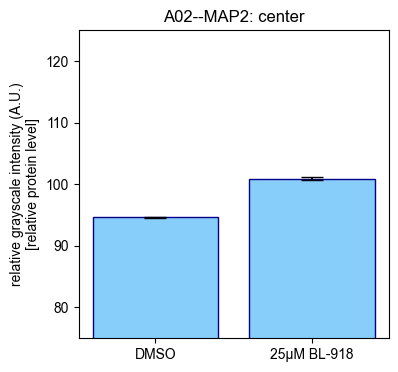

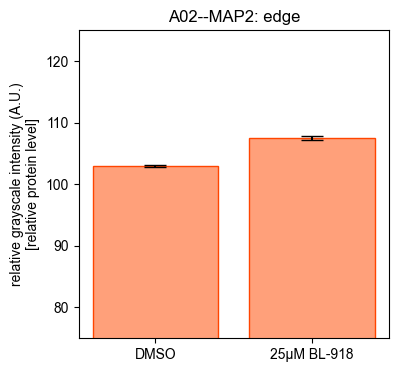

Center t-test 2 tailed:  TtestResult(statistic=-8.600935066908894, pvalue=8.05514437992396e-06, df=9.61380888723973)
Center t-test 1 tailed:  TtestResult(statistic=-8.600935066908894, pvalue=0.99999597242781, df=9.61380888723973)
Edge t-test 2 tailed:  TtestResult(statistic=-4.370713577059428, pvalue=0.0018371462855459022, df=8.913276411539172)
Edge t-test 1 tailed:  TtestResult(statistic=-4.370713577059428, pvalue=0.9990814268572271, df=8.913276411539172)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 2 Ab= MAP2
j= 3 orgline= E11
E11--MAP2
3-2
4-2


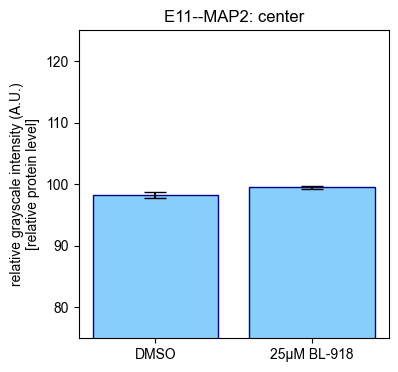

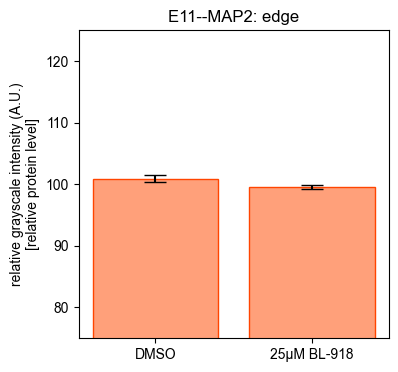

Center t-test 2 tailed:  TtestResult(statistic=-0.8507710497802353, pvalue=0.41987490855580356, df=7.919261822664733)
Center t-test 1 tailed:  TtestResult(statistic=-0.8507710497802353, pvalue=0.7900625457220982, df=7.919261822664733)
Edge t-test 2 tailed:  TtestResult(statistic=0.722971947572399, pvalue=0.486395498524993, df=9.918556867862293)
Edge t-test 1 tailed:  TtestResult(statistic=0.722971947572399, pvalue=0.2431977492624965, df=9.918556867862293)
DMSO bioreps (N) =  6
Treated bioreps(N) =  8 


\n
i= 2 Ab= MAP2
j= 5 orgline= A01
A01--MAP2
5-2
6-2


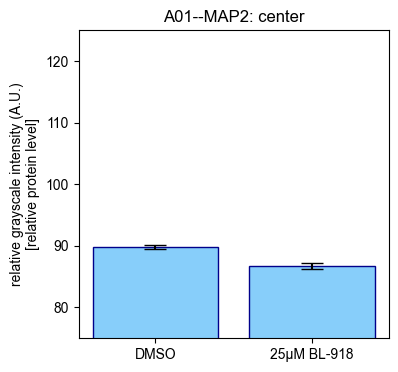

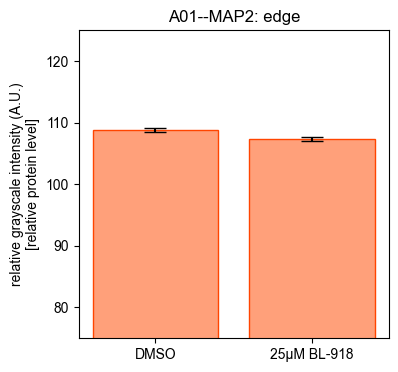

Center t-test 2 tailed:  TtestResult(statistic=1.7584528898303202, pvalue=0.10739431169391518, df=10.625191635245226)
Center t-test 1 tailed:  TtestResult(statistic=1.7584528898303202, pvalue=0.05369715584695759, df=10.625191635245226)
Edge t-test 2 tailed:  TtestResult(statistic=0.9995091293647759, pvalue=0.3345141141362785, df=13.997646976317965)
Edge t-test 1 tailed:  TtestResult(statistic=0.9995091293647759, pvalue=0.16725705706813926, df=13.997646976317965)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 3 Ab= AT8
j= 1 orgline= A02
A02--AT8
1-3
2-3


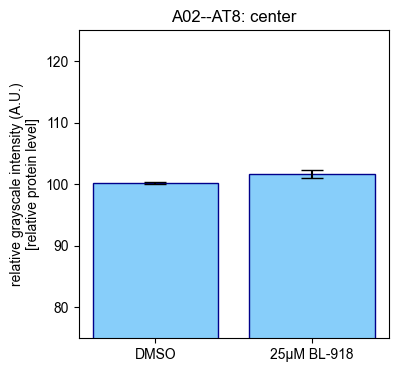

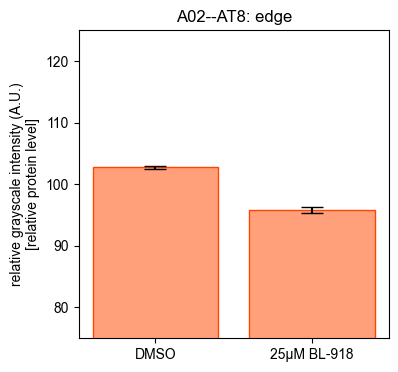

Center t-test 2 tailed:  TtestResult(statistic=-0.7369008978673338, pvalue=0.4859635210479307, df=6.760189316039105)
Center t-test 1 tailed:  TtestResult(statistic=-0.7369008978673338, pvalue=0.7570182394760346, df=6.760189316039105)
Edge t-test 2 tailed:  TtestResult(statistic=4.471929512617993, pvalue=0.001327244921848737, df=9.581315416853181)
Edge t-test 1 tailed:  TtestResult(statistic=4.471929512617993, pvalue=0.0006636224609243685, df=9.581315416853181)
DMSO bioreps (N) =  9
Treated bioreps(N) =  7 


\n
i= 3 Ab= AT8
j= 3 orgline= E11
E11--AT8
3-3
4-3


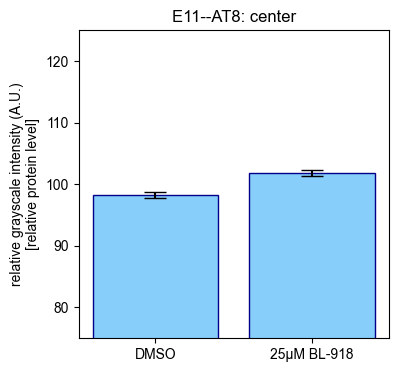

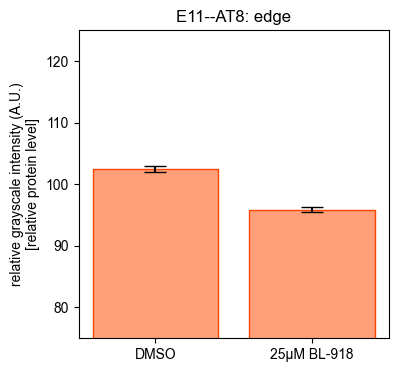

Center t-test 2 tailed:  TtestResult(statistic=-1.833338814348693, pvalue=0.09031339505417671, df=12.685896361992304)
Center t-test 1 tailed:  TtestResult(statistic=-1.833338814348693, pvalue=0.9548433024729117, df=12.685896361992304)
Edge t-test 2 tailed:  TtestResult(statistic=3.635444782444067, pvalue=0.003578761063078929, df=11.649418486152554)
Edge t-test 1 tailed:  TtestResult(statistic=3.635444782444067, pvalue=0.0017893805315394645, df=11.649418486152554)
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 3 Ab= AT8
j= 5 orgline= A01
A01--AT8
5-3
6-3


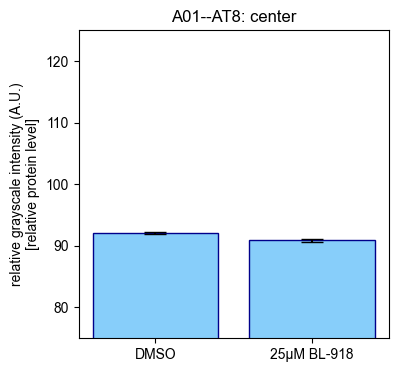

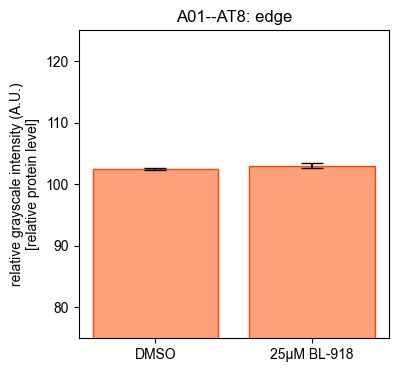

Center t-test 2 tailed:  TtestResult(statistic=1.5123001222196297, pvalue=0.16134844111001173, df=10.016426002240417)
Center t-test 1 tailed:  TtestResult(statistic=1.5123001222196297, pvalue=0.08067422055500587, df=10.016426002240417)
Edge t-test 2 tailed:  TtestResult(statistic=-0.49735588893562027, pvalue=0.632274578279191, df=8.026590325829831)
Edge t-test 1 tailed:  TtestResult(statistic=-0.49735588893562027, pvalue=0.6838627108604045, df=8.026590325829831)
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 4 Ab= HT7
j= 1 orgline= A02
A02--HT7
1-4
2-4


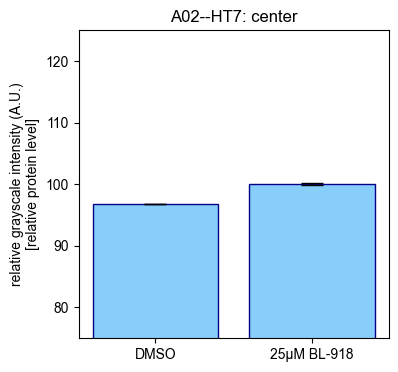

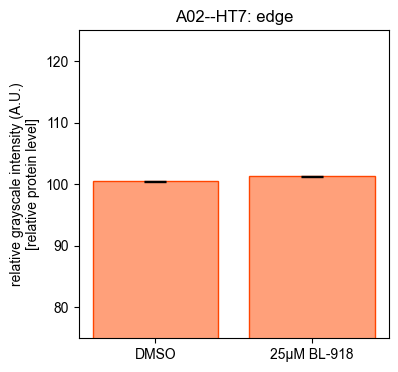

Center t-test 2 tailed:  TtestResult(statistic=-7.934340573170425, pvalue=3.463825852233895e-05, df=8.42289829268701)
Center t-test 1 tailed:  TtestResult(statistic=-7.934340573170425, pvalue=0.9999826808707388, df=8.42289829268701)
Edge t-test 2 tailed:  TtestResult(statistic=-1.61973231376936, pvalue=0.13073096636111187, df=12.250431166522267)
Edge t-test 1 tailed:  TtestResult(statistic=-1.61973231376936, pvalue=0.9346345168194441, df=12.250431166522267)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 4 Ab= HT7
j= 3 orgline= E11
E11--HT7
3-4
4-4


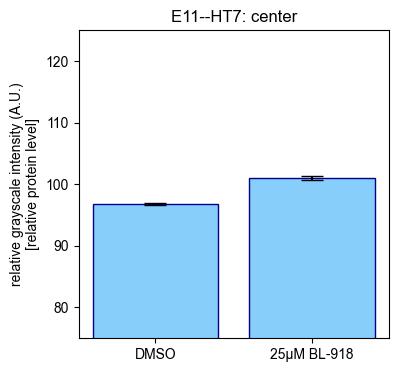

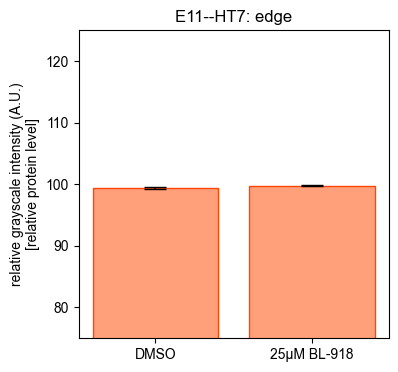

Center t-test 2 tailed:  TtestResult(statistic=-3.69344982297424, pvalue=0.0035749350102635994, df=10.938218899152568)
Center t-test 1 tailed:  TtestResult(statistic=-3.69344982297424, pvalue=0.9982125324948682, df=10.938218899152568)
Edge t-test 2 tailed:  TtestResult(statistic=-0.6235955905256648, pvalue=0.548109956400928, df=9.157135381104208)
Edge t-test 1 tailed:  TtestResult(statistic=-0.6235955905256648, pvalue=0.725945021799536, df=9.157135381104208)
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 4 Ab= HT7
j= 5 orgline= A01
A01--HT7
5-4
6-4


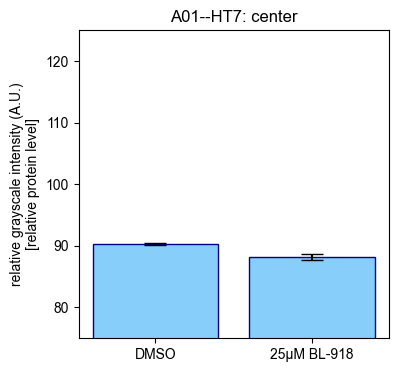

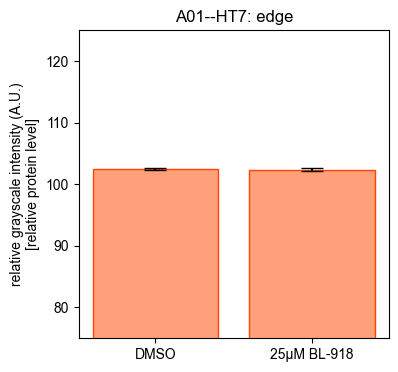

Center t-test 2 tailed:  TtestResult(statistic=1.440761861251263, pvalue=0.18691955951867498, df=8.155226180501224)
Center t-test 1 tailed:  TtestResult(statistic=1.440761861251263, pvalue=0.09345977975933749, df=8.155226180501224)
Edge t-test 2 tailed:  TtestResult(statistic=0.07462283022179067, pvalue=0.9419686472347771, df=10.124644109935247)
Edge t-test 1 tailed:  TtestResult(statistic=0.07462283022179067, pvalue=0.47098432361738857, df=10.124644109935247)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 5 Ab= Beclin-1
j= 1 orgline= A02
A02--Beclin-1
1-5
2-5


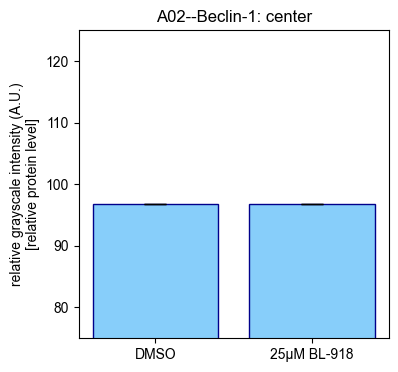

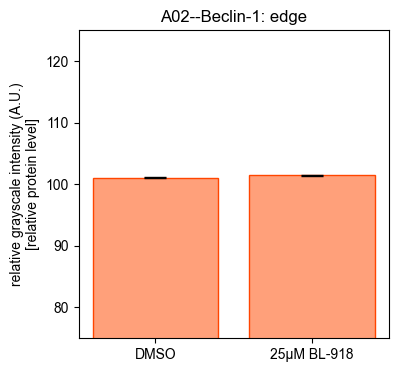

Center t-test 2 tailed:  TtestResult(statistic=-0.0395329987514465, pvalue=0.9690448921968358, df=13.481813180585117)
Center t-test 1 tailed:  TtestResult(statistic=-0.0395329987514465, pvalue=0.5154775539015822, df=13.481813180585117)
Edge t-test 2 tailed:  TtestResult(statistic=-1.448549456597029, pvalue=0.1695639766825038, df=13.951739577044425)
Edge t-test 1 tailed:  TtestResult(statistic=-1.448549456597029, pvalue=0.9152180116587482, df=13.951739577044425)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 5 Ab= Beclin-1
j= 3 orgline= E11
E11--Beclin-1
3-5
4-5


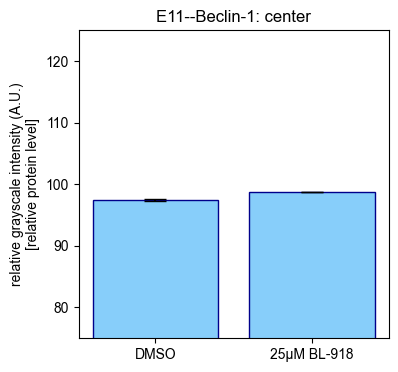

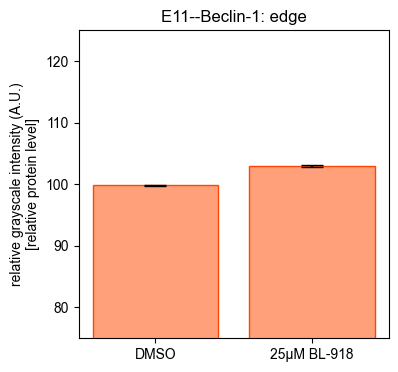

Center t-test 2 tailed:  TtestResult(statistic=-2.975883784130299, pvalue=0.016577077286485956, df=8.490005148752017)
Center t-test 1 tailed:  TtestResult(statistic=-2.975883784130299, pvalue=0.991711461356757, df=8.490005148752017)
Edge t-test 2 tailed:  TtestResult(statistic=-6.76640603979947, pvalue=1.4278020528636723e-05, df=12.818356501272287)
Edge t-test 1 tailed:  TtestResult(statistic=-6.76640603979947, pvalue=0.9999928609897357, df=12.818356501272287)
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 5 Ab= Beclin-1
j= 5 orgline= A01
A01--Beclin-1
5-5
6-5


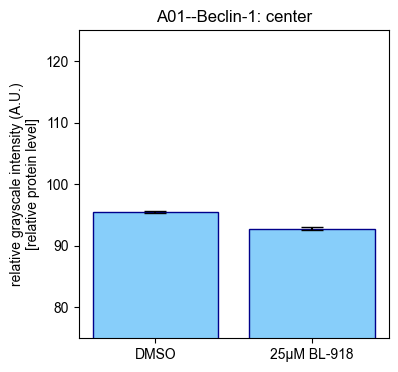

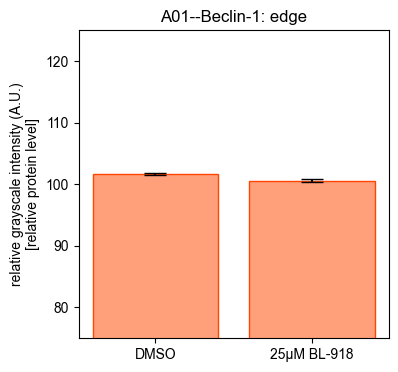

Center t-test 2 tailed:  TtestResult(statistic=3.31961716329282, pvalue=0.00779512690299297, df=9.959127196693744)
Center t-test 1 tailed:  TtestResult(statistic=3.31961716329282, pvalue=0.003897563451496485, df=9.959127196693744)
Edge t-test 2 tailed:  TtestResult(statistic=1.3425981098261475, pvalue=0.20168621983438795, df=13.411483109859638)
Edge t-test 1 tailed:  TtestResult(statistic=1.3425981098261475, pvalue=0.10084310991719397, df=13.411483109859638)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 6 Ab= p62
j= 1 orgline= A02
A02--p62
1-6
2-6


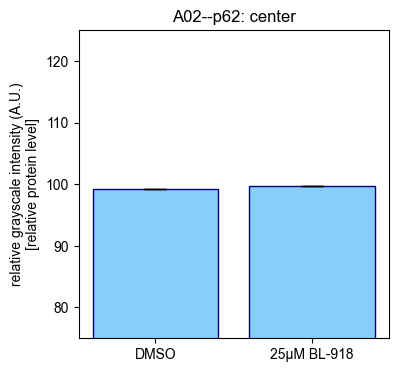

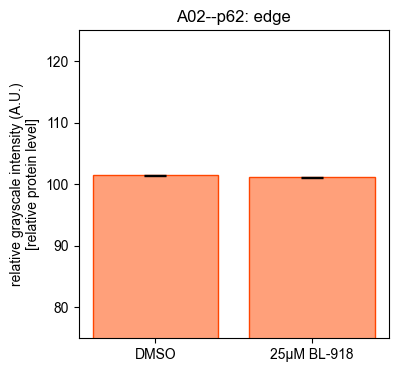

Center t-test 2 tailed:  TtestResult(statistic=-1.8554646291352865, pvalue=0.08804795720508067, df=12.097561665145413)
Center t-test 1 tailed:  TtestResult(statistic=-1.8554646291352865, pvalue=0.9559760213974596, df=12.097561665145413)
Edge t-test 2 tailed:  TtestResult(statistic=1.138821415304321, pvalue=0.2812590313959158, df=10.025147244454745)
Edge t-test 1 tailed:  TtestResult(statistic=1.138821415304321, pvalue=0.1406295156979579, df=10.025147244454745)
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 6 Ab= p62
j= 3 orgline= E11
E11--p62
3-6
4-6


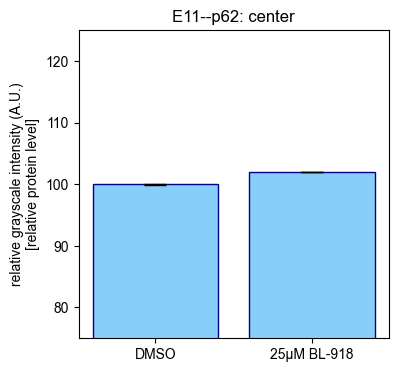

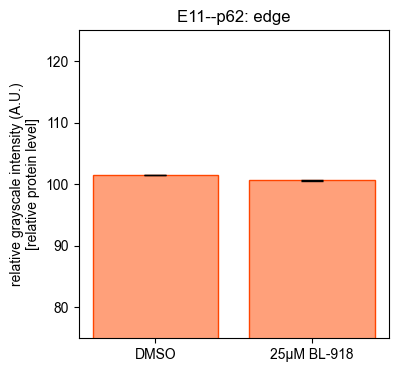

Center t-test 2 tailed:  TtestResult(statistic=-8.323208767809614, pvalue=4.816149099776972e-05, df=7.489937967324226)
Center t-test 1 tailed:  TtestResult(statistic=-8.323208767809614, pvalue=0.9999759192545011, df=7.489937967324226)
Edge t-test 2 tailed:  TtestResult(statistic=3.810545497330041, pvalue=0.0032244606984061894, df=10.343502426338553)
Edge t-test 1 tailed:  TtestResult(statistic=3.810545497330041, pvalue=0.0016122303492030947, df=10.343502426338553)
DMSO bioreps (N) =  7
Treated bioreps(N) =  7 


\n
i= 6 Ab= p62
j= 5 orgline= A01
A01--p62
5-6
6-6


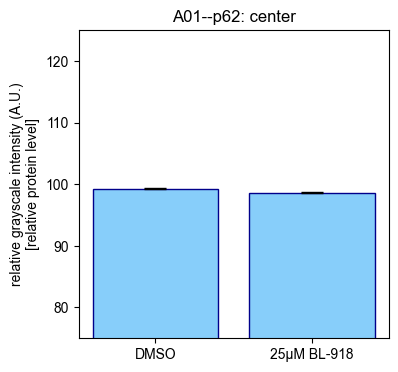

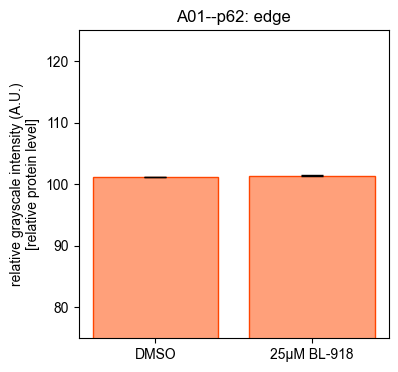

Center t-test 2 tailed:  TtestResult(statistic=3.7224996688437195, pvalue=0.004720131557904336, df=9.034937412922236)
Center t-test 1 tailed:  TtestResult(statistic=3.7224996688437195, pvalue=0.002360065778952168, df=9.034937412922236)
Edge t-test 2 tailed:  TtestResult(statistic=-1.1845307839747519, pvalue=0.2608173093266361, df=11.15967837963609)
Edge t-test 1 tailed:  TtestResult(statistic=-1.1845307839747519, pvalue=0.8695913453366819, df=11.15967837963609)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 7 Ab= LC3
j= 1 orgline= A02
A02--LC3
1-7
2-7


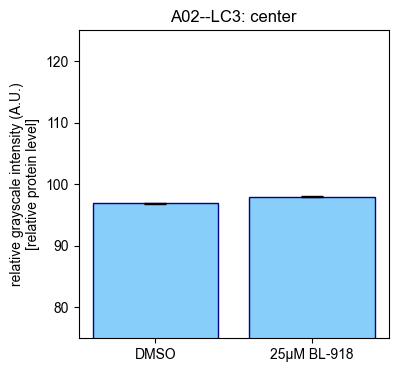

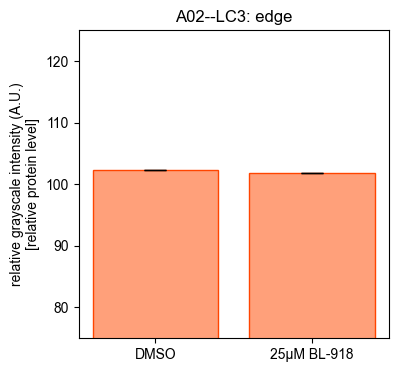

Center t-test 2 tailed:  TtestResult(statistic=-4.1409174835689955, pvalue=0.0018363428086082712, df=10.431296443619491)
Center t-test 1 tailed:  TtestResult(statistic=-4.1409174835689955, pvalue=0.9990818285956958, df=10.431296443619491)
Edge t-test 2 tailed:  TtestResult(statistic=2.6159451124082707, pvalue=0.0198067364813016, df=14.593362442798247)
Edge t-test 1 tailed:  TtestResult(statistic=2.6159451124082707, pvalue=0.0099033682406508, df=14.593362442798247)
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 7 Ab= LC3
j= 3 orgline= E11
E11--LC3
3-7
4-7


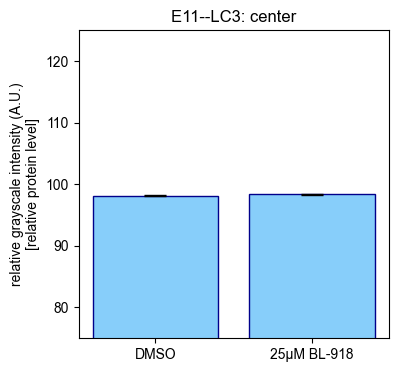

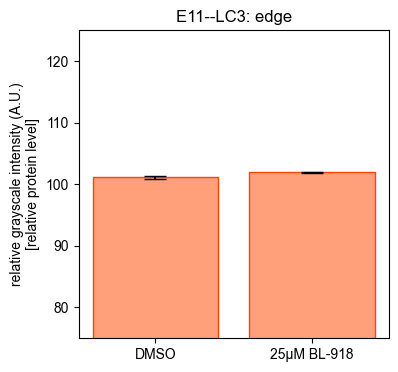

Center t-test 2 tailed:  TtestResult(statistic=-0.47646360161370677, pvalue=0.6431258361501682, df=10.93109742100945)
Center t-test 1 tailed:  TtestResult(statistic=-0.47646360161370677, pvalue=0.6784370819249159, df=10.93109742100945)
Edge t-test 2 tailed:  TtestResult(statistic=-1.456838390397417, pvalue=0.18788168856341822, df=7.106396776862711)
Edge t-test 1 tailed:  TtestResult(statistic=-1.456838390397417, pvalue=0.9060591557182909, df=7.106396776862711)
DMSO bioreps (N) =  7
Treated bioreps(N) =  7 


\n
i= 7 Ab= LC3
j= 5 orgline= A01
A01--LC3
5-7
6-7


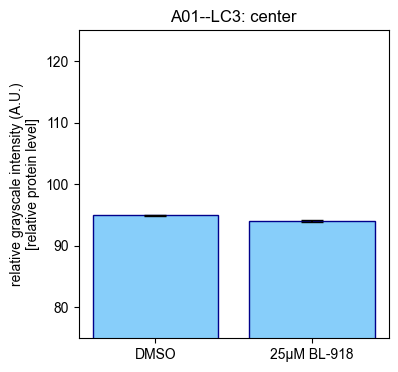

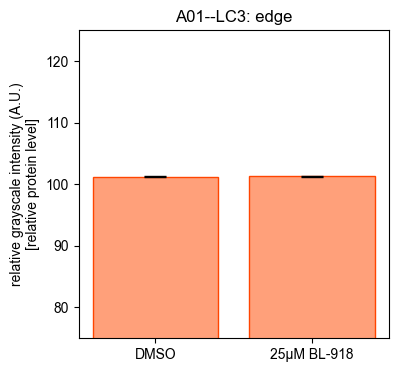

Center t-test 2 tailed:  TtestResult(statistic=1.888431076675639, pvalue=0.08884551407288972, df=9.815027809040764)
Center t-test 1 tailed:  TtestResult(statistic=1.888431076675639, pvalue=0.04442275703644486, df=9.815027809040764)
Edge t-test 2 tailed:  TtestResult(statistic=-0.08815943609062463, pvalue=0.9316143516275344, df=9.324797226634834)
Edge t-test 1 tailed:  TtestResult(statistic=-0.08815943609062463, pvalue=0.5341928241862328, df=9.324797226634834)
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 8 Ab= T22
j= 1 orgline= A02
A02--T22
1-8
2-8


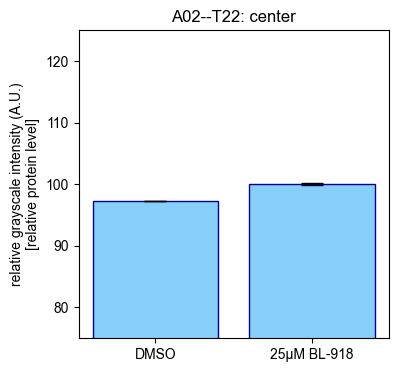

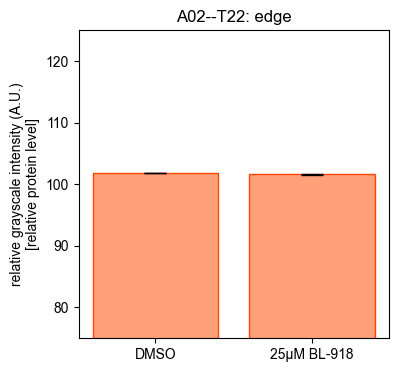

Center t-test 2 tailed:  TtestResult(statistic=-7.9220864999807254, pvalue=1.8391609674317678e-05, df=9.413569246396438)
Center t-test 1 tailed:  TtestResult(statistic=-7.9220864999807254, pvalue=0.9999908041951628, df=9.413569246396438)
Edge t-test 2 tailed:  TtestResult(statistic=0.5954558396626567, pvalue=0.5635494962585144, df=11.036715948243442)
Edge t-test 1 tailed:  TtestResult(statistic=0.5954558396626567, pvalue=0.2817747481292572, df=11.036715948243442)
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 8 Ab= T22
j= 3 orgline= E11
E11--T22
3-8
4-8


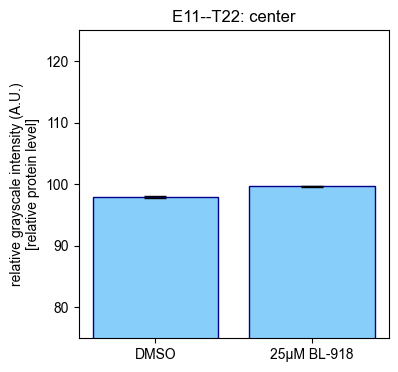

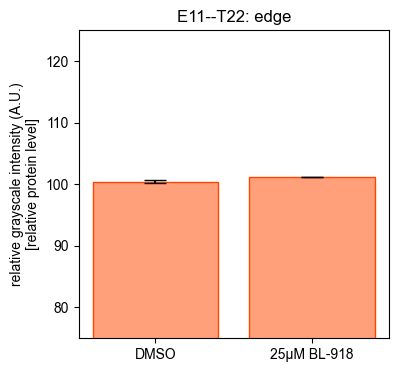

Center t-test 2 tailed:  TtestResult(statistic=-3.3060994087213325, pvalue=0.0059851141000527375, df=12.457020004872222)
Center t-test 1 tailed:  TtestResult(statistic=-3.3060994087213325, pvalue=0.9970074429499736, df=12.457020004872222)
Edge t-test 2 tailed:  TtestResult(statistic=-1.1631529040879176, pvalue=0.28640539445311974, df=6.382069975737661)
Edge t-test 1 tailed:  TtestResult(statistic=-1.1631529040879176, pvalue=0.8567973027734401, df=6.382069975737661)
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 8 Ab= T22
j= 5 orgline= A01
A01--T22
5-8
6-8


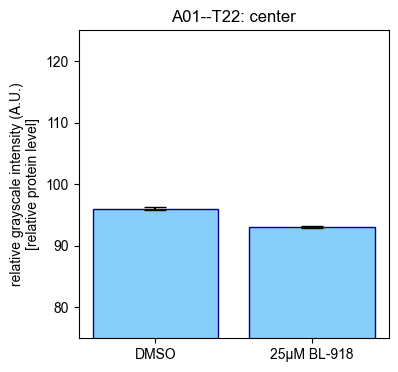

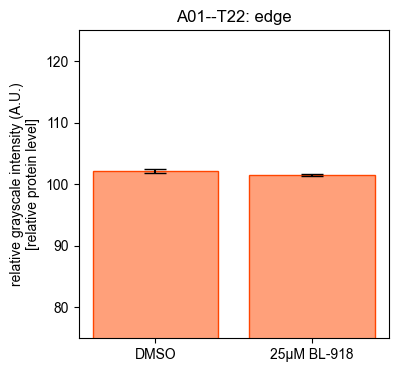

Center t-test 2 tailed:  TtestResult(statistic=3.616373261975951, pvalue=0.0030907457541863113, df=13.116035948875508)
Center t-test 1 tailed:  TtestResult(statistic=3.616373261975951, pvalue=0.0015453728770931556, df=13.116035948875508)
Edge t-test 2 tailed:  TtestResult(statistic=0.7116812985841289, pvalue=0.4925765341175127, df=10.226960961497426)
Edge t-test 1 tailed:  TtestResult(statistic=0.7116812985841289, pvalue=0.24628826705875634, df=10.226960961497426)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n
i= 9 Ab= ULK1
j= 1 orgline= A02
A02--ULK1
1-9
2-9


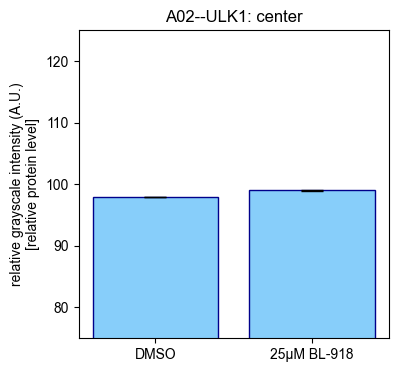

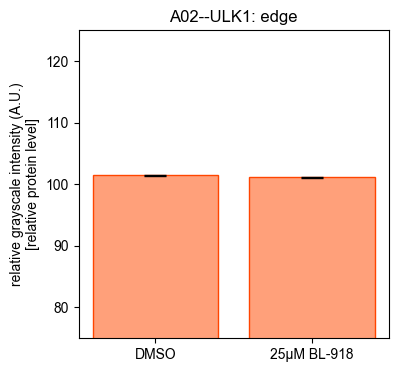

Center t-test 2 tailed:  TtestResult(statistic=-5.346196465354866, pvalue=0.00016928515522275154, df=12.110694204477987)
Center t-test 1 tailed:  TtestResult(statistic=-5.346196465354866, pvalue=0.9999153574223887, df=12.110694204477987)
Edge t-test 2 tailed:  TtestResult(statistic=1.986852235085399, pvalue=0.06657934514109927, df=14.203631410698158)
Edge t-test 1 tailed:  TtestResult(statistic=1.986852235085399, pvalue=0.033289672570549635, df=14.203631410698158)
DMSO bioreps (N) =  9
Treated bioreps(N) =  8 


\n
i= 9 Ab= ULK1
j= 3 orgline= E11
E11--ULK1
3-9
4-9


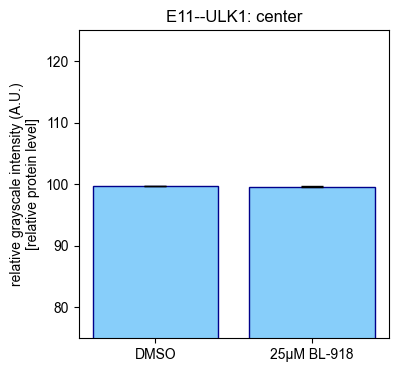

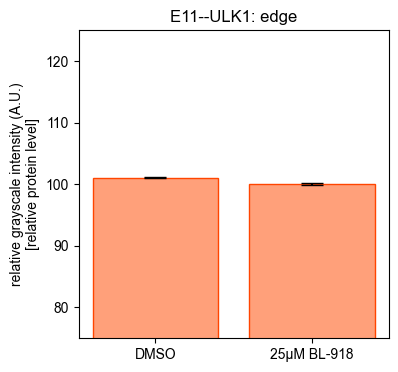

Center t-test 2 tailed:  TtestResult(statistic=0.26216058965009065, pvalue=0.7980661452028027, df=10.945026487670576)
Center t-test 1 tailed:  TtestResult(statistic=0.26216058965009065, pvalue=0.39903307260140136, df=10.945026487670576)
Edge t-test 2 tailed:  TtestResult(statistic=2.5226286582670356, pvalue=0.030584709777710228, df=9.844954519214923)
Edge t-test 1 tailed:  TtestResult(statistic=2.5226286582670356, pvalue=0.015292354888855114, df=9.844954519214923)
DMSO bioreps (N) =  7
Treated bioreps(N) =  8 


\n
i= 9 Ab= ULK1
j= 5 orgline= A01
A01--ULK1
5-9
6-9


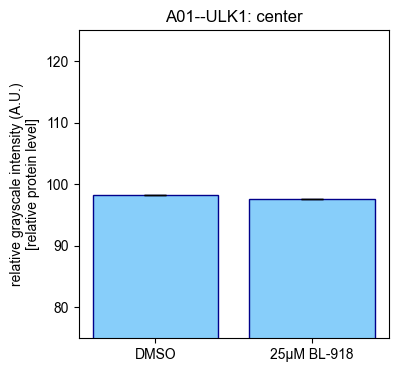

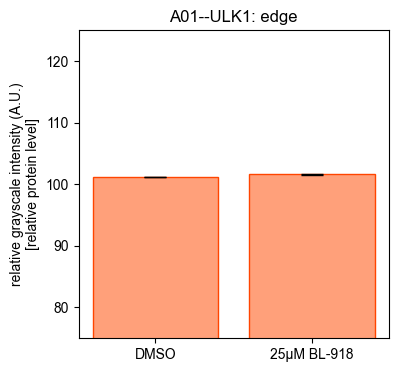

Center t-test 2 tailed:  TtestResult(statistic=2.939111203163163, pvalue=0.015643343382053893, df=9.477840924933485)
Center t-test 1 tailed:  TtestResult(statistic=2.939111203163163, pvalue=0.007821671691026946, df=9.477840924933485)
Edge t-test 2 tailed:  TtestResult(statistic=-2.0184062111680614, pvalue=0.07380226485363933, df=9.148478657807393)
Edge t-test 1 tailed:  TtestResult(statistic=-2.0184062111680614, pvalue=0.9630988675731803, df=9.148478657807393)
DMSO bioreps (N) =  8
Treated bioreps(N) =  8 


\n


In [41]:
# step6: normalize values to mean of overall measurements and then re-do statistical testing. This is because staining differences between samples
# could lead to a lack of comparability between different samples (ie, treated/untreated). However, relative measurements should still be valuable. 
# therefore, if we normalize all means of each biorep to the overall mean grayscale value, then all grayscale values will be relative to an internal
# control and should be able to be compared to each other, which will allow comparison between treated/untreated conditions without being dictated by
# technical differences in staining. 

# Note: here is where we will utilize dict_gray_means, compiled in step5.

# return list where each item is normalized by (divided by) normval
def norm_ls_100(ls, normval):
    temp = []
    for item in ls:
        temp.append((item / normval)*100)
    return temp

# redo all stats testing done in step5, but used NORMALIZED values. Skip steps that I haven't been using in the past (histogram, etc). 

# initialize empty lists to output for manipulation in other graphing software
org_s, ab_s, c_vs_e, d_vs_t, means, stdevs, ns, vals = [], [], [], [], [], [], [], []

# find gray means of all organoid bioreps in every folder between 20-40%, and 55-75% (what is considered edge,center--can be changed)
min_center, max_center, min_edge, max_edge = 20, 40, 55, 75
i = 0
for i in dict_abs.keys():
    
    for j in dict_orglines.keys():
        # only want one graph per condition pair--so skip even# keys (since j runs 1-7)
        if (j % 2) == 1 and j != 7:
            print("i=", i, "Ab=", dict_abs[i])
            print("j=", j, "orgline=", dict_orglines[j])

            # untreated (1) + treated (2)
            title = dict_orglines[j] + "--" + dict_abs[i]
            # note that including ":" in the title here messes up the saving of images.
            print(title)
            folder1 = str(j) + "-" + str(i)
            print(folder1)
            folder2 = str(j+1) + "-" + str(i)
            print(folder2)

            # get mean values
            mean_dmso = dict_gray_means[folder1]
            mean_treat = dict_gray_means[folder2]

            # concat all four relevant lists: dmso/treat, center/edge for this ab. each dict will be n=#bio replicates long,
            # with key = org-biorep-name (ie. "A") and value = mean grayscale intensity % of all csvs for that biorep between the 
            # min,max %dist values passed
            # when getting list, also go ahead and normalize
            dmso_center = concat_gray_means_range(folder1, min_center, max_center)
            dmso_center_ls = norm_ls_100(list(dmso_center.values()), mean_dmso)
            dmso_edge = concat_gray_means_range(folder1, min_edge, max_edge)
            dmso_edge_ls = norm_ls_100(list(dmso_edge.values()), mean_dmso)
            treat_center = concat_gray_means_range(folder2, min_center, max_center)
            treat_center_ls = norm_ls_100(list(treat_center.values()), mean_treat)
            treat_edge = concat_gray_means_range(folder2, min_edge, max_edge)
            treat_edge_ls = norm_ls_100(list(treat_edge.values()), mean_treat)

            # plot 2 bar graphs: one for edge, one for center
            x = ["DMSO", "25μM BL-918"]
            fig1, ax1 = plt.subplots(figsize=(4,4))
            ls_center_y = [mean(dmso_center_ls) , mean(treat_center_ls)]
            ls_center_stderr = [np.std(dmso_center_ls)/len(dmso_center_ls) , np.std(treat_center_ls)/len(treat_center_ls)]
            ax1.bar(x, ls_center_y, color="lightskyblue", edgecolor="darkblue", linewidth=1,yerr=ls_center_stderr, ecolor='k', capsize=8)
            ax1.set_ylabel("relative grayscale intensity (A.U.)\n[relative protein level]")
            ax1.set_title(title+": center")
            ax1.set_ylim(bottom=75, top=125)
            plt.show()

            fig2, ax2 = plt.subplots(figsize=(4,4))
            ls_edge_y = [mean(dmso_edge_ls) , mean(treat_edge_ls)]
            ls_edge_stderr = [np.std(dmso_edge_ls)/len(dmso_edge_ls) , np.std(treat_edge_ls)/len(treat_edge_ls)]
            ax2.bar(x, ls_edge_y, color="lightsalmon", edgecolor="orangered", linewidth=1, yerr=ls_edge_stderr, ecolor='k', capsize=8)
            ax2.set_ylabel("relative grayscale intensity (A.U.)\n[relative protein level]")
            ax2.set_title(title+": edge")
            ax2.set_ylim(bottom=75, top=125)
            plt.show()
    
            # do relevant t-tests and report p-values of all four lists
            center_2_result = scipy.stats.ttest_ind(dmso_center_ls, treat_center_ls, equal_var=False)
            center_1_result = scipy.stats.ttest_ind(dmso_center_ls, treat_center_ls, equal_var=False, alternative='greater')
            print("Center t-test 2 tailed: ", center_2_result)
            print("Center t-test 1 tailed: ", center_1_result)
    
            edge_2_result = scipy.stats.ttest_ind(dmso_edge_ls, treat_edge_ls, equal_var=False)
            edge_1_result = scipy.stats.ttest_ind(dmso_edge_ls, treat_edge_ls, equal_var=False, alternative='greater')
            print("Edge t-test 2 tailed: ",edge_2_result)
            print("Edge t-test 1 tailed: ",edge_1_result)

            # print biorep numebers
            print("DMSO bioreps (N) = " , len(dmso_center_ls))
            print("Treated bioreps(N) = ", len(treat_center_ls), "\n\n\n\\n")

            # add to lists to create df, so data can be written to csv
            org_s.extend([dict_orglines[j], dict_orglines[j], dict_orglines[j], dict_orglines[j]]) 
            ab_s.extend([dict_abs[i], dict_abs[i], dict_abs[i], dict_abs[i]])
            c_vs_e.extend(["center", "center", "edge", "edge"])
            d_vs_t.extend(["dmso", "treat", "dmso", "treat"])
            means.extend([mean(dmso_center_ls), mean(treat_center_ls), mean(dmso_edge_ls), mean(treat_edge_ls)])
            stdevs.extend([np.std(dmso_center_ls), np.std(treat_center_ls), np.std(dmso_edge_ls), np.std(treat_edge_ls)])
            ns.extend([len(dmso_center), len(treat_center), len(dmso_edge), len(treat_edge)])
            vals.extend([ls_to_str(dmso_center_ls), ls_to_str(treat_center_ls), ls_to_str(dmso_edge_ls), ls_to_str(treat_edge_ls)])



#create df with lists
df_out = pd.DataFrame()
df_out["Orgline"] = org_s
df_out["Abs"] = ab_s
df_out["center/edge"] = c_vs_e
df_out["dmso/treat"] = d_vs_t
df_out["mean"] = means
df_out["stdev"] = stdevs
df_out["N"] = ns
df_out["values"] = vals

#output df to csv
df_out.to_csv("./output_img_full/bar_graph_output_full-NORM.csv")
#print(df_out)


In [50]:
# step7: graph redo with normalization

# step4: print one graph per condition, with one line each for the untreated, treated condition:

dict_abs = {2: "MAP2", 3: "AT8", 4: "HT7", 5: "Beclin-1", 6: "p62", 7: "LC3", 8:"T22", 9:"ULK1"}
dict_orglines = {1: "A02", 2: "A02", 3:"E11", 4:"E11", 5:"A01", 6:"A01", 7:"B12"}

dict_gray_means = {}


# go through similar loop as above, just normalize to overall mean before plotting
# do only ONE graph--%dist (x) vs. %gray (y)
# Note that folders "7-x" will have no "treated" condition to compare to, so likely will need to do this one separately

i = 0
for i in dict_abs.keys():
    print("i=", i, "ab=", dict_abs[i])
    
    for j in dict_orglines.keys():        
        # only want one graph per condition pair--so skip even# keys (since j runs 1-7)
        if (j % 2) == 1 and j != 7:
            print("j=", j, "orgline=", dict_orglines[j])

            # untreated (1) + treated (2)
            folder1 = str(j) + "-" + str(i)
            print(folder1)
            folder2 = str(j+1) + "-" + str(i)
            print(folder2)

            title = dict_orglines[j] + "--" + dict_abs[i]
            
            # concat x, y for untreated (1) and treated (2) conditions
            x1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "%dist")
            x2 = concat_reps(ls_point_to_csvs[d_condits[folder2]], "%dist")

            y1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "gray%")
            y2 = concat_reps(ls_point_to_csvs[d_condits[folder2]], "gray%")

            # get overall mean and normalize grayscale value list
            y1_norm = norm_ls_100(y1, mean(y1))
            y2_norm = norm_ls_100(y2, mean(y2))

            # plot scatter for set#1,2
            fig, ax = plt.subplots(figsize=(10,10))
            ax.set_xlim(left=0, right=100)
            ax.set_ylim(bottom=20, top=180)
            ax.set_xlabel("% distance from center" , fontsize=30)
            ax.set_ylabel("relative grayscale intensity(%)", fontsize=30)
            ax.set_title(title, fontsize=40, fontweight="bold")
        
            ax.scatter(x1, y1_norm, c="moccasin", marker=1)
            ax.scatter(x2, y2_norm, c="lightblue", marker=1)

            #fit and plot polynomial line of best fit for set#1
            ls_coeffs1 = np.polyfit(x1, y1_norm, 4).tolist()
            ls_coeffs1.reverse()
            ax.plot(x1, poly_coeffs(x1, ls_coeffs1), linestyle='-', color='saddlebrown', label="DMSO")

            #fit and plot polynomial line of best fit for set#2
            ls_coeffs2 = np.polyfit(x2, y2_norm, 4).tolist()
            ls_coeffs2.reverse()
            ax.plot(x2, poly_coeffs(x2, ls_coeffs2), linestyle='-', color='darkblue', label="25μM BL-918")

            #show plot
            ax.tick_params(axis='both', which='major', labelsize=28)
            ax.legend(loc='best',fontsize=30)
            #plt.show()
            plt.tight_layout()
            filepath = "./output_img_full_norm/" + title + "-concat.png"
            plt.savefig(filepath)
            plt.close()


        # for B12 (no treated condition)
        if j == 7: 
            print("j=", j, "orgline=", dict_orglines[j])
            # untreated
            folder1 = str(j) + "-" + str(i)
            print(folder1)

            title = dict_orglines[j] + "--" + dict_abs[i]

            # concat x, y for untreated (1) and treated (2) conditions
            x1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "%dist")
            y1 = concat_reps(ls_point_to_csvs[d_condits[folder1]], "gray%")

            # get overall mean and normalize grayscale value list
            y1_norm = norm_ls_100(y1, mean(y1))

            # plot scatter for set#1,2
            fig, ax = plt.subplots(figsize=(10,10))
            ax.set_xlim(left=0, right=100)
            ax.set_ylim(bottom=0, top=180)
            ax.set_xlabel("% distance from center" , fontsize=30)
            ax.set_ylabel("relative grayscale intensity(%)", fontsize=30)
            ax.set_title(title, fontsize=40, fontweight="bold")
        
            ax.scatter(x1, y1_norm, c="moccasin", marker=1)
            
            #fit and plot polynomial line of best fit for set#1
            ls_coeffs1 = np.polyfit(x1, y1_norm, 4).tolist()
            ls_coeffs1.reverse()
            ax.plot(x1, poly_coeffs(x1, ls_coeffs1), linestyle='-', color='saddlebrown', label="DMSO")

            #show plot
            ax.tick_params(axis='both', which='major', labelsize=28)
            ax.legend(loc='best', fontsize=30)
            #plt.show()
            plt.tight_layout()
            filepath = "./output_img_full_norm/" + title + "-concat.png"
            plt.savefig(filepath)
            plt.close()
            



i= 2 ab= MAP2
j= 1 orgline= A02
1-2
2-2
j= 3 orgline= E11
3-2
4-2
j= 5 orgline= A01
5-2
6-2
j= 7 orgline= B12
7-2
i= 3 ab= AT8
j= 1 orgline= A02
1-3
2-3
j= 3 orgline= E11
3-3
4-3
j= 5 orgline= A01
5-3
6-3
j= 7 orgline= B12
7-3
i= 4 ab= HT7
j= 1 orgline= A02
1-4
2-4
j= 3 orgline= E11
3-4
4-4
j= 5 orgline= A01
5-4
6-4
j= 7 orgline= B12
7-4
i= 5 ab= Beclin-1
j= 1 orgline= A02
1-5
2-5
j= 3 orgline= E11
3-5
4-5
j= 5 orgline= A01
5-5
6-5
j= 7 orgline= B12
7-5
i= 6 ab= p62
j= 1 orgline= A02
1-6
2-6
j= 3 orgline= E11
3-6
4-6
j= 5 orgline= A01
5-6
6-6
j= 7 orgline= B12
7-6
i= 7 ab= LC3
j= 1 orgline= A02
1-7
2-7
j= 3 orgline= E11
3-7
4-7
j= 5 orgline= A01
5-7
6-7
j= 7 orgline= B12
7-7
i= 8 ab= T22
j= 1 orgline= A02
1-8
2-8
j= 3 orgline= E11
3-8
4-8
j= 5 orgline= A01
5-8
6-8
j= 7 orgline= B12
7-8
i= 9 ab= ULK1
j= 1 orgline= A02
1-9
2-9
j= 3 orgline= E11
3-9
4-9
j= 5 orgline= A01
5-9
6-9
j= 7 orgline= B12
7-9


In [34]:
# TEST:
d = concat_gray_means_range("2-2", 0, 20)
print(d)

{'A': 56.48124475997285, 'B': 58.88946352648672, 'C': 57.95369875383783, 'D': 57.817405638382056, 'E': 58.371532541605475, 'F': 57.790853289392736, 'G': 56.636915025172485, 'H': 56.146740408064}
